In [1]:
# !pip install --upgrade --pre xgboost # Needed for gpu used with feature_weights, at least on kaggle.

In [1]:
from __future__ import print_function
from __future__ import division

from typing import List, Optional, Iterable, Union, Dict

import os
import pandas as pd
import numpy as np
import re
import itertools
from itertools import combinations


from matplotlib import pyplot as plt
import seaborn as sns

from sklearn import metrics
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from sklearn.metrics import mean_absolute_error, mean_squared_error, accuracy_score

import xgboost as xgb # environment on thinkpad uses 2.0.3
from xgboost.sklearn import XGBClassifier
import optuna

import copy
from itertools import combinations

from numba import cuda

from warnings import filterwarnings
filterwarnings('ignore')

from scipy.signal import medfilt

import pickle

/home/tfc/anaconda3/envs/DD_dengue/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import torch

# Check if CUDA (GPU) is available
if torch.cuda.is_available():
    # Get the number of GPUs available
    num_gpus = torch.cuda.device_count()
    print(f"Number of GPUs available: {num_gpus}")

    # Iterate over available GPUs and print their names
    for i in range(num_gpus):
        gpu_name = torch.cuda.get_device_name(i)
        print(f"GPU {i}: {gpu_name}")
else:
    print("CUDA is not available. Running on CPU.")

Number of GPUs available: 1
GPU 0: NVIDIA GeForce RTX 4080 SUPER


### Helpers

In [3]:
def preprocess(df_features_or: pd.DataFrame,
               labels=None,
               features_to_keep: Optional[Iterable[str]] = None,
               lagged_features: Optional[Union[Iterable[str],Dict[str, Iterable[str]]]] = None,
               fillna: Optional[str] = None,
               circular_weekofyear: bool = False,
               feature_lags=None,
               label_lags=None):
    '''
    Add lagged features or target values as needed, accounting for existence of two cities in dataset.
    fillna: Fill NaN approach, e.g. 'ffill'. None to not fill.
    '''

    df_features = df_features_or.copy()
    df_features = df_features.reset_index()

    if features_to_keep is not None:         # Filter features
        feature_names = features_to_keep + ['city']
        df_features = df_features[feature_names]
    else:
        feature_names = list(df_features.columns)

    if fillna is not None:                   # Fill NaNs
        df_features.fillna(method=fillna, inplace=True)

    # Convert city feature to categorical and one hot encode
    df_features["city"] = df_features["city"].astype("category")
    df_features = pd.get_dummies(df_features, columns=['city'], drop_first=True)

    # Create circular week of year. #TEMP: update again
    if circular_weekofyear:
        
        # df_features['weekofyear1'] = np.sin((df_features['weekofyear']-1)/51*2*np.pi) # Method 2
        # df_features['weekofyear2'] = np.cos((df_features['weekofyear']-1)/51*2*np.pi)
        # df_features.drop(columns=['weekofyear'],inplace=True)

        df_features['weekofyear'] = np.sin((df_features['weekofyear']-1)/51*np.pi)    # Method 1
        # df_features['weekofyear'] = -np.sin((df_features['weekofyear']-1)/51*2*np.pi)   # Method 3
        
    # Split cities before adding lags
    sj_features = df_features[df_features['city_sj']]
    iq_features = df_features[~df_features['city_sj']]

    if labels is not None:
        sj_labels = labels[df_features['city_sj']]
        iq_labels = labels[~df_features['city_sj']]
    else:
        sj_labels = None        
        iq_labels = None

    # Lagged feature/labels creation
    if (lagged_features is not None) or (label_lags is not None):
        # Add lagged features
        if isinstance(lagged_features,dict):                # Do individual lags for different features
            for feat, feat_lags in lagged_features.items():
                sj_features_lagged = sj_features[feat].shift(periods=feat_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feat_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)
        elif isinstance(lagged_features, (list, tuple)):    # All considered features has same lags
            for feat in lagged_features:
                if 'total_cases' in feat:                   # Skip all total_cases features, used when preprocessing pred features
                    continue
                sj_features_lagged = sj_features[feat].shift(periods=feature_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feature_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)

        # Add lagged labels
        if label_lags is not None:
            sj_lagged_labels = sj_labels.shift(periods=label_lags)
            sj_features = pd.concat([sj_features,sj_lagged_labels],axis=1)
            iq_lagged_labels = iq_labels.shift(periods=label_lags)
            iq_features = pd.concat([iq_features,iq_lagged_labels],axis=1)
  
    return sj_features, iq_features, sj_labels, iq_labels

def prep_data(sj_features:pd.DataFrame, iq_features:pd.DataFrame,
              sj_labels:pd.DataFrame, iq_labels:pd.DataFrame,
              folds=6, fold_size=0.15):
    '''
    To prepare multiple folds for k-fold, without randomization to preserve time series sequence.
    sj_features: Dataframe of processed input for San Juan
    iq_features: Dataframe of processed input for Iquitos
    sj_labels: Labels for San Juan
    iq_labels: Labels for Iquitos
    '''

    # K-fold with sequential splits, 6 folds, with early data kept out
    X_train_sj, X_val_sj, y_train_sj, y_val_sj = [], [], [], []
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = [], [], [], []
    sj_size = len(sj_features)
    iq_size = len(iq_features)
    sj_fold_size = round(fold_size*sj_size)
    iq_fold_size = round(fold_size*iq_size)
    sj_train_features_temp = sj_features.copy()
    iq_train_features_temp = iq_features.copy()
    sj_train_labels_temp = sj_labels.copy()
    iq_train_labels_temp = iq_labels.copy()

    for _ in range(folds):
        # Add to X_val
        X_val_sj.append(sj_train_features_temp.iloc[-sj_fold_size:,:])
        sj_train_features_temp.drop(sj_train_features_temp.index[-sj_fold_size:],inplace=True)
        X_val_iq.append(iq_train_features_temp.iloc[-iq_fold_size:,:])
        iq_train_features_temp.drop(iq_train_features_temp.index[-iq_fold_size:],inplace=True)
        
        # Add to y_val
        y_val_sj.append(sj_train_labels_temp.iloc[-sj_fold_size:,:])
        sj_train_labels_temp.drop(sj_train_labels_temp.index[-sj_fold_size:],inplace=True)
        y_val_iq.append(iq_train_labels_temp.iloc[-iq_fold_size:,:])
        iq_train_labels_temp.drop(iq_train_labels_temp.index[-iq_fold_size:],inplace=True)

    # Create X_train and y_train
    X_train_sj_components = copy.deepcopy(X_val_sj)
    X_train_iq_components = copy.deepcopy(X_val_iq)
    y_train_sj_components = copy.deepcopy(y_val_sj)
    y_train_iq_components = copy.deepcopy(y_val_iq)

    for i in range(folds):
        X_train_sj_components_temp = copy.deepcopy(X_train_sj_components)
        X_train_sj_components_temp.pop(i)
        X_train_sj_components_temp.append(copy.deepcopy(sj_train_features_temp))  # Remove 1 fold, add back remainder rows from earlier
        X_train_sj.append(pd.concat(X_train_sj_components_temp))

        y_train_sj_components_temp = copy.deepcopy(y_train_sj_components)
        y_train_sj_components_temp.pop(i)
        y_train_sj_components_temp.append(copy.deepcopy(sj_train_labels_temp))  # Remove 1 fold, add back remainder rows from earlier
        y_train_sj.append(pd.concat(y_train_sj_components_temp))

        X_train_iq_components_temp = copy.deepcopy(X_train_iq_components)
        X_train_iq_components_temp.pop(i)
        X_train_iq_components_temp.append(copy.deepcopy(iq_train_features_temp))  # Remove 1 fold, add back remainder rows from earlier
        X_train_iq.append(pd.concat(X_train_iq_components_temp))

        y_train_iq_components_temp = copy.deepcopy(y_train_iq_components)
        y_train_iq_components_temp.pop(i)
        y_train_iq_components_temp.append(copy.deepcopy(iq_train_labels_temp))  # Remove 1 fold, add back remainder rows from earlier
        y_train_iq.append(pd.concat(y_train_iq_components_temp))

    return X_train_sj, X_val_sj, y_train_sj, y_val_sj, X_train_iq, X_val_iq, y_train_iq, y_val_iq

In [4]:
def create_XGBmodel(eta=0.01,n_estimators=1000,
                    max_depth=5,objective='reg:squarederror',
                    min_child_weight=1.02, gamma=0.51, subsample=0.86,
                    colsample_bytree=0.84, scale_pos_weight=1, seed=42,
                    **kwargs):
    '''
    Create an XGBRegressor model based on availability of GPU
    '''

    try:
        cuda.detect()
        gpu_available = cuda.is_available()
    except:
        gpu_available = False

    if gpu_available:
        return xgb.XGBRegressor(
            tree_method= 'gpu_hist',  # Use GPU accelerated algorithm
            n_gpus=1,
            device='cuda:0',
            learning_rate =eta,
            n_estimators=n_estimators,
            max_depth=max_depth,
            min_child_weight=min_child_weight,
            gamma=gamma,
            subsample=subsample,
            colsample_bytree=colsample_bytree,
            objective= objective,
            scale_pos_weight=scale_pos_weight,
            seed=seed,
            **kwargs)
    else:
        return xgb.XGBRegressor(
            learning_rate =eta,
            n_estimators=n_estimators,
            max_depth=max_depth,
            min_child_weight=min_child_weight,
            gamma=gamma,
            subsample=subsample,
            colsample_bytree=colsample_bytree,
            objective= objective,
            scale_pos_weight=scale_pos_weight,
            seed=seed,
            **kwargs)
    
def modelfit(alg, X_train, y_train, useTrainCV=True, cv_folds=5, early_stopping_rounds=50,trainCV_metrics = 'mae',
             eval_metric = 'mae',report_metric =  metrics.mean_absolute_error, verbose=True,
             weights=None, feature_weights = None):
    '''
    Automatically fit model, with option for using CV to get best n_estimators
    alg: XGBoost model
    weights: Weights for each data point
    feature_weights: Weights for each feature. Used here to reduce weights on lagged labels to reduce reliance on it.
    '''

    xgb_param = alg.get_xgb_params()
    xgtrain = xgb.DMatrix(X_train, label=y_train,feature_weights=feature_weights)
    xgtrain.set_info(feature_weights=feature_weights)

    if weights is not None:
        xgtrain.set_weight(weights)

    if useTrainCV:
        cvresult = xgb.cv(xgb_param, xgtrain, num_boost_round=alg.get_params()['n_estimators'], nfold=cv_folds,
            metrics=trainCV_metrics, early_stopping_rounds=early_stopping_rounds, verbose_eval=False)
        alg.set_params(n_estimators=cvresult.shape[0])
    
    #Fit the algorithm on the data
    alg.fit(X_train, y_train, feature_weights=feature_weights)
        
    #Predict training set:
    X_train_predictions = alg.predict(X_train)
        
    #Print model report:
    if verbose:
        print("\nModel Report")
        print(report_metric)
        print(report_metric(y_train, X_train_predictions))

def get_predictions(model, X_val,
                    label_lags: Optional[Iterable[int]]=None,
                    MC: Optional[int]=None):
    '''
    Get predictions using newly predicted labels as lagged labels.
    model: Trained XGBoost Regressor model
    X_val: Validation features
    label_lags: Label lags, None to signify no lagged labels used
    MC: Positive integer to use Monte Carlo-ish approach, small perturbations at every timestep. Currently only valid for Poisson distribution
    '''

    if label_lags is not None:
        if MC is None:
            X_val_no_lags = X_val.copy()
            lag_label_col_names = ['total_cases_'+str(lag) for lag in label_lags]                     # Lagged label names
            lag_label_col_locs = [X_val_no_lags.columns.get_loc(col) for col in lag_label_col_names]  # Get locations of lagged labels

            pred_val = np.zeros(X_val_no_lags.shape[0])
            for i in range(X_val_no_lags.shape[0]):
                pred_val[i] = model.predict(X_val_no_lags.iloc[i:i+1,:])                    # Predict current value, keep input in required dataframe format
                for k,j in enumerate(label_lags):                                           # Add predicted value to X_val as lagged labels for subsequent rows
                    try:
                        X_val_no_lags.iloc[i+j,lag_label_col_locs[k]] = pred_val[i]
                    except:
                        continue
        else:
            X_val_no_lags = X_val.copy()
            lag_label_col_names = ['total_cases_'+str(lag) for lag in label_lags]
            lag_label_col_locs = [X_val_no_lags.columns.get_loc(col) for col in lag_label_col_names]
            pred_val = np.zeros([X_val_no_lags.shape[0],MC])

            for l in range(MC):
                X_val_no_lags = X_val.copy()
                
                if l%20==0:
                    print(f'Step {l} of {MC} MC simulations')
                for i in range(X_val_no_lags.shape[0]):
                    lambda_ = model.predict(X_val_no_lags.iloc[i:i+1,:])                         # Get poisson lambda parameter
                    pred_val[i,l] = np.random.poisson(lambda_)                                   # Predict current value by taking a sample
                    for k,j in enumerate(label_lags):                                            # Add predicted value to X_val as lagged labels for subsequent rows
                        try:
                            X_val_no_lags.iloc[i+j,lag_label_col_locs[k]] = pred_val[i,l]
                        except:
                            continue
    else:
        pred_val = model.predict(X_val)
    pred_val = np.round(pred_val)
    pred_val = np.clip(pred_val, 0, 10000000)
    
    return pred_val

def eval_and_plot(model,X_train_all,y_train_all,X_val_all,y_val_all,
                  label_lags=None,
                  plot=True,verbose=True, MC=None,get_pred_train=True,
                  two_cities=False, median_filter: Optional[int]=None):
    '''
    Evaluate by predicting validation set and optionally plotting
    X_train: Dataframe of train features. Iterable of two dataframes if two_cities is True
    y_train: Dataframe of train labels. Iterable of two dataframes if two_cities is True
    X_val: Dataframe of val features. Iterable of two dataframes if two_cities is True
    y_val: Dataframe of val labels. Iterable of two dataframes if two_cities is True
    get_pred_train: True to calculate using previously predicted labels as lagged labels
    two_cities: Training model on both cities, requires splitting.
    median_filter: Apply median filtering to results.
    '''

    # If both cities trained together, input should be iterable of two datasets
    if two_cities:
        assert len(X_train_all)==2
        assert len(y_train_all)==2
        assert len(X_val_all)==2
        assert len(y_val_all)==2
    else:
        X_train_all = [X_train_all]
        y_train_all = [y_train_all]
        X_val_all = [X_val_all]
        y_val_all = [y_val_all]

    # Collect values separately for each city
    pred_train_all = []
    pred_val_all = []
    train_mae_all = []
    val_mae_all = []

    for X_train, y_train, X_val, y_val in zip(X_train_all, y_train_all, X_val_all, y_val_all):
        # Get predicted train values
        if get_pred_train:
            pred_train = get_predictions(model, X_train, label_lags, MC=MC)
        else:
            pred_train = model.predict(X_train)

        if median_filter is not None:
            pred_train = medfilt(pred_train,median_filter)

        pred_train = np.round(pred_train)
        pred_train = np.clip(pred_train, 0, 10000000)
        
        train_mae = mean_absolute_error(y_train, pred_train)
        if verbose:
            print("Train MAE:", train_mae)

        # Get prediction validation values
        pred_val = get_predictions(model, X_val, label_lags, MC=MC)

        if median_filter is not None:
            pred_val = medfilt(pred_val,median_filter)

        if MC is None:
            val_mae = mean_absolute_error(y_val, pred_val)
        else:
            val_mae = mean_absolute_error(y_val, np.mean(pred_val,axis=1))
        if verbose:
            print("Val MAE:", val_mae)
        
        pred_train_all.append(pred_train)
        pred_val_all.append(pred_val)
        train_mae_all.append(train_mae)
        val_mae_all.append(val_mae)

    if plot:
        for pred_train, pred_val, y_train, y_val, train_mae, val_mae in zip(pred_train_all, pred_val_all,y_train_all, y_val_all, train_mae_all, val_mae_all):
            fig, axs = plt.subplots(1,2,figsize=(8,2))
            fig2, axs2 = plt.subplots(2,1,figsize=(10,4))
            axs[0].scatter(y_train, pred_train)
            pred_train = pd.Series(pred_train, index=y_train.index)
            axs2[0].plot(np.arange(len(pred_train)), pred_train.sort_index(),marker='.',label='pred');
            axs2[0].plot(np.arange(len(y_train)), y_train.sort_index(),marker='.',label='y');
            axs2[0].legend();
            axs2[0].set_title(f'Training MAE: {train_mae}')


            if MC is None:
                axs[1].scatter(y_val, pred_val)
                pred_val = pd.Series(pred_val, index=y_val.index)
                axs2[1].plot(np.arange(len(pred_val)), pred_val.sort_index(),marker='.',label='pred');
                axs2[1].plot(np.arange(len(y_val)), y_val.sort_index(),marker='.',label='y');
                axs2[1].legend();
                axs2[1].set_title(f'Validation MAE: {val_mae}')
            else:
                axs[1].scatter(y_val, np.mean(pred_val,axis=1))
                            
                for l in range(MC):
                    axs2[1].plot(np.arange(pred_val.shape[0]), pred_val[:,l],alpha=0.2,color='grey');
                axs2[1].plot(np.arange(pred_val.shape[0]), np.mean(pred_val,axis=1),color='red');                
                axs2[1].plot(np.arange(len(y_val)), y_val.sort_index(),color='k',marker='.');
            fig.tight_layout()
            fig2.tight_layout()
            
        if not two_cities: # Unpacking directly if individually trained
            pred_train_all, pred_val_all, train_mae_all, val_mae_all = pred_train_all[0], pred_val_all[0], train_mae_all[0], val_mae_all[0]

    return pred_train_all, pred_val_all, train_mae_all, val_mae_all

## Data

In [5]:
# Load the provided data
# datapath = '/kaggle/input/data' # kaggle
datapath = r'./data' # local
train_features_or = pd.read_csv(datapath+'/dengue_features_train.csv',
                             index_col=[1,2])
train_features_or.reset_index(inplace=True)

test_features_or = pd.read_csv(datapath+'/dengue_features_test.csv',
                             index_col=[1,2])
test_features_or.reset_index(inplace=True)

test_features_aug_or = pd.read_csv(datapath+'/dengue_features_test2.csv',
                             index_col=[1,2])
test_features_aug_or.reset_index(inplace=True)

train_labels = pd.read_csv(datapath+'/dengue_labels_train.csv',
                           index_col=[1,2])
train_labels = train_labels.reset_index()
train_labels.drop(columns=['city','year','weekofyear'],inplace=True)

# Rearranging features for clearer viewing with heatmap
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]

## Decorrelate by feature weights

### Reference: SquaredError Split Cities

#### San Juan - Circular weekofyear

In [6]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
feature_lags = (3,)
# label_lags=None
# feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


KeyboardInterrupt: 

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d599

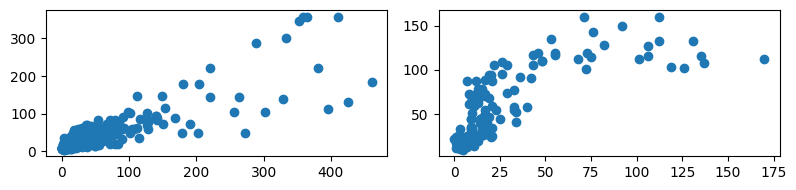

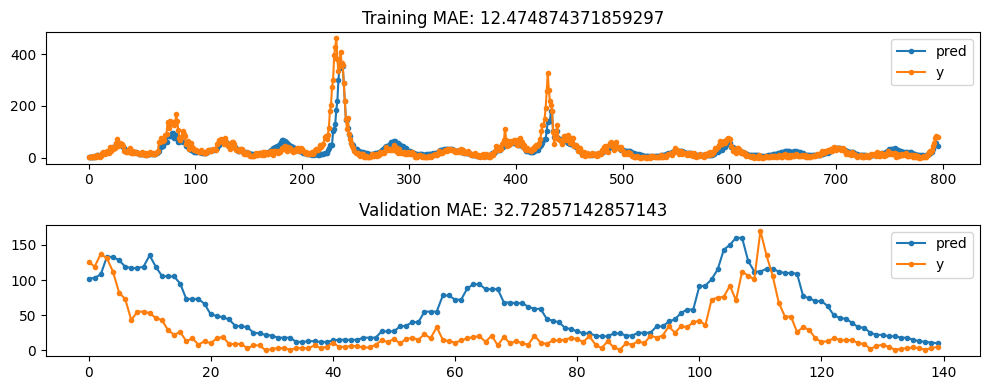

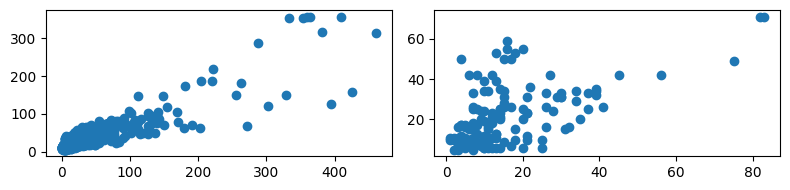

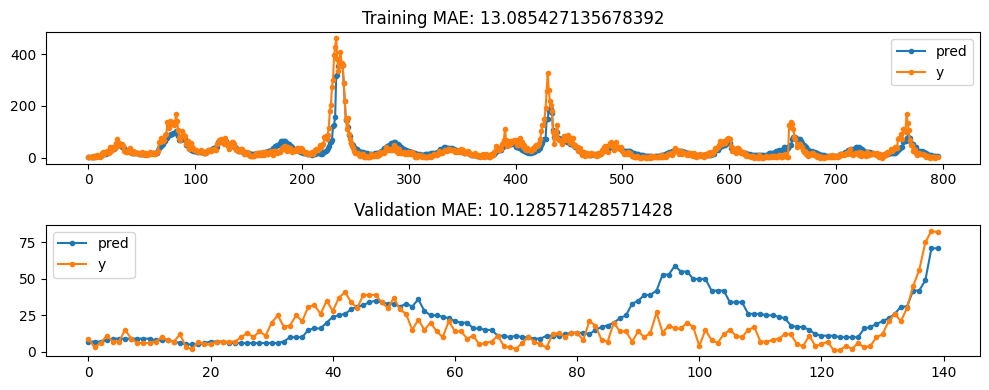

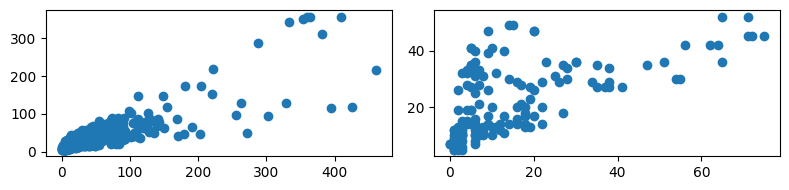

...

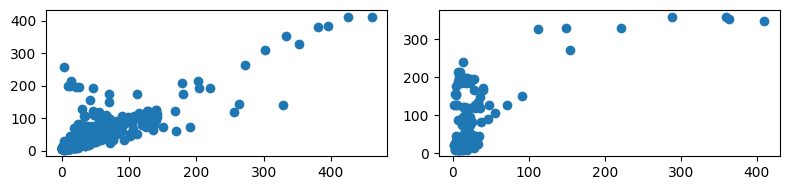

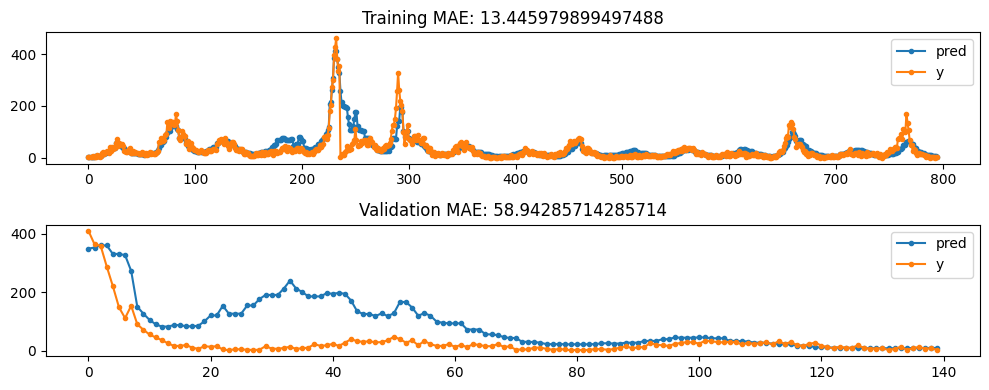

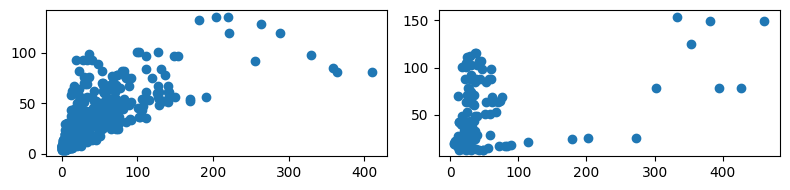

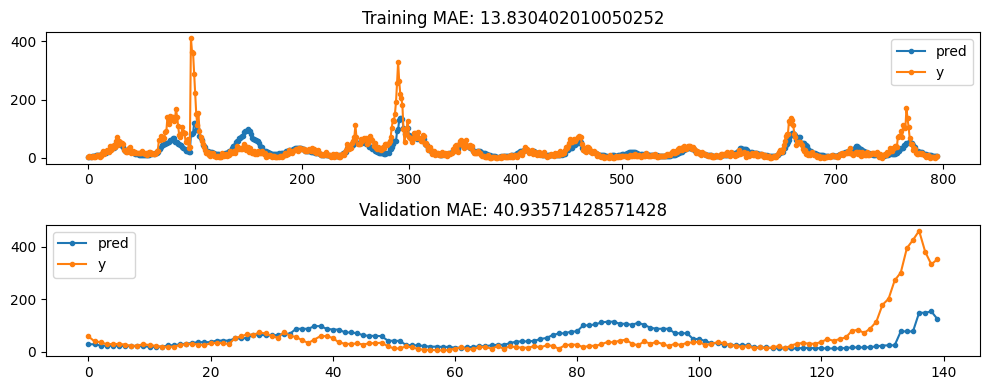

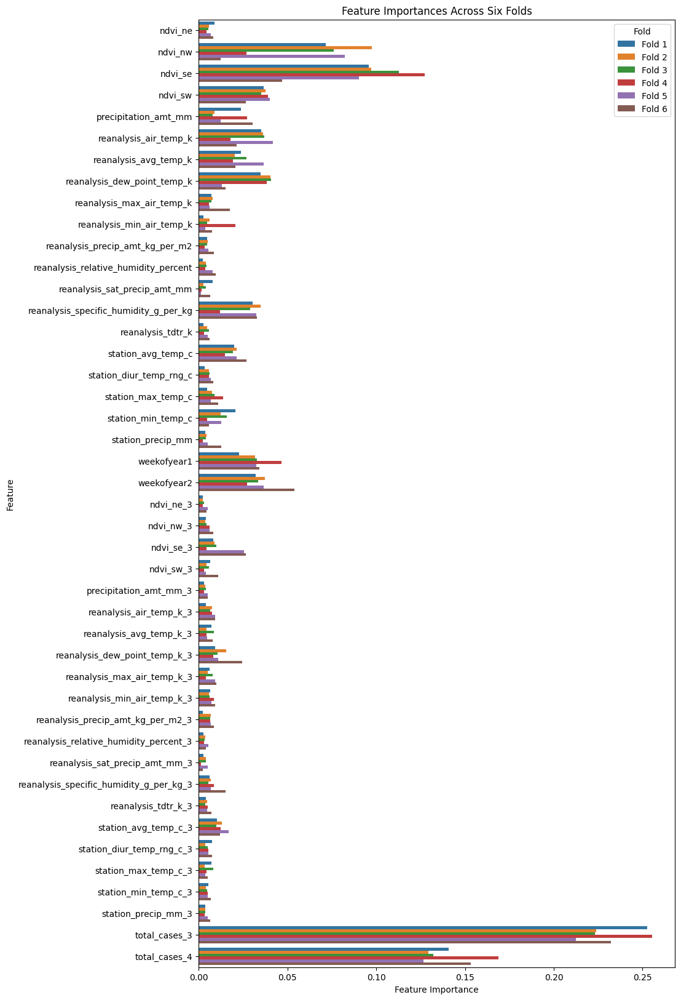

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


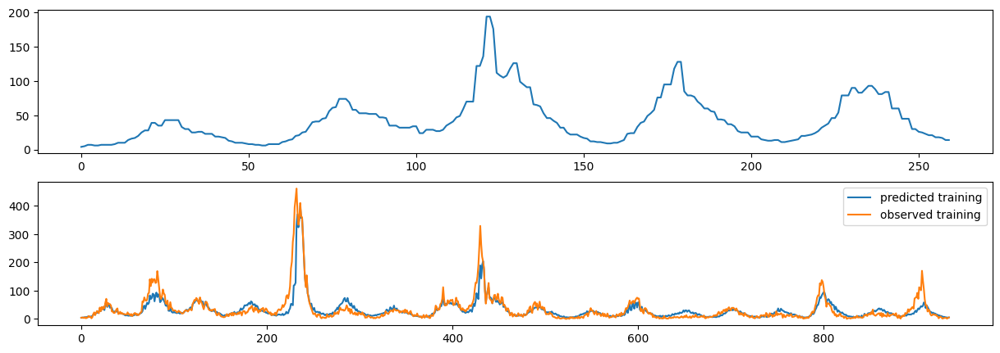

In [6]:
# Baseline for comparison in refined model
# Specify modelling parameters
label_lags=(3,4)
feature_lags = (3,)
# label_lags=None
# feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 50

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

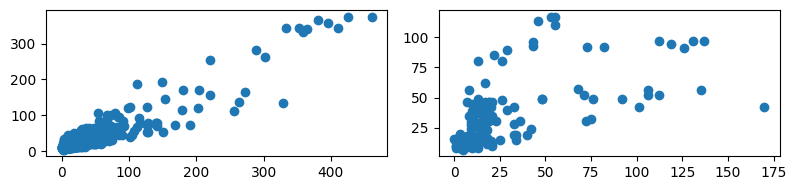

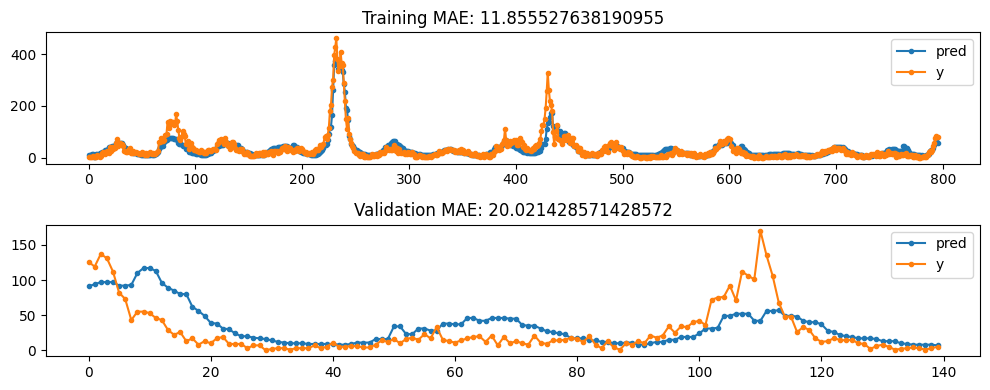

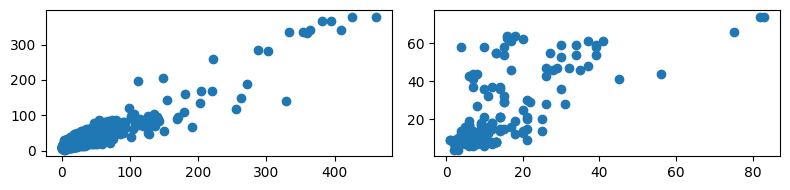

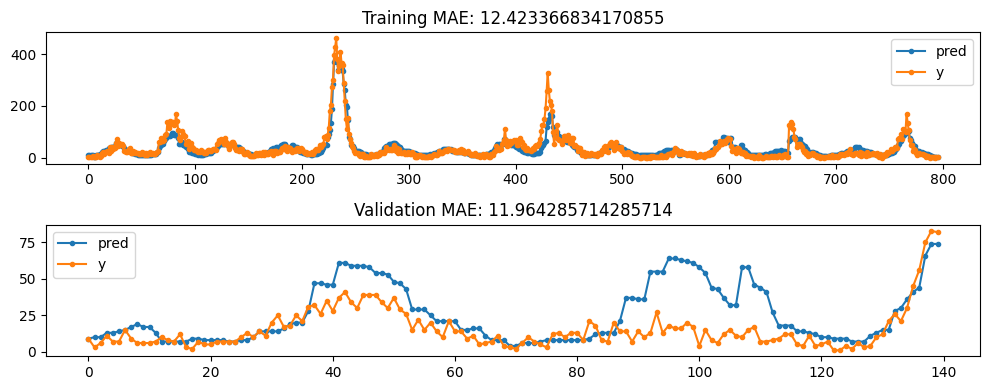

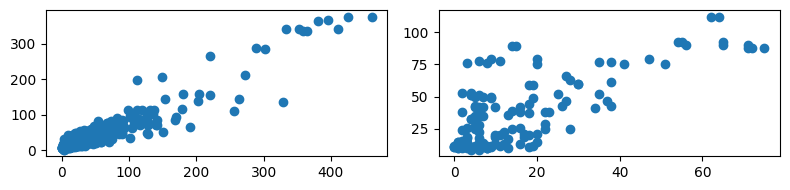

...

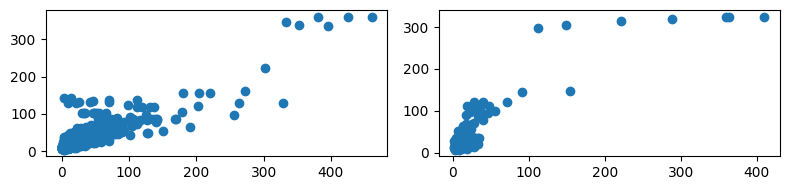

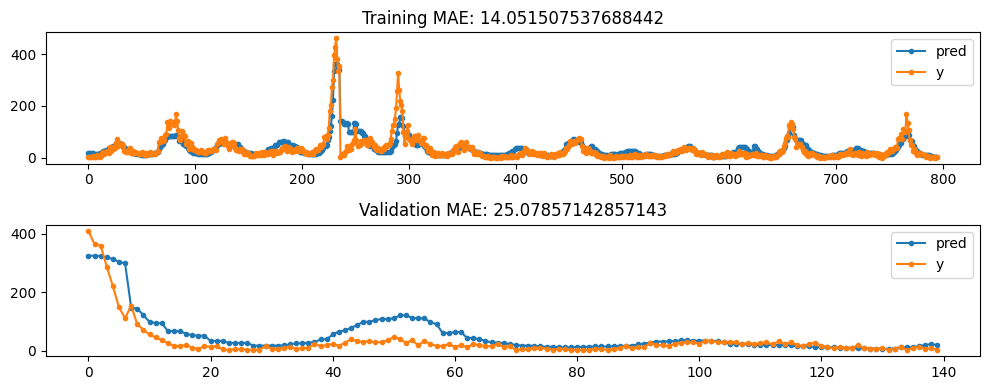

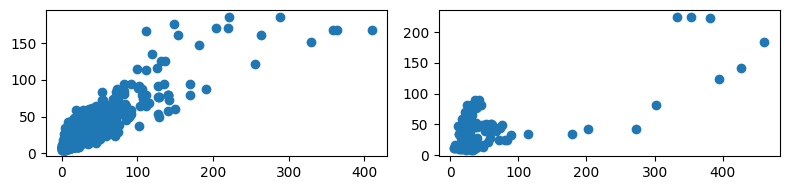

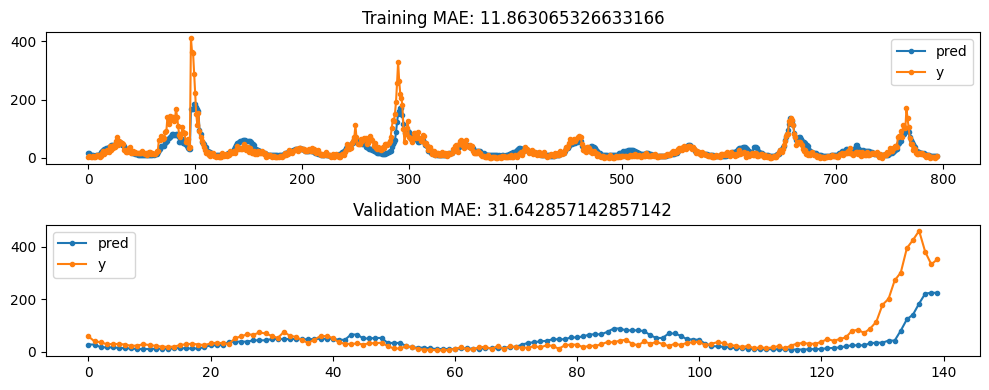

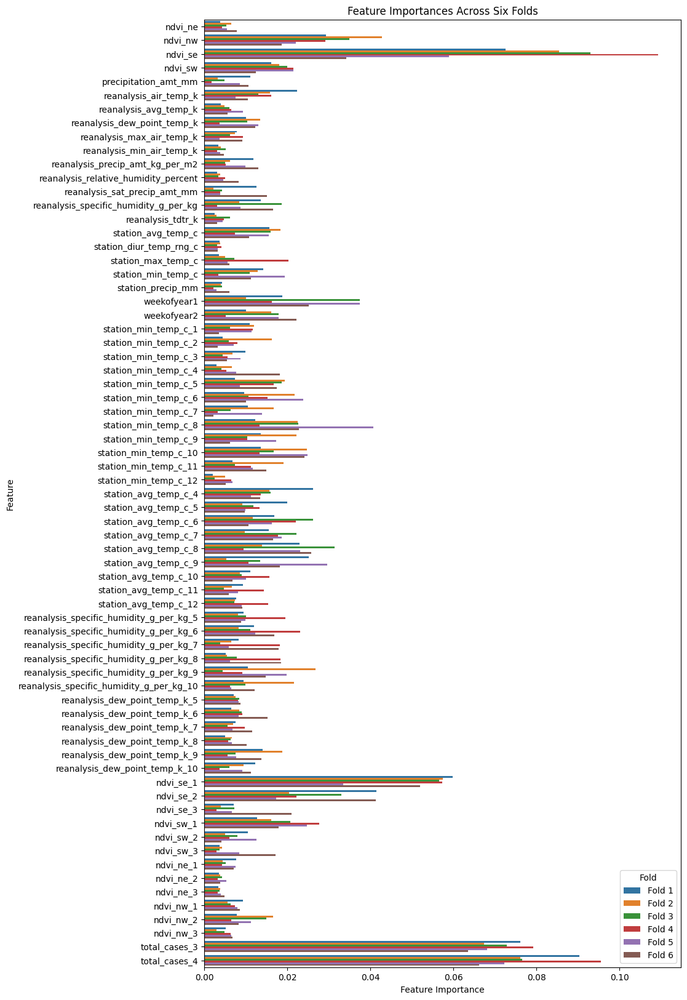

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


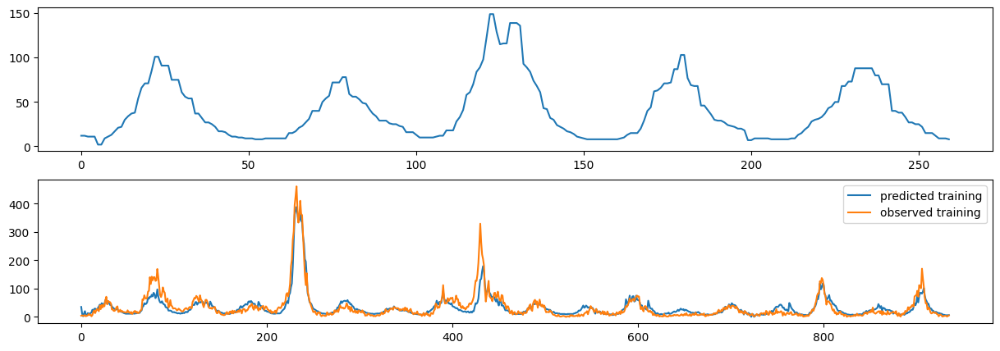

In [29]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []

label_lags=(3,4)
# label_lags=None

# feature_lags = (3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=4
objective='reg:squarederror'
min_child_weight=10
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

#### Iquitos - Circular weekofyear


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

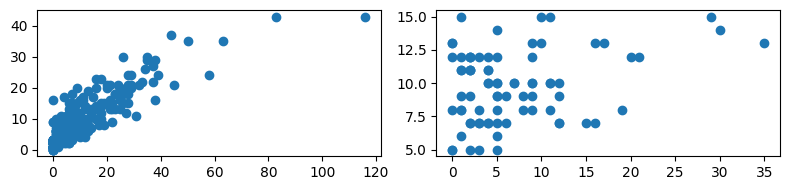

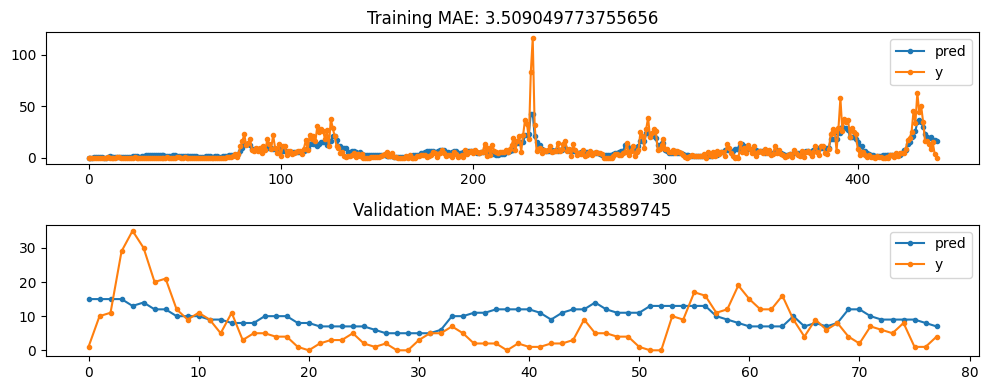

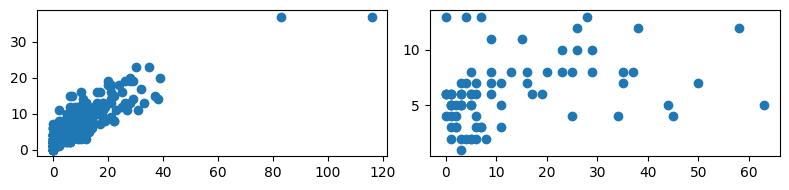

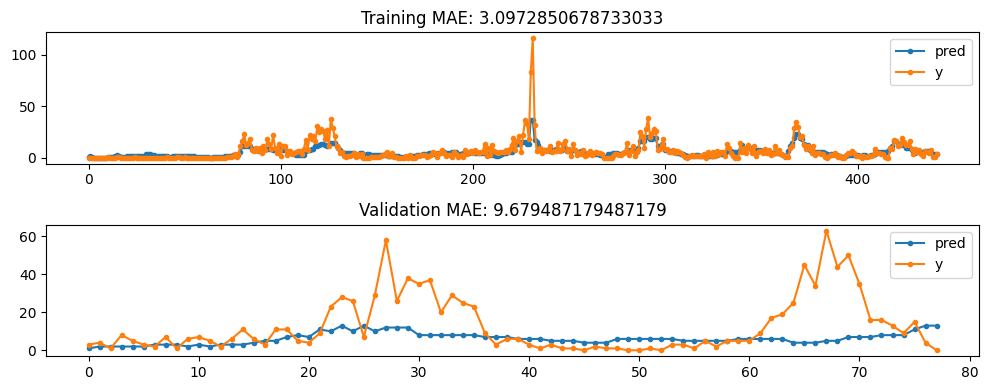

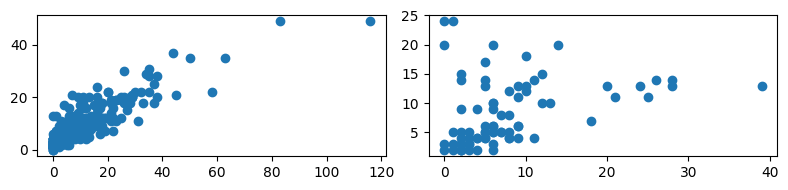

...

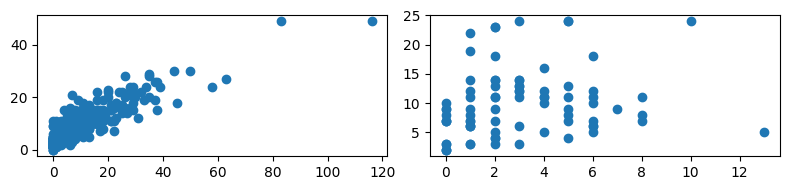

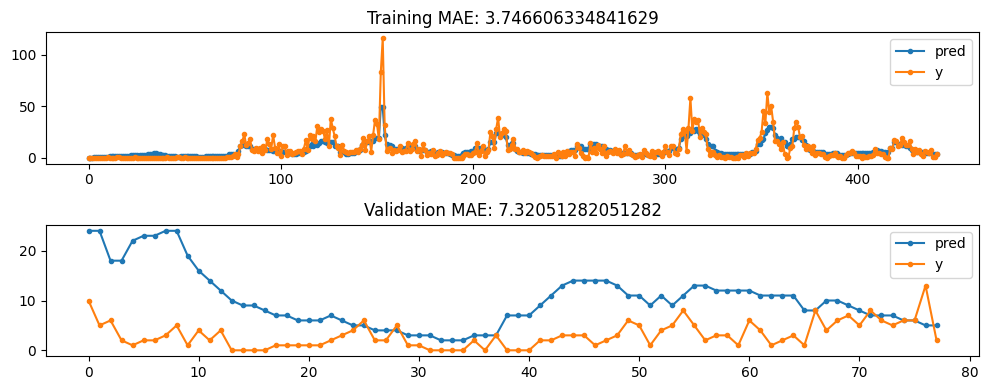

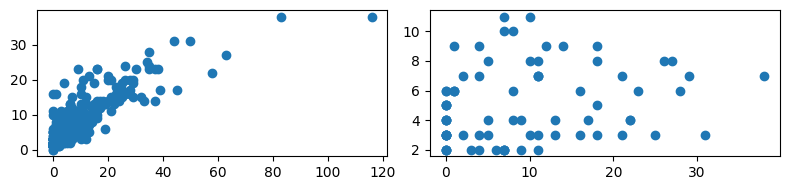

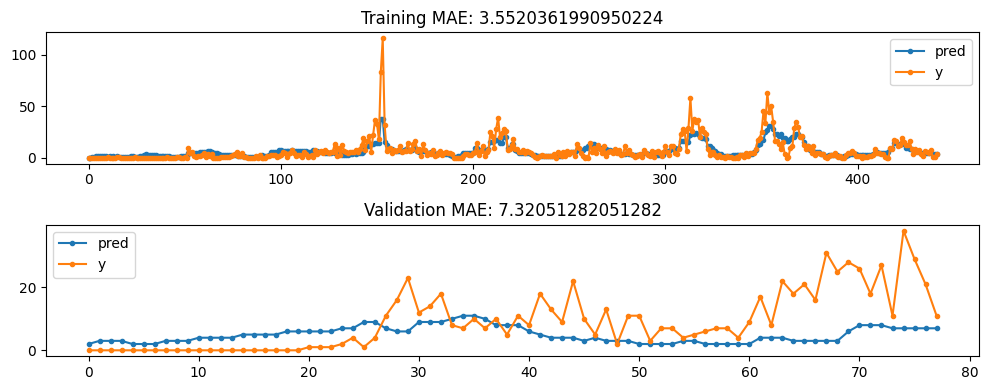

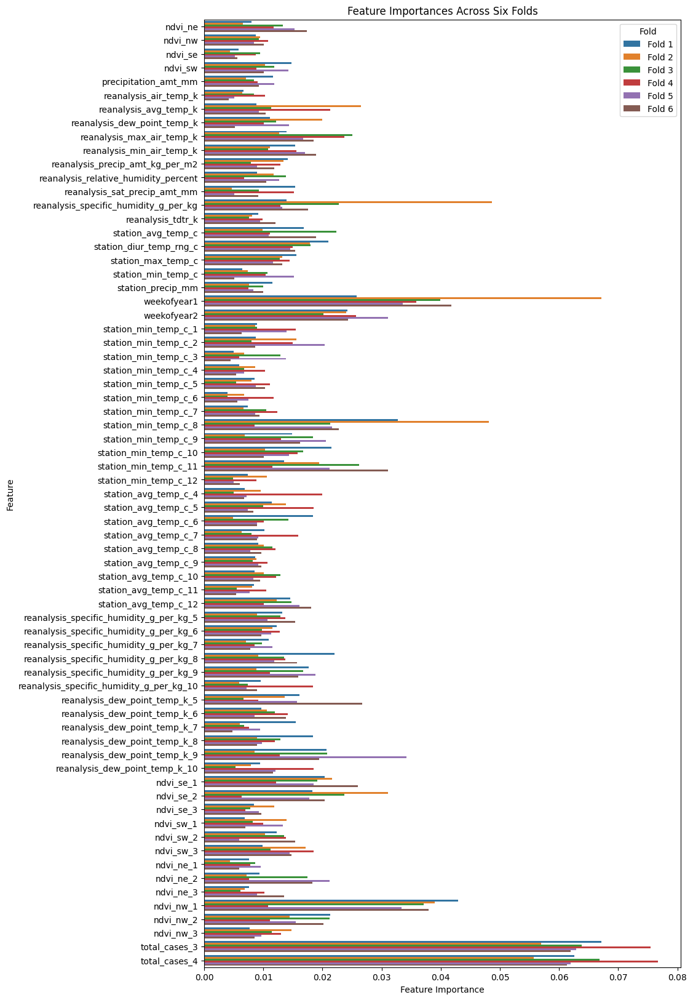

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


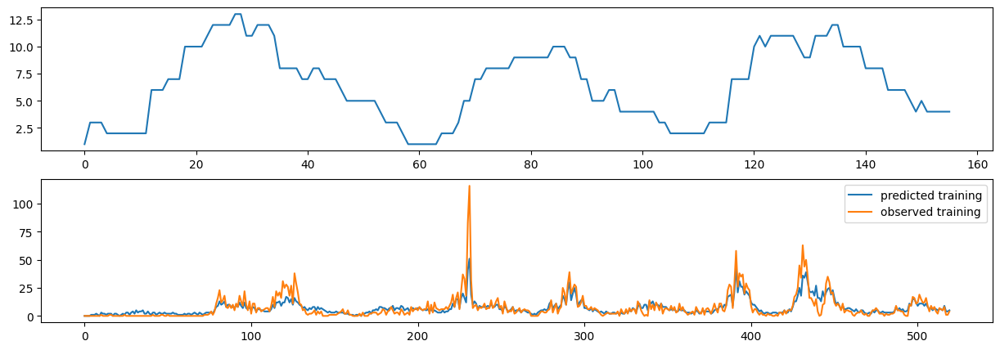

In [26]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_iq = []

label_lags=(3,4)
# label_lags=None

# feature_lags = (3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=4
objective='reg:squarederror'
min_child_weight=10
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index().reset_index(drop=True), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

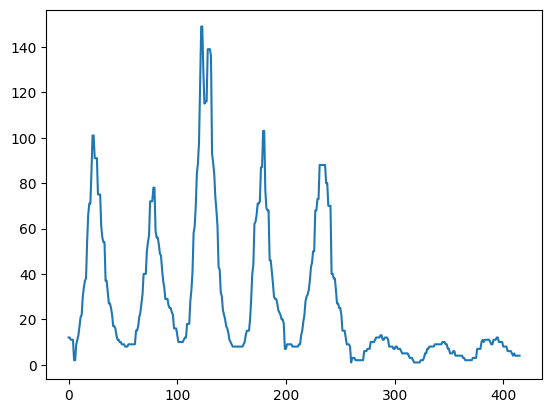

In [30]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_26.csv")

## Try simple brute force again

### SanJuan

#### quick check


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

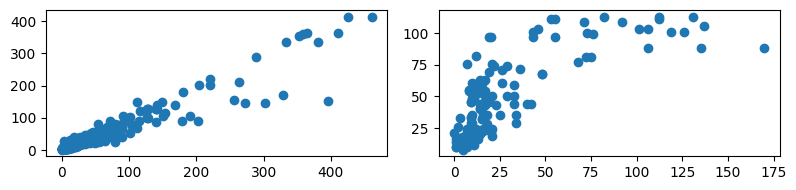

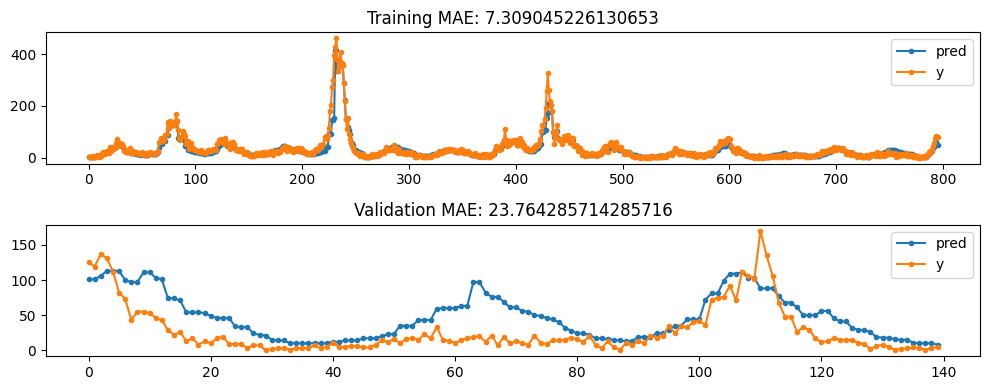

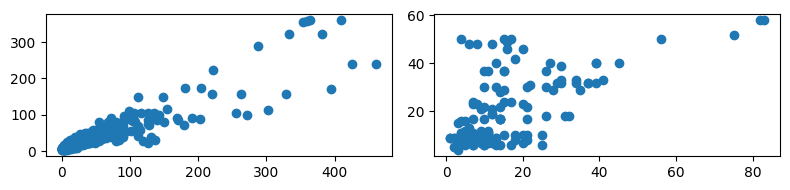

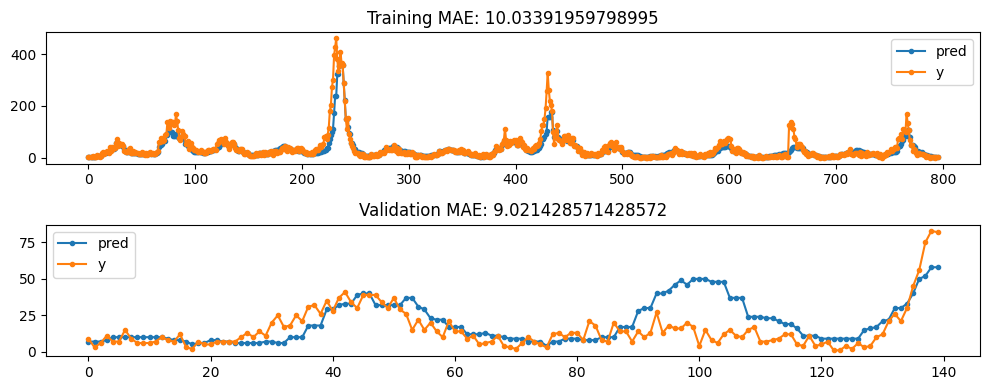

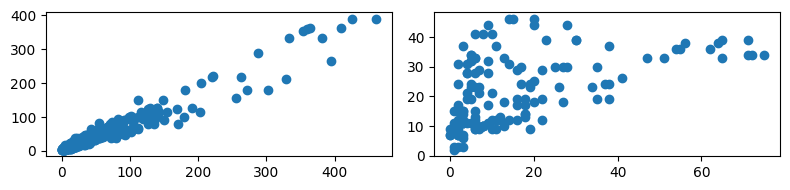

...

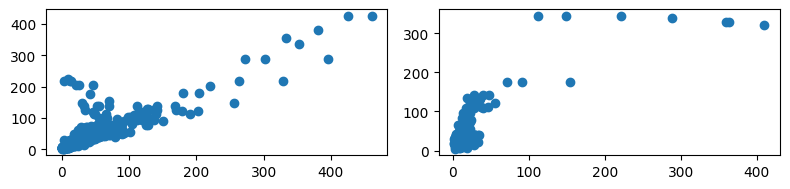

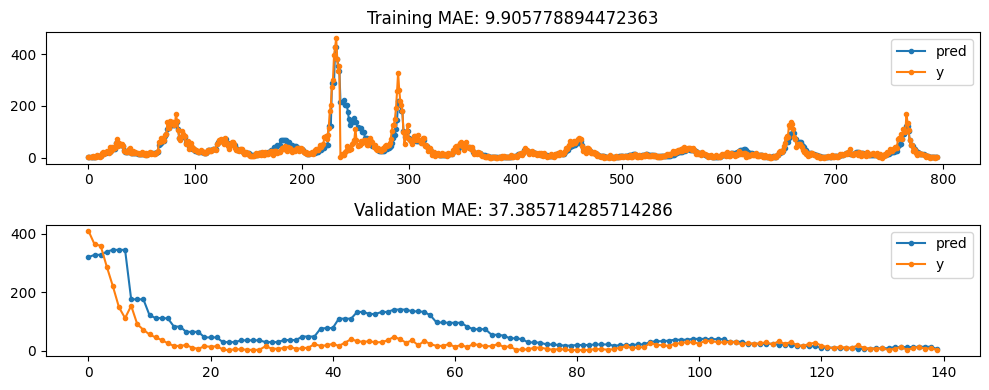

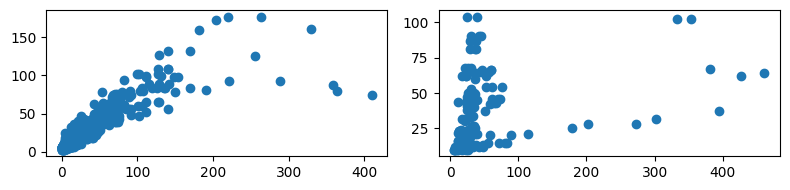

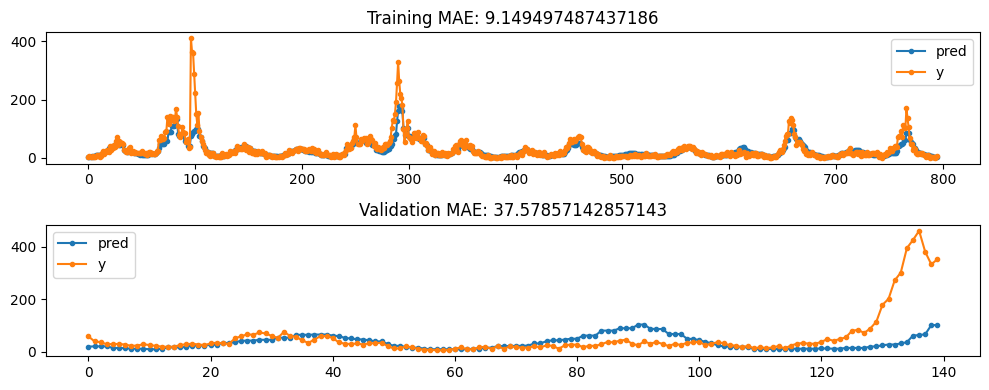

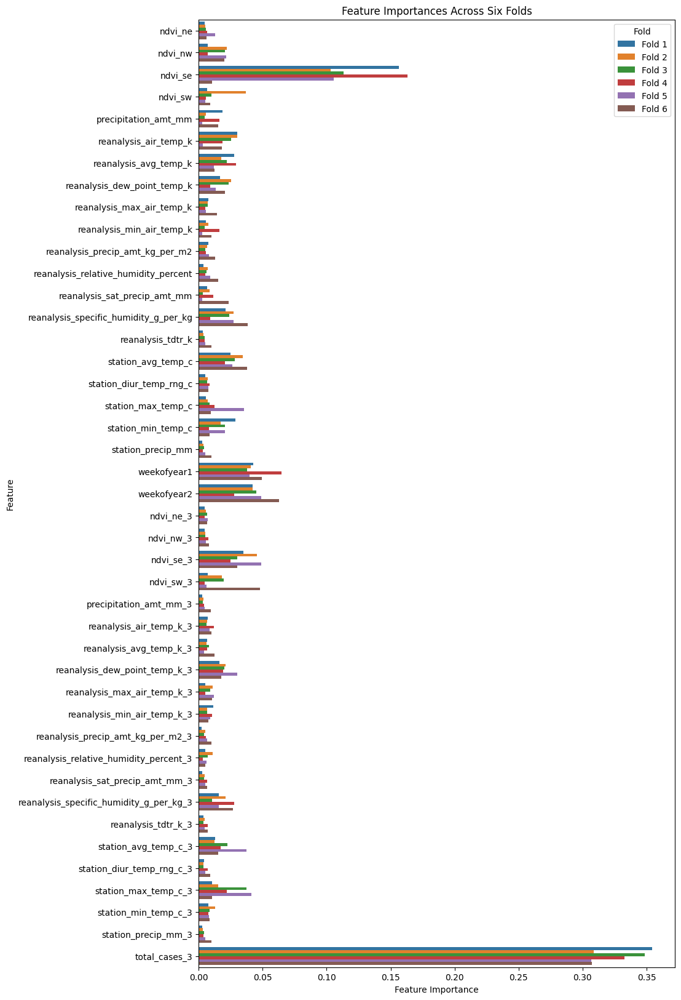

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


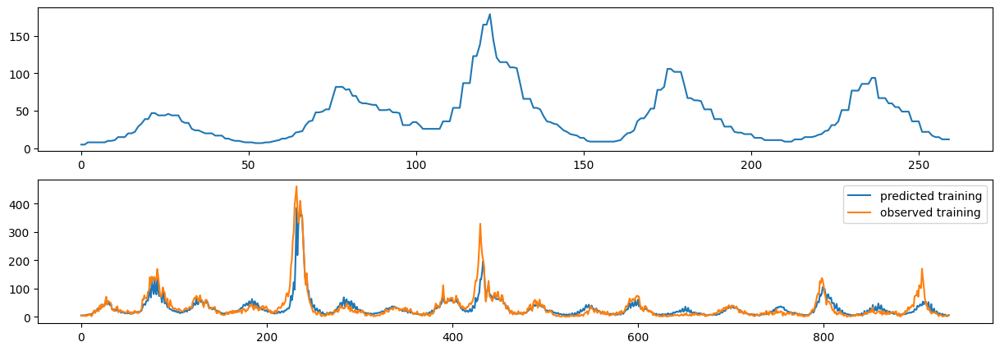

In [50]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,)
# label_lags=None
feature_lags = (3,)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=2000,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

#### label lags 1 to 5, feature lags 3, lag weights 100, 80, 50, 2000 n_estimators

In [32]:
# Close to original best scoring
# Specify modelling parameters
lags_considered = [1,2,3,4,5]
all_label_lags=[]
for r in range(1, len(lags_considered) + 1):
    all_label_lags.extend(combinations(lags_considered, r))
all_train_maes = []
all_val_maes = []

for label_lags in all_label_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for label lag {label_lags}')
    feature_lags = (3,)
    folds = 6
    fold_size = 0.15
    xg_reg_sj = []
    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 100
        
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=2000,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for label lag (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32

In [37]:
df_train_maes_100 = pd.DataFrame(all_train_maes)
df_train_maes_100 = df_train_maes_100.map(lambda x:x[0].item())

df_val_maes_100 = pd.DataFrame(all_val_maes)
df_val_maes_100 = df_val_maes_100.map(lambda x:x[0].item())


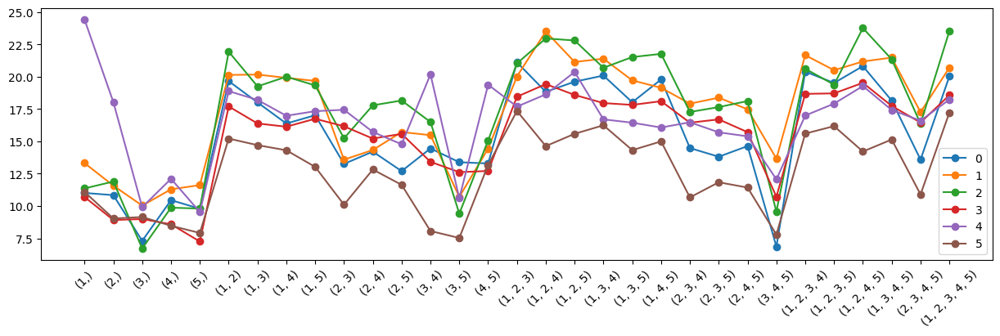

In [39]:
plt.figure(figsize=(15, 4))
for column in df_train_maes_100.columns:
    plt.plot(df_train_maes_100[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend()

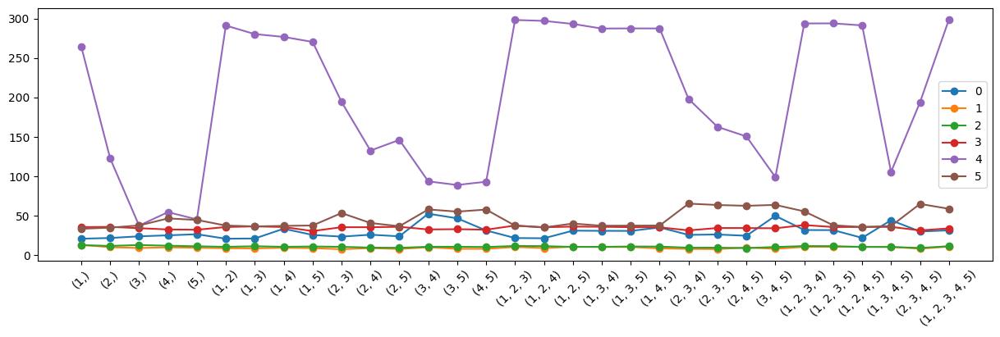

In [40]:
plt.figure(figsize=(15, 4))
for column in df_val_maes_100.columns:
    plt.plot(df_val_maes_100[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend();

In [41]:
# Close to original best scoring
# Specify modelling parameters
lags_considered = [1,2,3,4,5]
all_label_lags=[]
for r in range(1, len(lags_considered) + 1):
    all_label_lags.extend(combinations(lags_considered, r))
all_train_maes = []
all_val_maes = []

for label_lags in all_label_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for label lag {label_lags}')
    feature_lags = (3,)
    folds = 6
    fold_size = 0.15
    xg_reg_sj = []
    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 80
        
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=2000,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for label lag (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32

In [42]:
df_train_maes_80 = pd.DataFrame(all_train_maes)
df_train_maes_80 = df_train_maes_80.map(lambda x:x[0].item())

df_val_maes_80 = pd.DataFrame(all_val_maes)
df_val_maes_80 = df_val_maes_80.map(lambda x:x[0].item())


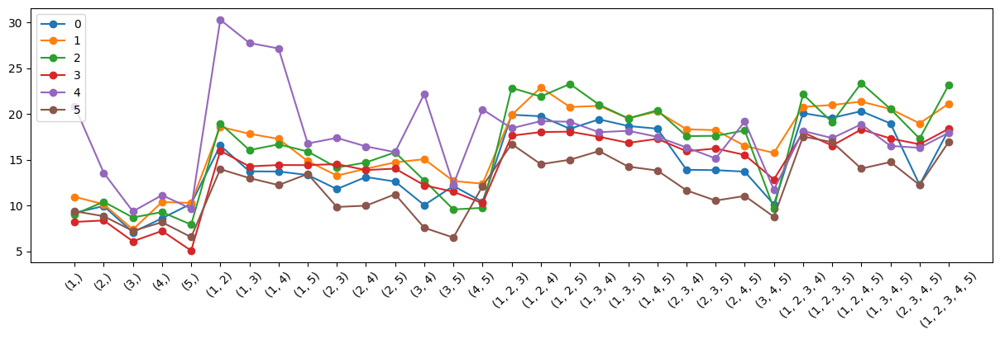

In [43]:
plt.figure(figsize=(15, 4))
for column in df_train_maes_80.columns:
    plt.plot(df_train_maes_80[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend()

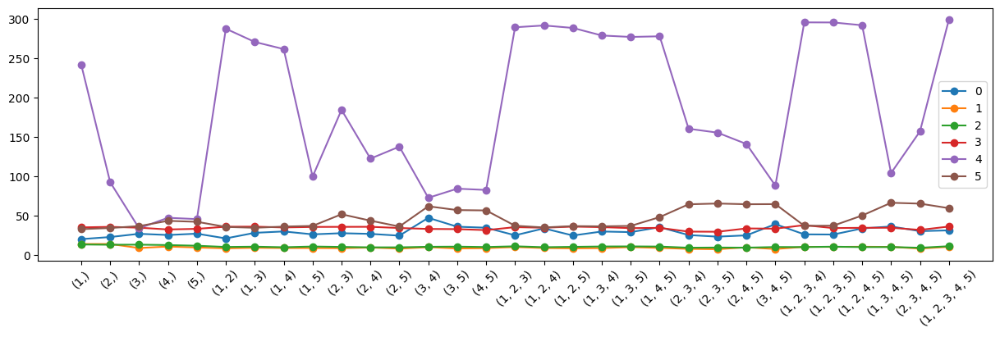

In [44]:
plt.figure(figsize=(15, 4))
for column in df_val_maes_80.columns:
    plt.plot(df_val_maes_80[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend();

In [45]:
# Close to original best scoring
# Specify modelling parameters
lags_considered = [1,2,3,4,5]
all_label_lags=[]
for r in range(1, len(lags_considered) + 1):
    all_label_lags.extend(combinations(lags_considered, r))
all_train_maes = []
all_val_maes = []

for label_lags in all_label_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for label lag {label_lags}')
    feature_lags = (3,)
    folds = 6
    fold_size = 0.15
    xg_reg_sj = []
    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 50
        
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=2000,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for label lag (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32

In [46]:
df_train_maes_50 = pd.DataFrame(all_train_maes)
df_train_maes_50 = df_train_maes_50.map(lambda x:x[0].item())

df_val_maes_50 = pd.DataFrame(all_val_maes)
df_val_maes_50 = df_val_maes_50.map(lambda x:x[0].item())


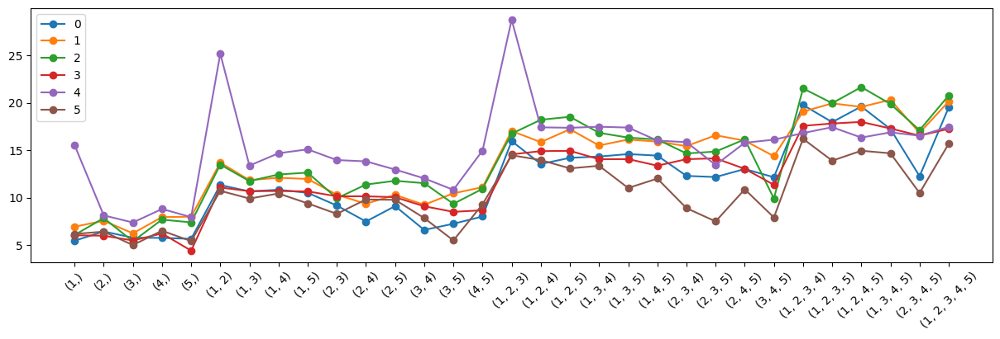

In [47]:
plt.figure(figsize=(15, 4))
for column in df_train_maes_50.columns:
    plt.plot(df_train_maes_50[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend()

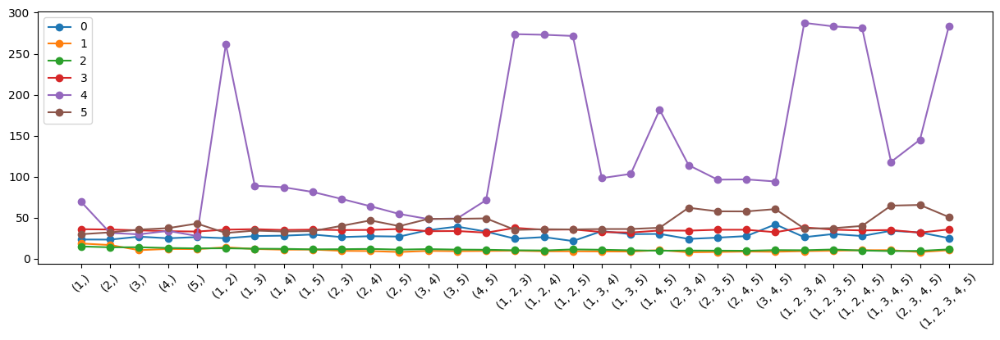

In [48]:
plt.figure(figsize=(15, 4))
for column in df_val_maes_50.columns:
    plt.plot(df_val_maes_50[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend();

#### label lags 1 to 5, feature lags 3, lag weights 100, 80, 50, 1000 n_estimators

In [52]:
# Close to original best scoring
# Specify modelling parameters
lags_considered = [1,2,3,4,5]
all_label_lags=[]
for r in range(1, len(lags_considered) + 1):
    all_label_lags.extend(combinations(lags_considered, r))
all_train_maes = []
all_val_maes = []

for label_lags in all_label_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for label lag {label_lags}')
    feature_lags = (3,)
    folds = 6
    fold_size = 0.15
    xg_reg_sj = []
    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 100
        
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for label lag (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32

In [53]:
df_train_maes_100 = pd.DataFrame(all_train_maes)
df_train_maes_100 = df_train_maes_100.map(lambda x:x[0].item())

df_val_maes_100 = pd.DataFrame(all_val_maes)
df_val_maes_100 = df_val_maes_100.map(lambda x:x[0].item())


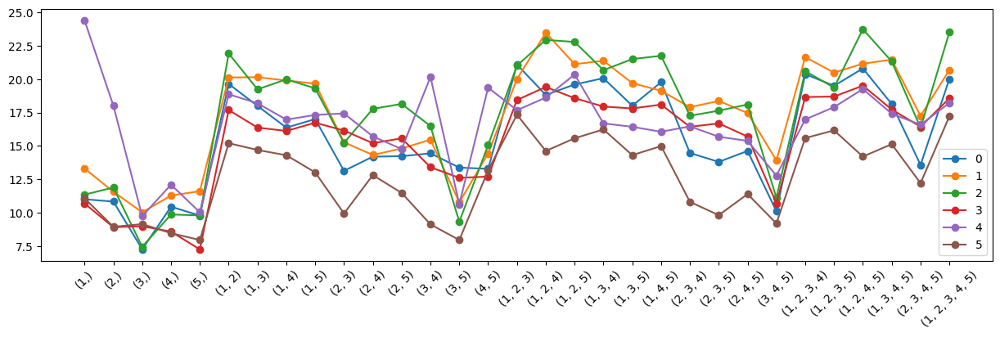

In [54]:
plt.figure(figsize=(15, 4))
for column in df_train_maes_100.columns:
    plt.plot(df_train_maes_100[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend()

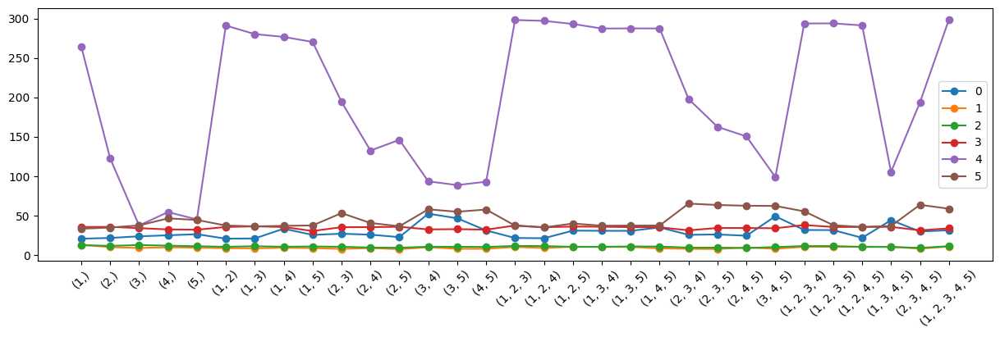

In [55]:
plt.figure(figsize=(15, 4))
for column in df_val_maes_100.columns:
    plt.plot(df_val_maes_100[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend();

In [56]:
# Close to original best scoring
# Specify modelling parameters
lags_considered = [1,2,3,4,5]
all_label_lags=[]
for r in range(1, len(lags_considered) + 1):
    all_label_lags.extend(combinations(lags_considered, r))
all_train_maes = []
all_val_maes = []

for label_lags in all_label_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for label lag {label_lags}')
    feature_lags = (3,)
    folds = 6
    fold_size = 0.15
    xg_reg_sj = []
    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 80
        
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for label lag (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32

In [57]:
df_train_maes_80 = pd.DataFrame(all_train_maes)
df_train_maes_80 = df_train_maes_80.map(lambda x:x[0].item())

df_val_maes_80 = pd.DataFrame(all_val_maes)
df_val_maes_80 = df_val_maes_80.map(lambda x:x[0].item())


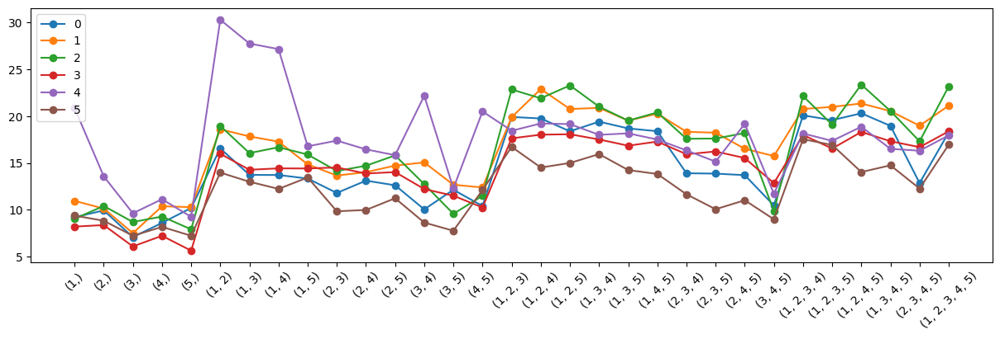

In [58]:
plt.figure(figsize=(15, 4))
for column in df_train_maes_80.columns:
    plt.plot(df_train_maes_80[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend()

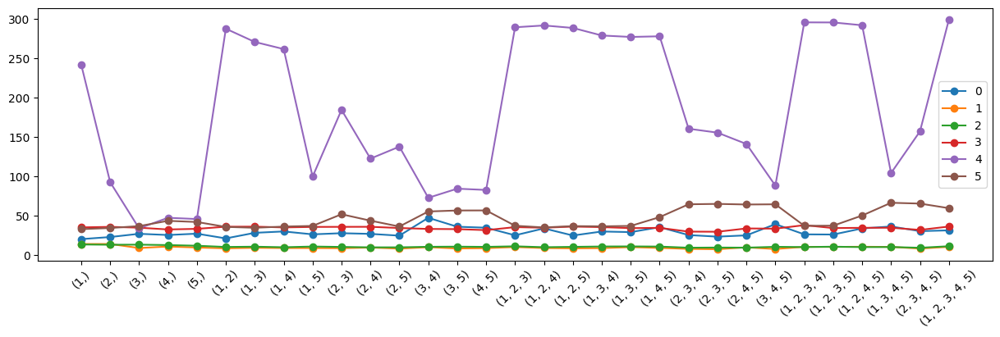

In [59]:
plt.figure(figsize=(15, 4))
for column in df_val_maes_80.columns:
    plt.plot(df_val_maes_80[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend();

In [60]:
# Close to original best scoring
# Specify modelling parameters
lags_considered = [1,2,3,4,5]
all_label_lags=[]
for r in range(1, len(lags_considered) + 1):
    all_label_lags.extend(combinations(lags_considered, r))
all_train_maes = []
all_val_maes = []

for label_lags in all_label_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for label lag {label_lags}')
    feature_lags = (3,)
    folds = 6
    fold_size = 0.15
    xg_reg_sj = []
    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 50
        
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for label lag (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32

In [61]:
df_train_maes_50 = pd.DataFrame(all_train_maes)
df_train_maes_50 = df_train_maes_50.map(lambda x:x[0].item())

df_val_maes_50 = pd.DataFrame(all_val_maes)
df_val_maes_50 = df_val_maes_50.map(lambda x:x[0].item())


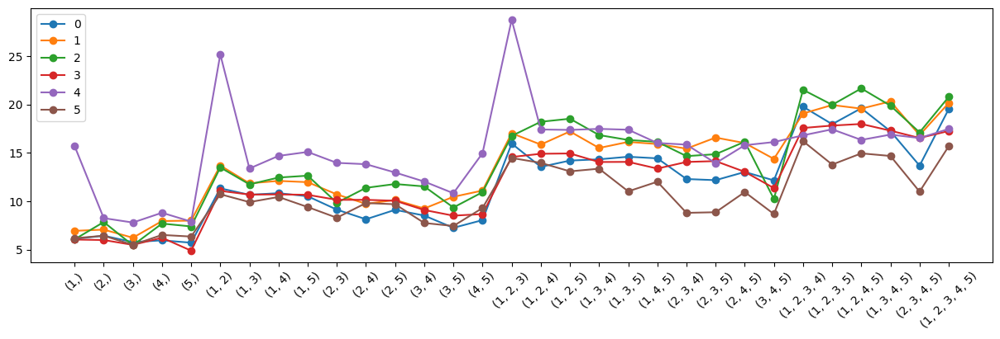

In [62]:
plt.figure(figsize=(15, 4))
for column in df_train_maes_50.columns:
    plt.plot(df_train_maes_50[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend()

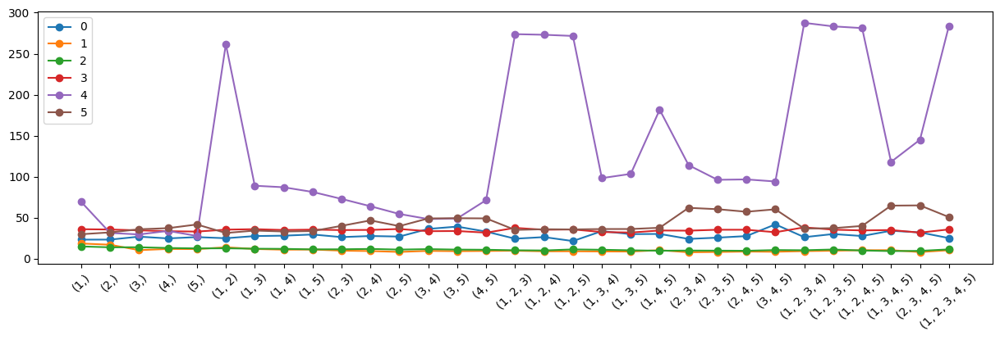

In [63]:
plt.figure(figsize=(15, 4))
for column in df_val_maes_50.columns:
    plt.plot(df_val_maes_50[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend();

#### feature lag check, label lag at (3,4), 400~500 n_estimators, investigate label lag weight

label lag weight at 10 seems to give consistently low errors, but large fluctuation in importance between folds for ndvi_se. indicative of overfitting to specific folds? label alg weight at 50 seems a bit more stable, and provides improvement on all folds compared to current best case. of sub14/31


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

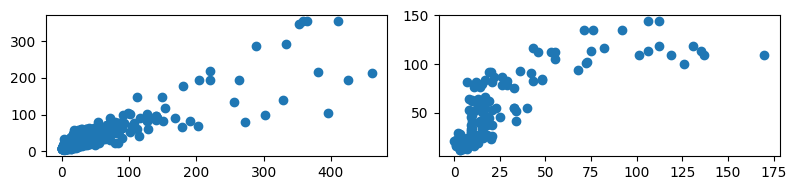

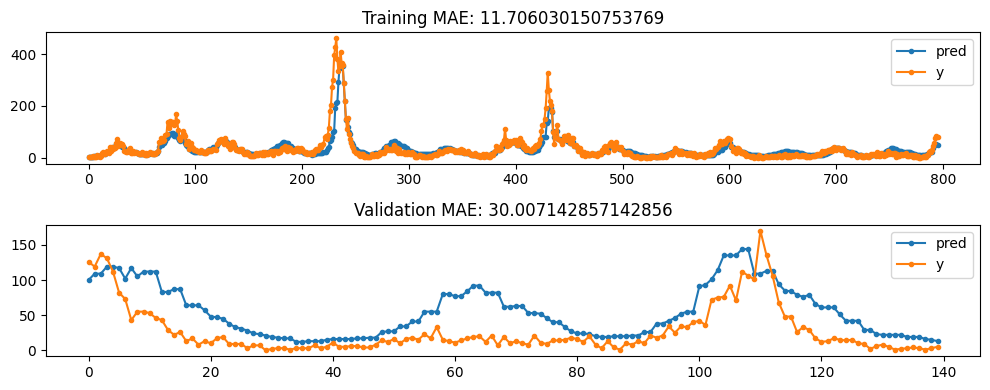

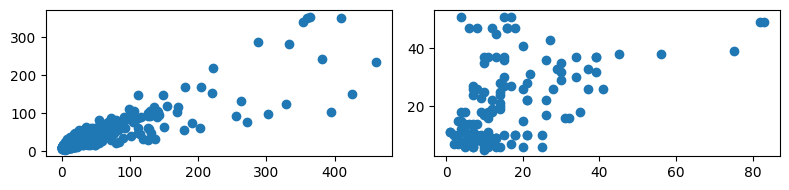

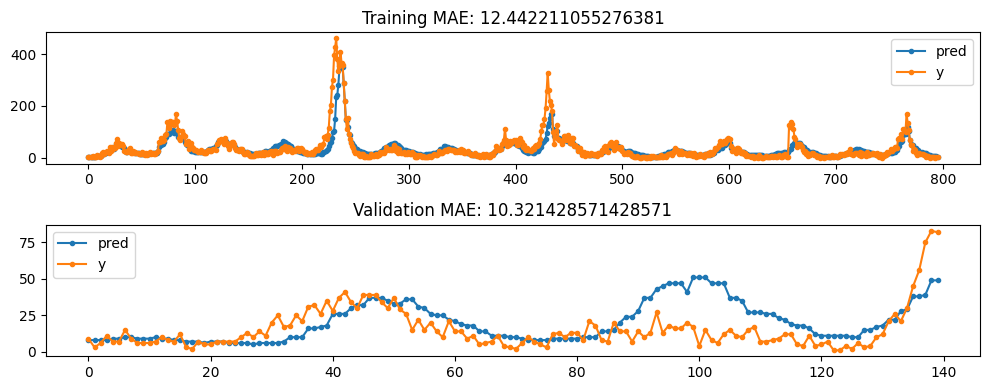

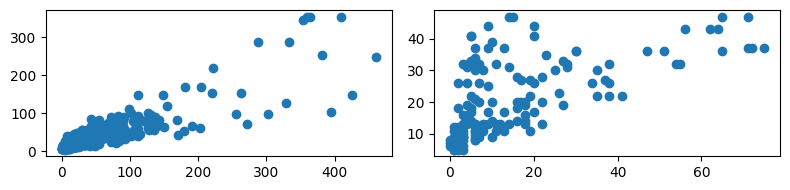

...

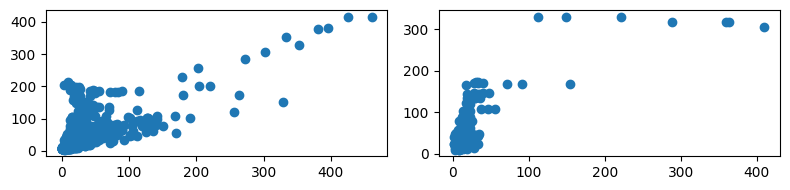

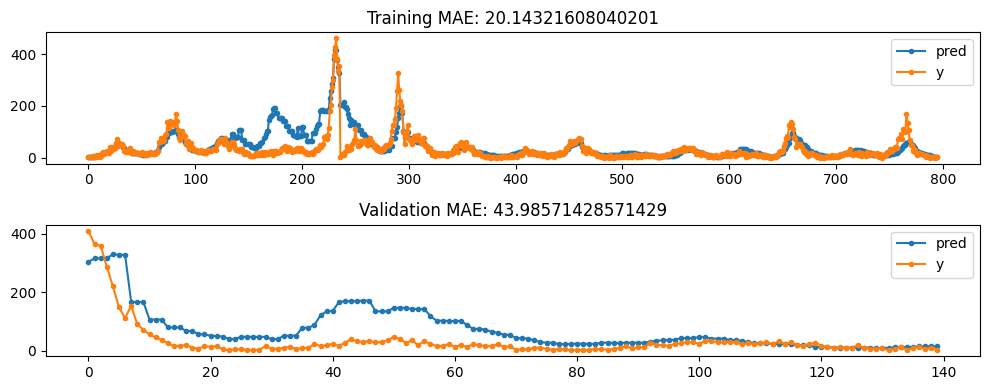

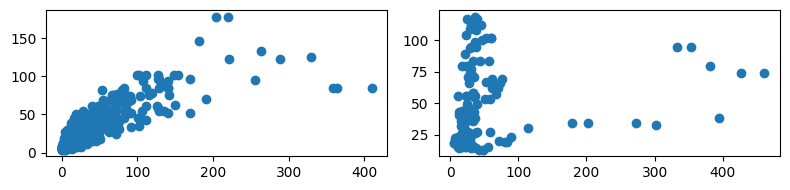

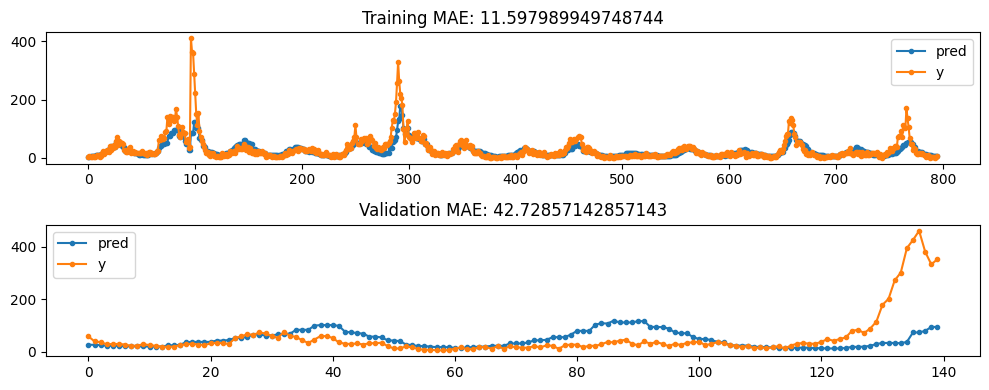

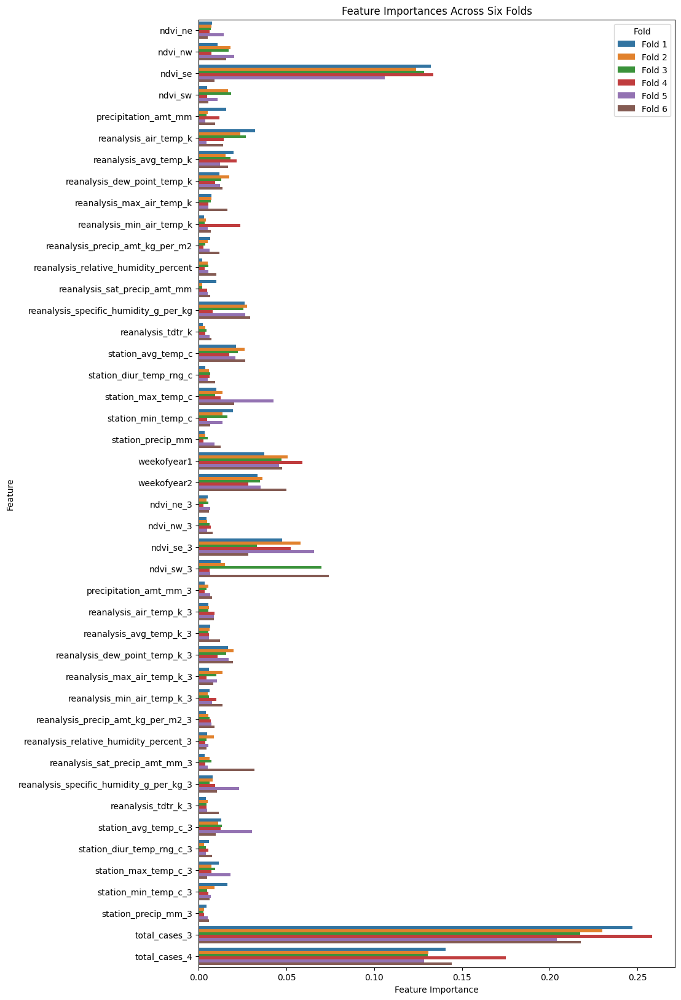

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


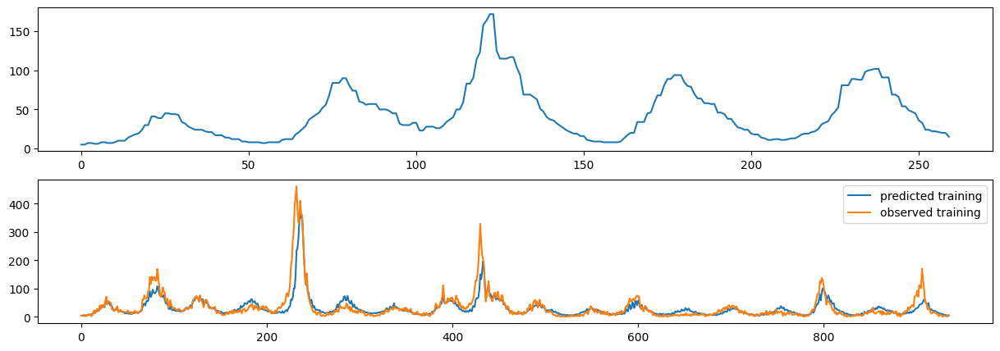

In [41]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 50

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

In [15]:
# Close to original best scoring
# Specify modelling parameters
all_train_maes = []
all_val_maes = []
all_feature_lags = [(1,),(2,),(3,),(4,),(5,)]
all_feature_lags += [tuple(range(n,n+5)) for n in range(1,15)]

for feature_lags in all_feature_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for feature lags {feature_lags}')
    label_lags = (3,4)
    folds = 6
    fold_size = 0.15

    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 100

    xg_reg_sj = []
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for feature lags (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             F

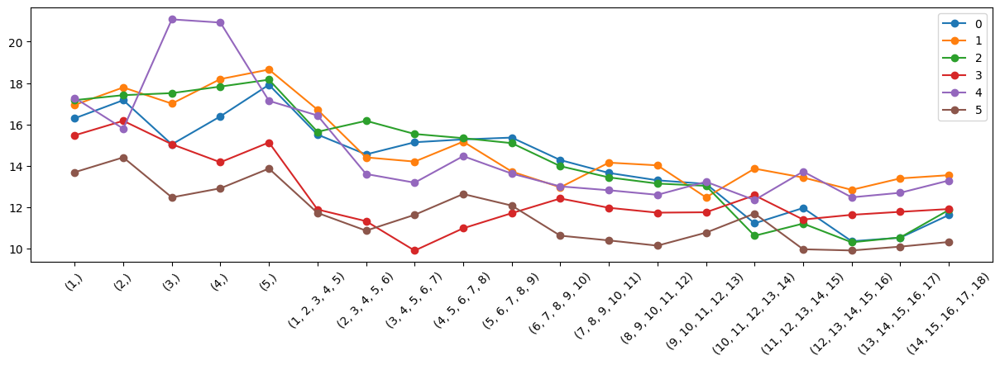

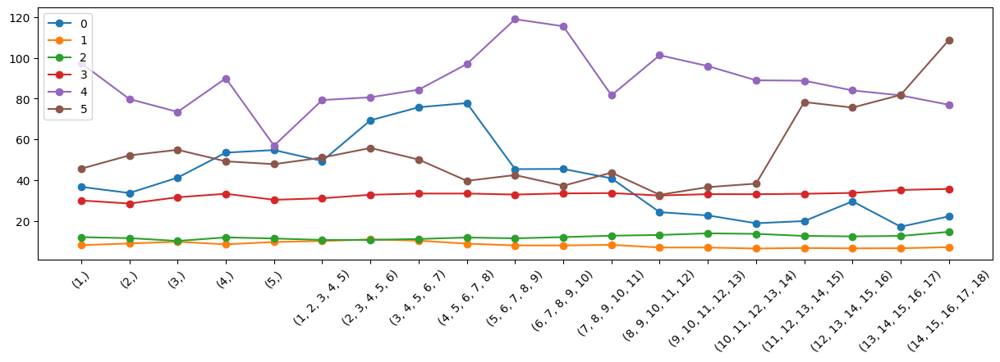

In [17]:
df_train_maes_100 = pd.DataFrame(all_train_maes)
df_train_maes_100 = df_train_maes_100.map(lambda x:x[0].item())

df_val_maes_100 = pd.DataFrame(all_val_maes)
df_val_maes_100 = df_val_maes_100.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_100.columns:
    plt.plot(df_train_maes_100[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_100.columns:
    plt.plot(df_val_maes_100[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend();

In [18]:
# Close to original best scoring
# Specify modelling parameters
all_train_maes = []
all_val_maes = []
all_feature_lags = [(1,),(2,),(3,),(4,),(5,),(6,),(7,),(8,)]
all_feature_lags += [tuple(range(n,n+2)) for n in range(1,18)]
all_feature_lags += [tuple(range(n,n+3)) for n in range(1,18)]

for feature_lags in all_feature_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for feature lags {feature_lags}')
    label_lags = (3,4)
    folds = 6
    fold_size = 0.15

    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 100

    xg_reg_sj = []
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for feature lags (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             F

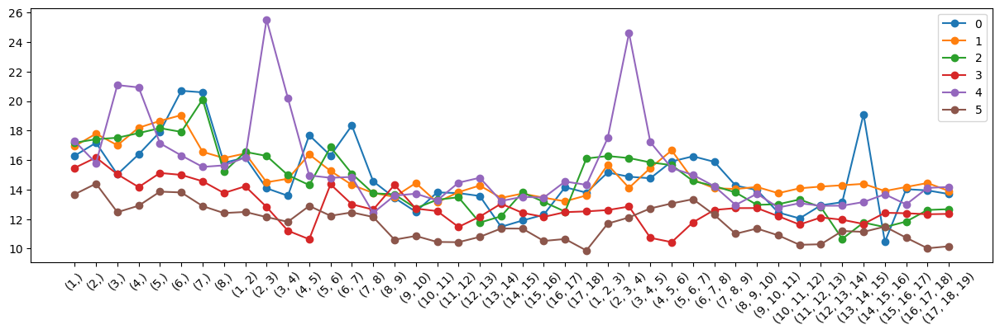

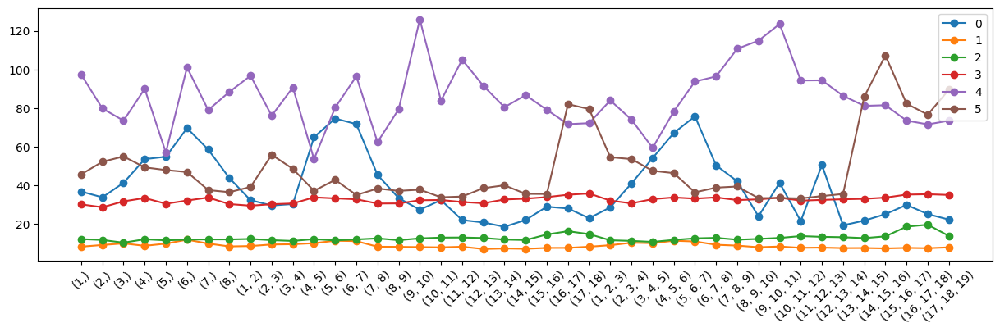

In [19]:
df_train_maes_100 = pd.DataFrame(all_train_maes)
df_train_maes_100 = df_train_maes_100.map(lambda x:x[0].item())

df_val_maes_100 = pd.DataFrame(all_val_maes)
df_val_maes_100 = df_val_maes_100.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_100.columns:
    plt.plot(df_train_maes_100[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_100.columns:
    plt.plot(df_val_maes_100[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend();

In [20]:
# Close to original best scoring
# Specify modelling parameters
all_train_maes = []
all_val_maes = []
all_feature_lags = [(1,),(2,),(3,),(4,),(5,),(6,),(7,),(8,)]
all_feature_lags += [tuple(range(n,n+2)) for n in range(1,18)]
all_feature_lags += [tuple(range(n,n+3)) for n in range(1,18)]
all_feature_lags += [tuple(range(n,n+5)) for n in range(1,15)]

for feature_lags in all_feature_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for feature lags {feature_lags}')
    label_lags = (3,4)
    folds = 6
    fold_size = 0.15

    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 50

    xg_reg_sj = []
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for feature lags (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             F

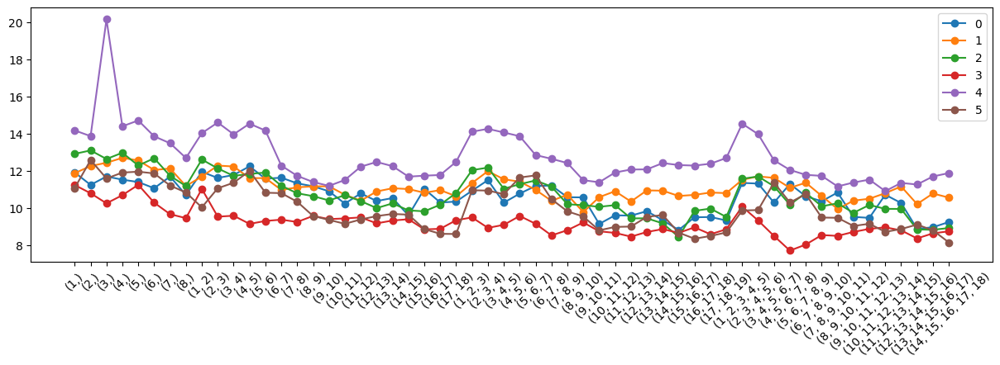

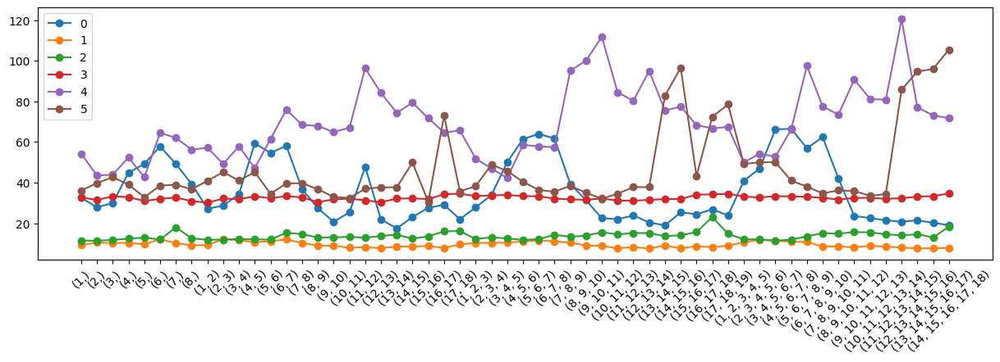

In [21]:
df_train_maes_50 = pd.DataFrame(all_train_maes)
df_train_maes_50 = df_train_maes_50.map(lambda x:x[0].item())

df_val_maes_50 = pd.DataFrame(all_val_maes)
df_val_maes_50 = df_val_maes_50.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_50.columns:
    plt.plot(df_train_maes_50[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_50.columns:
    plt.plot(df_val_maes_50[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend();

In [24]:
# Close to original best scoring
# Specify modelling parameters
all_train_maes = []
all_val_maes = []
all_feature_lags = [(1,),(2,),(3,),(4,),(5,),(6,),(7,),(8,)]
all_feature_lags += [tuple(range(n,n+2)) for n in range(1,18)]
all_feature_lags += [tuple(range(n,n+3)) for n in range(1,18)]
all_feature_lags += [tuple(range(n,n+5)) for n in range(1,15)]

for feature_lags in all_feature_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for feature lags {feature_lags}')
    label_lags = (3,4)
    folds = 6
    fold_size = 0.15

    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 10

    xg_reg_sj = []
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for feature lags (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             F

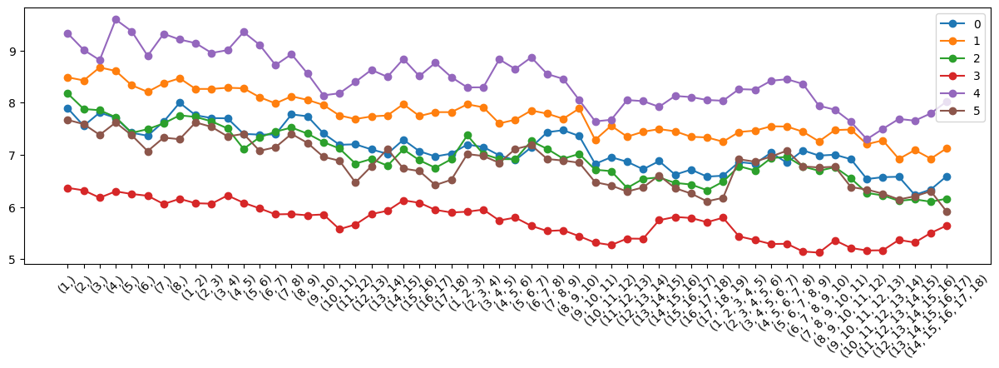

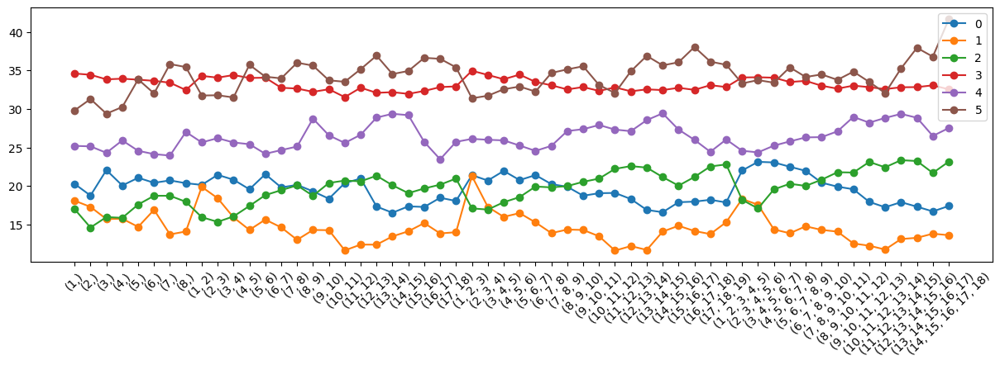

In [25]:
df_train_maes_10 = pd.DataFrame(all_train_maes)
df_train_maes_10 = df_train_maes_10.map(lambda x:x[0].item())

df_val_maes_10 = pd.DataFrame(all_val_maes)
df_val_maes_10 = df_val_maes_10.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_10.columns:
    plt.plot(df_train_maes_10[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_10.columns:
    plt.plot(df_val_maes_10[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend();

In [ ]:
# Close to original best scoring
# Specify modelling parameters
all_train_maes = []
all_val_maes = []
all_feature_lags = [(1,),(2,),(3,),(4,),(5,)]
all_feature_lags += [tuple(range(n,n+5)) for n in range(1,15)]

for feature_lags in all_feature_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for feature lags {feature_lags}')
    label_lags = (3,4)
    folds = 6
    fold_size = 0.15

    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 80

    xg_reg_sj = []
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)

In [ ]:
df_train_maes_80 = pd.DataFrame(all_train_maes)
df_train_maes_80 = df_train_maes_80.map(lambda x:x[0].item())

df_val_maes_80 = pd.DataFrame(all_val_maes)
df_val_maes_80 = df_val_maes_80.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_80.columns:
    plt.plot(df_train_maes_80[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_80.columns:
    plt.plot(df_val_maes_80[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend();

In [ ]:
# Close to original best scoring
# Specify modelling parameters
all_train_maes = []
all_val_maes = []
all_feature_lags = [(1,),(2,),(3,),(4,),(5,)]
all_feature_lags += [tuple(range(n,n+5)) for n in range(1,15)]

for feature_lags in all_feature_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for feature lags {feature_lags}')
    label_lags = (3,4)
    folds = 6
    fold_size = 0.15

    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 50

    xg_reg_sj = []
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)

In [ ]:
df_train_maes_50 = pd.DataFrame(all_train_maes)
df_train_maes_50 = df_train_maes_50.map(lambda x:x[0].item())

df_val_maes_50 = pd.DataFrame(all_val_maes)
df_val_maes_50 = df_val_maes_50.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_50.columns:
    plt.plot(df_train_maes_50[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_50.columns:
    plt.plot(df_val_maes_50[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend();

In [ ]:
# Close to original best scoring
# Specify modelling parameters
all_train_maes = []
all_val_maes = []
all_feature_lags = [(1,),(2,),(3,),(4,),(5,)]
all_feature_lags += [tuple(range(n,n+5)) for n in range(1,15)]

for feature_lags in all_feature_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for feature lags {feature_lags}')
    label_lags = (3,4)
    folds = 6
    fold_size = 0.15

    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']
    
    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)
    
    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)
    
    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                               sj_labels, iq_labels,
                                                               folds=6, fold_size=0.15)
    
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 30

    xg_reg_sj = []
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                         objective='reg:squarederror',
                                         reg_alpha=1,reg_lambda=1))
    
        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)

In [ ]:
df_train_maes_30 = pd.DataFrame(all_train_maes)
df_train_maes_30 = df_train_maes_30.map(lambda x:x[0].item())

df_val_maes_30 = pd.DataFrame(all_val_maes)
df_val_maes_30 = df_val_maes_30.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_30.columns:
    plt.plot(df_train_maes_30[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_30.columns:
    plt.plot(df_val_maes_30[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend();

### Recreating sub 14 (identified best case)

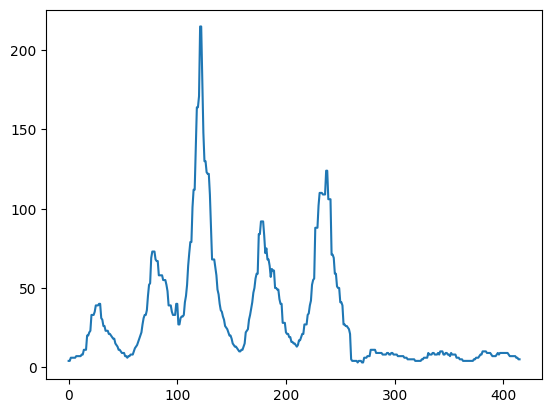

In [9]:
best_case = pd.read_csv('/home/tfc/Documents/data_driven/dengue/submission_14.csv')
plt.plot(best_case['total_cases'])


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

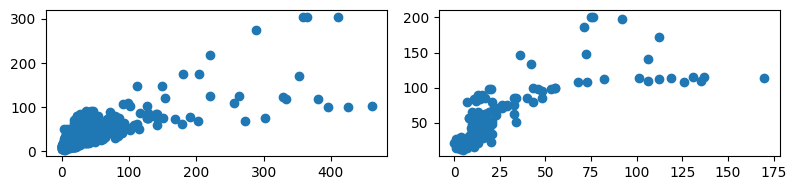

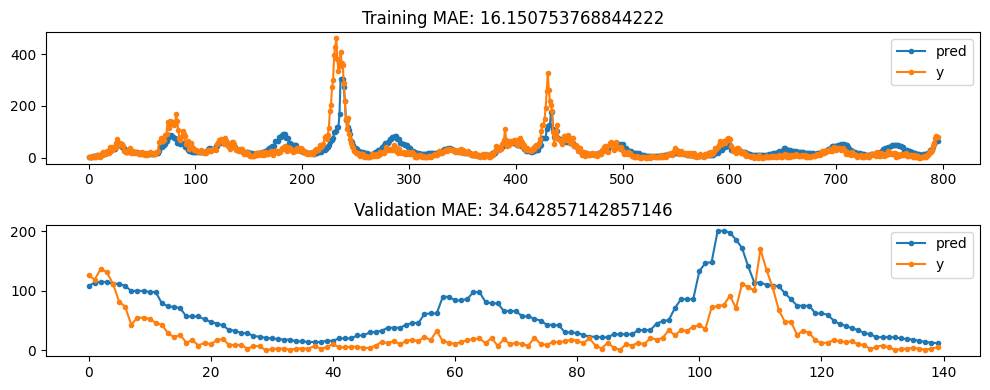

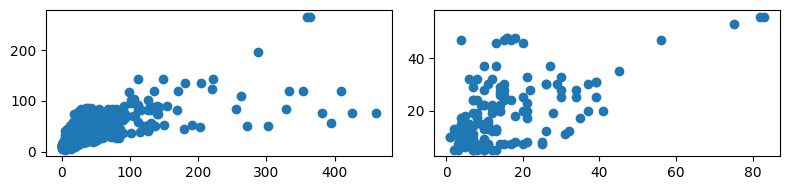

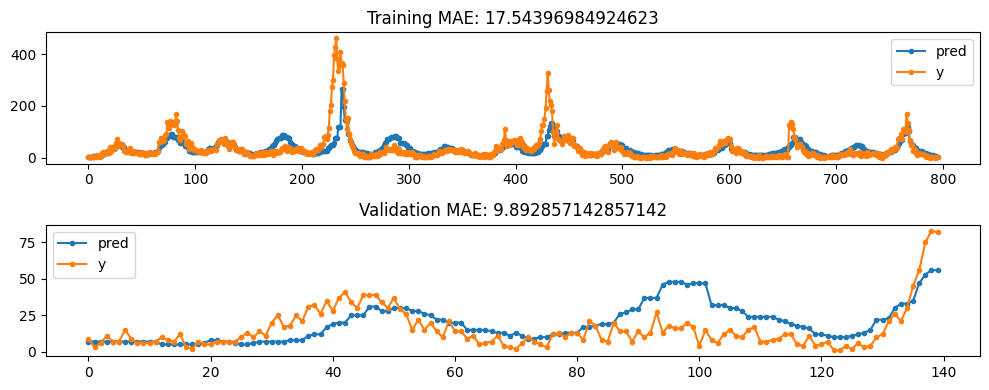

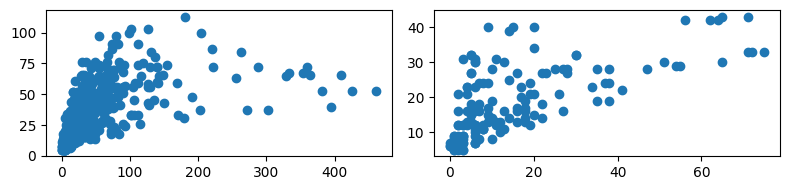

...

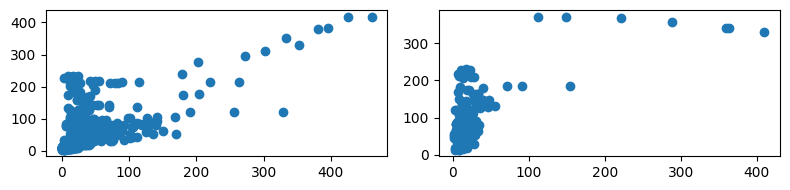

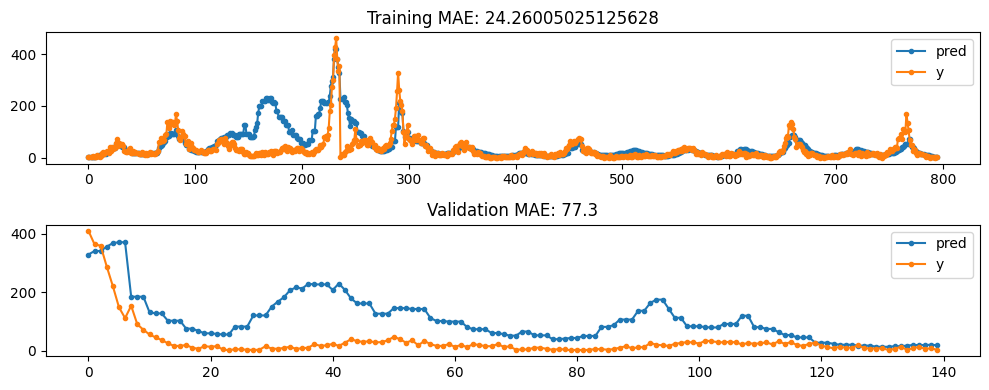

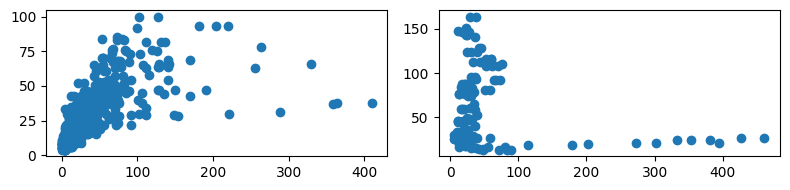

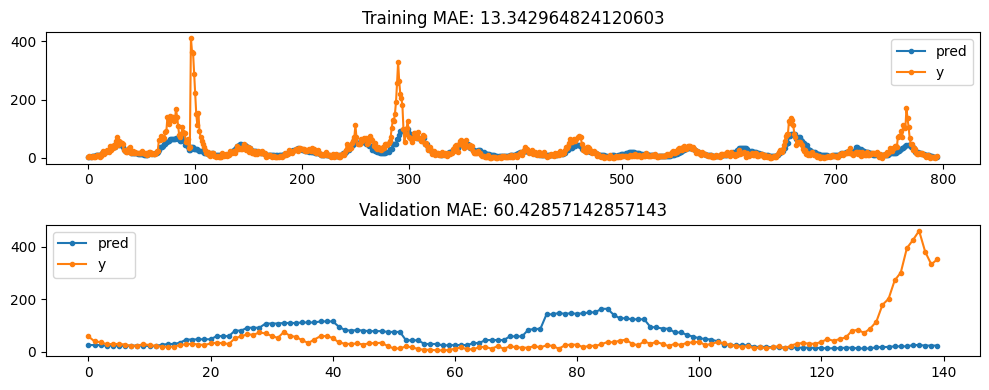

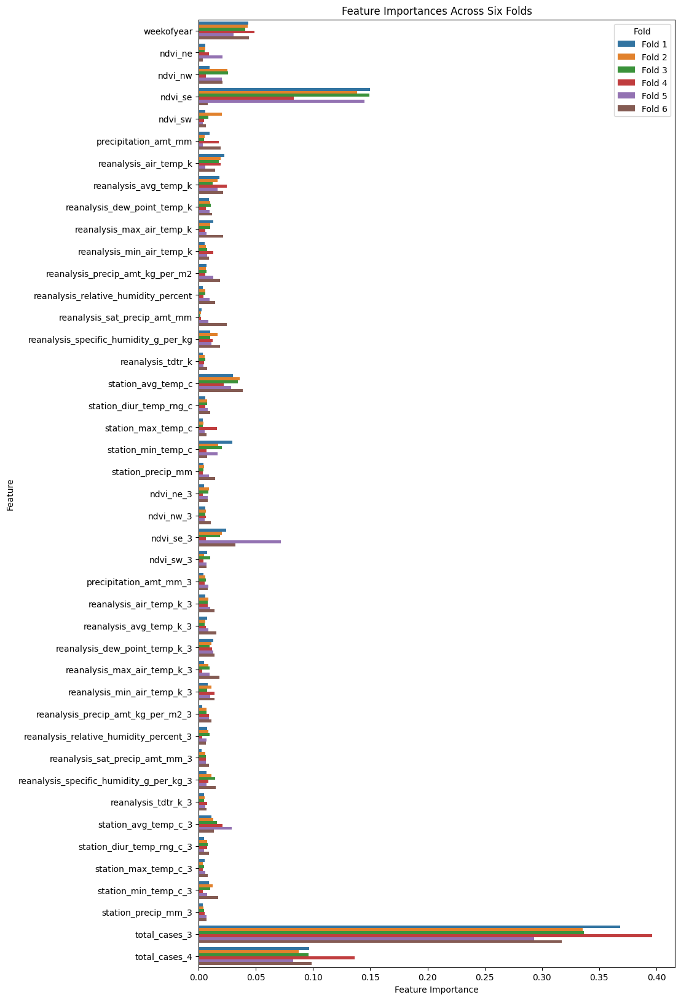

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported
MSE is 33.926923076923075


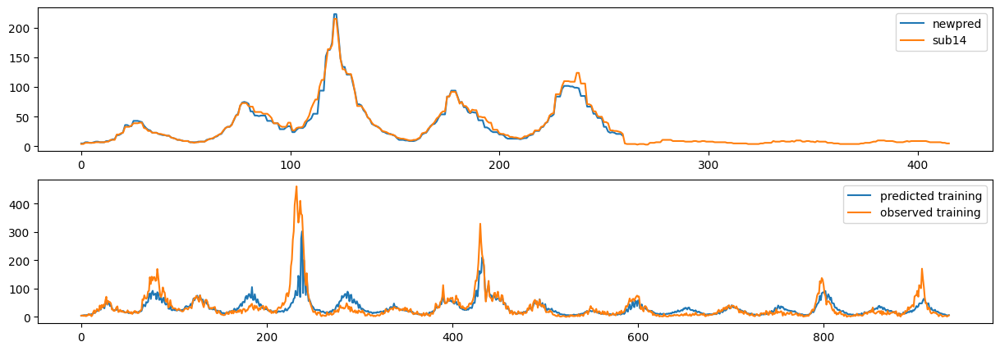

In [14]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
feature_lags = (3,)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

print(f"MSE is {mean_squared_error(best_case[best_case['city']=='sj']['total_cases'],sj_sub_pred)}")

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

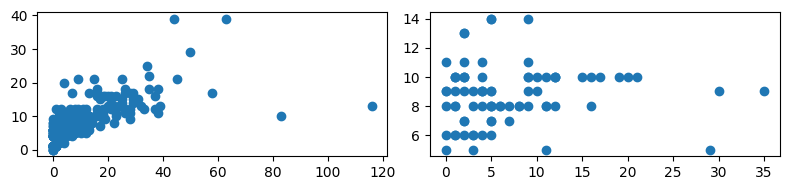

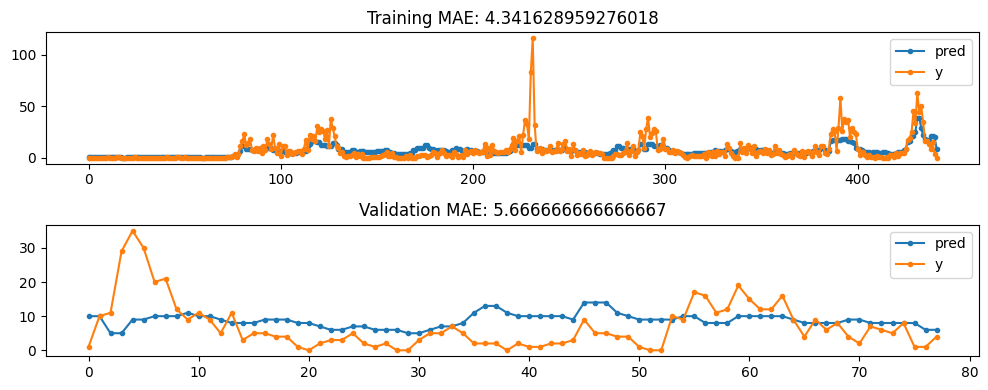

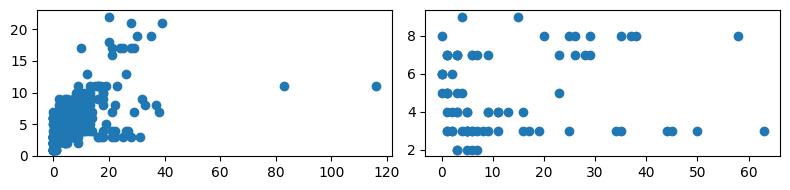

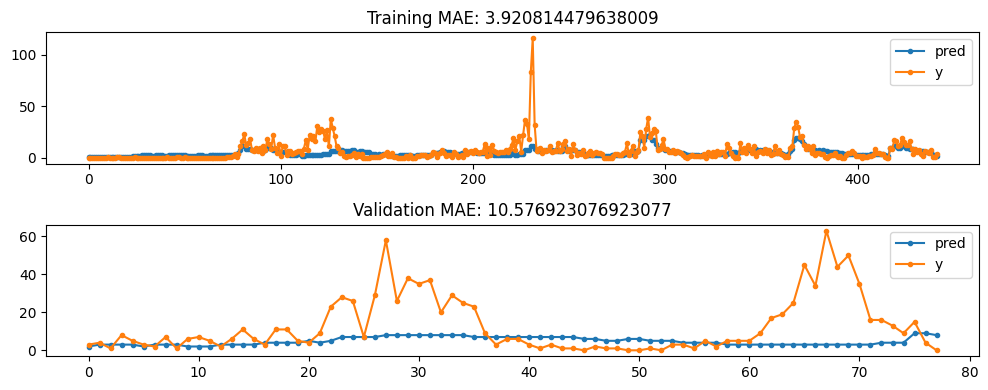

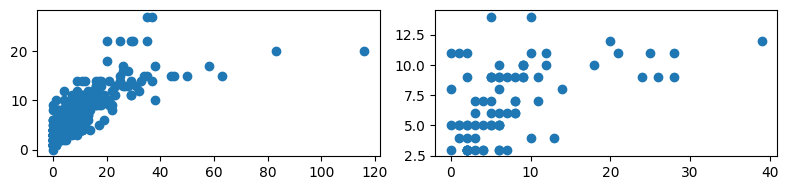

...

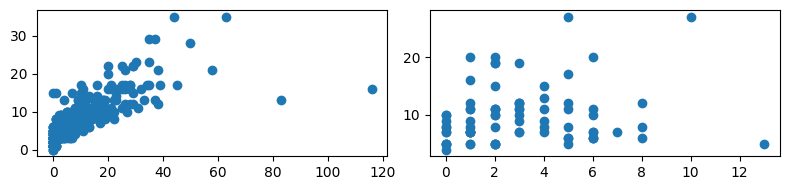

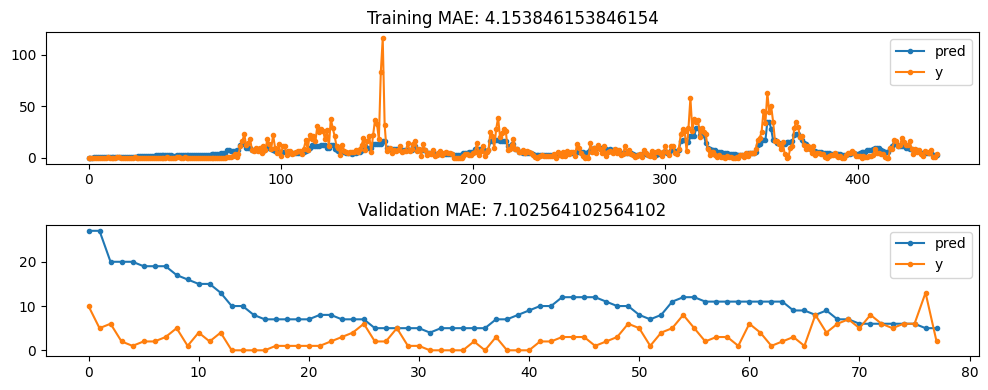

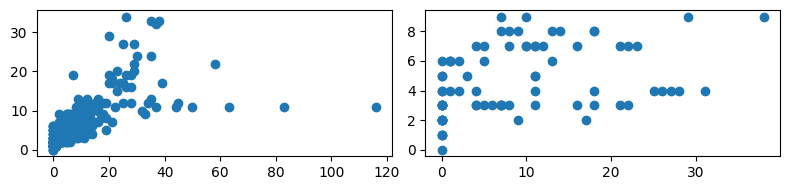

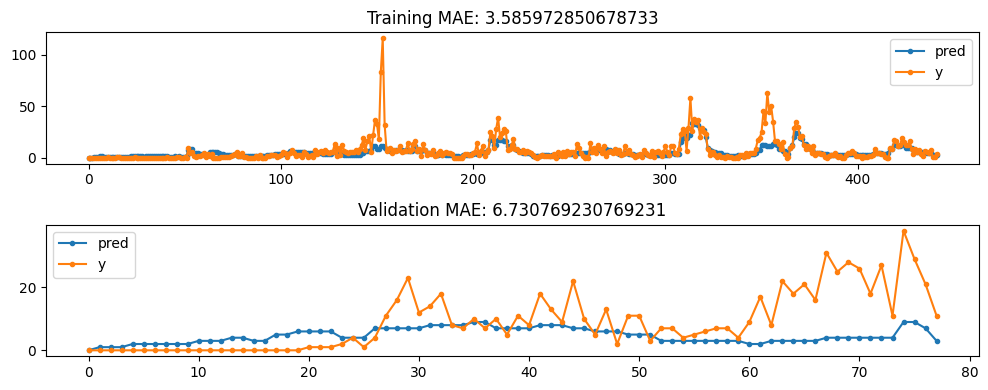

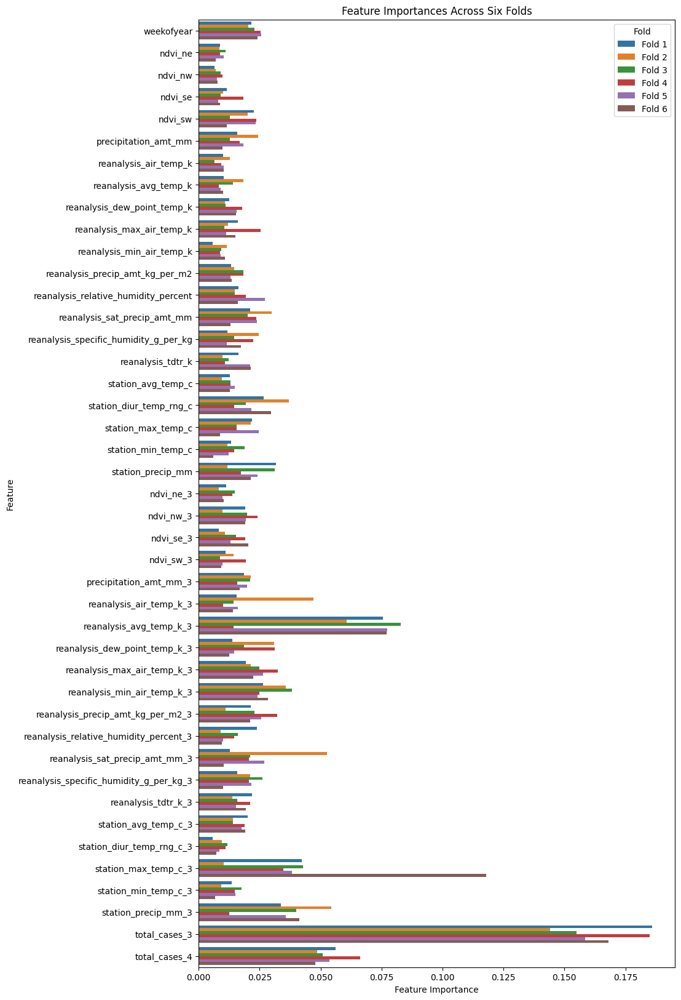

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


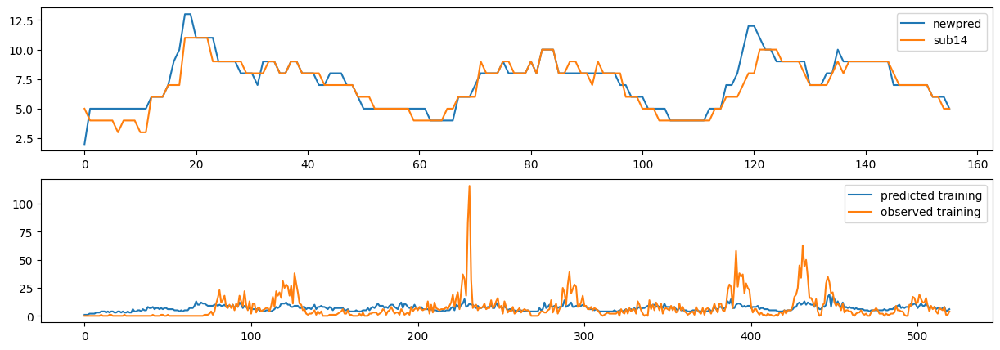

In [15]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
feature_lags = (3,)
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred,label='newpred')
axs[0].plot(best_case[best_case['city']=='iq']['total_cases'].reset_index(drop=True),label='sub14')
axs[0].legend()
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

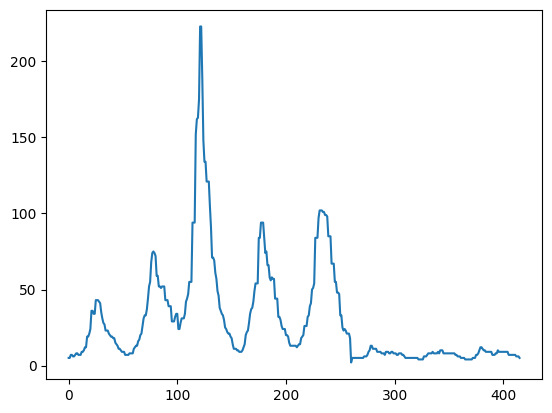

In [16]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_31.csv")

### Improving on sub14/31, trial 1

Investigated using different label weights. no real improvement that gave better prediction on drivendata hidden set.


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

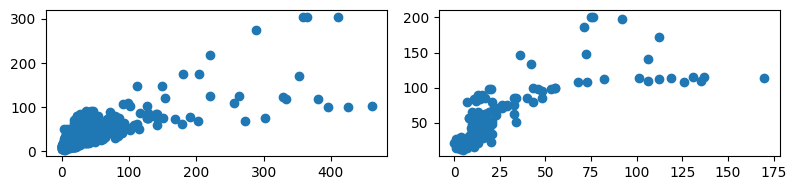

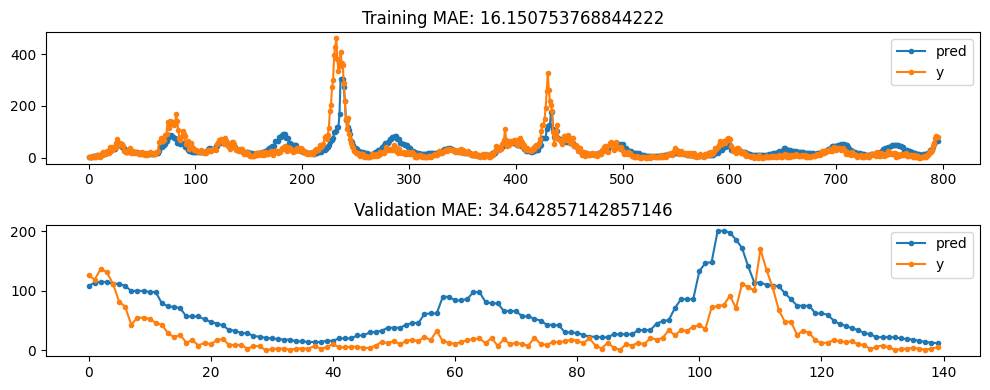

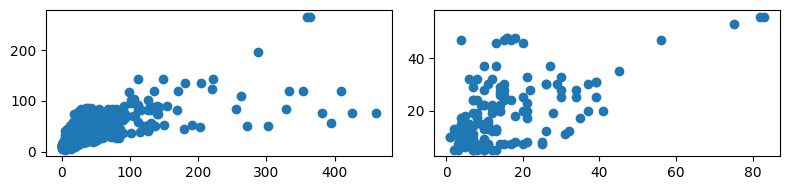

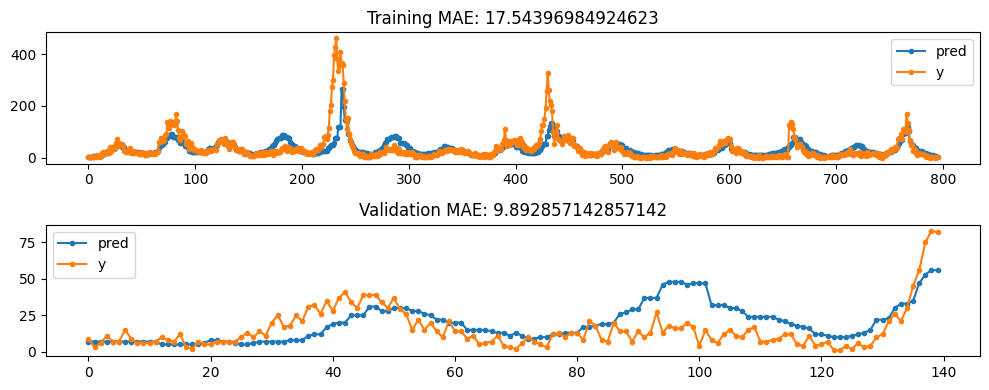

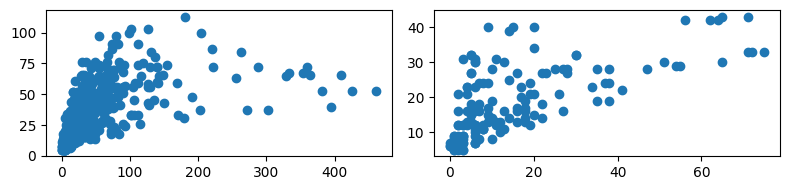

...

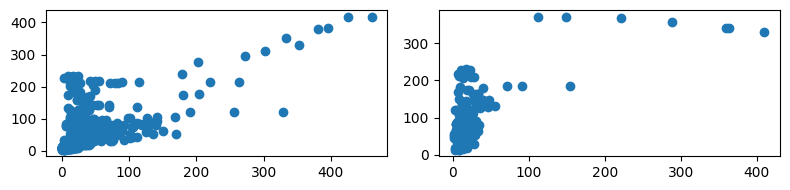

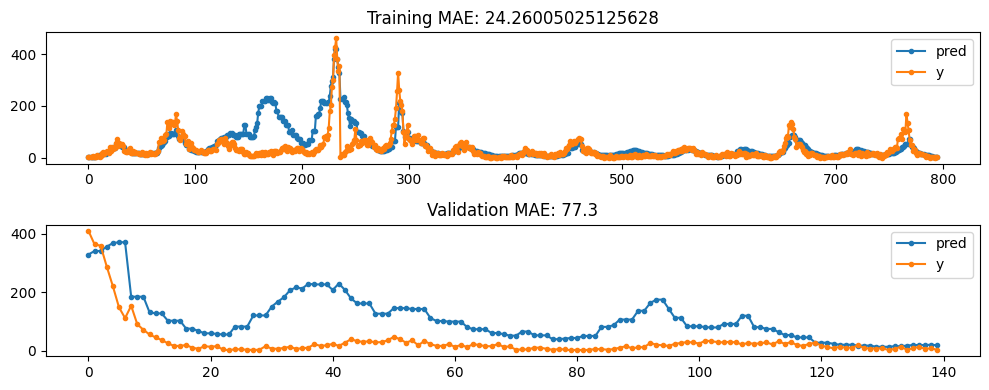

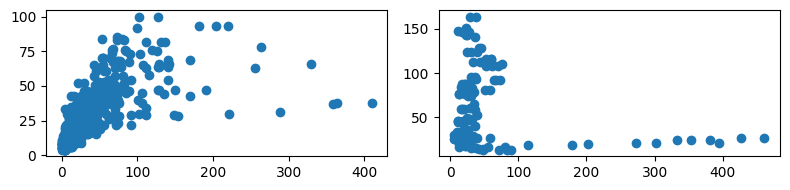

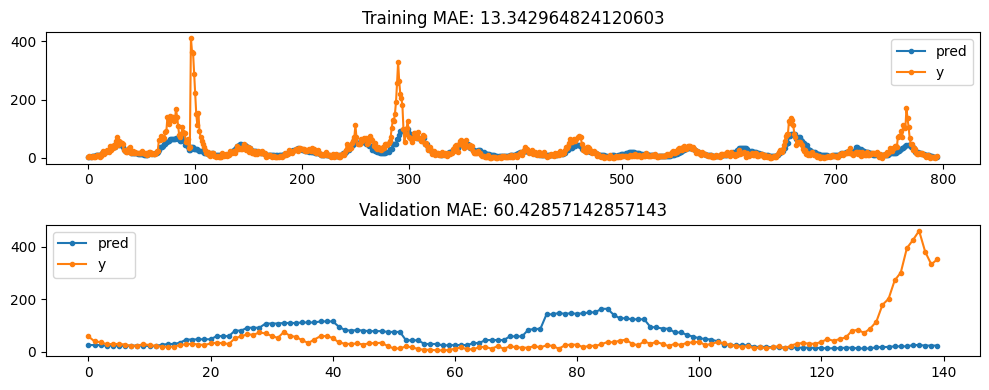

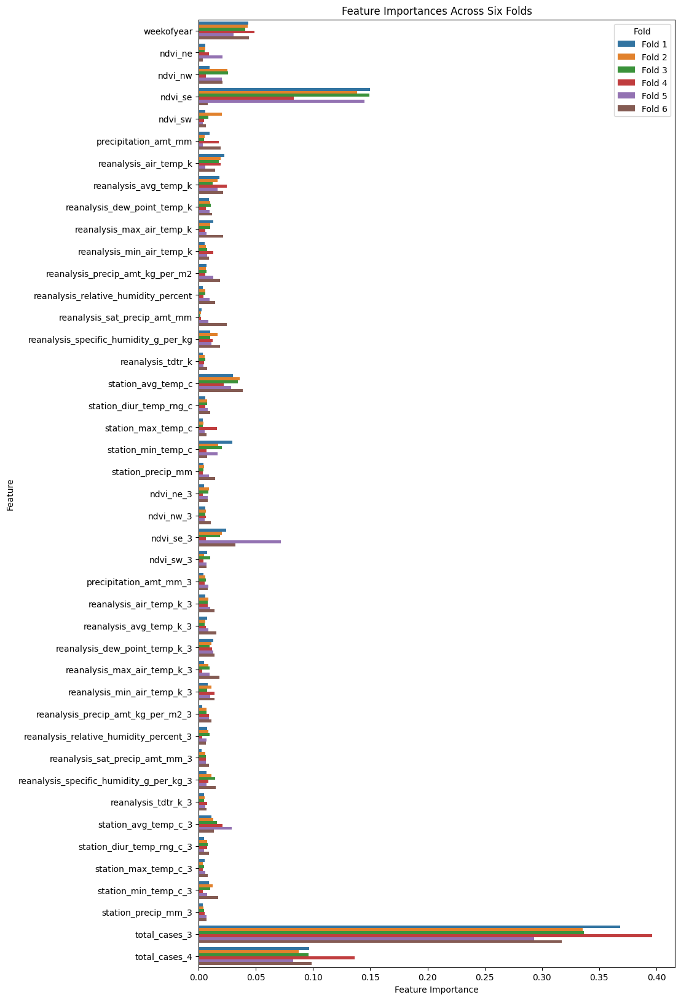

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


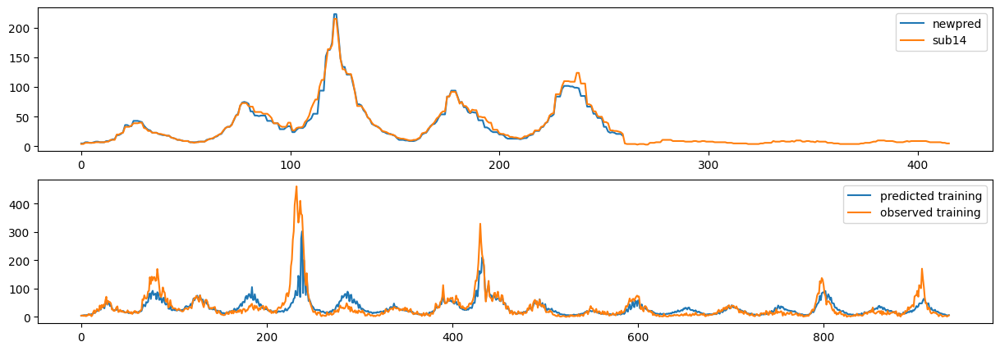

In [18]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
feature_lags = (3,)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

In [ ]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
feature_lags = (3,)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']




# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

#### param study label weights (on new circular weekofyear, not changed back to old one yet)

In [20]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
feature_lags = (3,)
folds = 6
fold_size = 0.15
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']
label_weights = [0.1,1,2,5,10,20,25,50,75,100]
all_train_maes = []
all_val_maes = []

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)


for label_weight in label_weights:
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = label_weight

    train_maes_sj = []
    val_maes_sj = []
    xg_reg_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                        objective='reg:squarederror',
                                        reg_alpha=1,reg_lambda=1))

        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

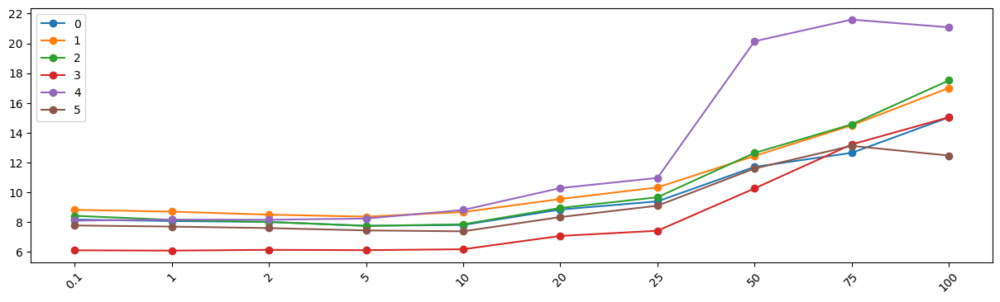

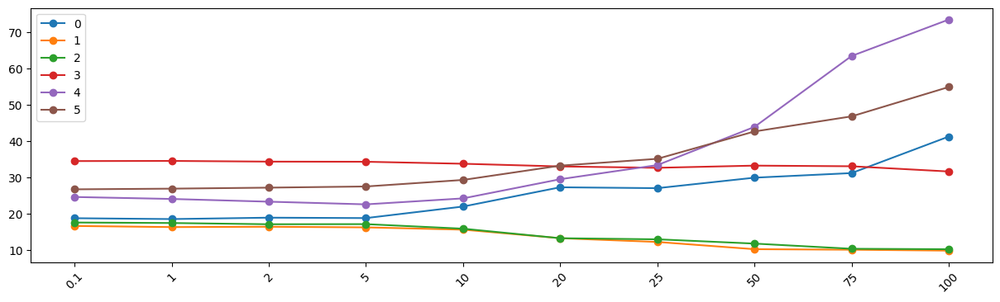

In [21]:
df_train_maes_sj_label_weight = pd.DataFrame(all_train_maes)
df_train_maes_sj_label_weight = df_train_maes_sj_label_weight.map(lambda x:x[0].item())

df_val_maes_sj_label_weight = pd.DataFrame(all_val_maes)
df_val_maes_sj_label_weight = df_val_maes_sj_label_weight.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_sj_label_weight.columns:
    plt.plot(df_train_maes_sj_label_weight[column], marker='o', label=column)
plt.xticks(range(len(label_weights)), label_weights,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_sj_label_weight.columns:
    plt.plot(df_val_maes_sj_label_weight[column], marker='o', label=column)
plt.xticks(range(len(label_weights)), label_weights,rotation=45);
plt.legend()

In [22]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
feature_lags = (3,)
folds = 6
fold_size = 0.15
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']
label_weights = [0.1,1,2,5,10,20,25,50,75,100]
all_train_maes = []
all_val_maes = []

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)


for label_weight in label_weights:
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = label_weight

    train_maes_sj = []
    val_maes_sj = []
    xg_reg_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=1000,max_depth=5,
                                        objective='reg:squarederror',
                                        reg_alpha=1,reg_lambda=1))

        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

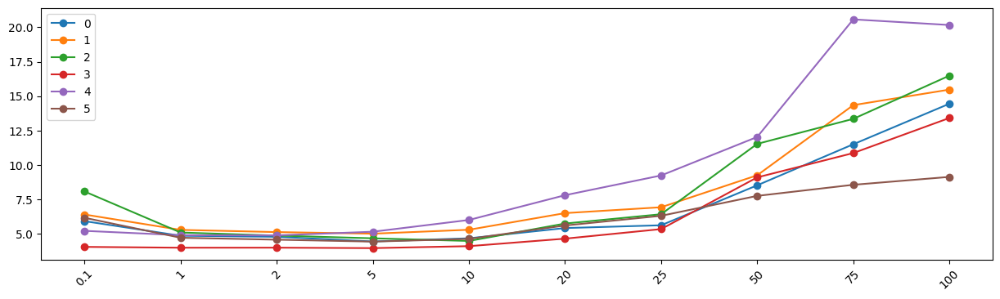

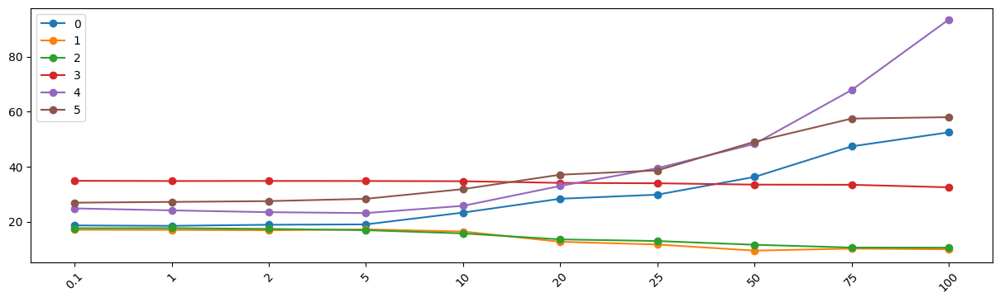

In [23]:
df_train_maes_sj_label_weight = pd.DataFrame(all_train_maes)
df_train_maes_sj_label_weight = df_train_maes_sj_label_weight.map(lambda x:x[0].item())

df_val_maes_sj_label_weight = pd.DataFrame(all_val_maes)
df_val_maes_sj_label_weight = df_val_maes_sj_label_weight.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_sj_label_weight.columns:
    plt.plot(df_train_maes_sj_label_weight[column], marker='o', label=column)
plt.xticks(range(len(label_weights)), label_weights,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_sj_label_weight.columns:
    plt.plot(df_val_maes_sj_label_weight[column], marker='o', label=column)
plt.xticks(range(len(label_weights)), label_weights,rotation=45);
plt.legend()

In [24]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
feature_lags = (3,)
folds = 6
fold_size = 0.15
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']
label_weights = [0.1,1,2,5,10,20,25,50,75,100]
all_train_maes = []
all_val_maes = []

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)


for label_weight in label_weights:
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = label_weight

    train_maes_sj = []
    val_maes_sj = []
    xg_reg_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=1500,max_depth=5,
                                        objective='reg:squarederror',
                                        reg_alpha=1,reg_lambda=1))

        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

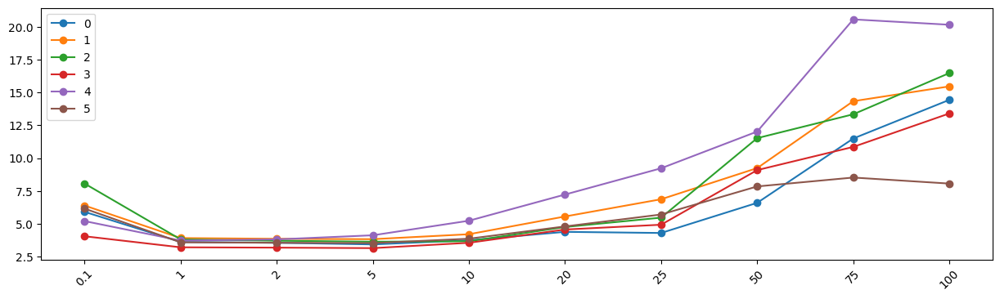

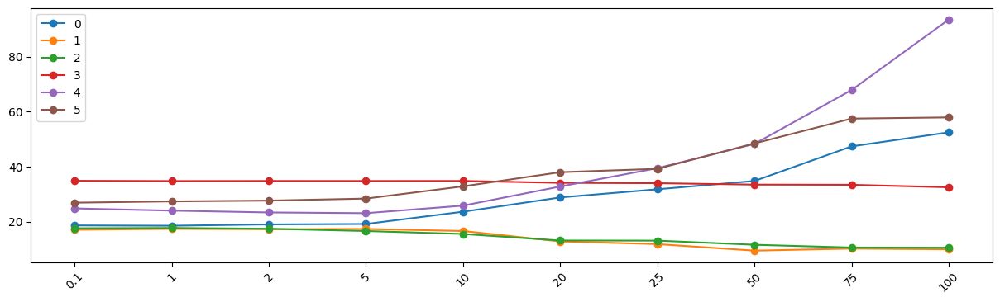

In [25]:
df_train_maes_sj_label_weight = pd.DataFrame(all_train_maes)
df_train_maes_sj_label_weight = df_train_maes_sj_label_weight.map(lambda x:x[0].item())

df_val_maes_sj_label_weight = pd.DataFrame(all_val_maes)
df_val_maes_sj_label_weight = df_val_maes_sj_label_weight.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_sj_label_weight.columns:
    plt.plot(df_train_maes_sj_label_weight[column], marker='o', label=column)
plt.xticks(range(len(label_weights)), label_weights,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_sj_label_weight.columns:
    plt.plot(df_val_maes_sj_label_weight[column], marker='o', label=column)
plt.xticks(range(len(label_weights)), label_weights,rotation=45);
plt.legend()

In [26]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
feature_lags = (3,)
folds = 6
fold_size = 0.15
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']
label_weights = [0.1,1,2,5,10,20,25,50,75,100]
all_train_maes = []
all_val_maes = []

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)


for label_weight in label_weights:
    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = label_weight

    train_maes_sj = []
    val_maes_sj = []
    xg_reg_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=2000,max_depth=5,
                                        objective='reg:squarederror',
                                        reg_alpha=1,reg_lambda=1))

        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

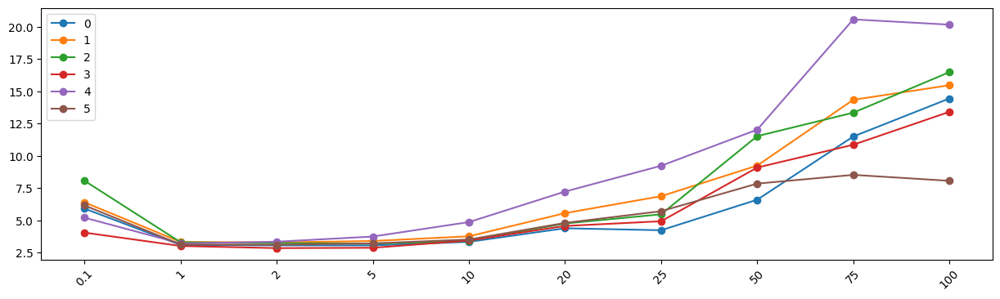

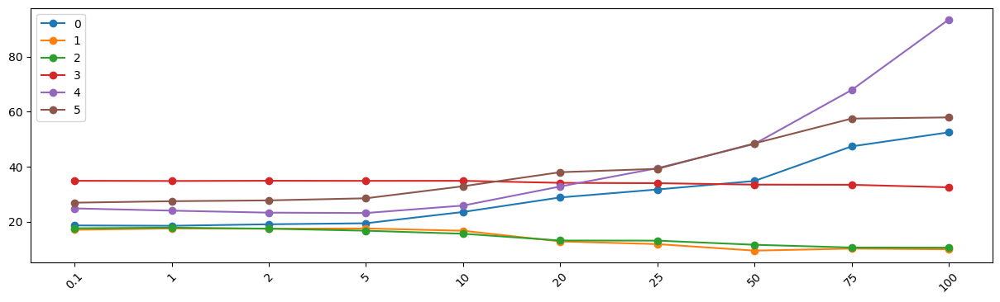

In [27]:
df_train_maes_sj_label_weight = pd.DataFrame(all_train_maes)
df_train_maes_sj_label_weight = df_train_maes_sj_label_weight.map(lambda x:x[0].item())

df_val_maes_sj_label_weight = pd.DataFrame(all_val_maes)
df_val_maes_sj_label_weight = df_val_maes_sj_label_weight.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_sj_label_weight.columns:
    plt.plot(df_train_maes_sj_label_weight[column], marker='o', label=column)
plt.xticks(range(len(label_weights)), label_weights,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_sj_label_weight.columns:
    plt.plot(df_val_maes_sj_label_weight[column], marker='o', label=column)
plt.xticks(range(len(label_weights)), label_weights,rotation=45);
plt.legend()

### Improving on sub31, trial 2 (weekofyear transformation), with param study

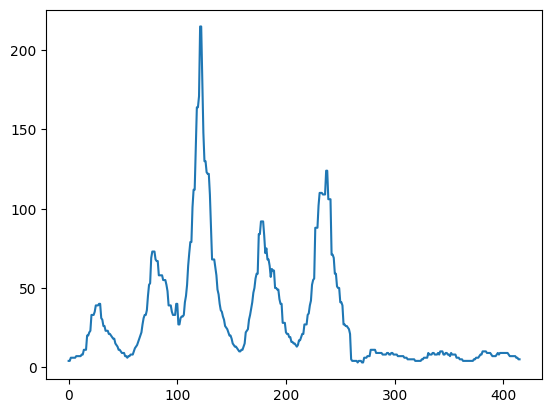

In [8]:
best_case = pd.read_csv('/home/tfc/Documents/data_driven/dengue/submission_14.csv')
plt.plot(best_case['total_cases'])

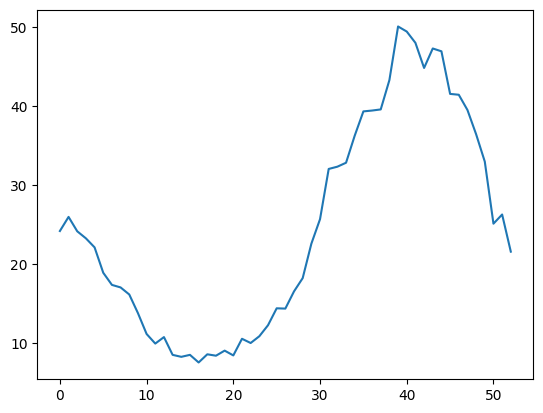

In [45]:
# Plotting cases over years. Looks like negative sine curve
df_weekofyear_cases = pd.concat([train_features_or['weekofyear'],train_labels],axis=1)
plt.plot(df_weekofyear_cases.groupby('weekofyear').mean().to_numpy())

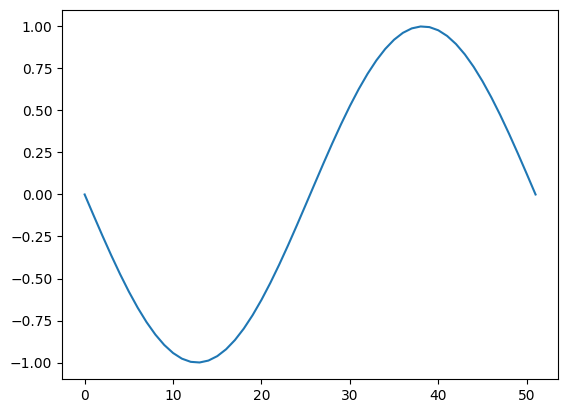

In [46]:
plt.plot(-np.sin(np.arange(52)/51*2*np.pi))

In [53]:
from scipy.signal import medfilt

def preprocess(df_features_or: pd.DataFrame,
               labels=None,
               features_to_keep: Optional[Iterable[str]] = None,
               lagged_features: Optional[Union[Iterable[str],Dict[str, Iterable[str]]]] = None,
               fillna: Optional[str] = None,
               circular_weekofyear: bool = False,
               feature_lags=None,
               label_lags=None):
    '''
    Add lagged features or target values as needed, accounting for existence of two cities in dataset.
    fillna: Fill NaN approach, e.g. 'ffill'. None to not fill.
    '''

    df_features = df_features_or.copy()
    df_features = df_features.reset_index()

    if features_to_keep is not None:         # Filter features
        feature_names = features_to_keep + ['city']
        df_features = df_features[feature_names]
    else:
        feature_names = list(df_features.columns)

    if fillna is not None:                   # Fill NaNs
        df_features.fillna(method=fillna, inplace=True)

    # Convert city feature to categorical and one hot encode
    df_features["city"] = df_features["city"].astype("category")
    df_features = pd.get_dummies(df_features, columns=['city'], drop_first=True)

    # Create circular week of year. #TEMP: update again
    if circular_weekofyear:
        
        # df_features['weekofyear1'] = np.sin((df_features['weekofyear']-1)/51*2*np.pi) # Method 2
        # df_features['weekofyear2'] = np.cos((df_features['weekofyear']-1)/51*2*np.pi)
        # df_features.drop(columns=['weekofyear'],inplace=True)

        # df_features['weekofyear'] = np.sin((df_features['weekofyear']-1)/51*np.pi)    # Method 1
        df_features['weekofyear'] = -np.sin((df_features['weekofyear']-1)/51*2*np.pi)   # Method 3
        
    # Split cities before adding lags
    sj_features = df_features[df_features['city_sj']]
    iq_features = df_features[~df_features['city_sj']]

    if labels is not None:
        sj_labels = labels[df_features['city_sj']]
        iq_labels = labels[~df_features['city_sj']]
    else:
        sj_labels = None        
        iq_labels = None

    # Add smoothing to features
    features_no_woy_city = [col for col in sj_features.columns if not (col in ['weekofyear','city_sj'])]
    sj_features[features_no_woy_city] = sj_features[features_no_woy_city].apply(lambda col: medfilt(col, kernel_size=3))
    iq_features[features_no_woy_city] = iq_features[features_no_woy_city].apply(lambda col: medfilt(col, kernel_size=3))

    # Lagged feature/labels creation
    if (lagged_features is not None) or (label_lags is not None):
        # Add lagged features
        if isinstance(lagged_features,dict):                # Do individual lags for different features
            for feat, feat_lags in lagged_features.items():
                sj_features_lagged = sj_features[feat].shift(periods=feat_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feat_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)
        elif isinstance(lagged_features, (list, tuple)):    # All considered features has same lags
            for feat in lagged_features:
                if 'total_cases' in feat:                   # Skip all total_cases features, used when preprocessing pred features
                    continue
                sj_features_lagged = sj_features[feat].shift(periods=feature_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feature_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)

        # Add lagged labels
        if label_lags is not None:
            sj_lagged_labels = sj_labels.shift(periods=label_lags)
            sj_features = pd.concat([sj_features,sj_lagged_labels],axis=1)
            iq_lagged_labels = iq_labels.shift(periods=label_lags)
            iq_features = pd.concat([iq_features,iq_lagged_labels],axis=1)
  
    return sj_features, iq_features, sj_labels, iq_labels



 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

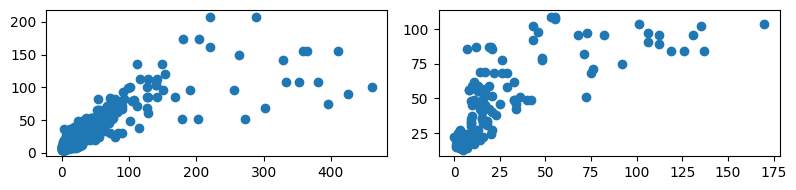

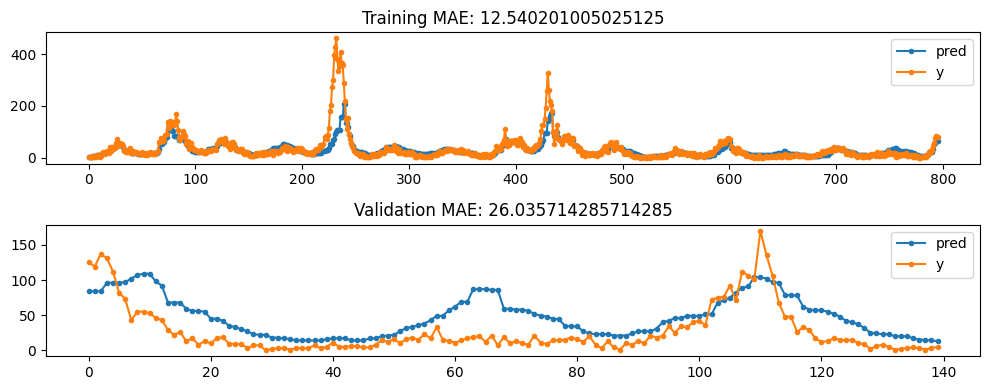

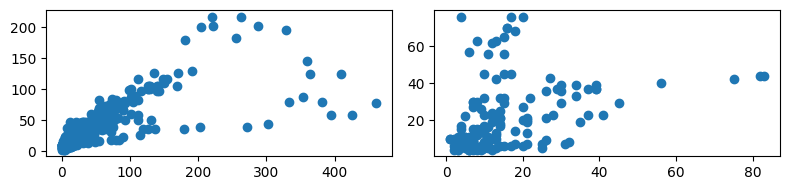

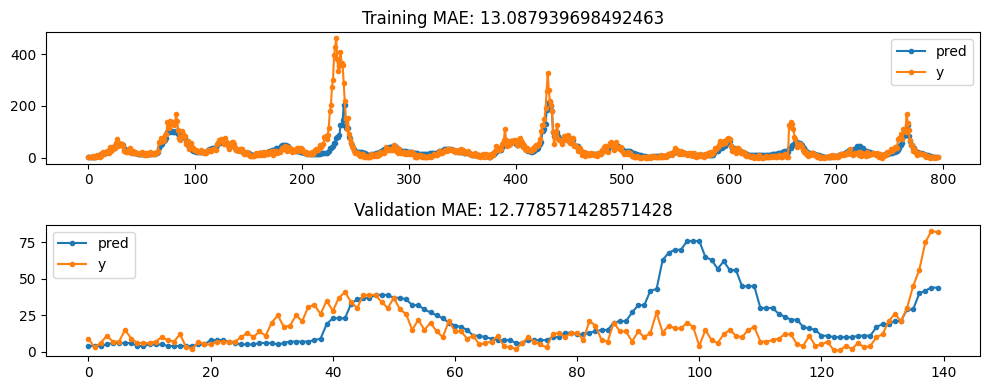

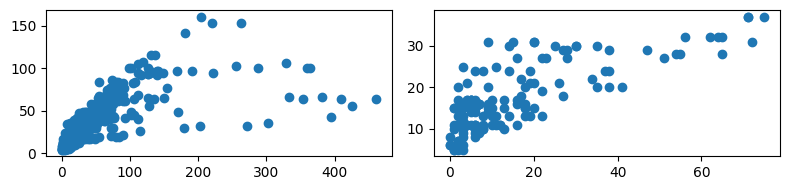

...

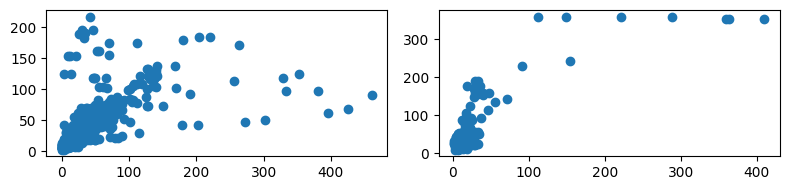

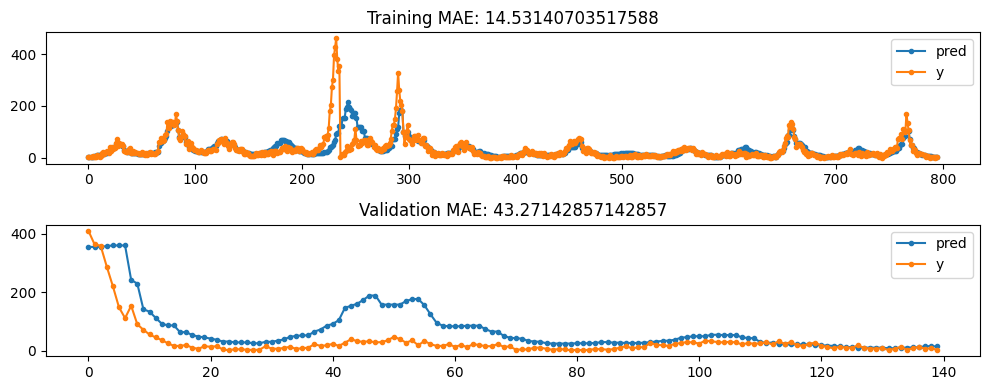

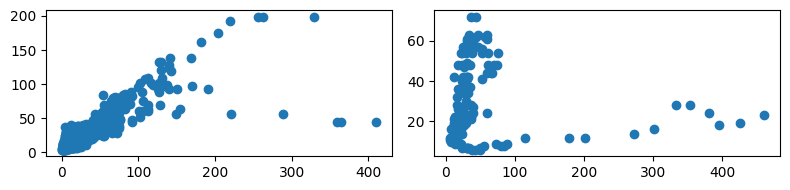

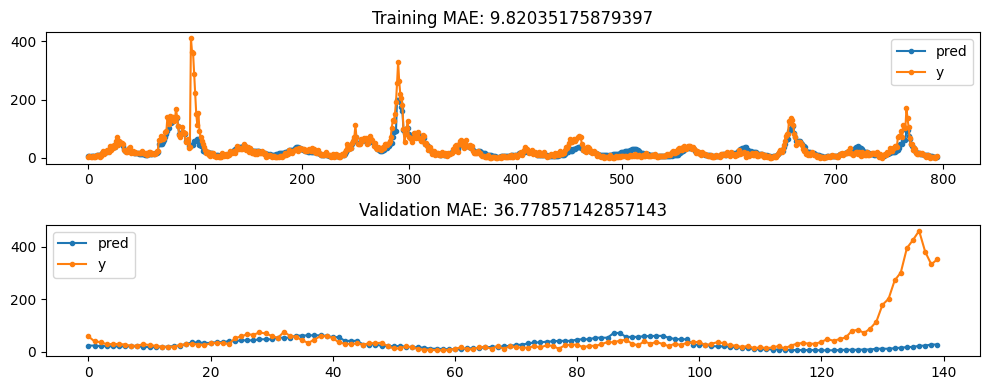

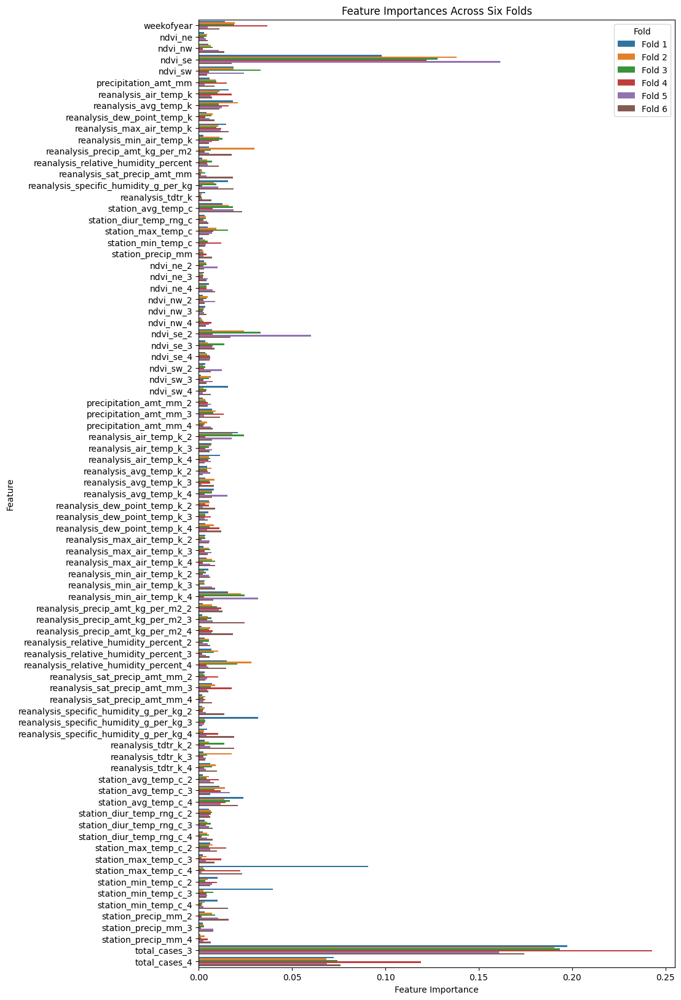

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


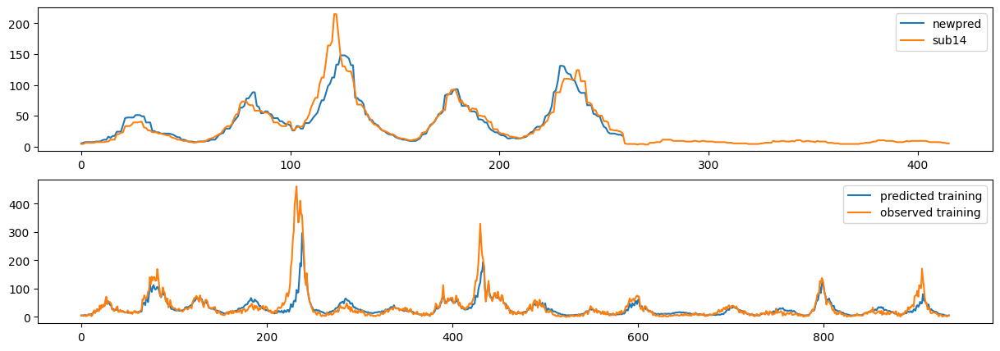

In [61]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
feature_lags = (2,3,4)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

#### param study

2,3,4 for feature lags seem the best when paired with 3,4, lags in labels



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for label lag (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32

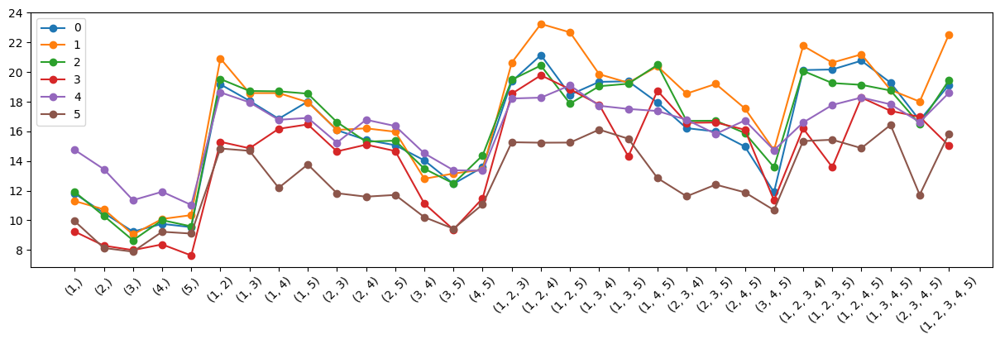

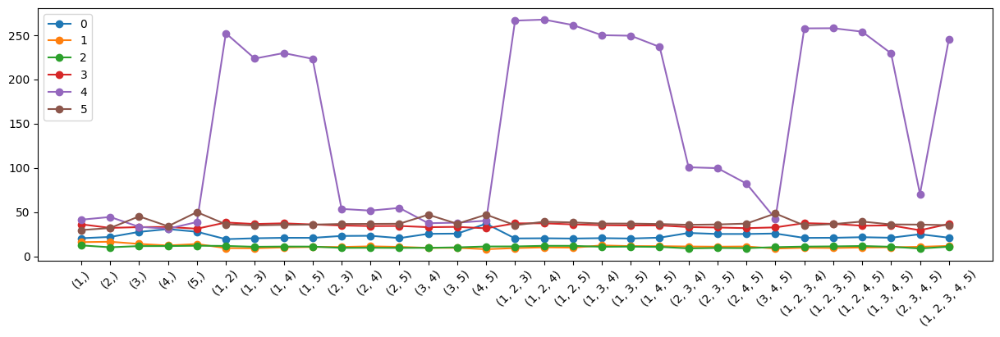

In [ ]:
# Close to original best scoring
# Specify modelling parameters

lags_considered = [1,2,3,4,5]
all_label_lags=[]
for r in range(1, len(lags_considered) + 1):
    all_label_lags.extend(combinations(lags_considered, r))
all_train_maes = []
all_val_maes = []



for label_lags in all_label_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for label lag {label_lags}')
    feature_lags = (3,)
    folds = 6
    fold_size = 0.15
    xg_reg_sj = []
    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']

    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)

    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)

    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                            sj_labels, iq_labels,
                                                            folds=6, fold_size=0.15)

    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 100

    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                        objective='reg:squarederror',
                                        reg_alpha=1,reg_lambda=1))

        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)

df_train_maes_label = pd.DataFrame(all_train_maes)
df_train_maes_label = df_train_maes_label.map(lambda x:x[0].item())

df_val_maes_label = pd.DataFrame(all_val_maes)
df_val_maes_label = df_val_maes_label.map(lambda x:x[0].item())


plt.figure(figsize=(15, 4))
for column in df_train_maes_label.columns:
    plt.plot(df_train_maes_label[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_label.columns:
    plt.plot(df_val_maes_label[column], marker='o', label=column)
plt.xticks(range(len(all_label_lags)), all_label_lags,rotation=45);
plt.legend();



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for feature lags (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             F

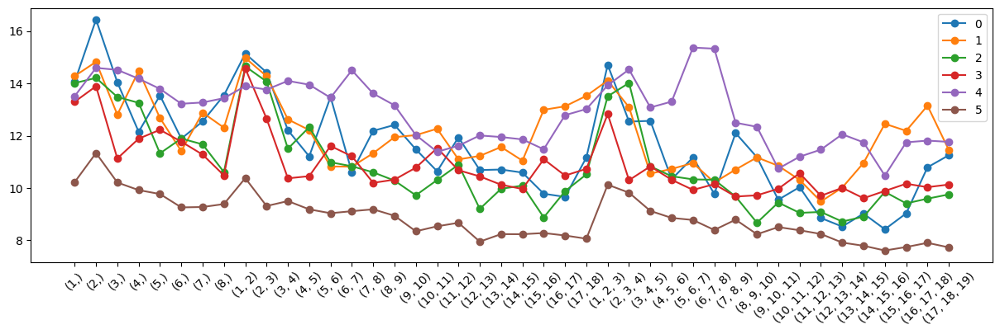

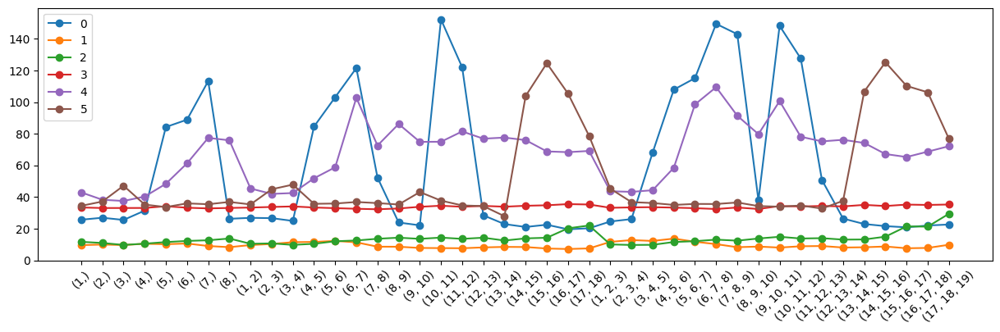

In [ ]:
# Close to original best scoring
# Specify modelling parameters
all_train_maes = []
all_val_maes = []
all_feature_lags = [(1,),(2,),(3,),(4,),(5,),(6,),(7,),(8,)]
all_feature_lags += [tuple(range(n,n+2)) for n in range(1,18)]
all_feature_lags += [tuple(range(n,n+3)) for n in range(1,18)]

for feature_lags in all_feature_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for feature lags {feature_lags}')

    label_lags=(3,4)
    folds = 6
    fold_size = 0.15
    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']

    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)

    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)

    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                            sj_labels, iq_labels,
                                                            folds=6, fold_size=0.15)

    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 100

    xg_reg_sj = []
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                        objective='reg:squarederror',
                                        reg_alpha=1,reg_lambda=1))

        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)

df_train_maes_feat = pd.DataFrame(all_train_maes)
df_train_maes_feat = df_train_maes_feat.map(lambda x:x[0].item())

df_val_maes_feat = pd.DataFrame(all_val_maes)
df_val_maes_feat = df_val_maes_feat.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_feat.columns:
    plt.plot(df_train_maes_feat[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_feat.columns:
    plt.plot(df_val_maes_feat[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend();



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for feature lags (1, 2, 3, 4, 5)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
   

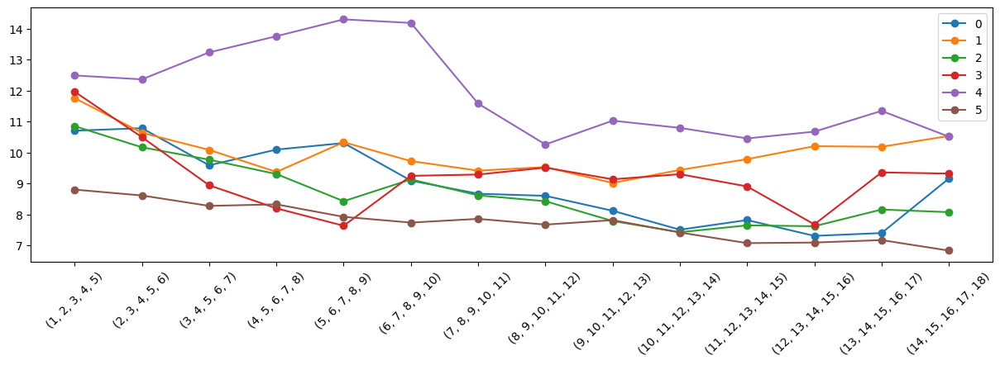

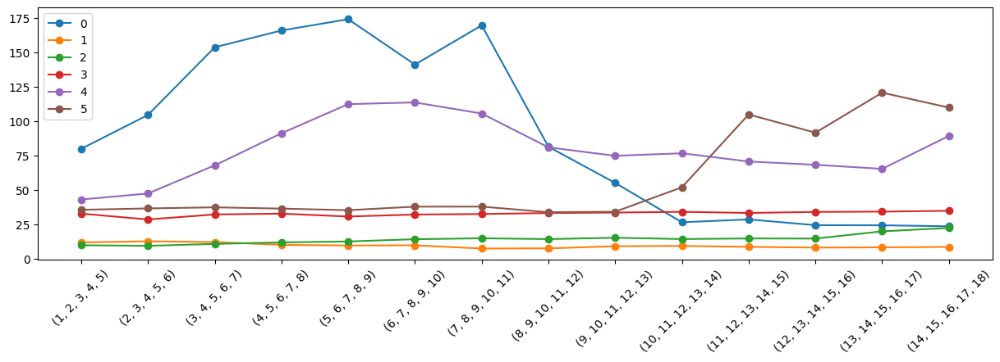

In [ ]:
# Close to original best scoring
# Specify modelling parameters
all_train_maes = []
all_val_maes = []
all_feature_lags = [tuple(range(n,n+5)) for n in range(1,15)]

for feature_lags in all_feature_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for feature lags {feature_lags}')

    label_lags=(3,4)
    folds = 6
    fold_size = 0.15
    feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
    lagged_features = [col for col in feature_names if col !='weekofyear']

    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=feature_lags,
                                                                label_lags=label_lags,circular_weekofyear=True)

    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)

    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                            sj_labels, iq_labels,
                                                            folds=6, fold_size=0.15)

    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 100

    xg_reg_sj = []
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                        objective='reg:squarederror',
                                        reg_alpha=1,reg_lambda=1))

        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)

df_train_maes_feat = pd.DataFrame(all_train_maes)
df_train_maes_feat = df_train_maes_feat.map(lambda x:x[0].item())

df_val_maes_feat = pd.DataFrame(all_val_maes)
df_val_maes_feat = df_val_maes_feat.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_feat.columns:
    plt.plot(df_train_maes_feat[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_feat.columns:
    plt.plot(df_val_maes_feat[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend();

### Improving on sub31, trial 3 (try weekofyear massaging)

noticing predicted peaks lag behind observed peaks a little. shifting circular weekofyear by 10 days seem to have worked a little bit,and brought some peaks up a bit earlier. changes seem marginal though.

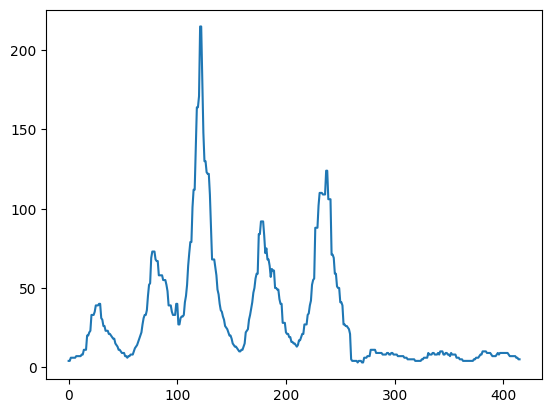

In [9]:
best_case = pd.read_csv('/home/tfc/Documents/data_driven/dengue/submission_14.csv')
plt.plot(best_case['total_cases'])

In [13]:
from scipy.signal import medfilt

def preprocess(df_features_or: pd.DataFrame,
               labels=None,
               features_to_keep: Optional[Iterable[str]] = None,
               lagged_features: Optional[Union[Iterable[str],Dict[str, Iterable[str]]]] = None,
               fillna: Optional[str] = None,
               circular_weekofyear: bool = False,
               feature_lags=None,
               label_lags=None):
    '''
    Add lagged features or target values as needed, accounting for existence of two cities in dataset.
    fillna: Fill NaN approach, e.g. 'ffill'. None to not fill.
    '''

    df_features = df_features_or.copy()
    df_features = df_features.reset_index()

    if features_to_keep is not None:         # Filter features
        feature_names = features_to_keep + ['city']
        df_features = df_features[feature_names]
    else:
        feature_names = list(df_features.columns)

    if fillna is not None:                   # Fill NaNs
        df_features.fillna(method=fillna, inplace=True)

    # Convert city feature to categorical and one hot encode
    df_features["city"] = df_features["city"].astype("category")
    df_features = pd.get_dummies(df_features, columns=['city'], drop_first=True)

    # Create circular week of year. #TEMP: update again
    if circular_weekofyear:
        
        # df_features['weekofyear1'] = np.sin((df_features['weekofyear']-1)/51*2*np.pi) # Method 2
        # df_features['weekofyear2'] = np.cos((df_features['weekofyear']-1)/51*2*np.pi)
        # df_features.drop(columns=['weekofyear'],inplace=True)

        # df_features['weekofyear'] = np.sin((df_features['weekofyear']-1)/51*np.pi)    # Method 1
        df_features['weekofyear'] = -np.sin((df_features['weekofyear']-10)/51*2*np.pi)   # Method 3
        
    # Split cities before adding lags
    sj_features = df_features[df_features['city_sj']]
    iq_features = df_features[~df_features['city_sj']]

    if labels is not None:
        sj_labels = labels[df_features['city_sj']]
        iq_labels = labels[~df_features['city_sj']]
    else:
        sj_labels = None        
        iq_labels = None

    # Add smoothing to features
    features_no_woy_city = [col for col in sj_features.columns if not (col in ['weekofyear','city_sj'])]
    sj_features[features_no_woy_city] = sj_features[features_no_woy_city].apply(lambda col: medfilt(col, kernel_size=3))
    iq_features[features_no_woy_city] = iq_features[features_no_woy_city].apply(lambda col: medfilt(col, kernel_size=3))

    # Lagged feature/labels creation
    if (lagged_features is not None) or (label_lags is not None):
        # Add lagged features
        if isinstance(lagged_features,dict):                # Do individual lags for different features
            for feat, feat_lags in lagged_features.items():
                sj_features_lagged = sj_features[feat].shift(periods=feat_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feat_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)
        elif isinstance(lagged_features, (list, tuple)):    # All considered features has same lags
            for feat in lagged_features:
                if 'total_cases' in feat:                   # Skip all total_cases features, used when preprocessing pred features
                    continue
                sj_features_lagged = sj_features[feat].shift(periods=feature_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feature_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)

        # Add lagged labels
        if label_lags is not None:
            sj_lagged_labels = sj_labels.shift(periods=label_lags)
            sj_features = pd.concat([sj_features,sj_lagged_labels],axis=1)
            iq_lagged_labels = iq_labels.shift(periods=label_lags)
            iq_features = pd.concat([iq_features,iq_lagged_labels],axis=1)
  
    return sj_features, iq_features, sj_labels, iq_labels



 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

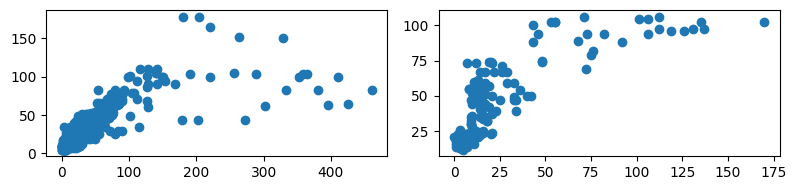

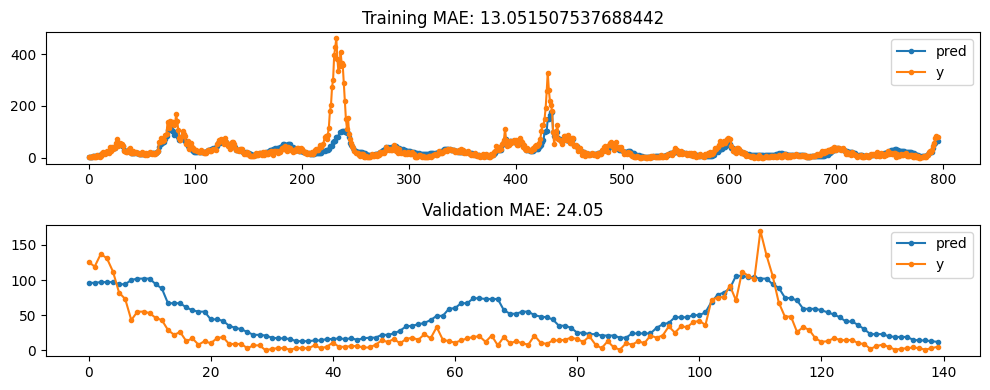

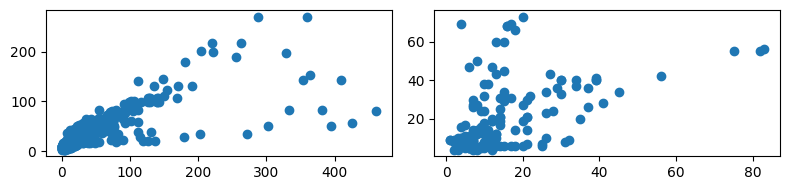

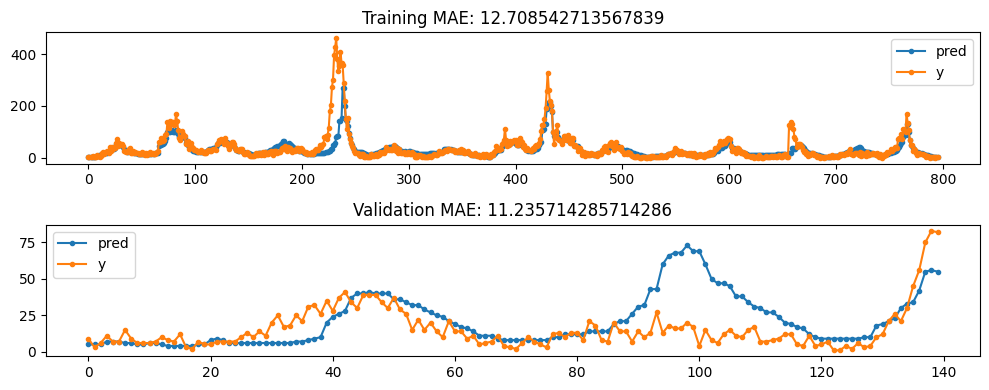

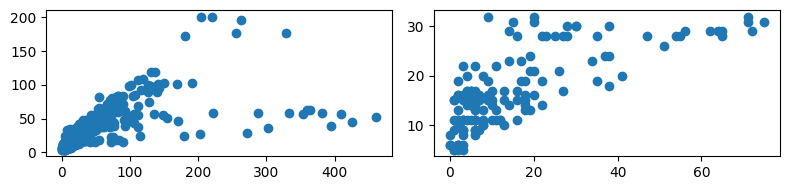

...

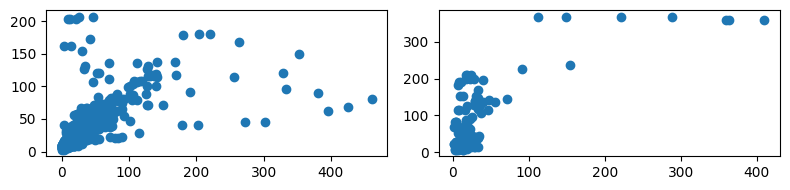

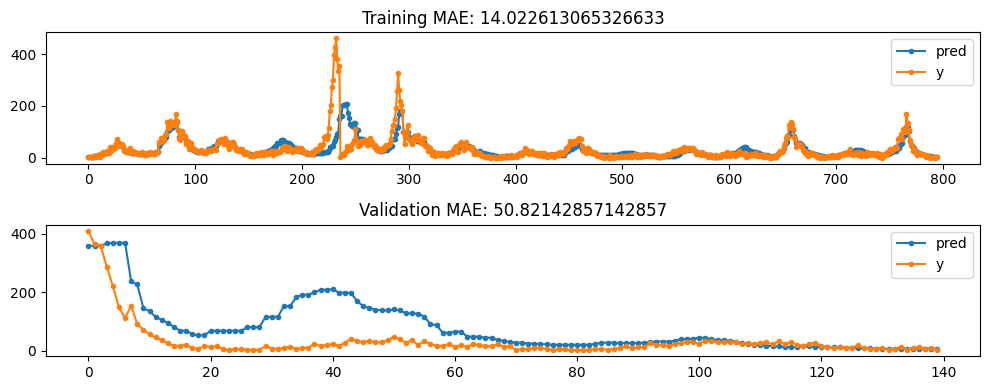

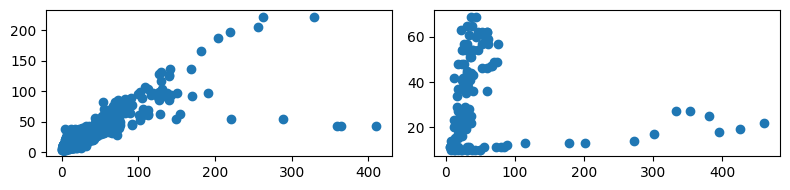

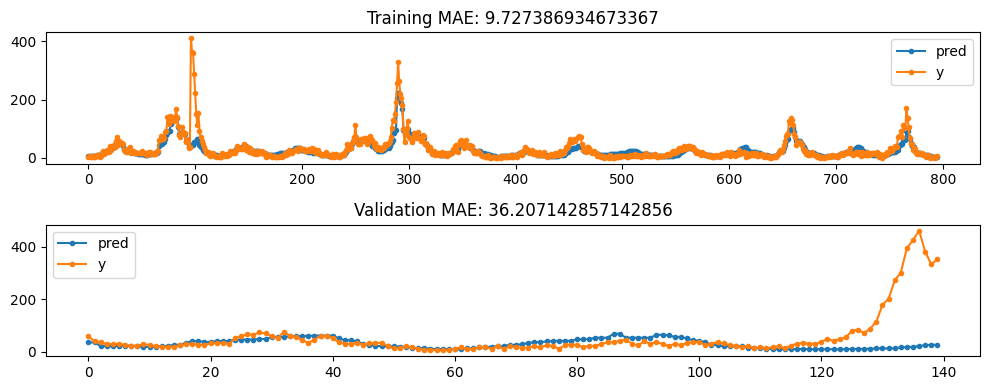

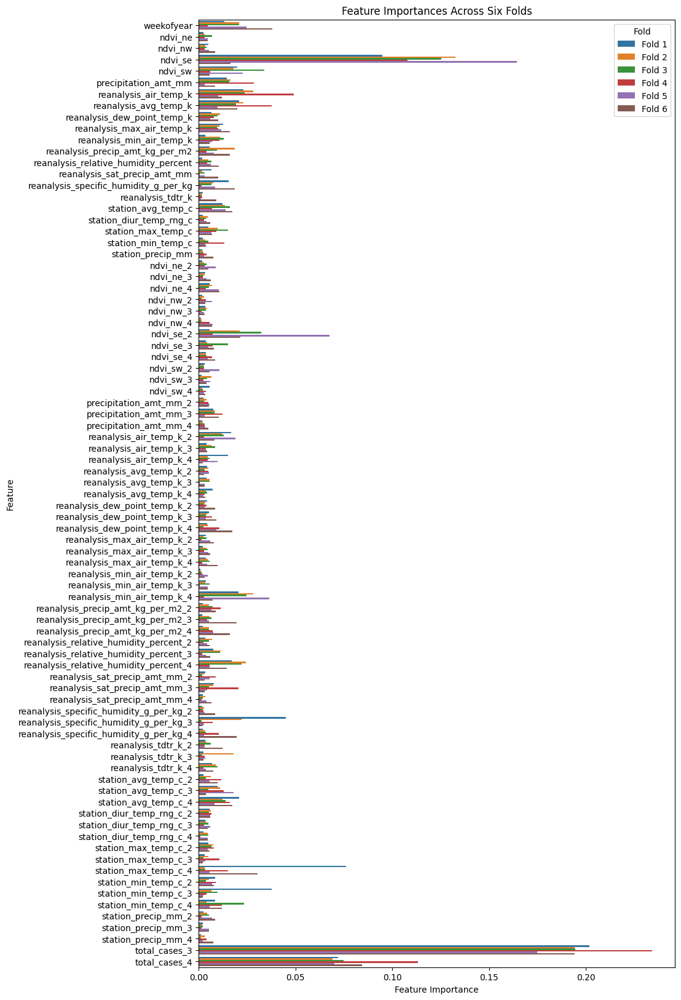

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


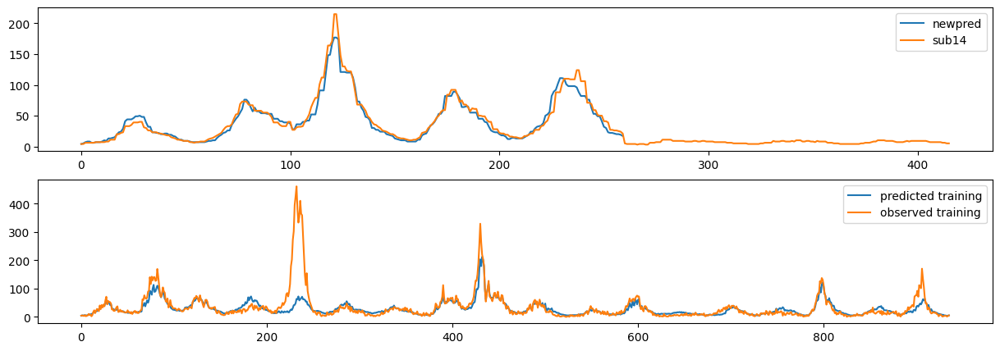

In [14]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
feature_lags = (2,3,4)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

### Improving on sub 31, trial 4 (try targetted feature lags)

From previous runs, ndvi lags of first three days seem to have higher importance, and for others, lags from around 13 to 18 seem better. trying this here.

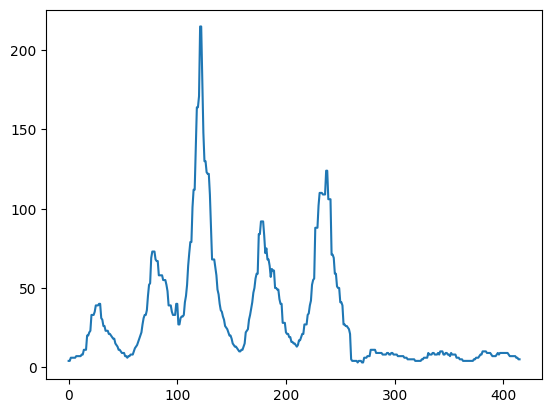

In [16]:
best_case = pd.read_csv('/home/tfc/Documents/data_driven/dengue/submission_14.csv')
plt.plot(best_case['total_cases'])

In [44]:
from scipy.signal import medfilt

def preprocess(df_features_or: pd.DataFrame,
               labels=None,
               features_to_keep: Optional[Iterable[str]] = None,
               lagged_features: Optional[Union[Iterable[str],Dict[str, Iterable[str]]]] = None,
               fillna: Optional[str] = None,
               circular_weekofyear: bool = False,
               feature_lags=None,
               label_lags=None, weekofyear_shift = 0):
    '''
    Add lagged features or target values as needed, accounting for existence of two cities in dataset.
    fillna: Fill NaN approach, e.g. 'ffill'. None to not fill.
    '''

    df_features = df_features_or.copy()
    df_features = df_features.reset_index()

    if features_to_keep is not None:         # Filter features
        feature_names = features_to_keep + ['city']
        df_features = df_features[feature_names]
    else:
        feature_names = list(df_features.columns)

    if fillna is not None:                   # Fill NaNs
        df_features.fillna(method=fillna, inplace=True)

    # Convert city feature to categorical and one hot encode
    df_features["city"] = df_features["city"].astype("category")
    df_features = pd.get_dummies(df_features, columns=['city'], drop_first=True)

    # Create circular week of year. #TEMP: update again
    if circular_weekofyear:
        
        # df_features['weekofyear1'] = np.sin((df_features['weekofyear']-1)/51*2*np.pi) # Method 2
        # df_features['weekofyear2'] = np.cos((df_features['weekofyear']-1)/51*2*np.pi)
        # df_features.drop(columns=['weekofyear'],inplace=True)

        # df_features['weekofyear'] = np.sin((df_features['weekofyear']-1)/51*np.pi)    # Method 1
        df_features['weekofyear'] = -np.sin((df_features['weekofyear']-1-weekofyear_shift)/51*2*np.pi)   # Method 3
        
    # Split cities before adding lags
    sj_features = df_features[df_features['city_sj']]
    iq_features = df_features[~df_features['city_sj']]

    if labels is not None:
        sj_labels = labels[df_features['city_sj']]
        iq_labels = labels[~df_features['city_sj']]
    else:
        sj_labels = None        
        iq_labels = None

    # Add smoothing to features
    features_no_woy_city = [col for col in sj_features.columns if not (col in ['weekofyear','city_sj'])]
    sj_features[features_no_woy_city] = sj_features[features_no_woy_city].apply(lambda col: medfilt(col, kernel_size=3))
    iq_features[features_no_woy_city] = iq_features[features_no_woy_city].apply(lambda col: medfilt(col, kernel_size=3))

    # Lagged feature/labels creation
    if (lagged_features is not None) or (label_lags is not None):
        # Add lagged features
        if isinstance(lagged_features,dict):                # Do individual lags for different features
            for feat, feat_lags in lagged_features.items():
                sj_features_lagged = sj_features[feat].shift(periods=feat_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feat_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)
        elif isinstance(lagged_features, (list, tuple)):    # All considered features has same lags
            for feat in lagged_features:
                if 'total_cases' in feat:                   # Skip all total_cases features, used when preprocessing pred features
                    continue
                sj_features_lagged = sj_features[feat].shift(periods=feature_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feature_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)

        # Add lagged labels
        if label_lags is not None:
            sj_lagged_labels = sj_labels.shift(periods=label_lags)
            sj_features = pd.concat([sj_features,sj_lagged_labels],axis=1)
            iq_lagged_labels = iq_labels.shift(periods=label_lags)
            iq_features = pd.concat([iq_features,iq_lagged_labels],axis=1)
  
    return sj_features, iq_features, sj_labels, iq_labels



 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

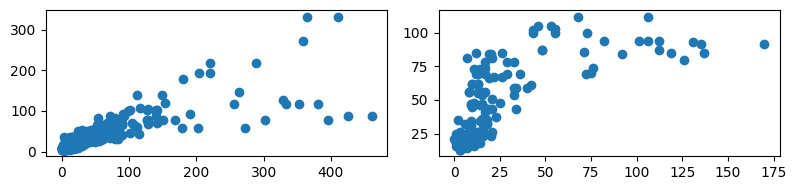

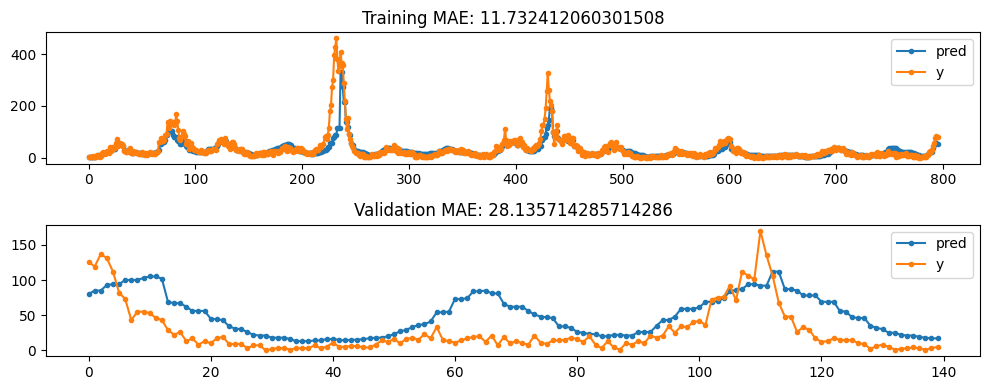

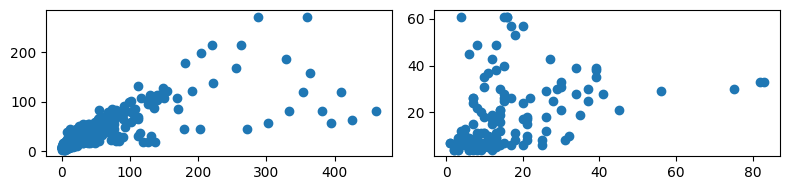

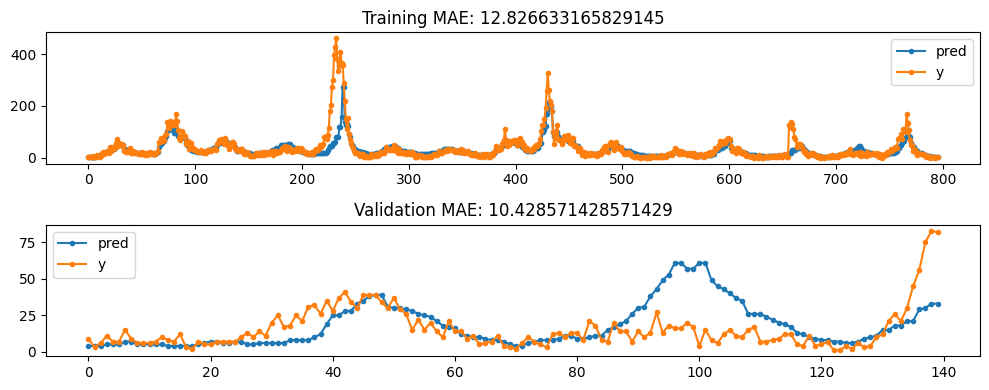

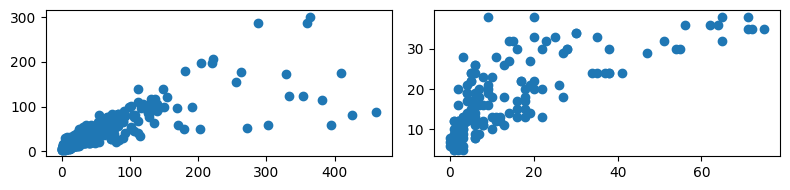

...

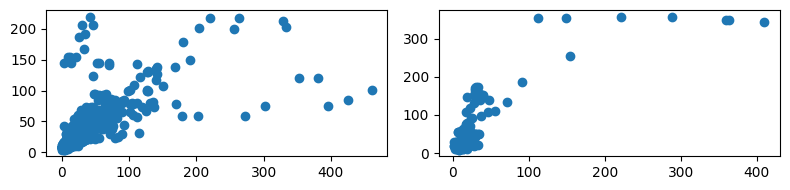

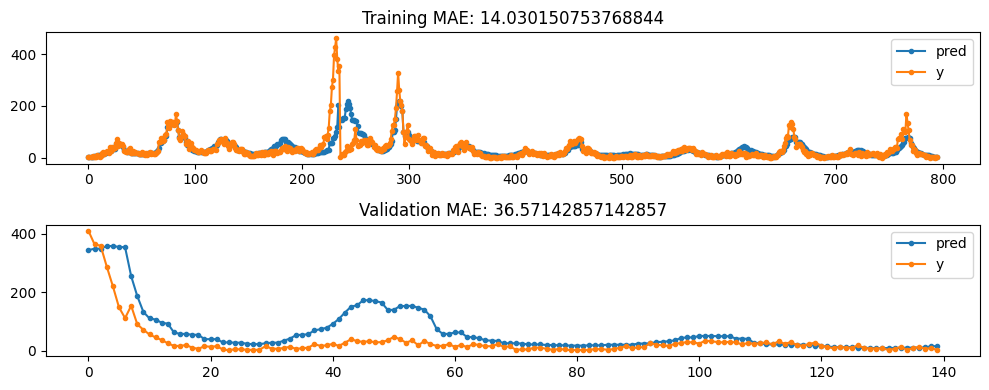

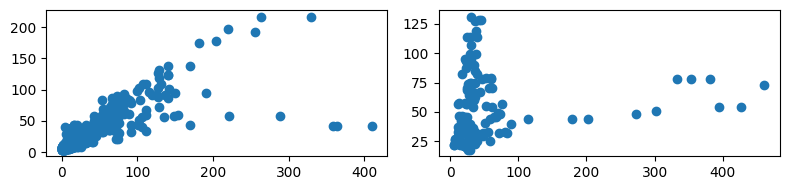

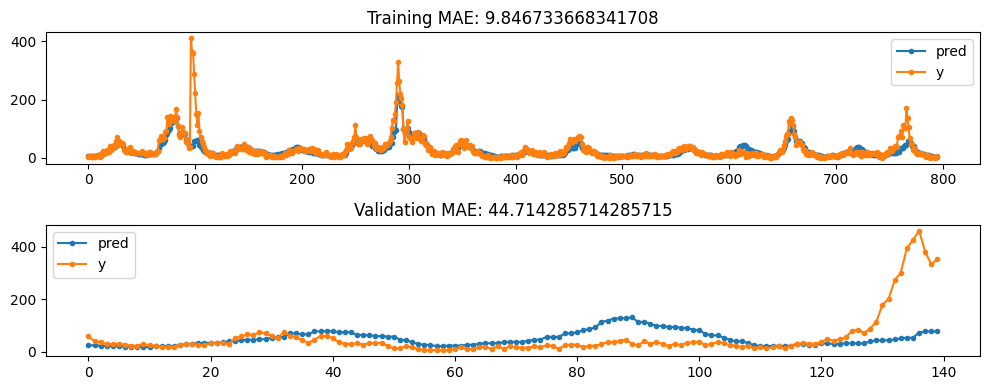

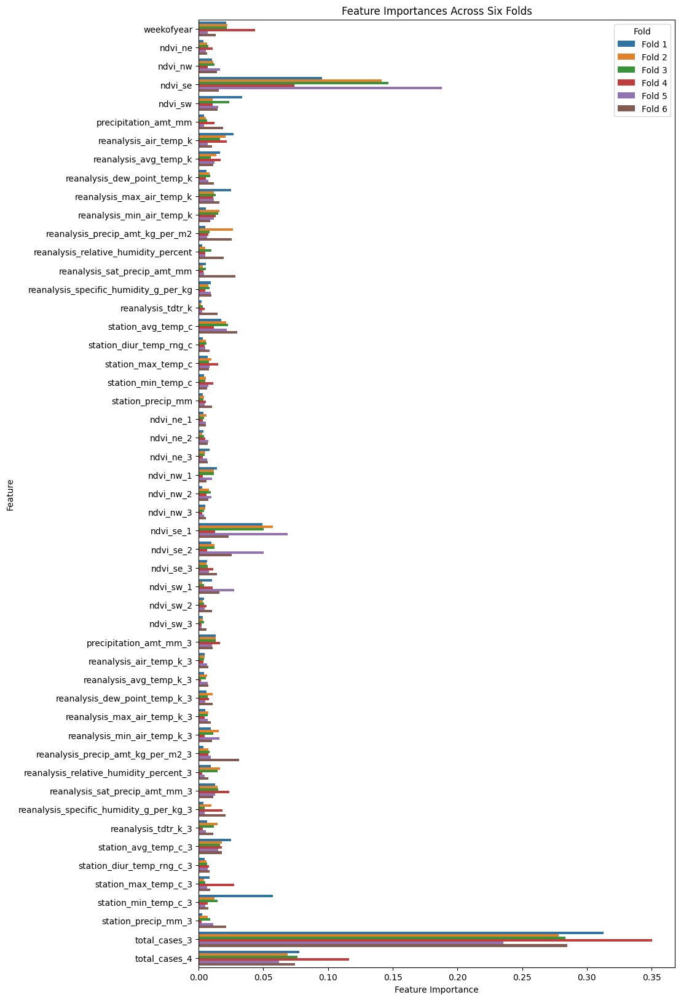

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


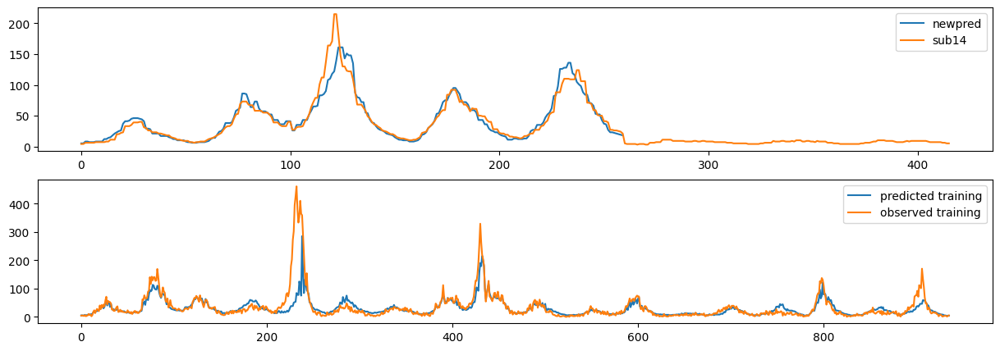

In [40]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=None,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.005,n_estimators=1000,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.005,n_estimators=1000,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

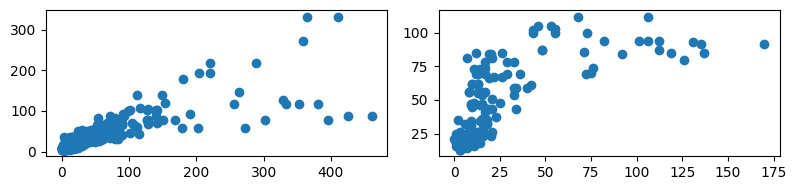

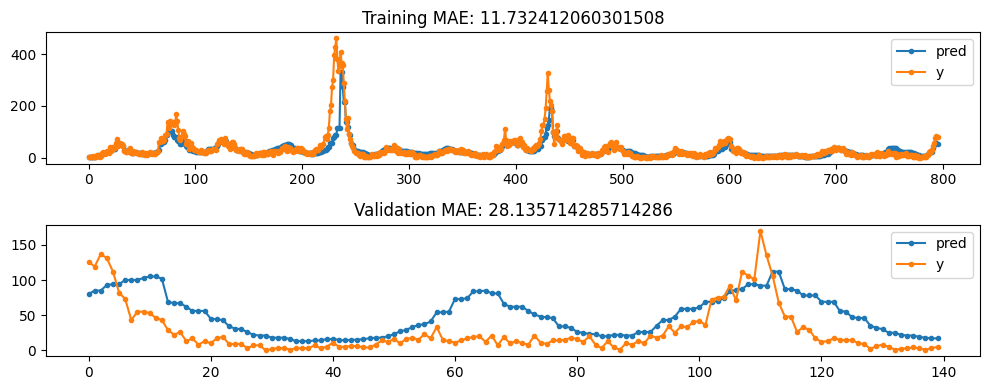

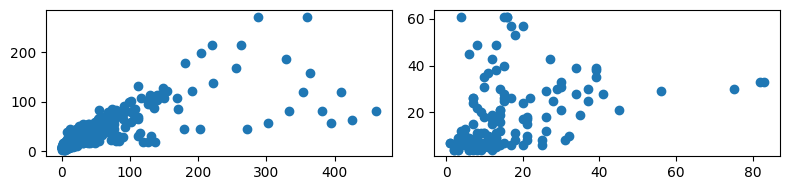

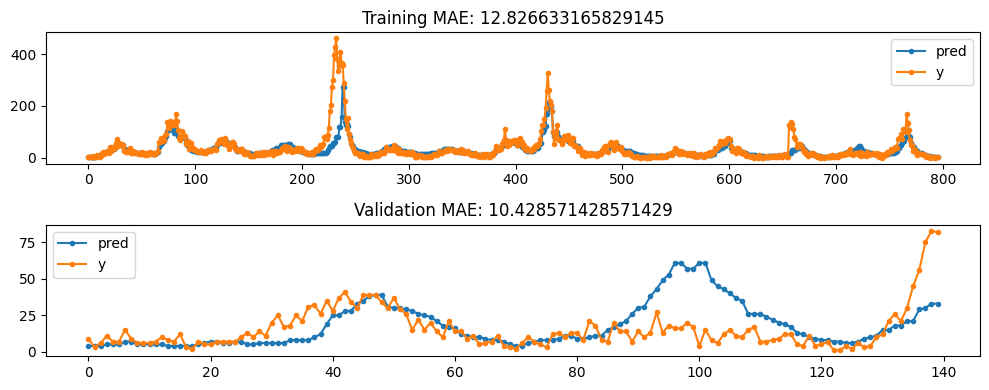

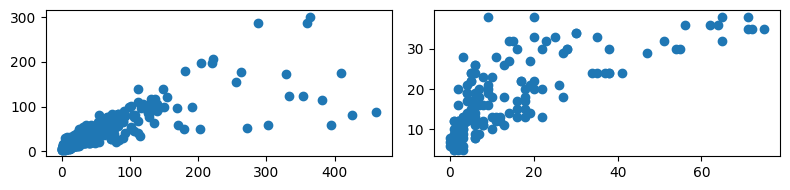

...

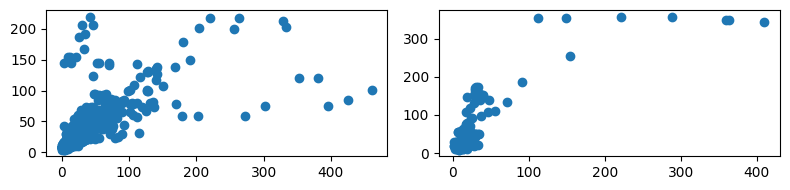

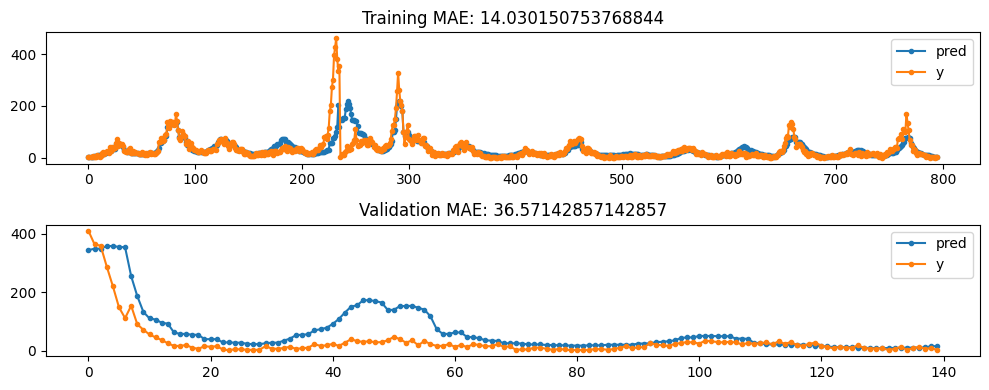

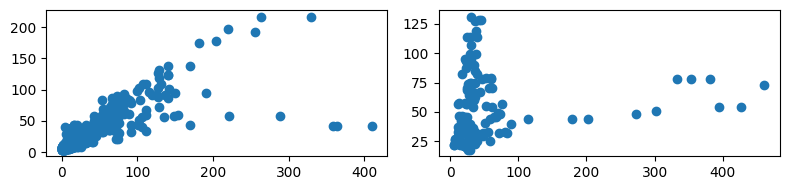

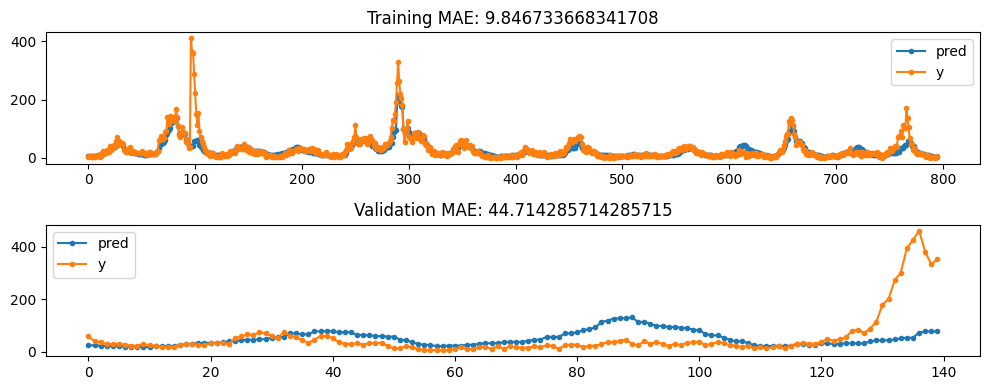

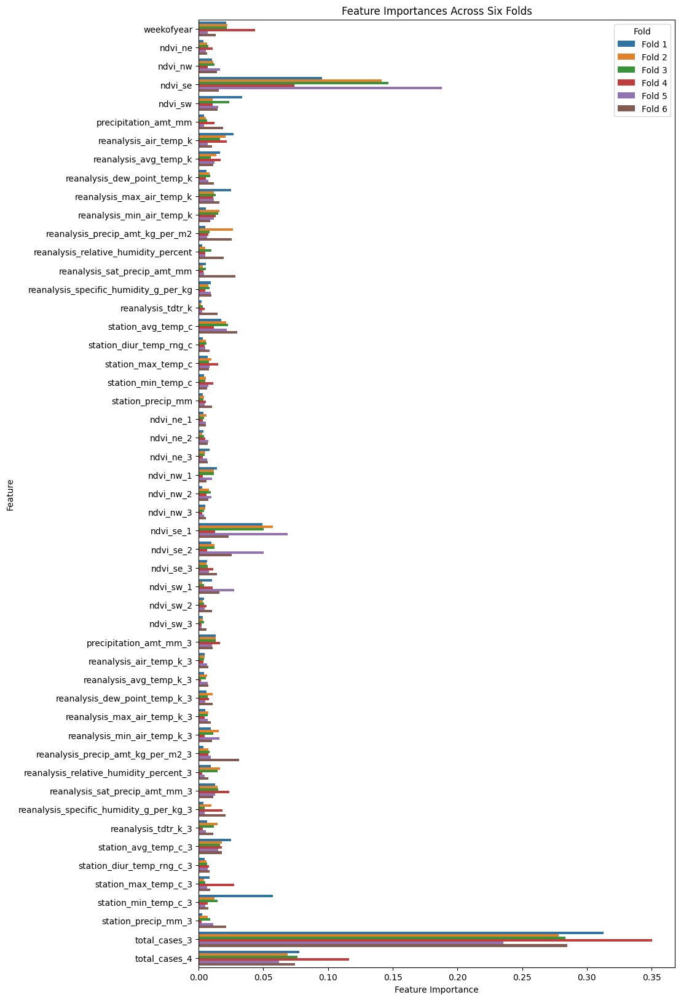

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


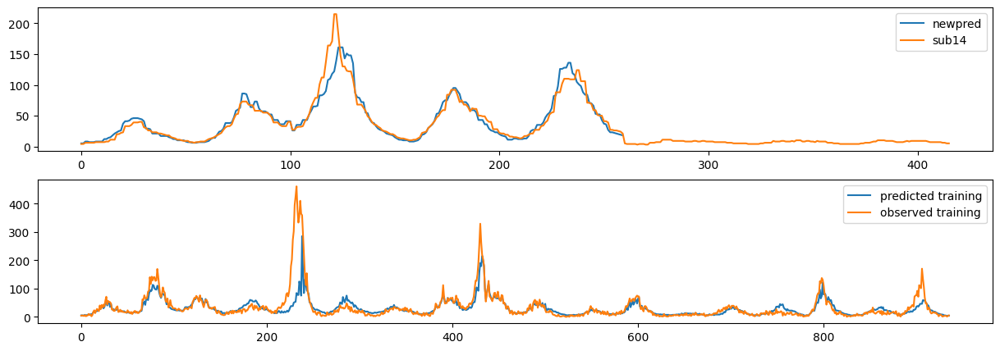

In [43]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=None,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.005,n_estimators=1000,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.005,n_estimators=1000,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

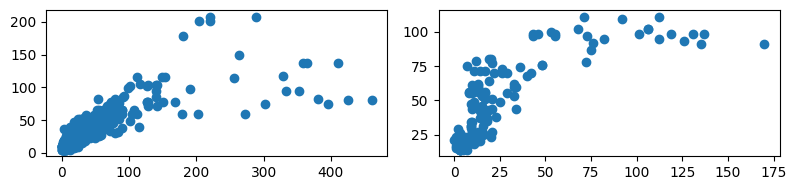

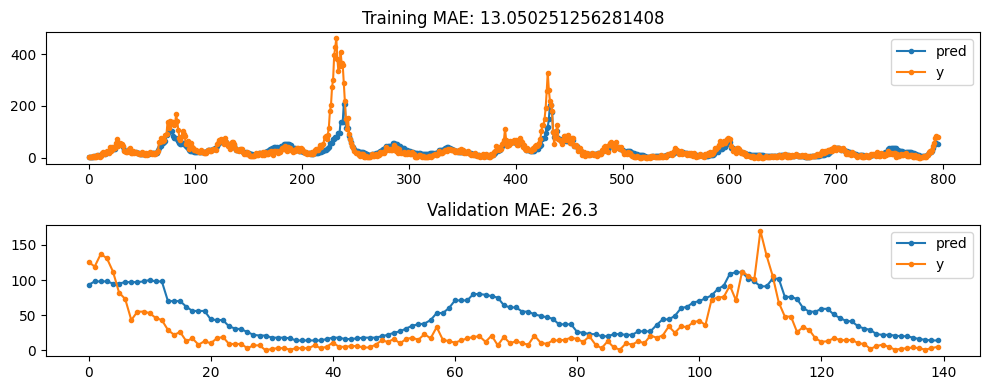

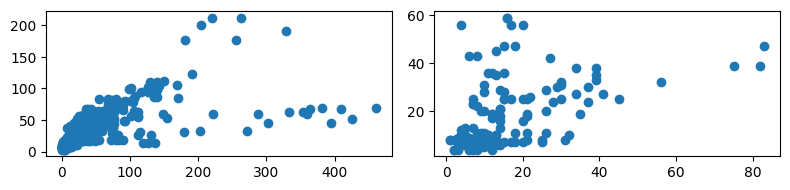

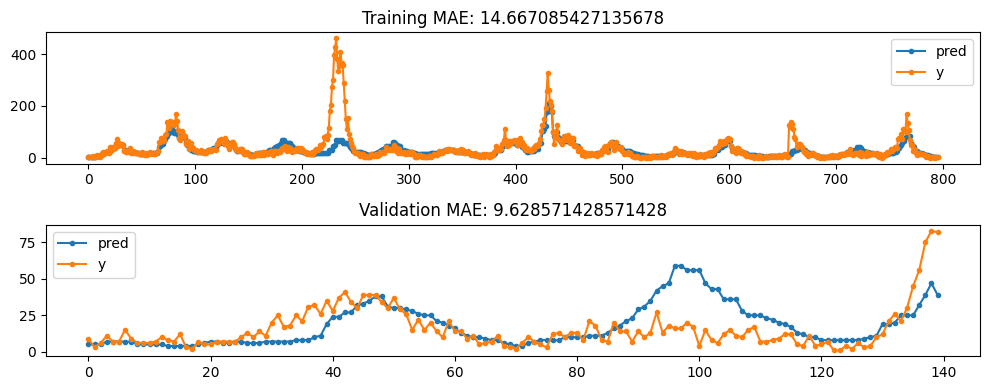

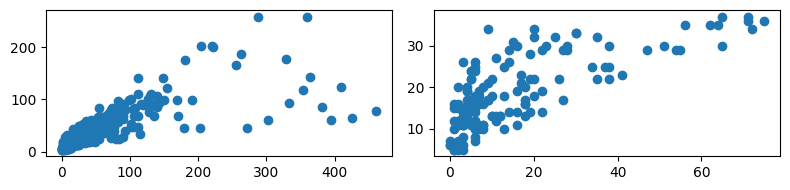

...

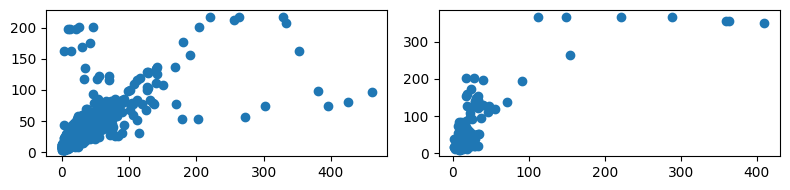

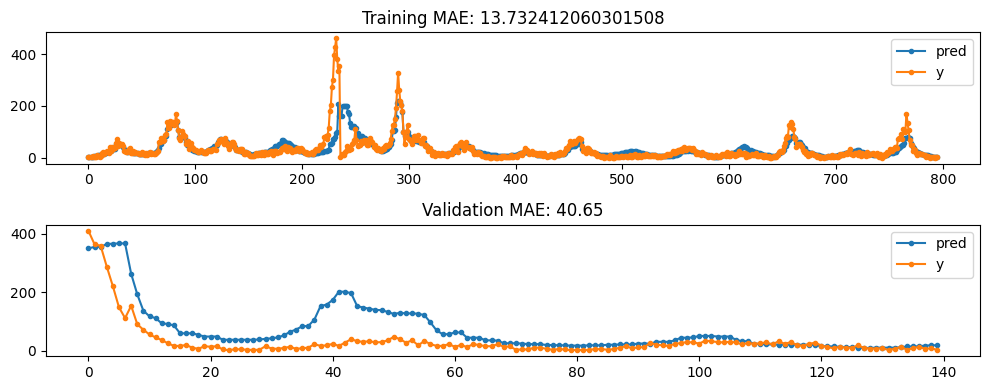

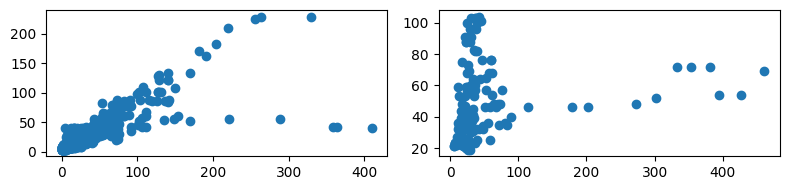

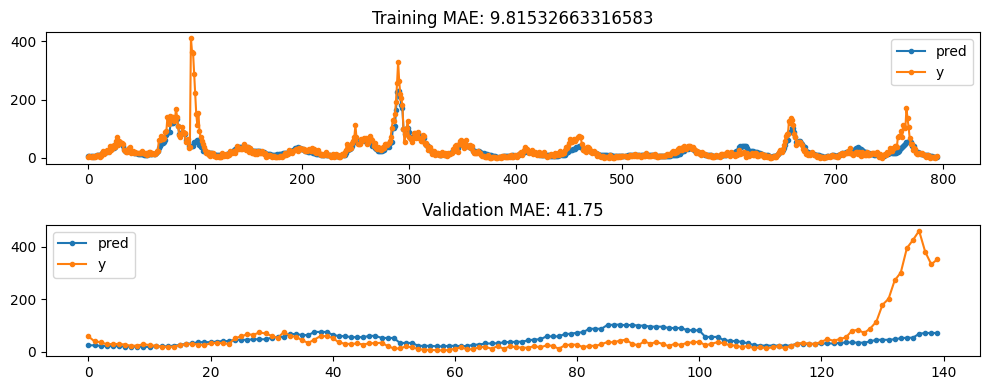

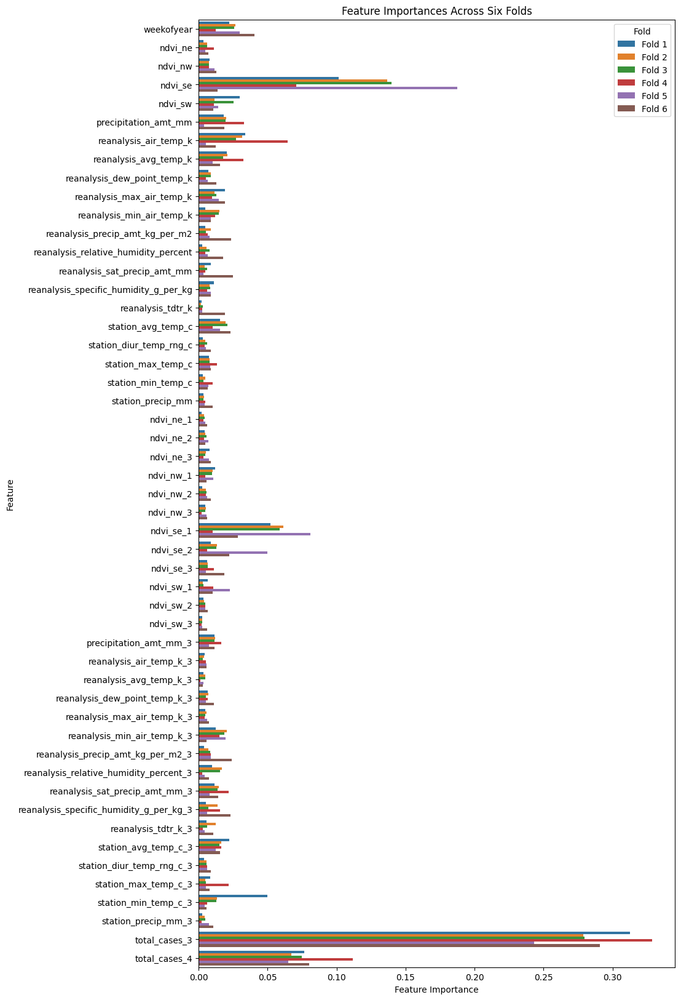

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


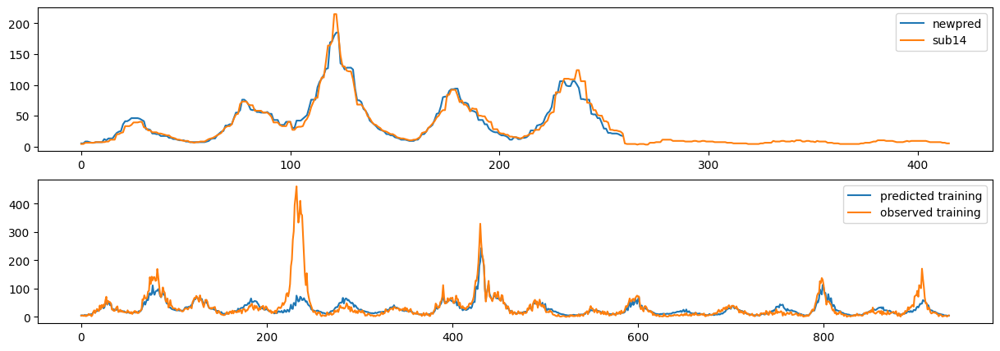

In [45]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=None,
                                                            label_lags=label_lags,circular_weekofyear=True,
                                                            weekofyear_shift=10)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.005,n_estimators=1000,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.005,n_estimators=1000,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True,
                                  weekofyear_shift = 10)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

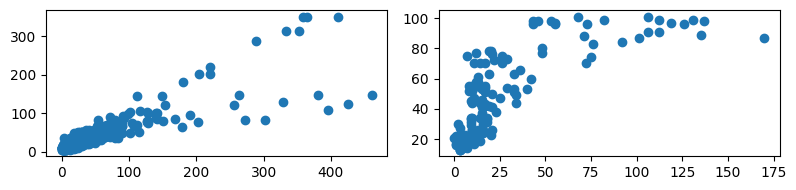

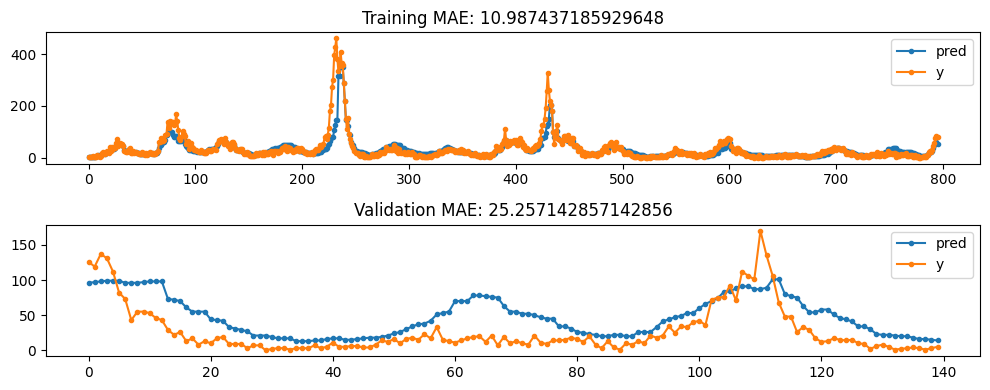

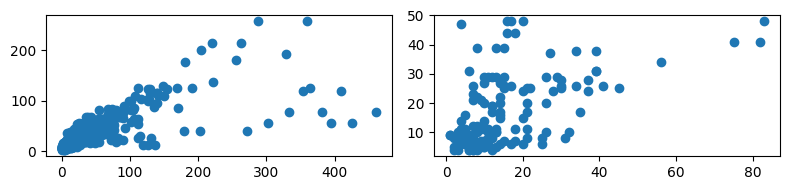

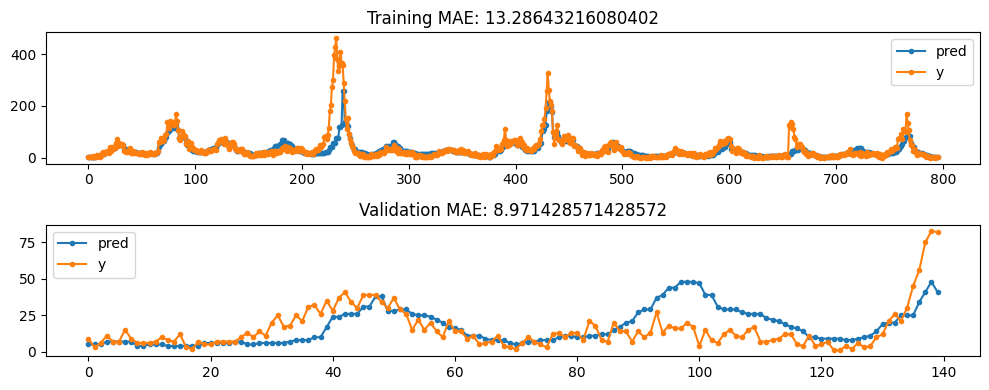

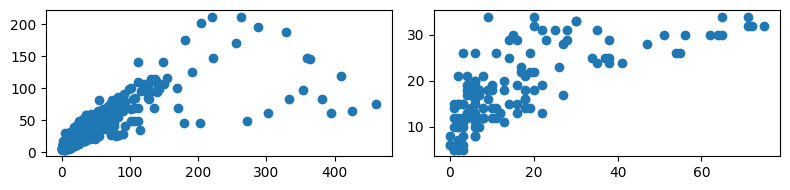

...

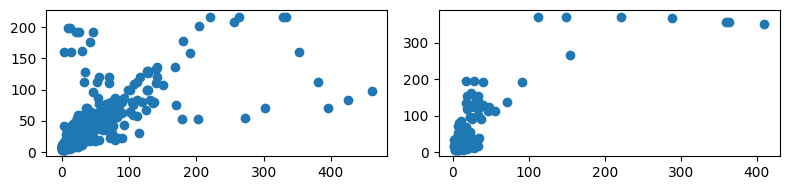

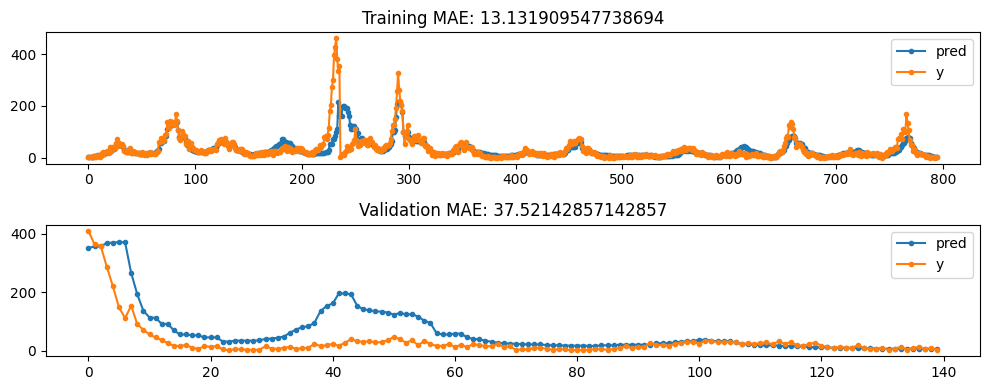

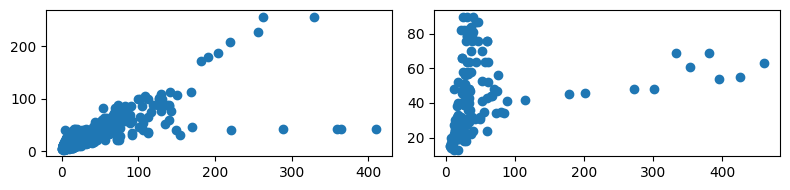

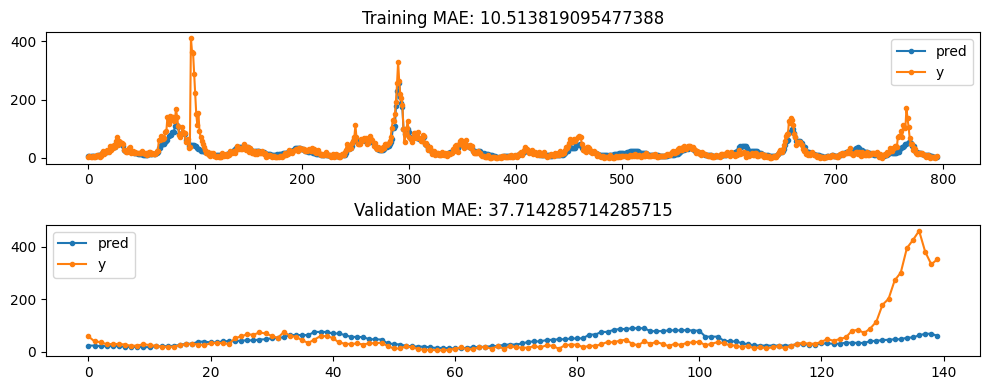

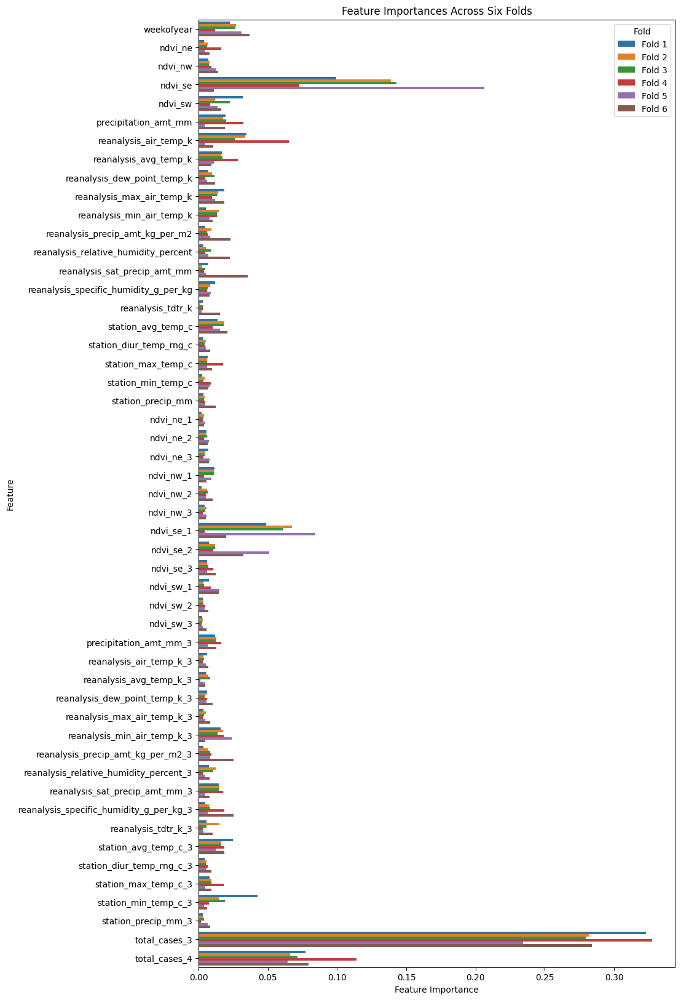

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


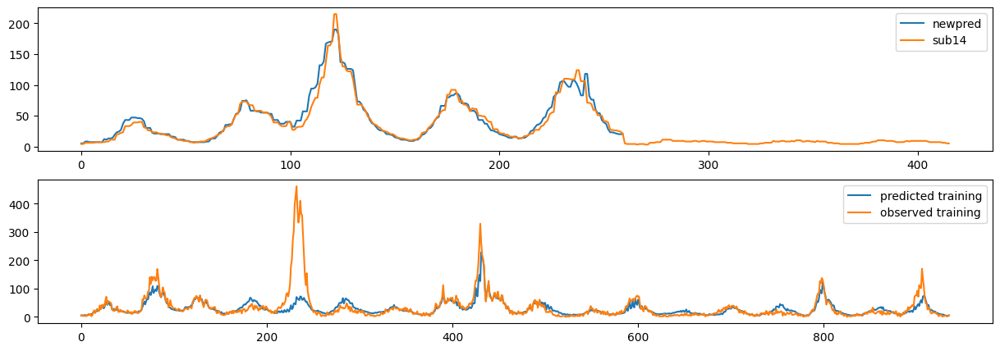

In [47]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=None,
                                                            label_lags=label_lags,circular_weekofyear=True,
                                                            weekofyear_shift=10)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True,
                                  weekofyear_shift = 10)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

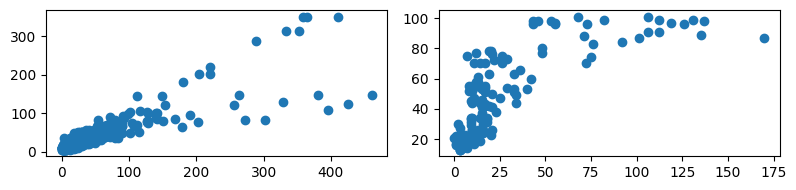

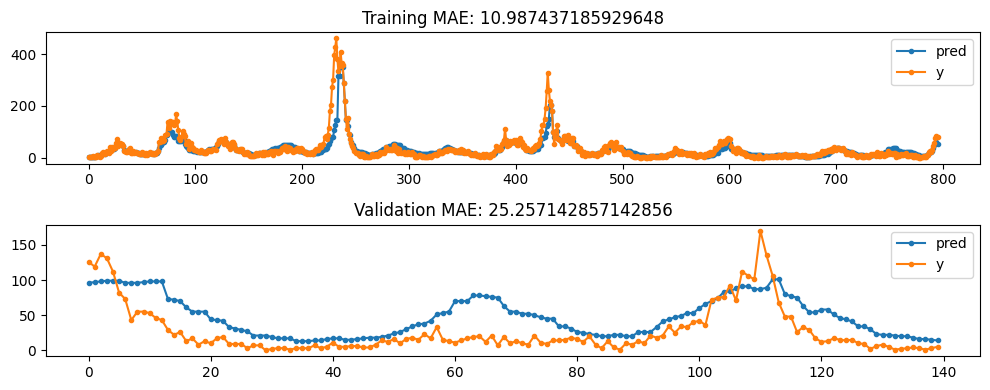

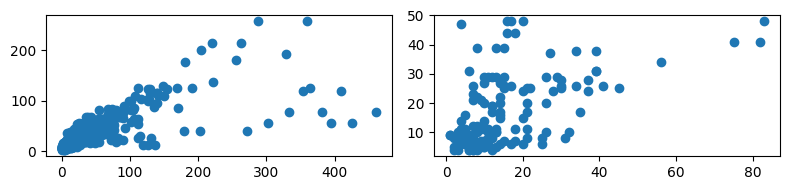

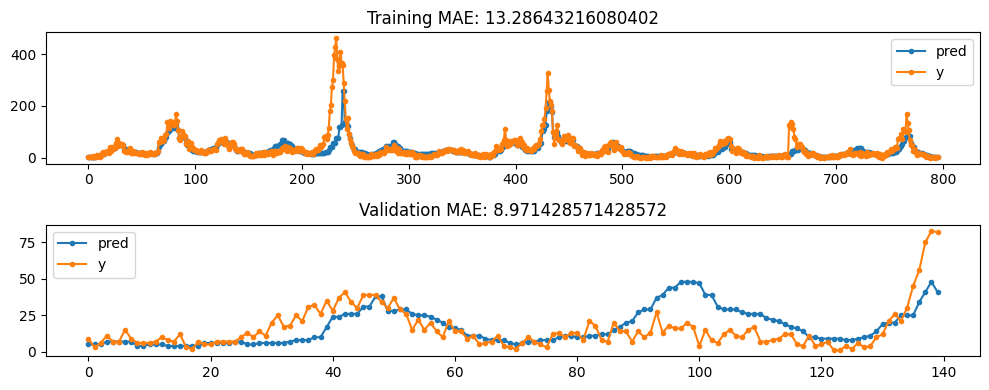

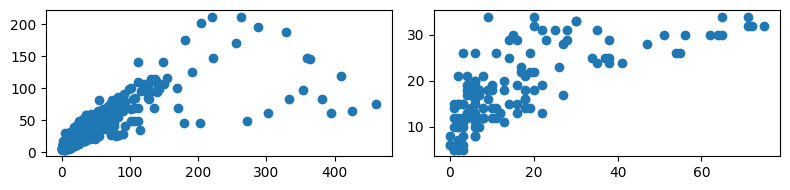

...

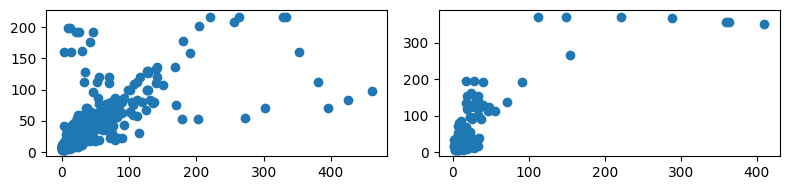

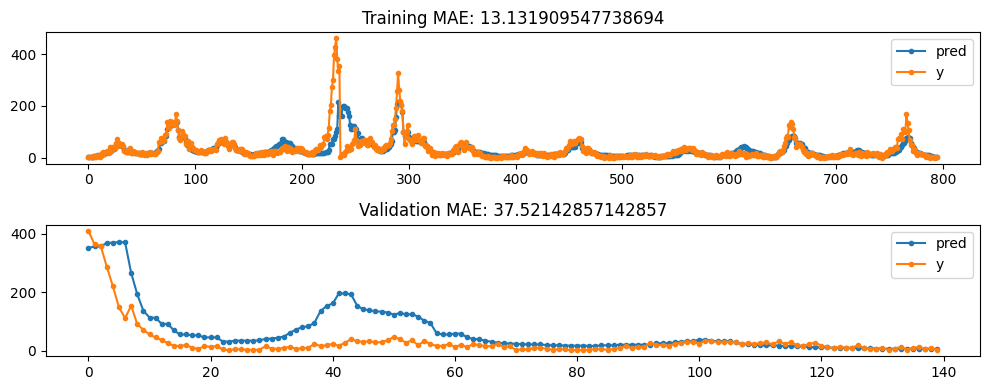

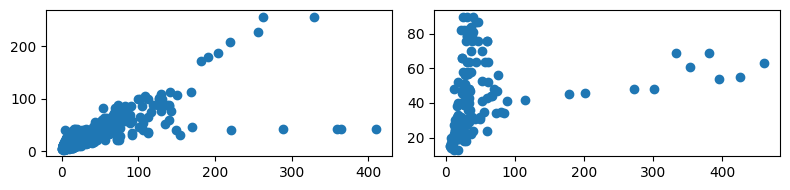

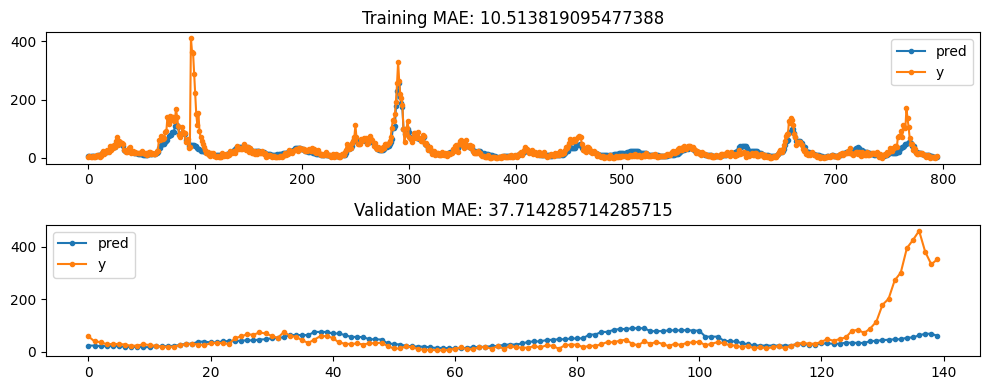

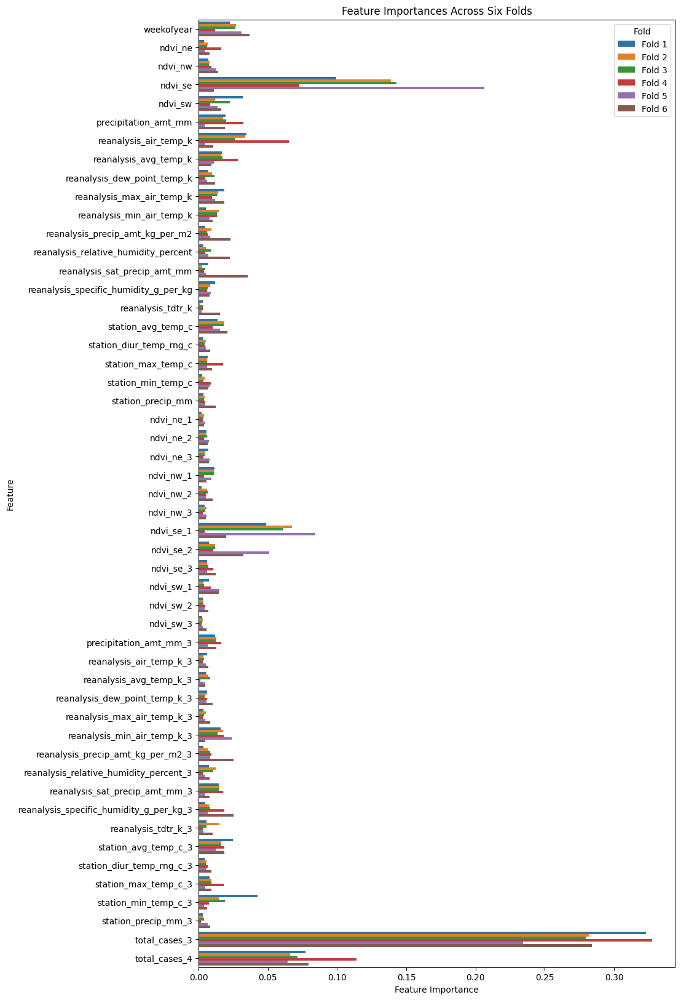

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


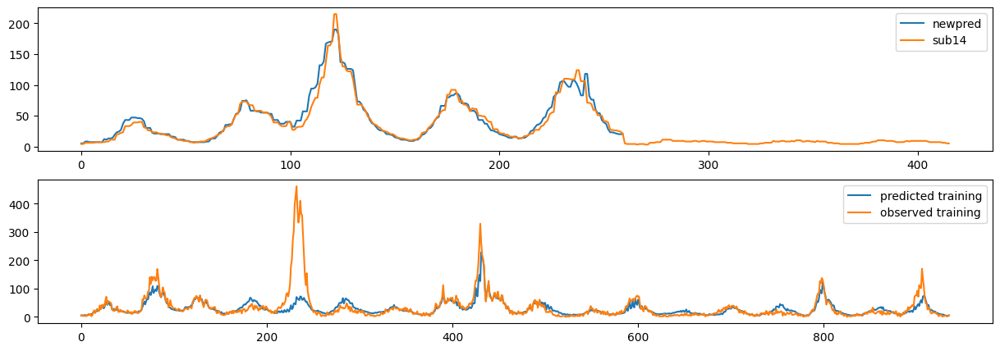

In [50]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=None,
                                                            label_lags=label_lags,circular_weekofyear=True,
                                                            weekofyear_shift=10)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True,
                                  weekofyear_shift=10)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

In [ ]:
# TO TRY: EXPLORE WEEKOFYEAR TO SPEED UP PEAKS AGAIN



~~~~~~~~~~~~~~~~~~~~~~~~~~
Running for feature lags (1,)

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             F

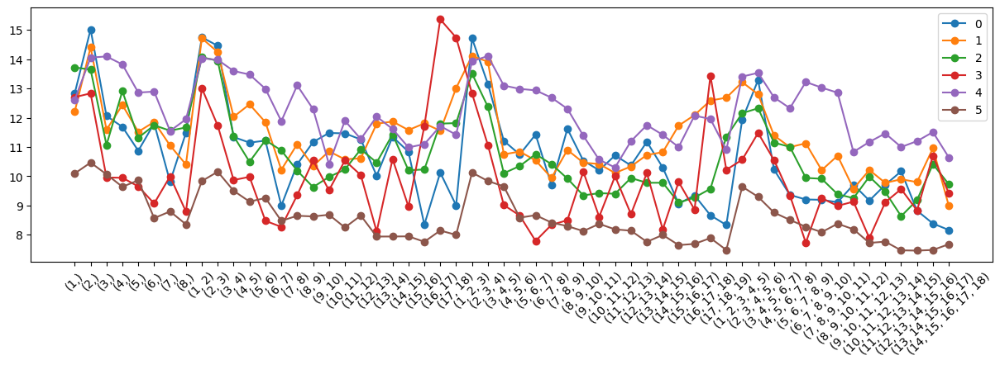

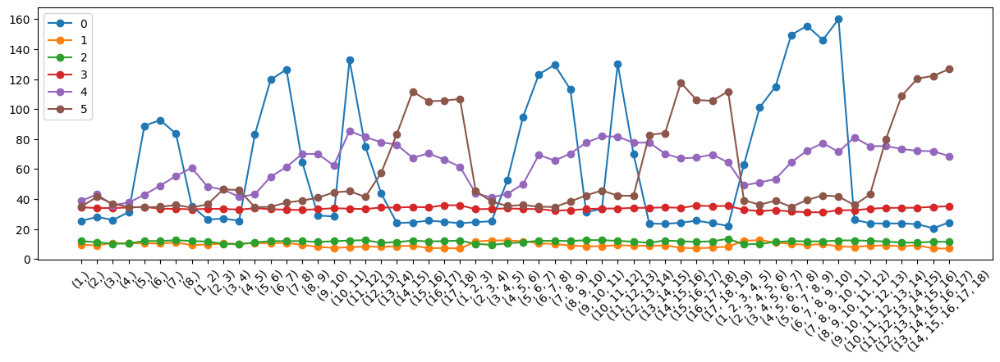

In [29]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']


all_train_maes = []
all_val_maes = []
all_feature_lags = [(1,),(2,),(3,),(4,),(5,),(6,),(7,),(8,)]
all_feature_lags += [tuple(range(n,n+2)) for n in range(1,18)]
all_feature_lags += [tuple(range(n,n+3)) for n in range(1,18)]
all_feature_lags += [tuple(range(n,n+5)) for n in range(1,15)]


for feature_lags in all_feature_lags:
    print('\n\n~~~~~~~~~~~~~~~~~~~~~~~~~~')
    print(f'Running for feature lags {feature_lags}')

    label_lags=(3,4)
    folds = 6
    fold_size = 0.15
    
    # fixed lags for ndvi features
    lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

    # Variable lags for other features
    lagged_features_others = {col:feature_lags for col in lagged_feature_names if not ('ndvi' in col)}
    
    lagged_features.update(lagged_features_others)

    # Preprocess to get lagged features/labels
    sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                                features_to_keep = feature_names,
                                                                lagged_features = lagged_features,
                                                                fillna = 'ffill', feature_lags=None,
                                                                label_lags=label_lags,circular_weekofyear=True)

    # Drop city column if training cities separately
    sj_features.drop(columns=['city_sj'],inplace=True)
    iq_features.drop(columns=['city_sj'],inplace=True)

    X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
        X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                            sj_labels, iq_labels,
                                                            folds=6, fold_size=0.15)

    # Reducing all lagged label weights to reduce their selection
    feature_weights = 100*np.ones(X_train_sj[0].shape[1])
    if label_lags is not None:
        feature_weights[-len(label_lags):] = 100

    xg_reg_sj = []
    train_maes_sj = []
    val_maes_sj = []
    for fold in range(folds):
        print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
        xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                        objective='reg:squarederror',
                                        reg_alpha=1,reg_lambda=1))

        modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
                useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
                trainCV_metrics = 'mae', eval_metric = 'mae',
                report_metric = metrics.mean_absolute_error, verbose=False,
                feature_weights=feature_weights)
        pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                                X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                                verbose=False,plot=False, MC=None, get_pred_train=True,
                                                median_filter=3)
        train_maes_sj.append(train_mae_sj)
        val_maes_sj.append(val_mae_sj)
        
    all_train_maes.append(train_maes_sj)
    all_val_maes.append(val_maes_sj)

df_train_maes_feat = pd.DataFrame(all_train_maes)
df_train_maes_feat = df_train_maes_feat.map(lambda x:x[0].item())

df_val_maes_feat = pd.DataFrame(all_val_maes)
df_val_maes_feat = df_val_maes_feat.map(lambda x:x[0].item())

plt.figure(figsize=(15, 4))
for column in df_train_maes_feat.columns:
    plt.plot(df_train_maes_feat[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend()

plt.figure(figsize=(15, 4))
for column in df_val_maes_feat.columns:
    plt.plot(df_val_maes_feat[column], marker='o', label=column)
plt.xticks(range(len(all_feature_lags)), all_feature_lags,rotation=45);
plt.legend();

## Submission

### template

In [ ]:
# Specify modelling parameters
label_lags=None
feature_lags=(1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,
                           sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj.shape[1])
if label_lags is not None:
        feature_weights[-len(label_lags):] = 10

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     min_child_weight = 20, subsample=0.7,
                                     gamma=10000,colsample_bytree = 0.6,
                                     reg_alpha=1,reg_lambda=1)
modelfit(model_sj, X_train_sj, y_train_sj,
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []
sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = None, feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

### Sub 24 - Trying Poisson count

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


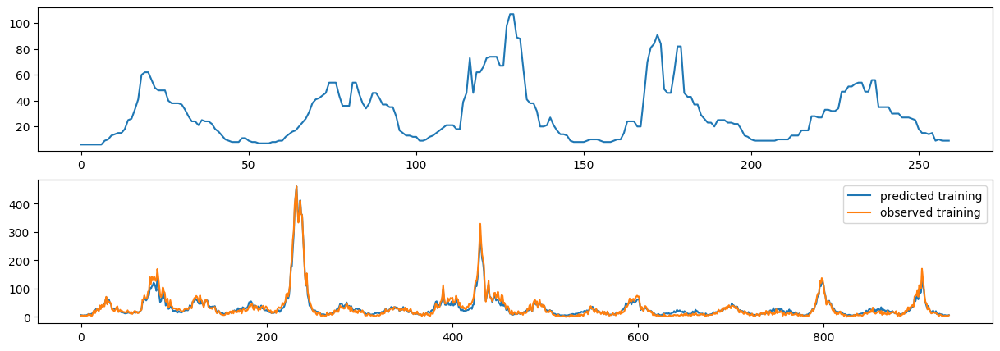

In [22]:
# Specify modelling parameters
label_lags=None
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj.shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10
else:
    lagged_label_names = []

model_sj = create_XGBmodel(eta=0.05,n_estimators=1000,max_depth=5,
                                     objective='count:poisson',
                                     min_child_weight = 1, subsample=0.8,
                                     gamma=1,colsample_bytree = 0.9,
                                     reg_alpha=10,reg_lambda=10)
modelfit(model_sj, X_train_sj, y_train_sj,
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = None, feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


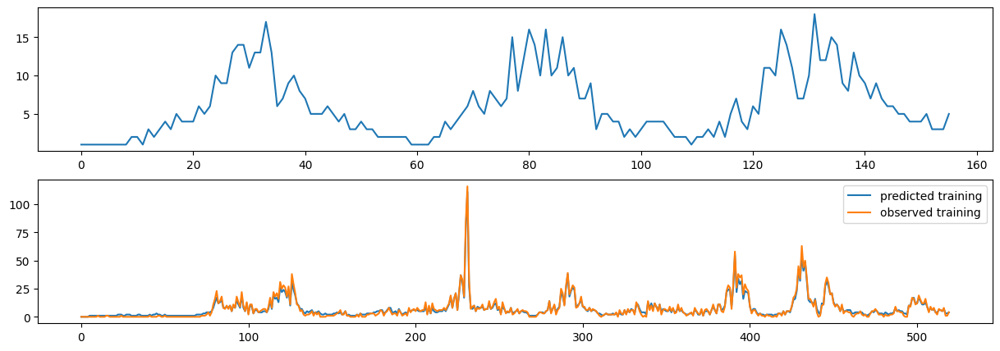

In [28]:
# Specify modelling parameters
label_lags=None
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq,= prep_data(sj_features, iq_features,sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq.shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10
else:
    lagged_label_names = []

model_iq = create_XGBmodel(eta=0.05,n_estimators=1000,max_depth=5,
                                     objective='count:poisson',
                                     min_child_weight = 1, subsample=0.8,
                                     gamma=1,colsample_bytree = 0.9,
                                     reg_alpha=10,reg_lambda=10)
modelfit(model_iq, X_train_iq, y_train_iq,
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = None, feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
# iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

In [42]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
submission.to_csv("./submission_24.csv")

### Sub 25 - reg squarederror no label lags

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


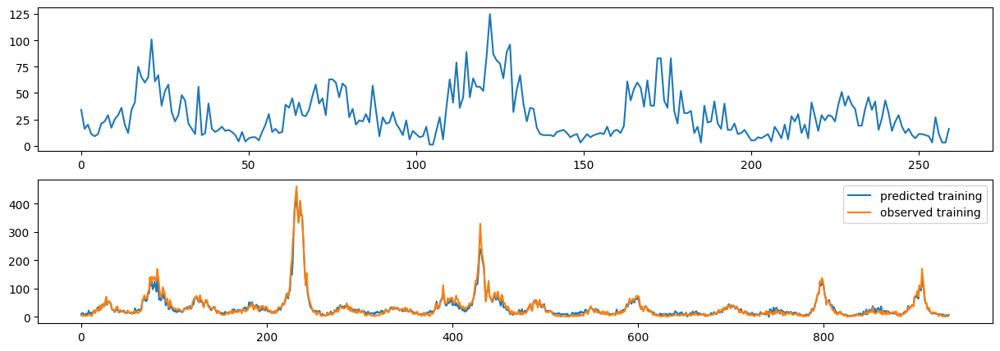

In [38]:
# Specify modelling parameters
label_lags=(3,4)
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    _, _, _, _ = prep_data(sj_features, iq_features,sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj.shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 0.3
else:
    lagged_label_names = []

model_sj = create_XGBmodel(eta=0.05,n_estimators=1000,max_depth=5,
                                     objective='reg:squarederror',
                                     min_child_weight = 1, subsample=0.8,
                                     gamma=1,colsample_bytree = 0.9,
                                     reg_alpha=10,reg_lambda=10)
modelfit(model_sj, X_train_sj, y_train_sj,
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = None, feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
# sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


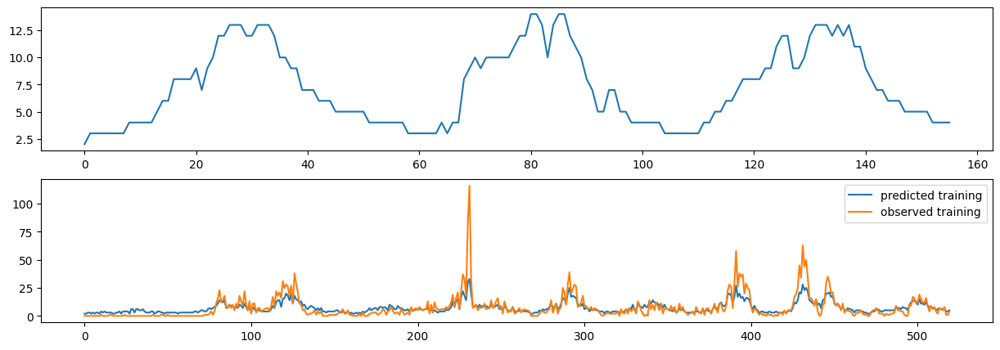

In [31]:
# Specify modelling parameters
label_lags=(3,4)
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq,= prep_data(sj_features, iq_features,sj_labels, iq_labels,
                           folds=6, fold_size=0.15)

X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq.shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 0.3
else:
    lagged_label_names = []

model_iq = create_XGBmodel(eta=0.05,n_estimators=1000,max_depth=5,
                                     objective='reg:squarederror',
                                     min_child_weight = 1, subsample=0.8,
                                     gamma=1,colsample_bytree = 0.9,
                                     reg_alpha=10,reg_lambda=10)
modelfit(model_iq, X_train_iq, y_train_iq,
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)

if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = None, feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

In [32]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
submission.to_csv("./submission_25.csv")

### Sub 26 - using lags, but reducing effect of other features through regularization


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

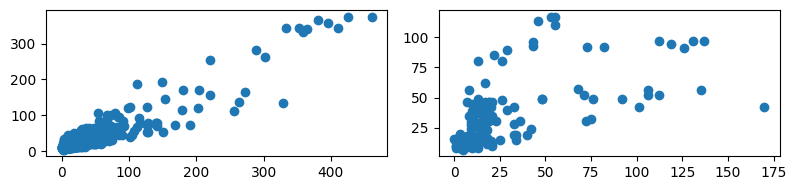

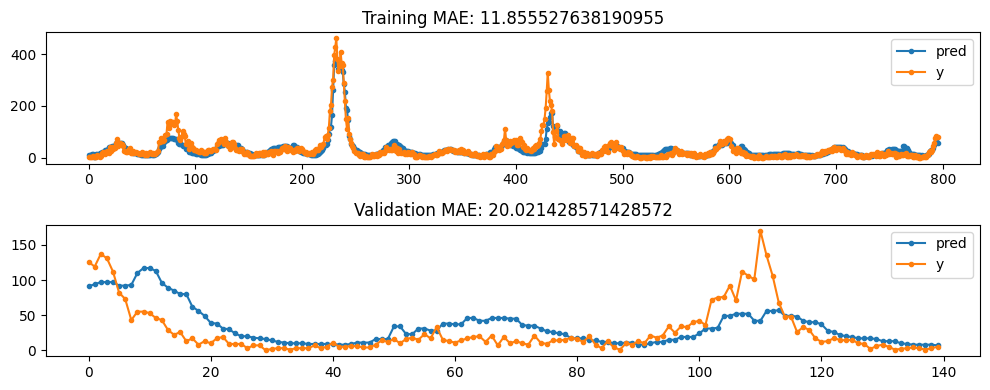

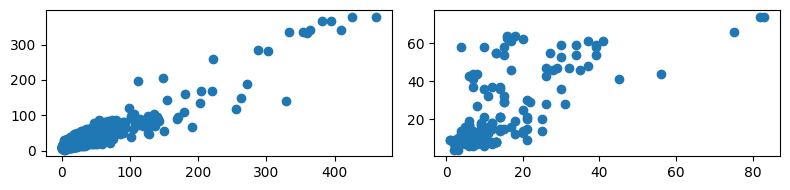

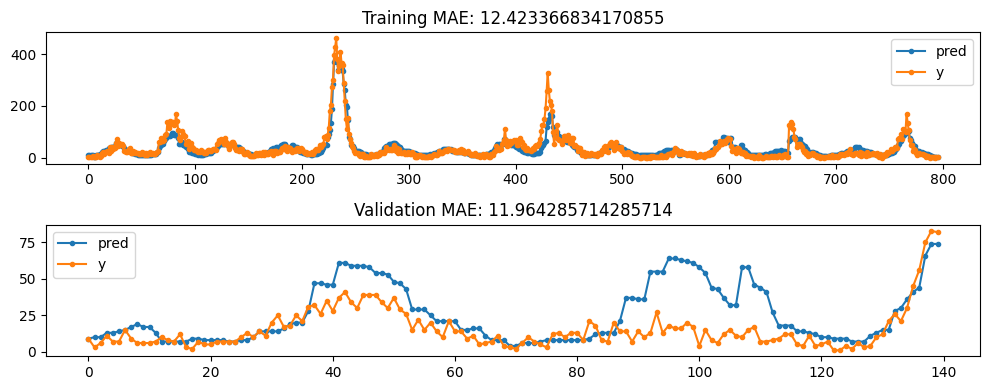

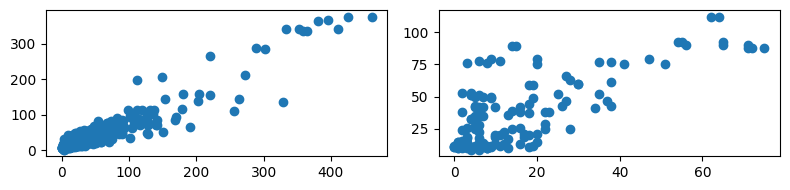

...

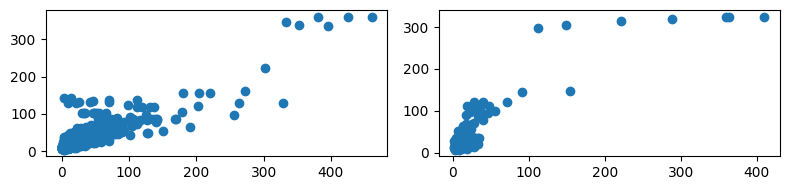

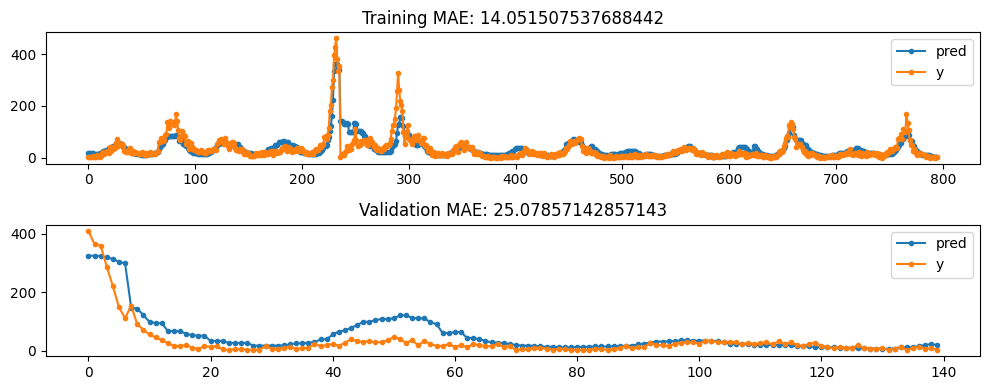

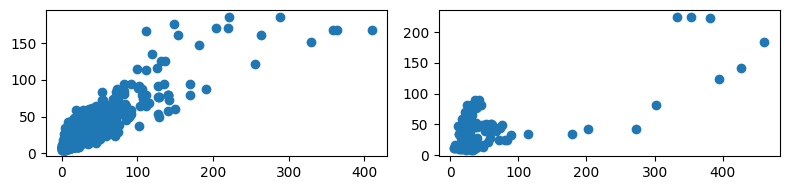

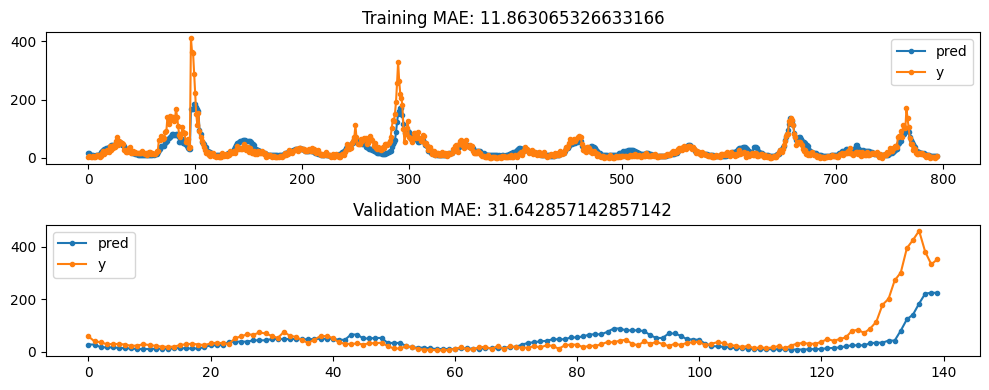

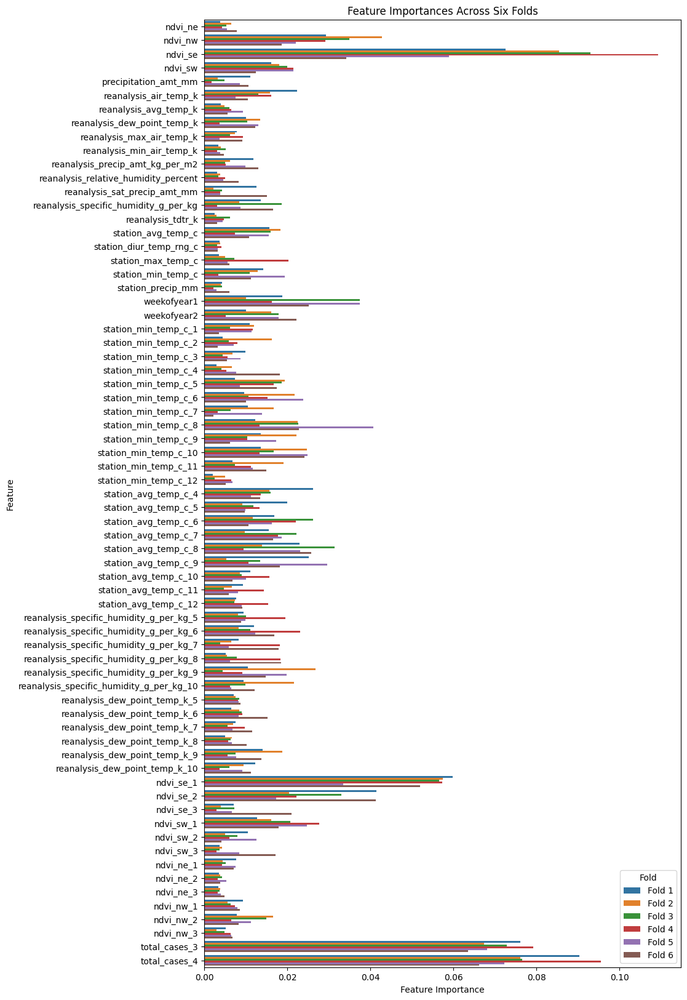

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


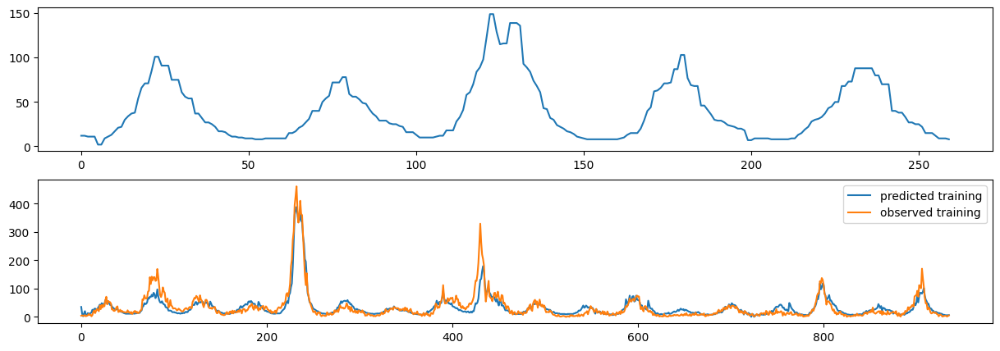

In [39]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []

label_lags=(3,4)
# label_lags=None

# feature_lags = (3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=4
objective='reg:squarederror'
min_child_weight=10
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

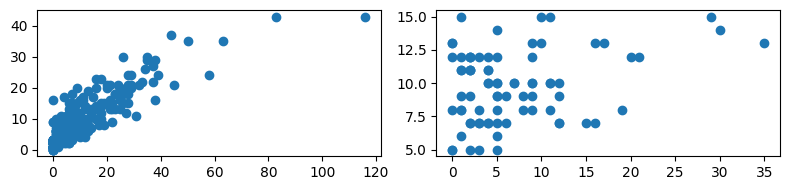

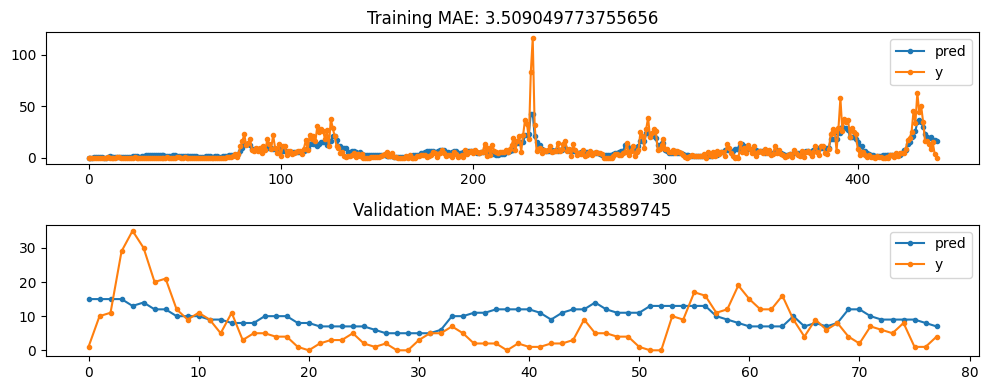

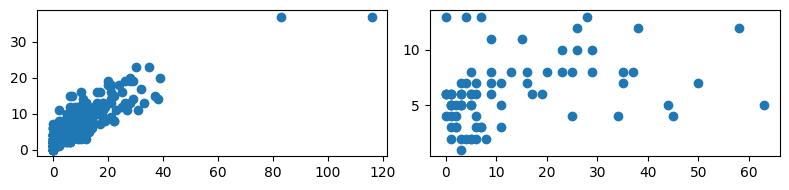

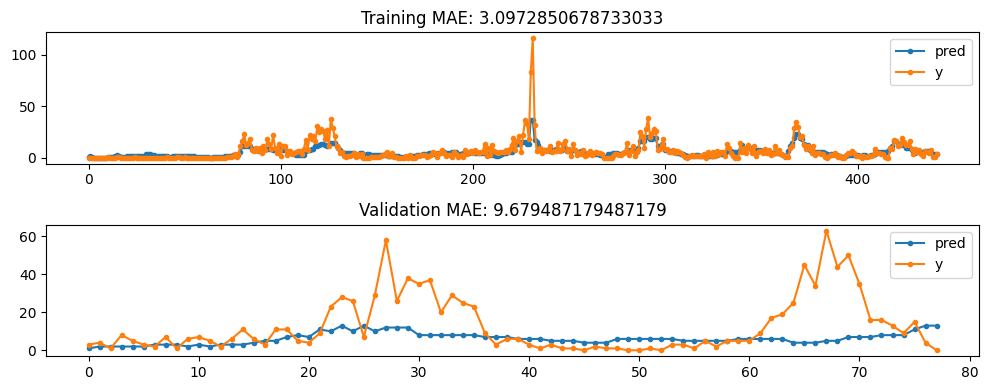

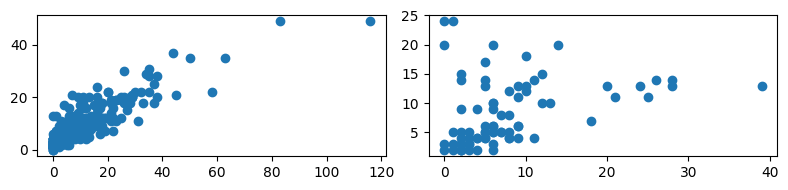

...

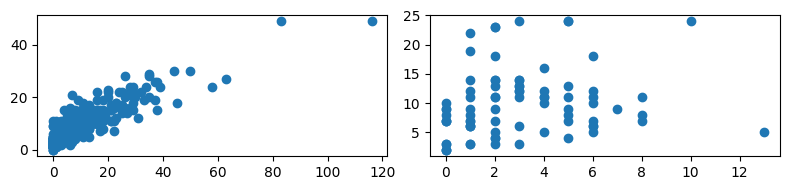

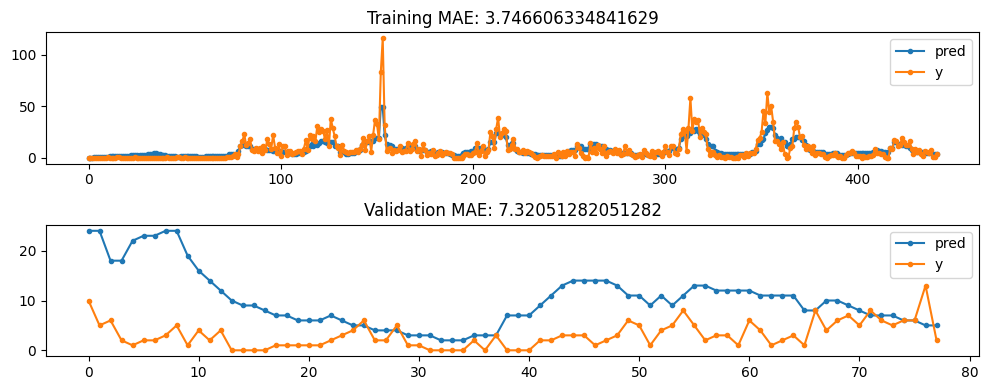

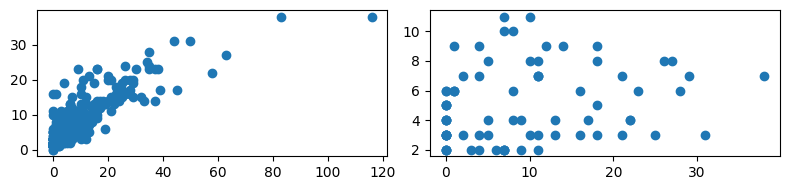

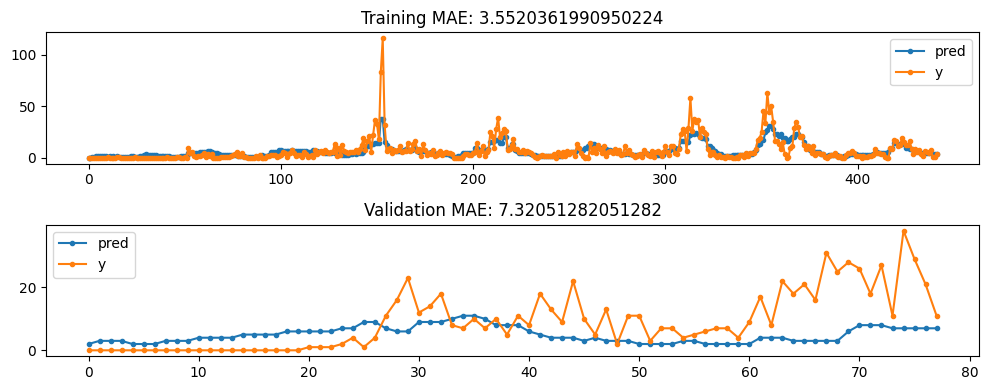

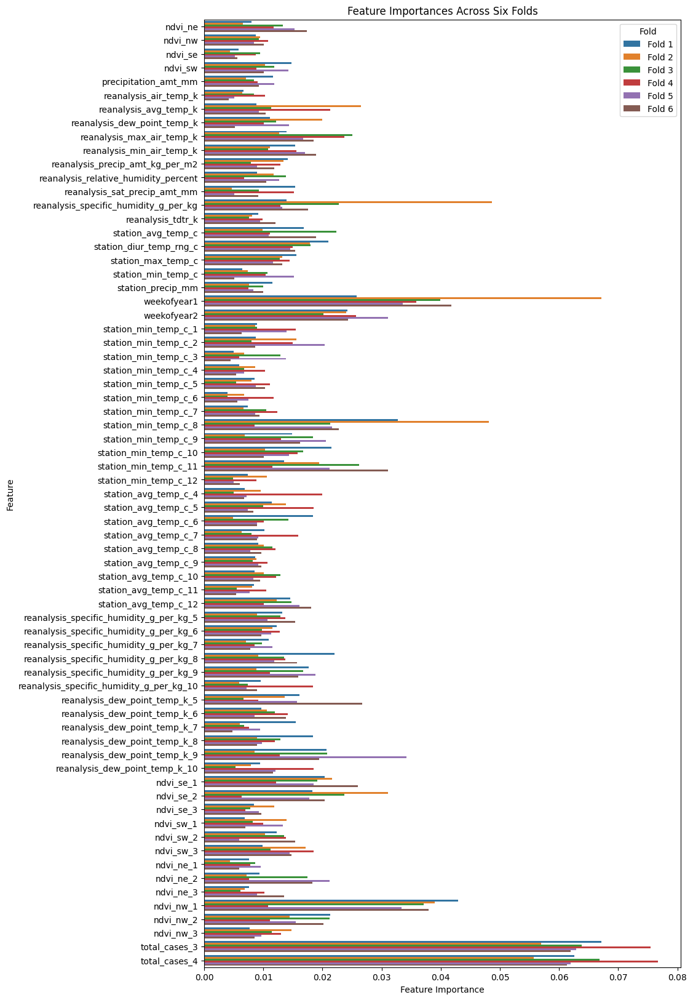

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


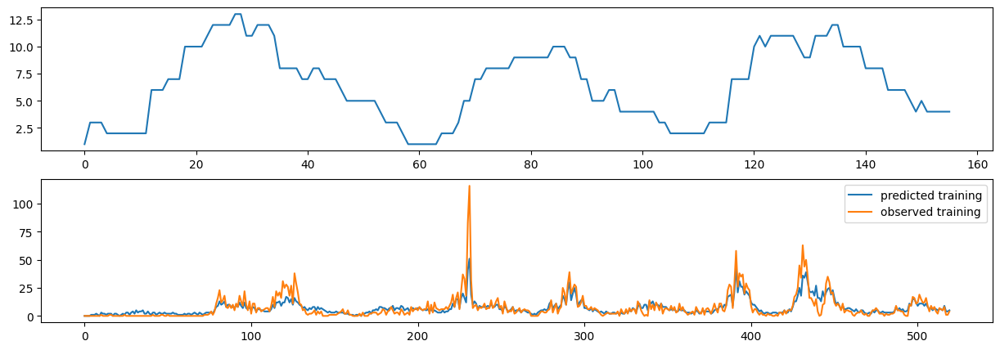

In [40]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_iq = []

label_lags=(3,4)
# label_lags=None

# feature_lags = (3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=4
objective='reg:squarederror'
min_child_weight=10
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index().reset_index(drop=True), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

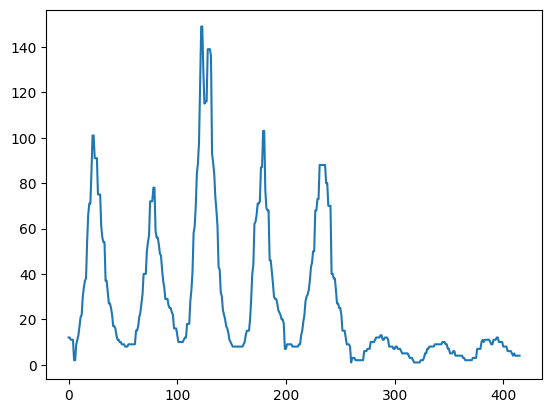

In [41]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_26.csv")

### sub 27- ???


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

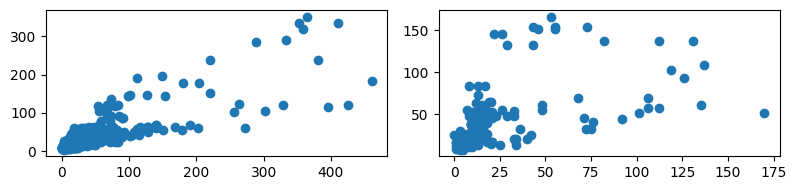

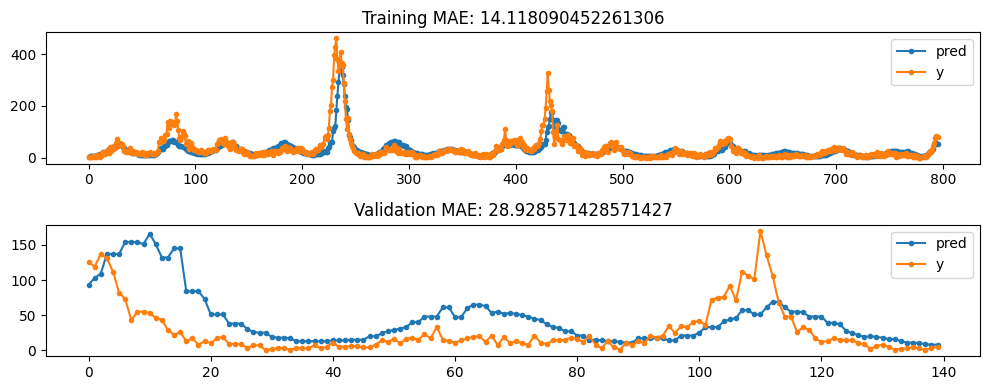

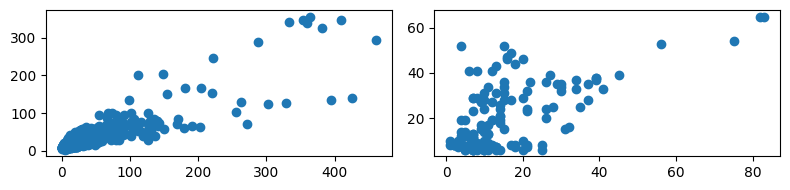

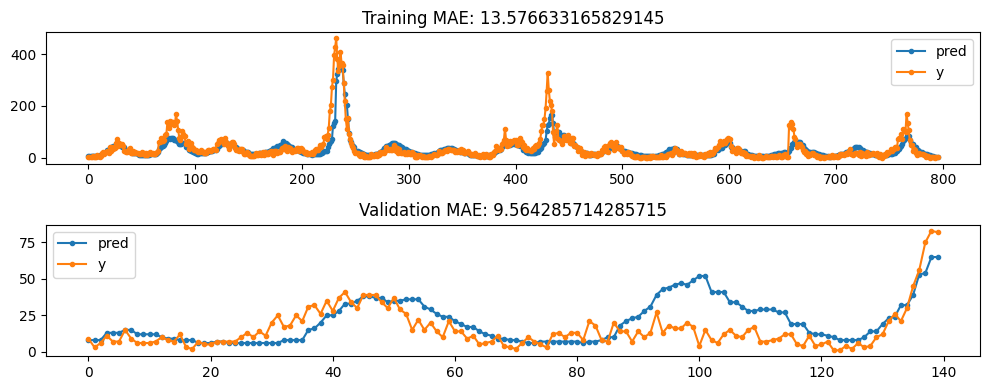

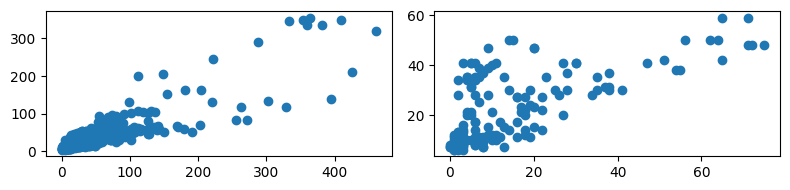

...

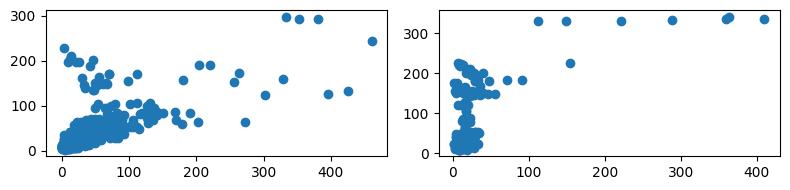

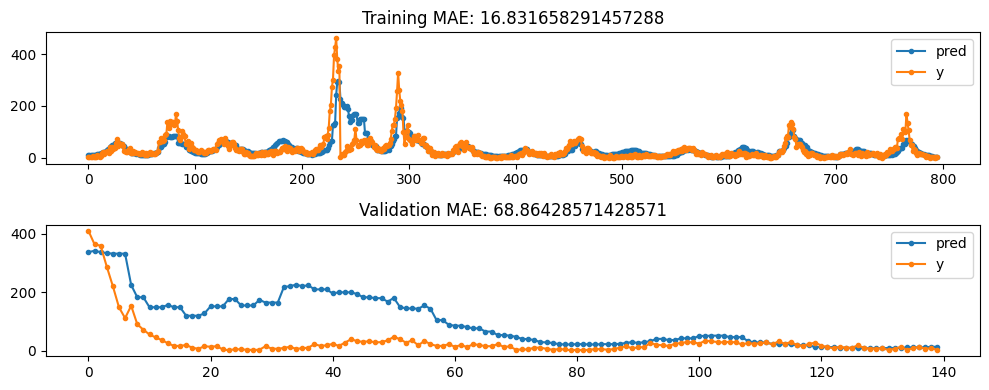

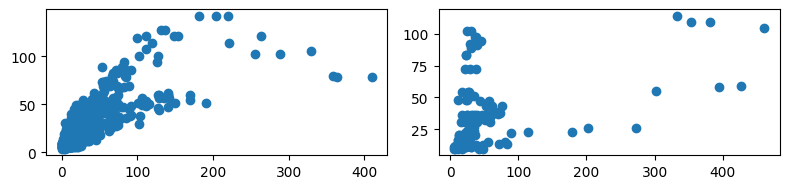

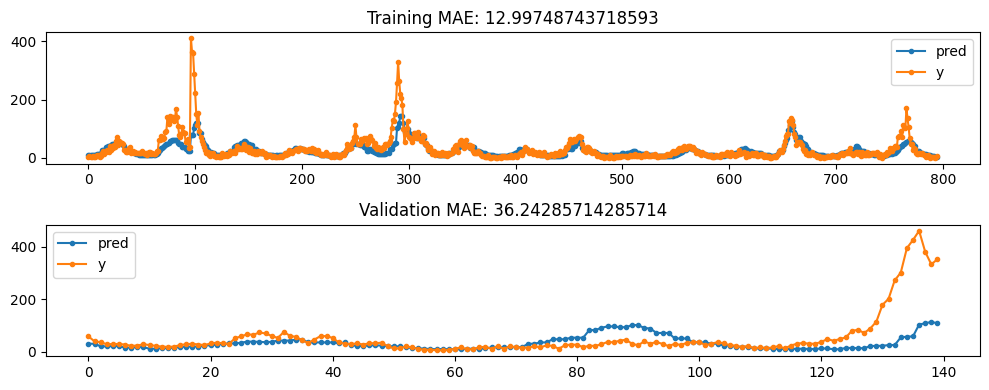

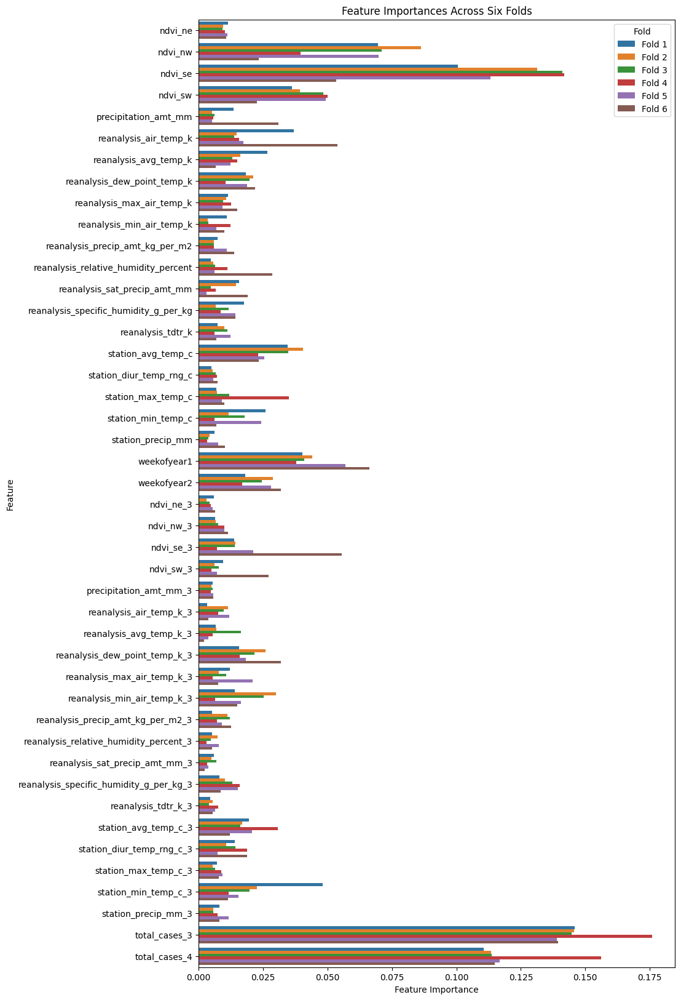

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


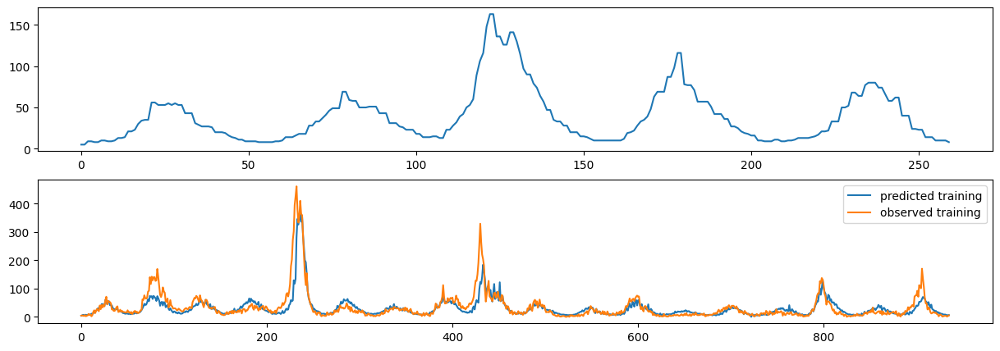

In [44]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []

label_lags=(3,4)
# label_lags=None

feature_lags = (3,)
lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=10
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 30

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

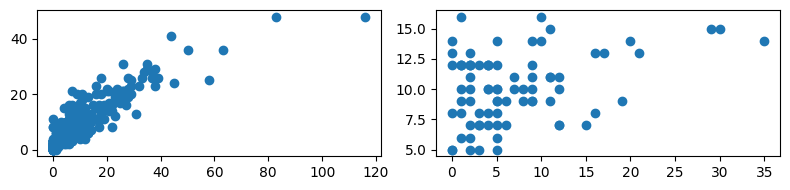

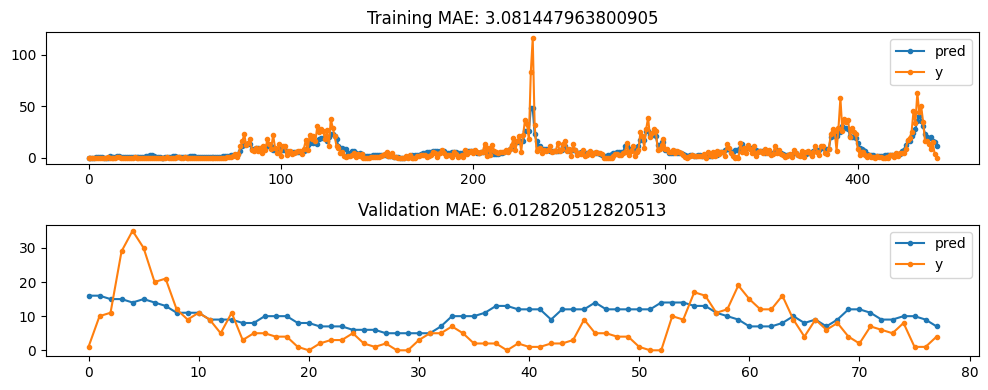

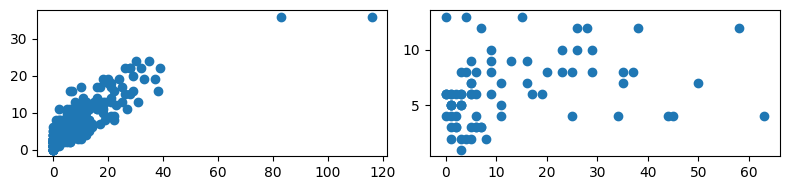

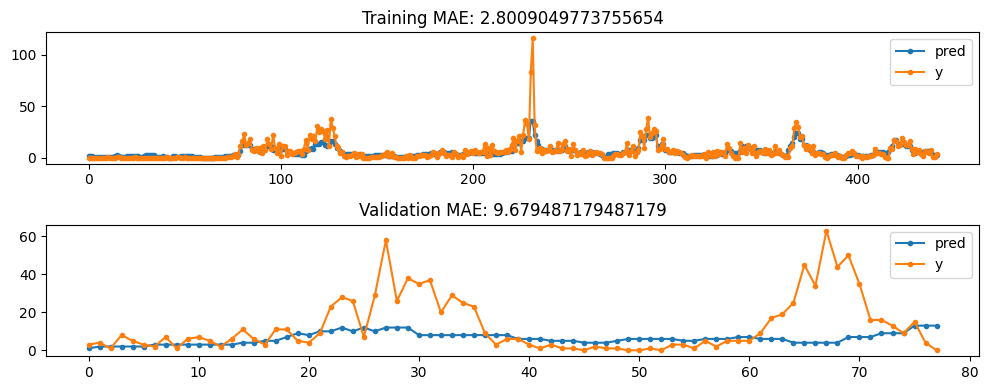

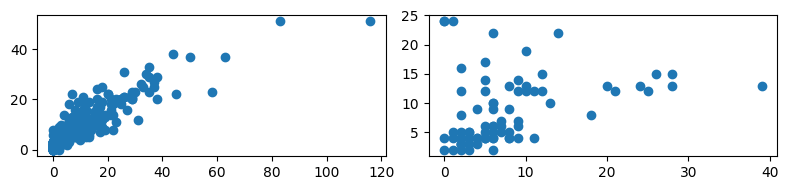

...

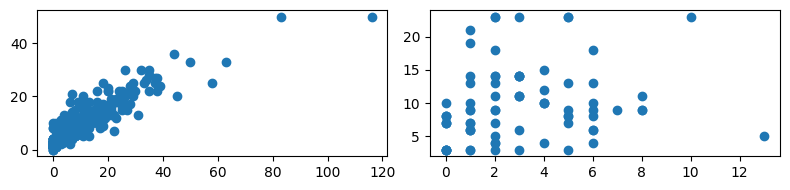

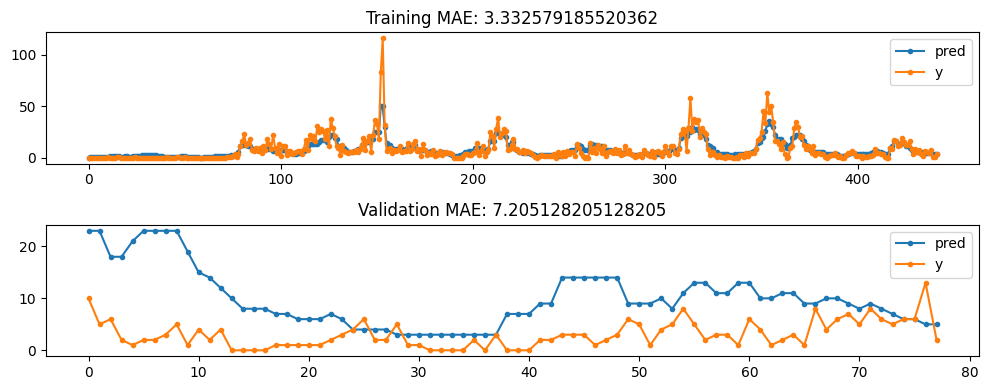

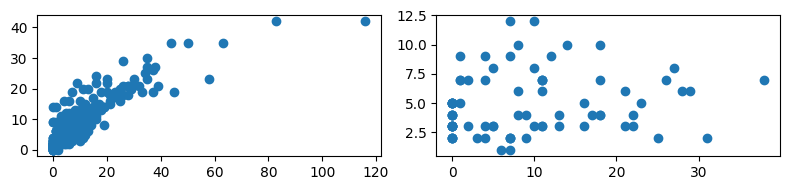

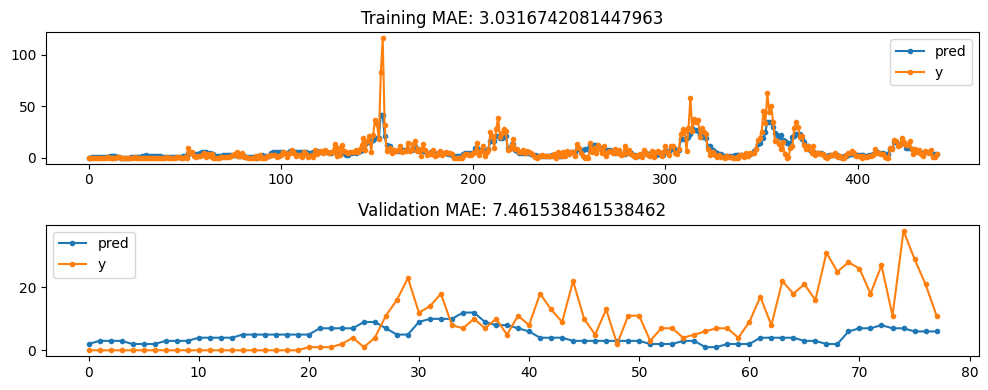

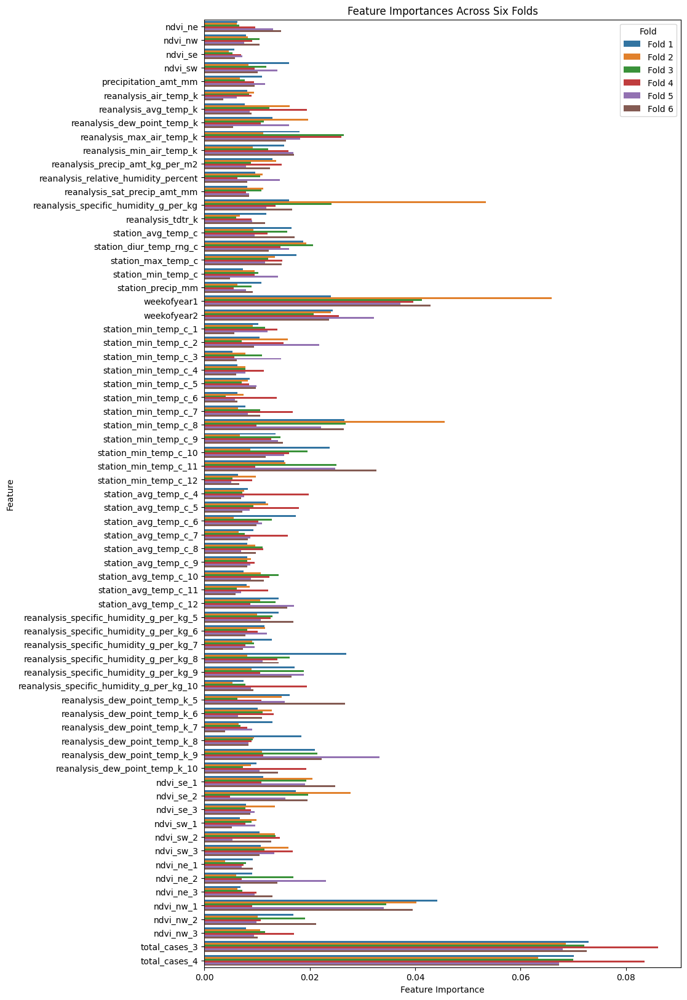

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


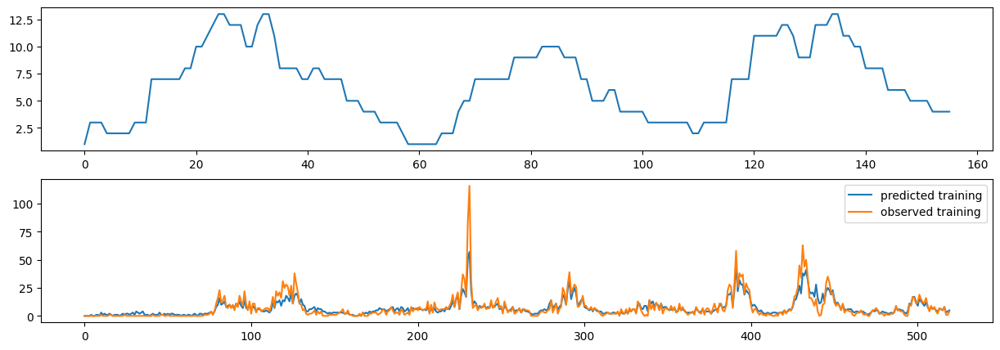

In [42]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_iq = []

label_lags=(3,4)
# label_lags=None

# feature_lags = (3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
                   'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
                   'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
                   'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
                   'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=10
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 10

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index().reset_index(drop=True), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

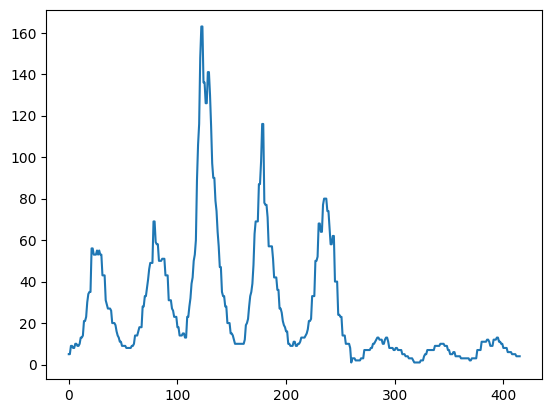

In [45]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_27.csv")

### Sub 28 - back to best case for a bit to regroup


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

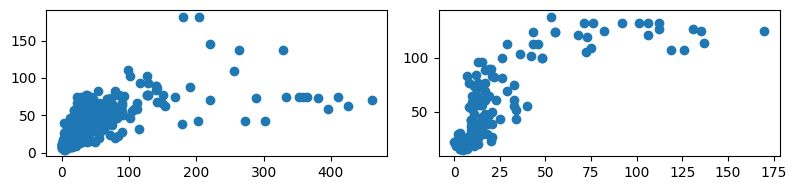

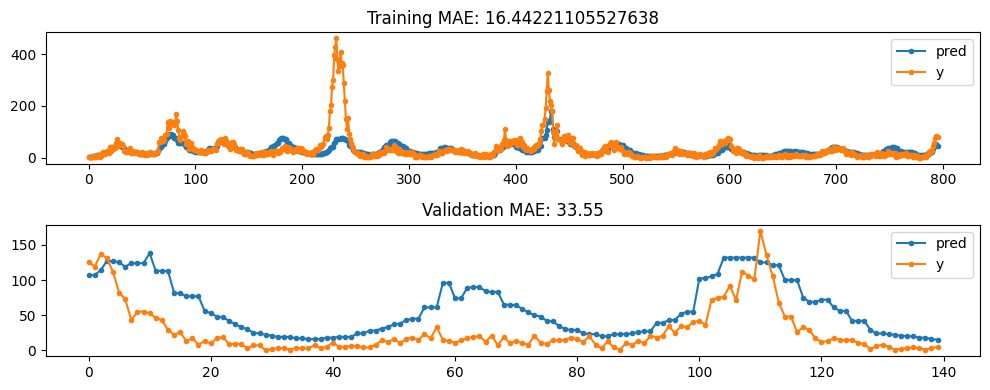

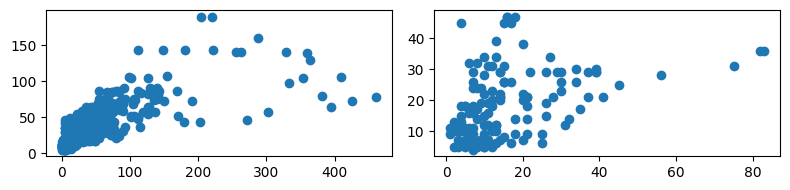

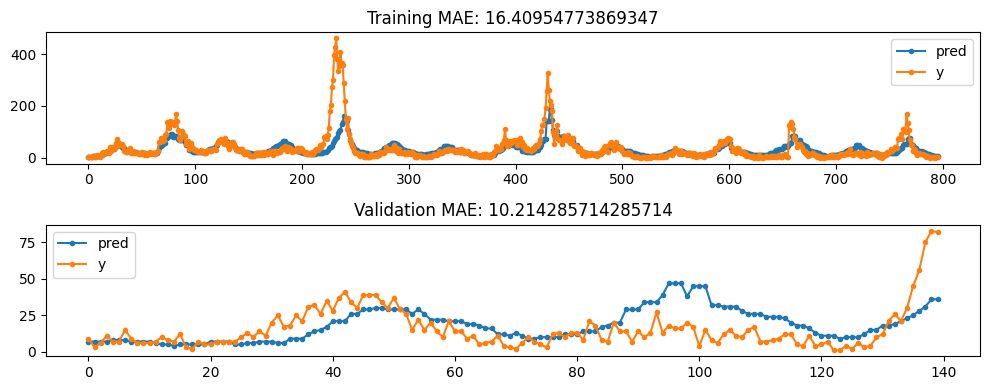

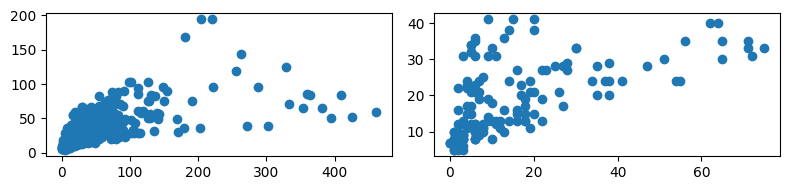

...

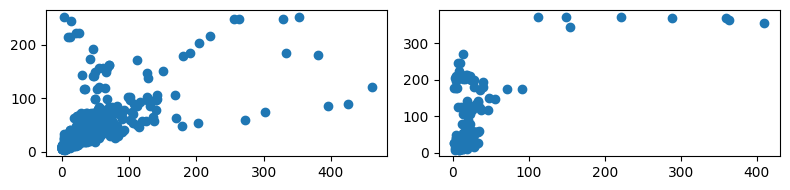

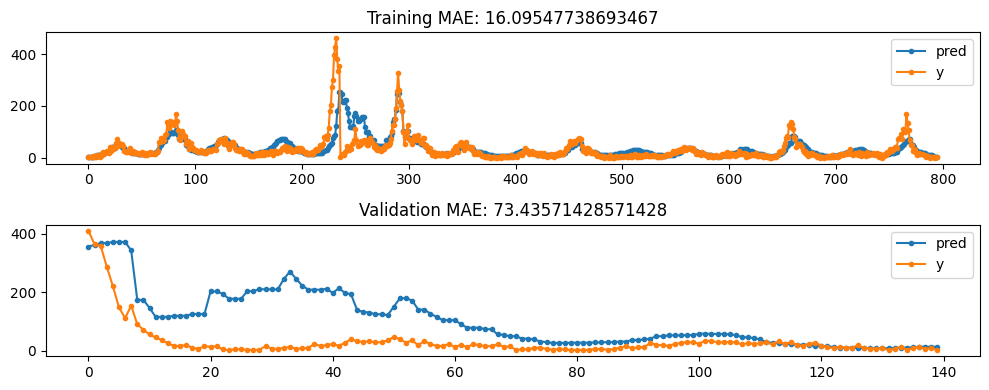

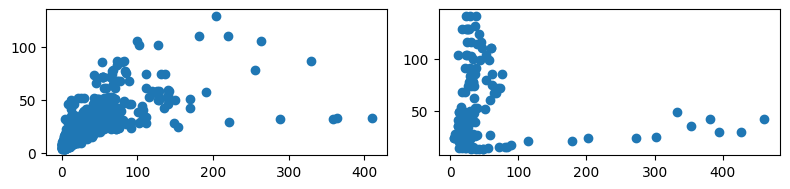

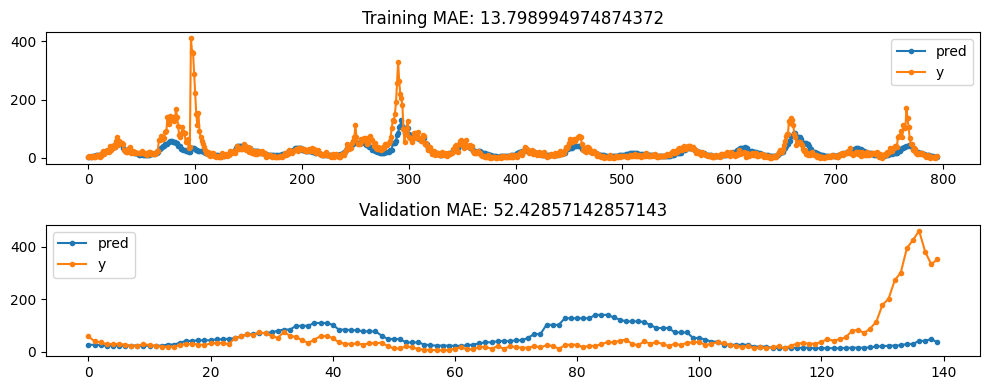

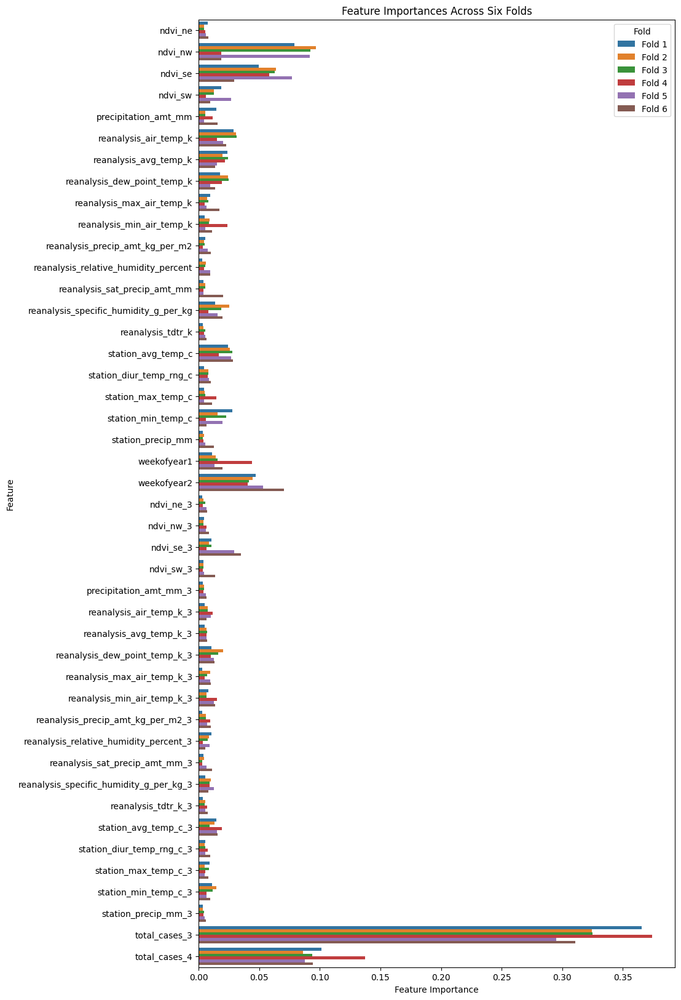

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


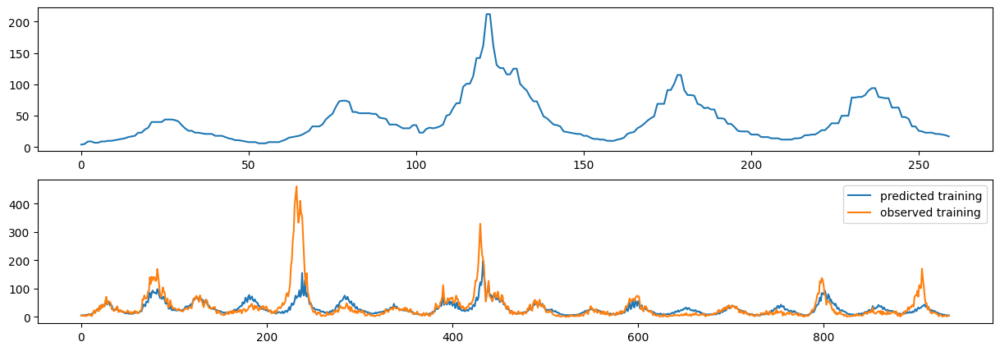

In [52]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []

label_lags=(3,4)
# label_lags=None

feature_lags = (3,)
lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=1
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

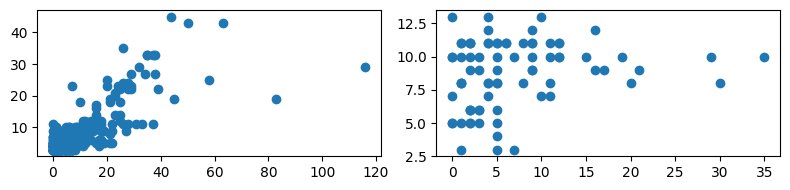

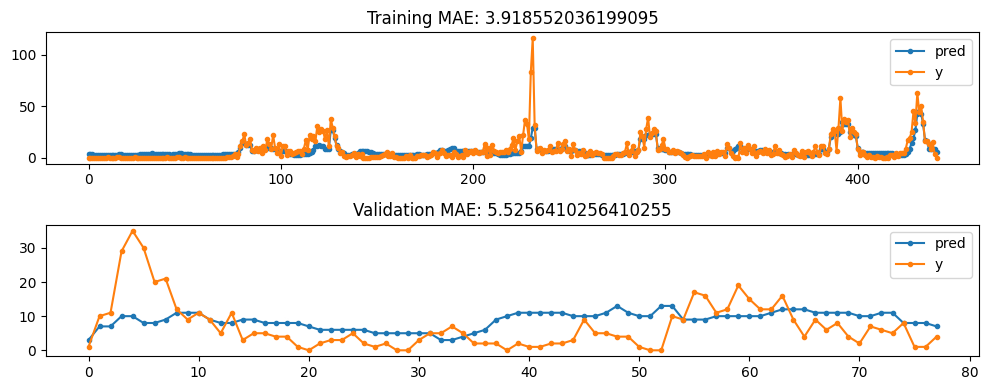

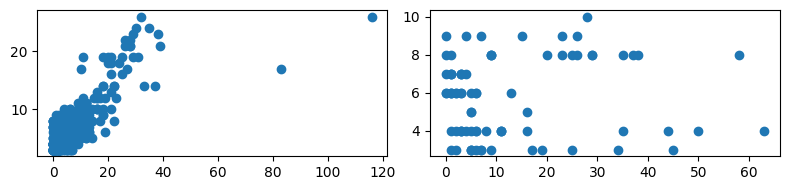

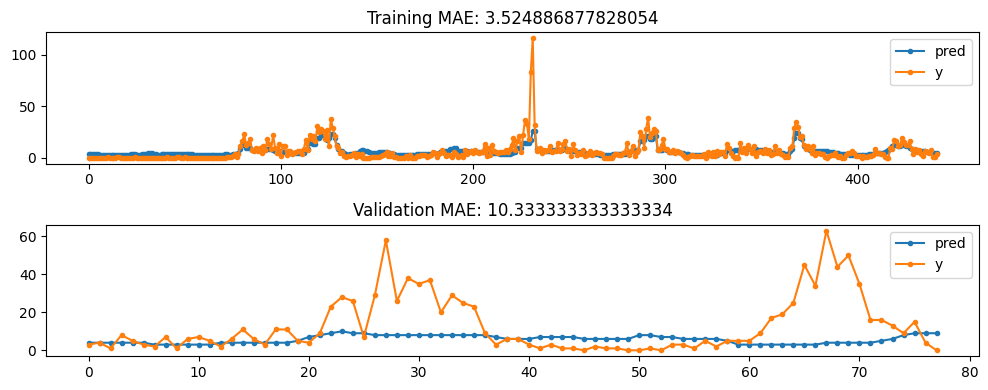

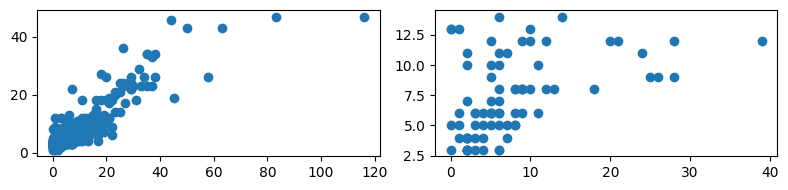

...

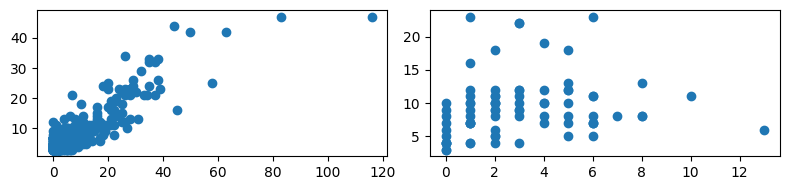

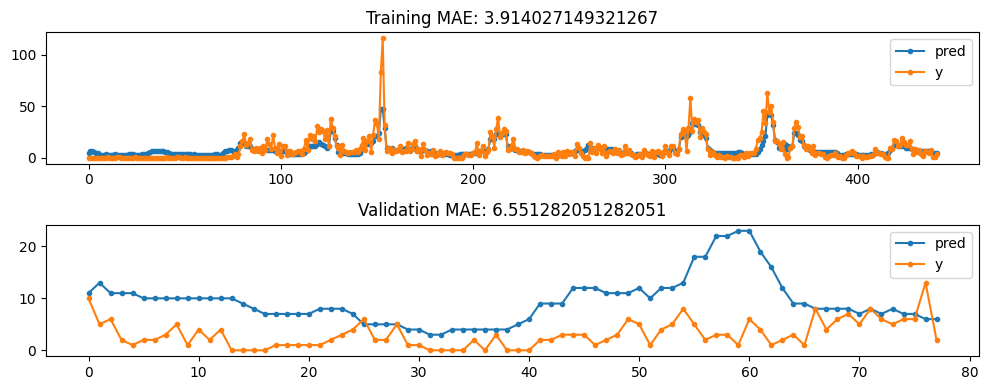

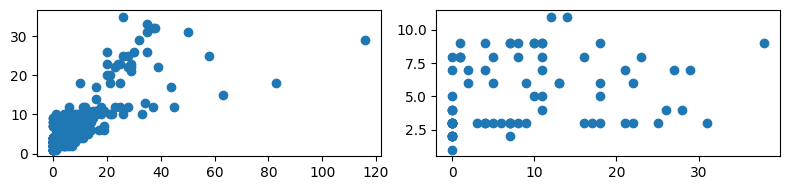

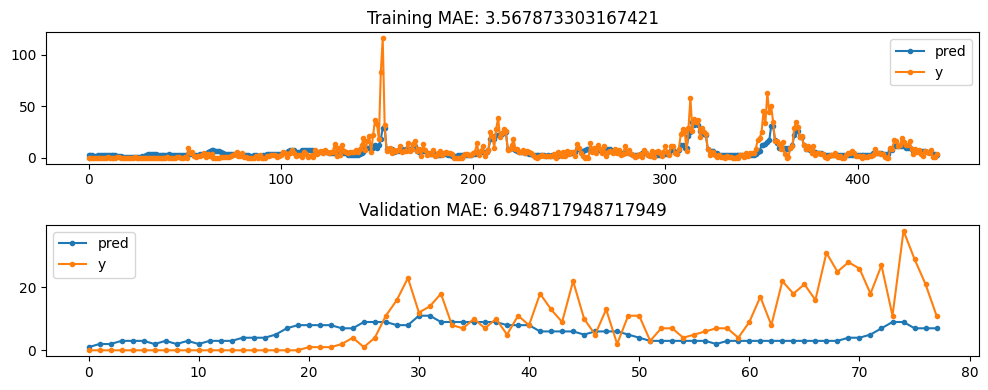

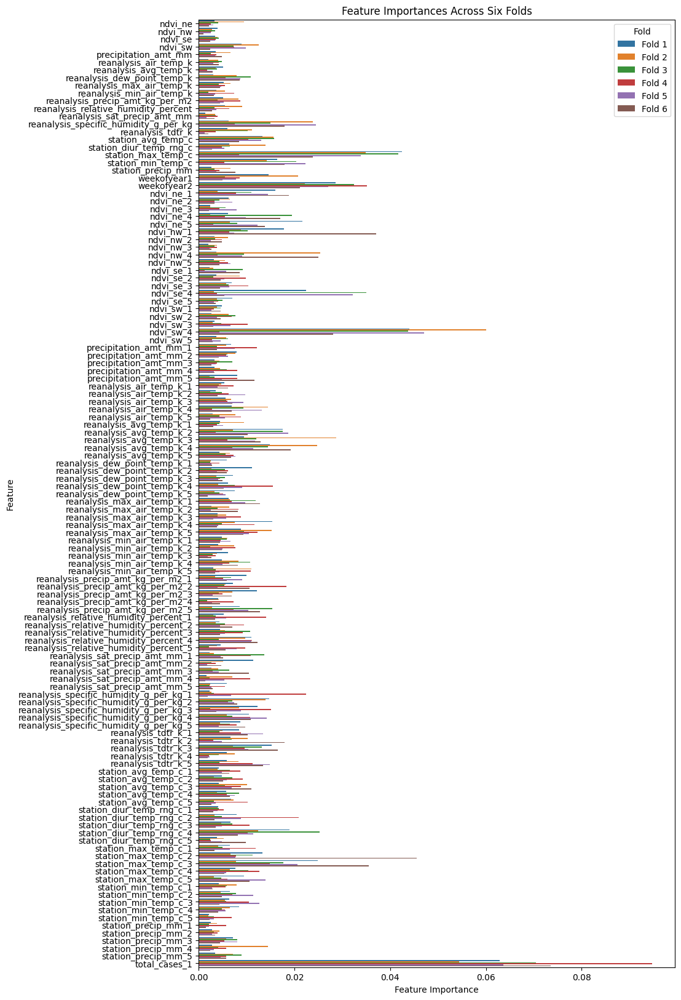

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


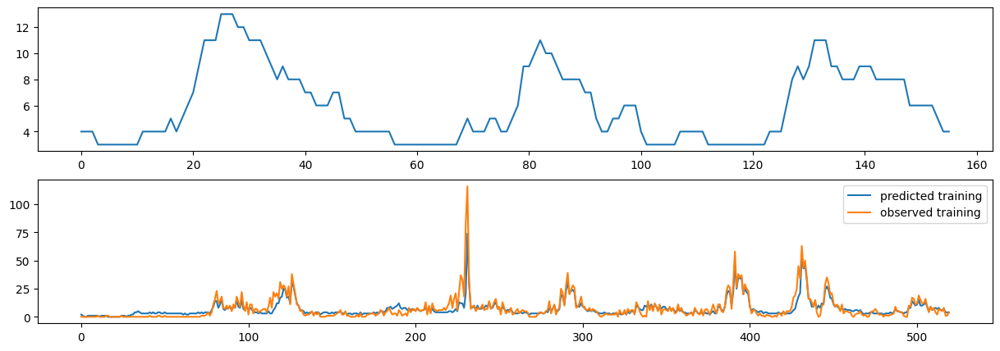

In [53]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_iq = []

label_lags=(1,)
# label_lags=None

feature_lags = (1,2,3,4,5)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=1
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = None, feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index().reset_index(drop=True), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

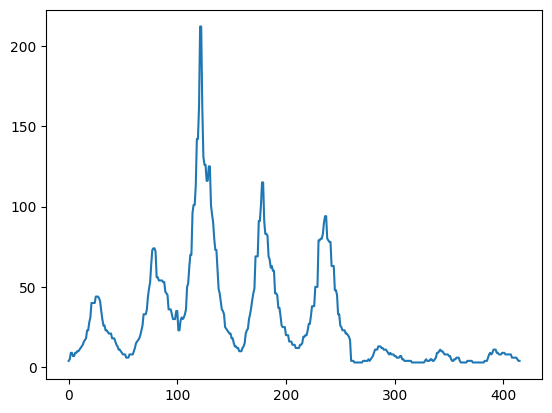

In [54]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_28.csv")

### Sub 29 - closer than sub 28 to best case earlier, for reference

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.

 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d599

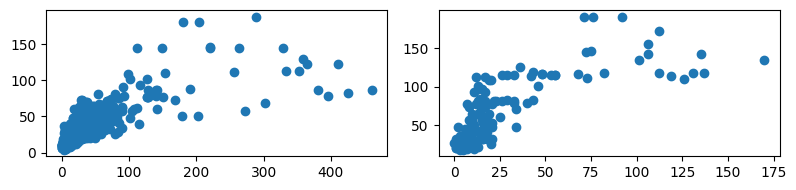

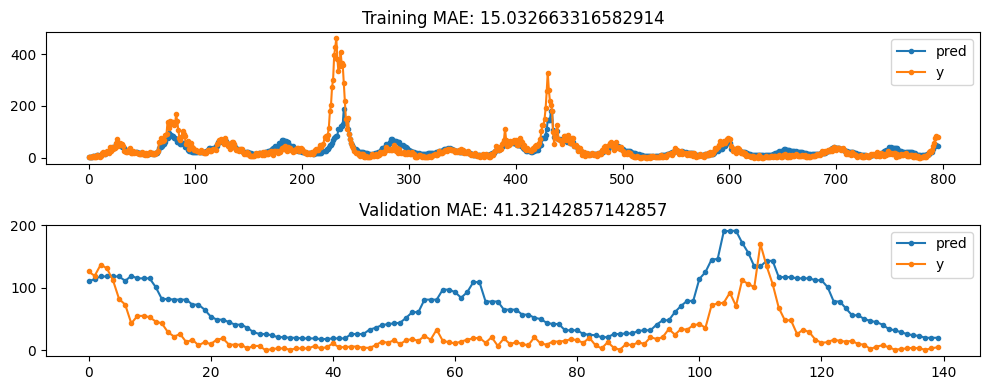

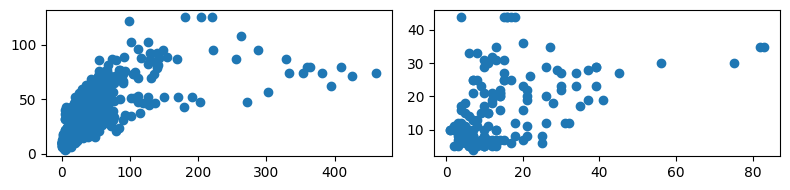

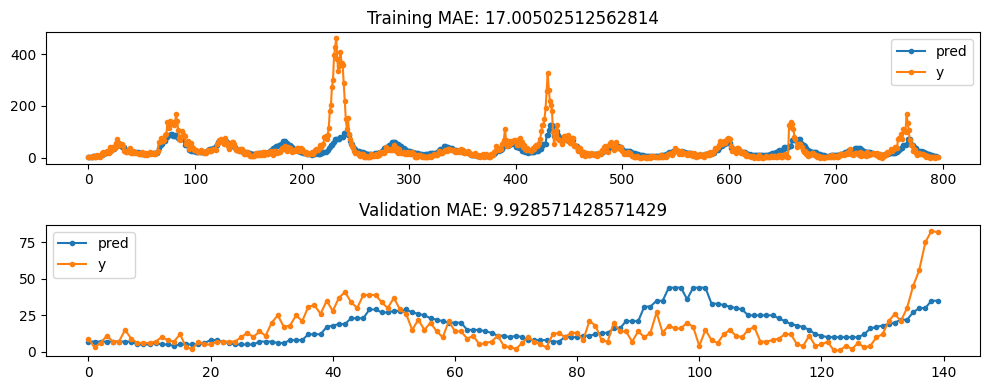

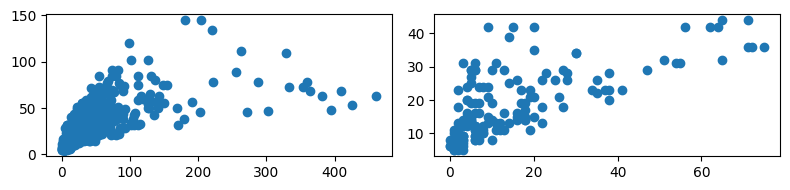

...

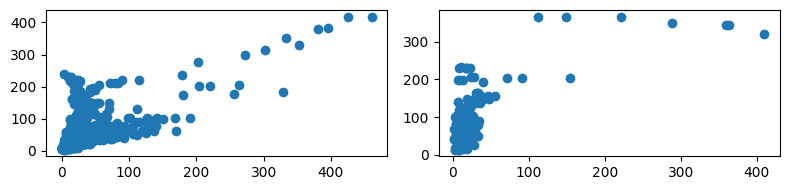

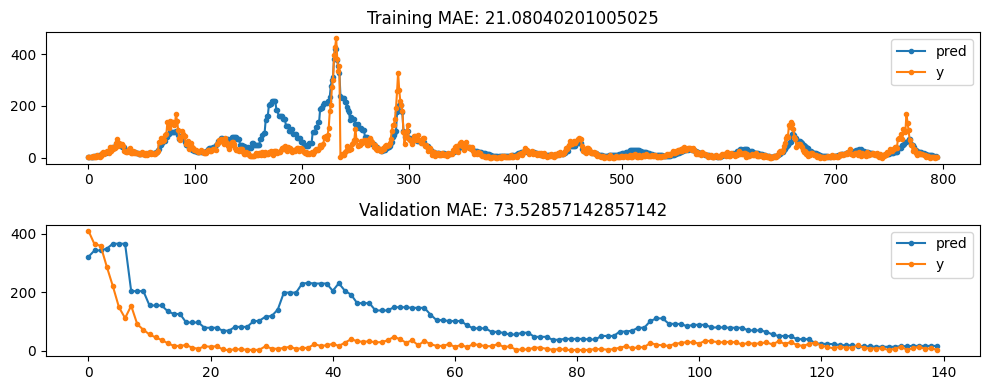

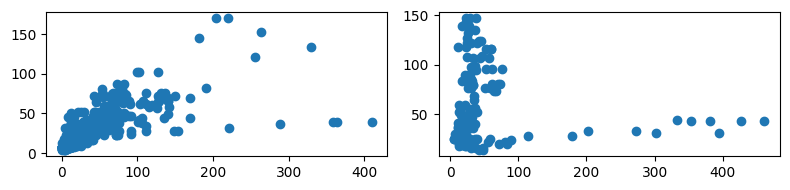

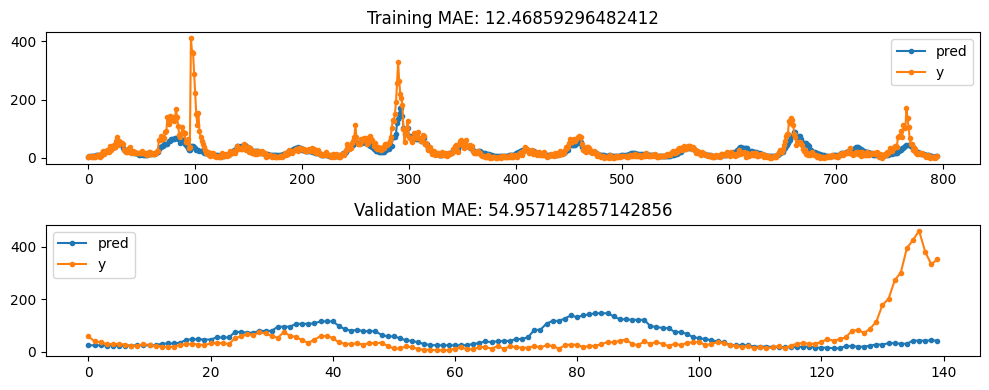

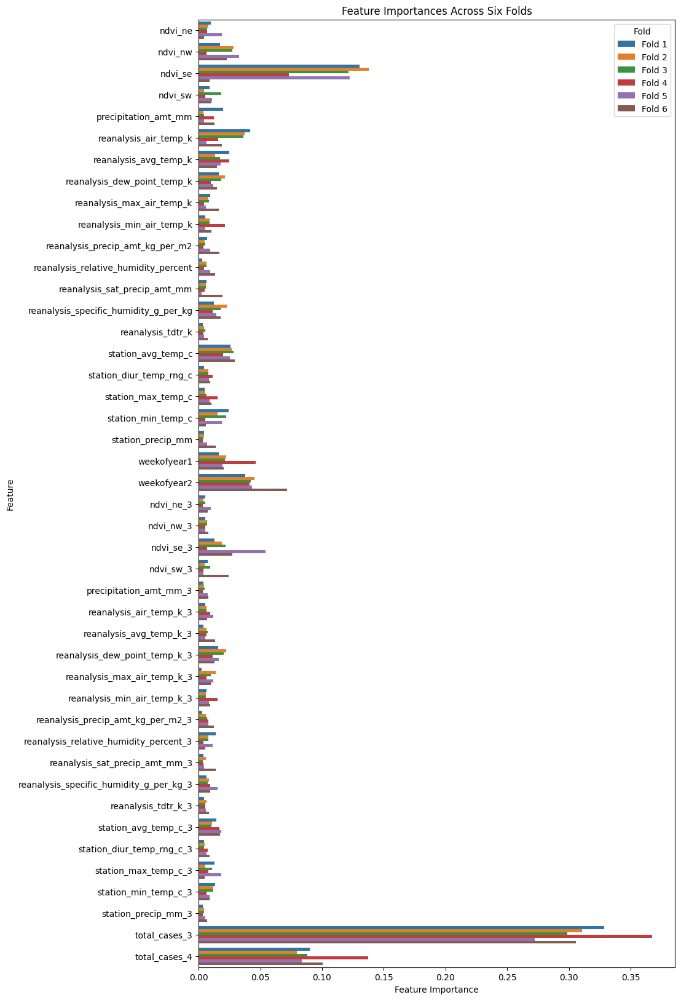

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


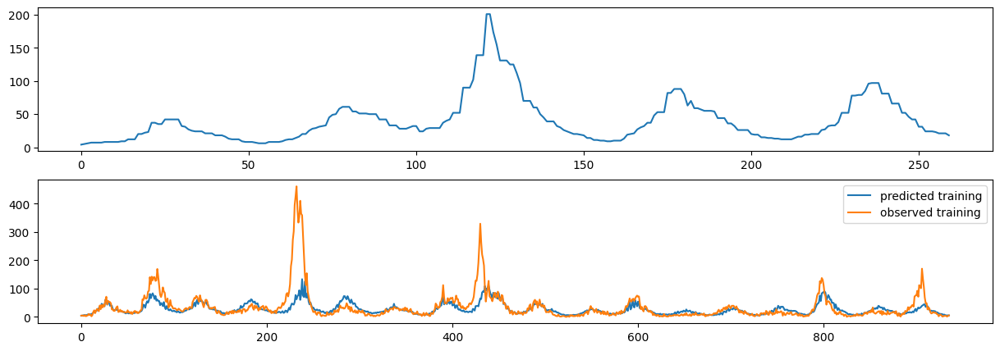

In [6]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []

label_lags=(3,4)
# label_lags=None

feature_lags = (3,)
lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=1.02
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    # feature_weights[-len(label_lags):] = 100
    feature_weights[-len(label_lags)] = 100
    feature_weights[-1] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

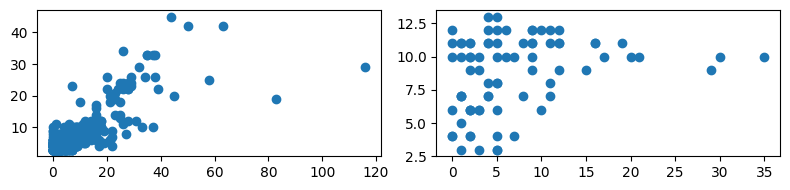

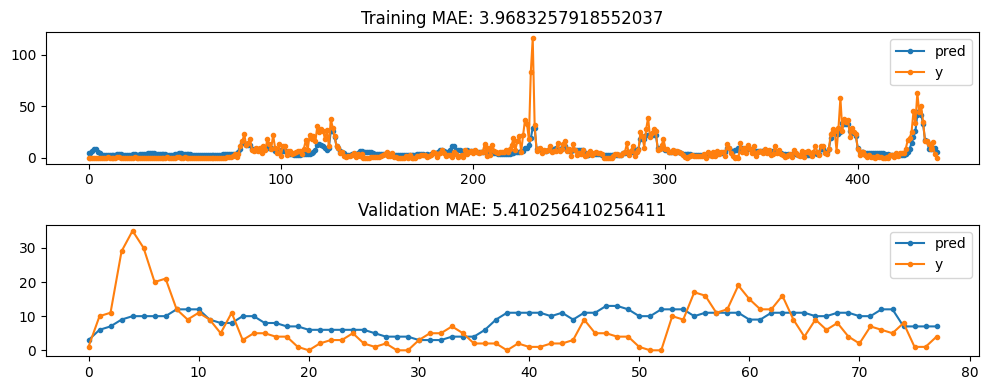

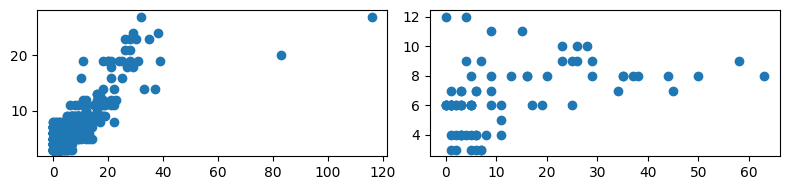

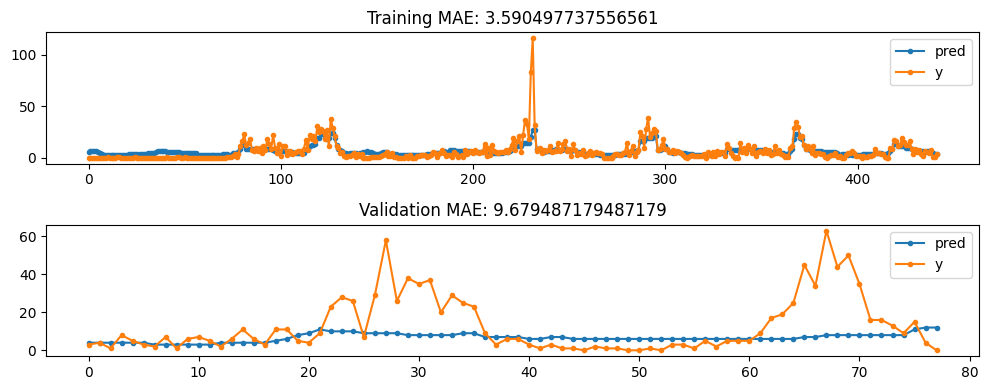

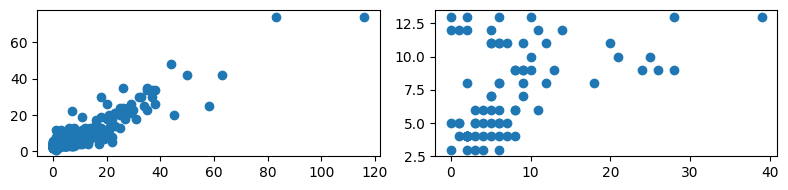

...

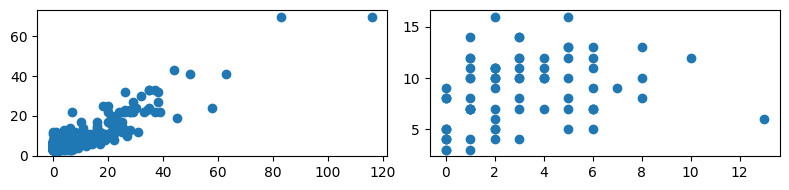

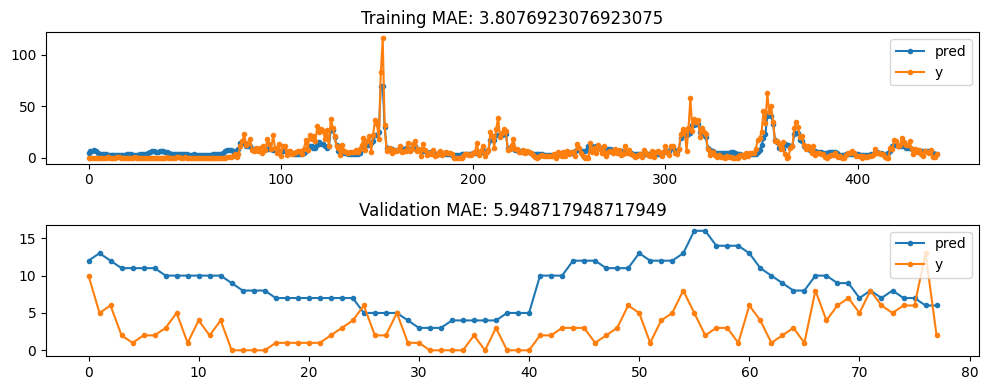

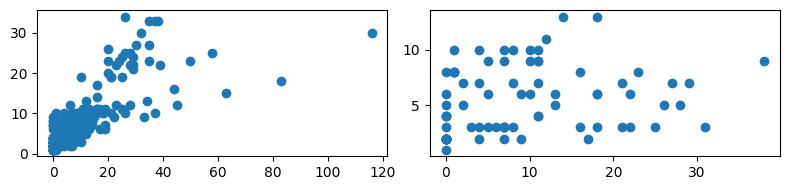

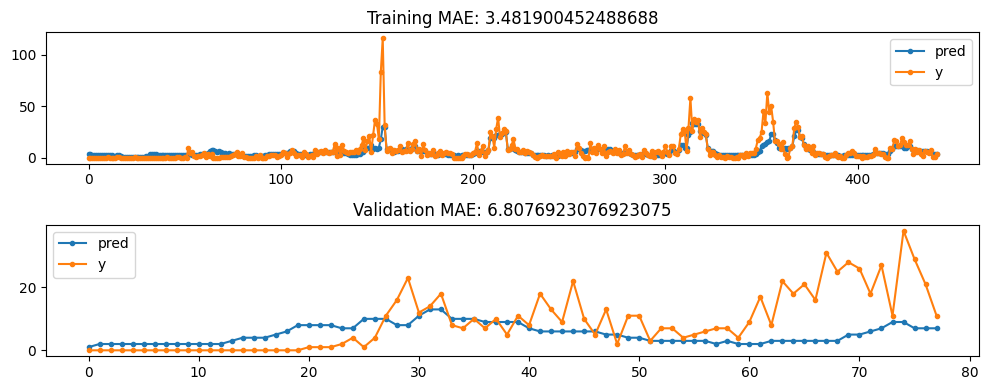

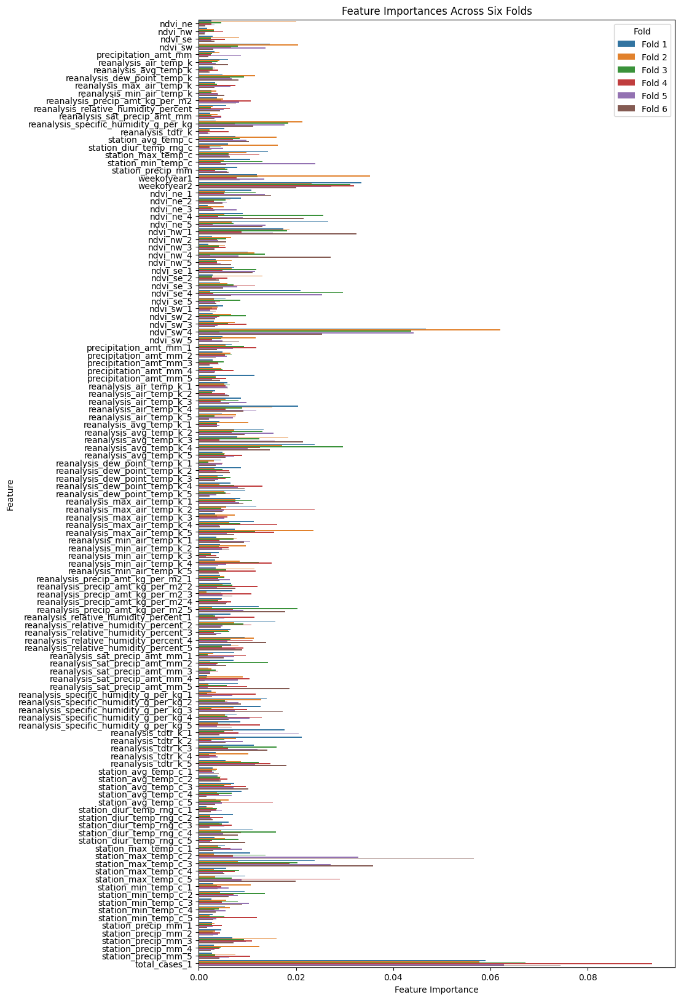

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


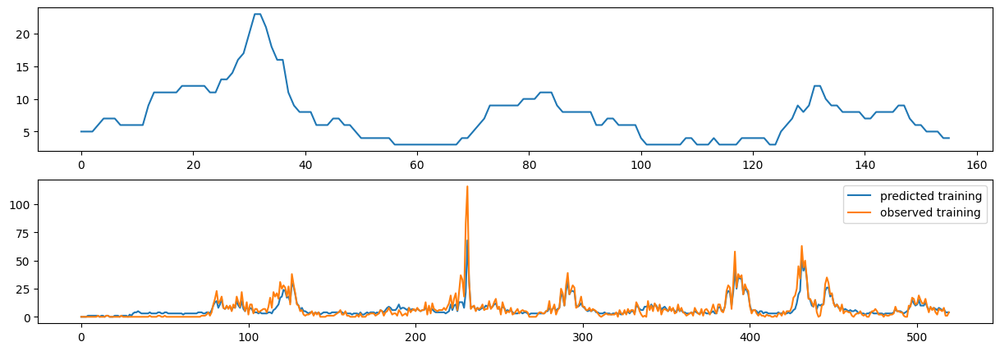

In [7]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_iq = []

label_lags=(1,)
# label_lags=None

feature_lags = (1,2,3,4,5)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features = {'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
#                    'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
#                    'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
#                    'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
#                    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=1.02
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index().reset_index(drop=True), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

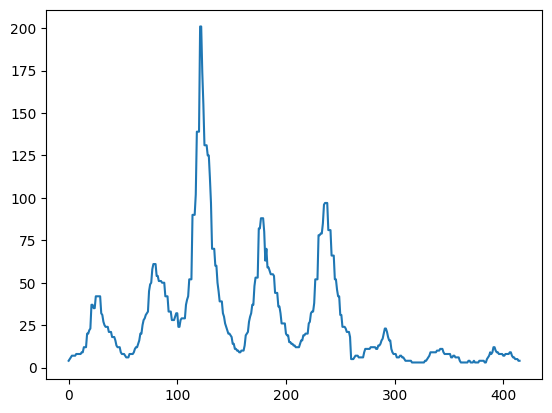

In [8]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_29.csv")

### Sub 30 - working from best case in sub 29


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

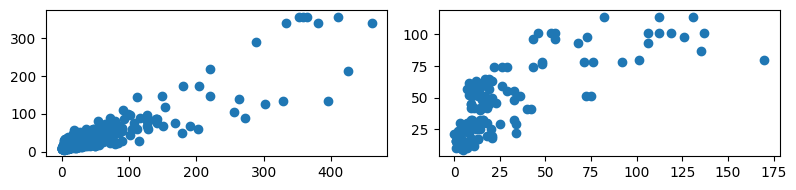

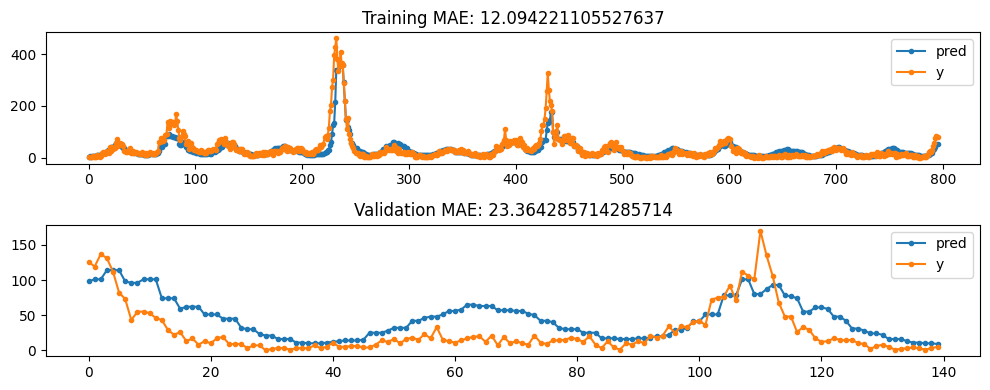

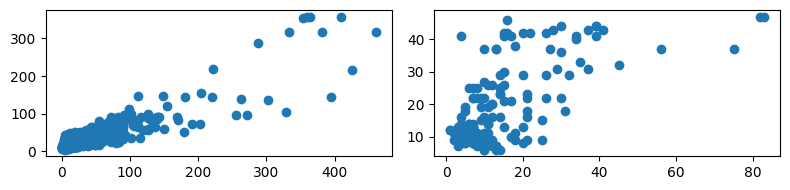

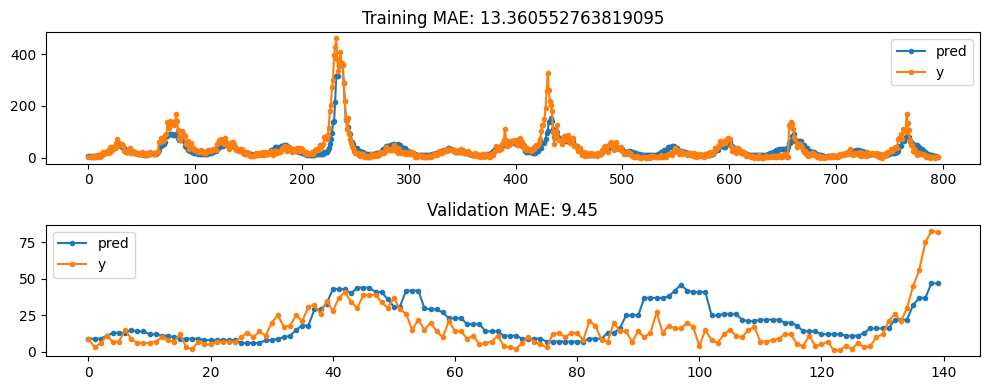

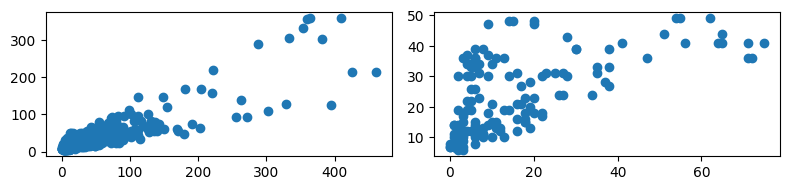

...

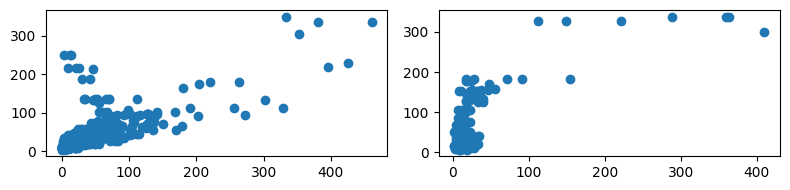

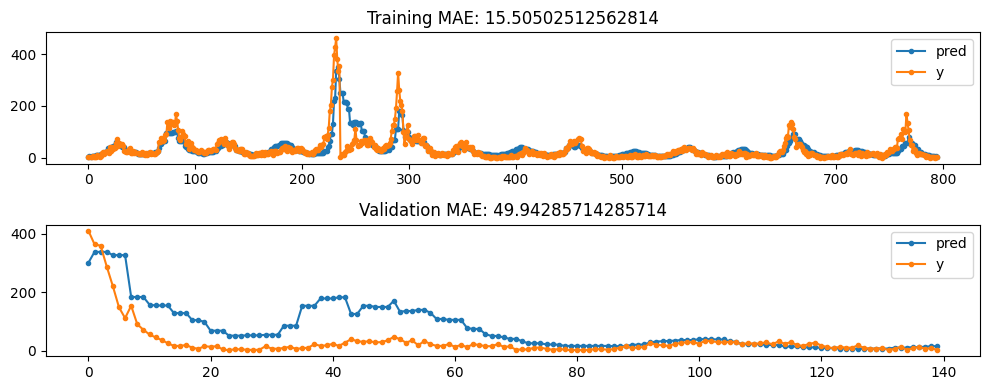

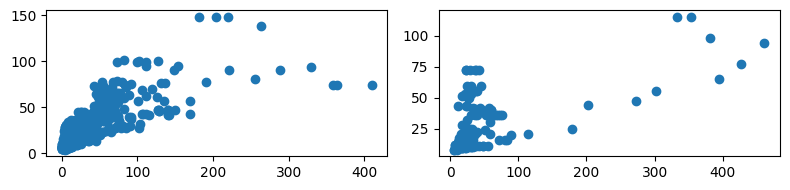

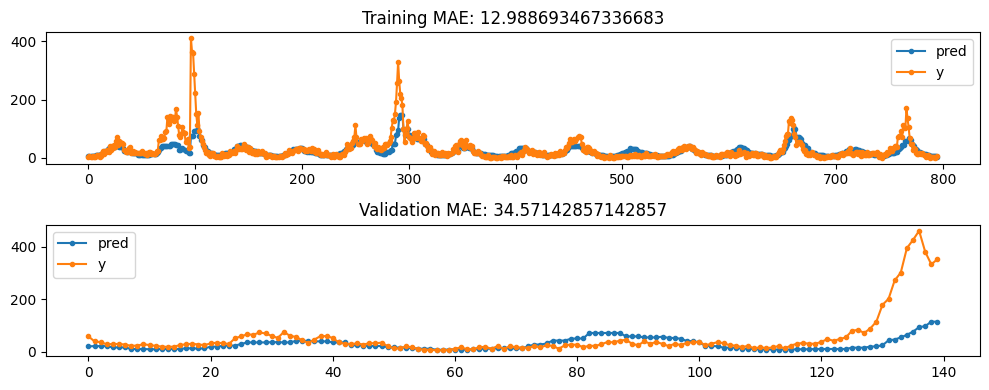

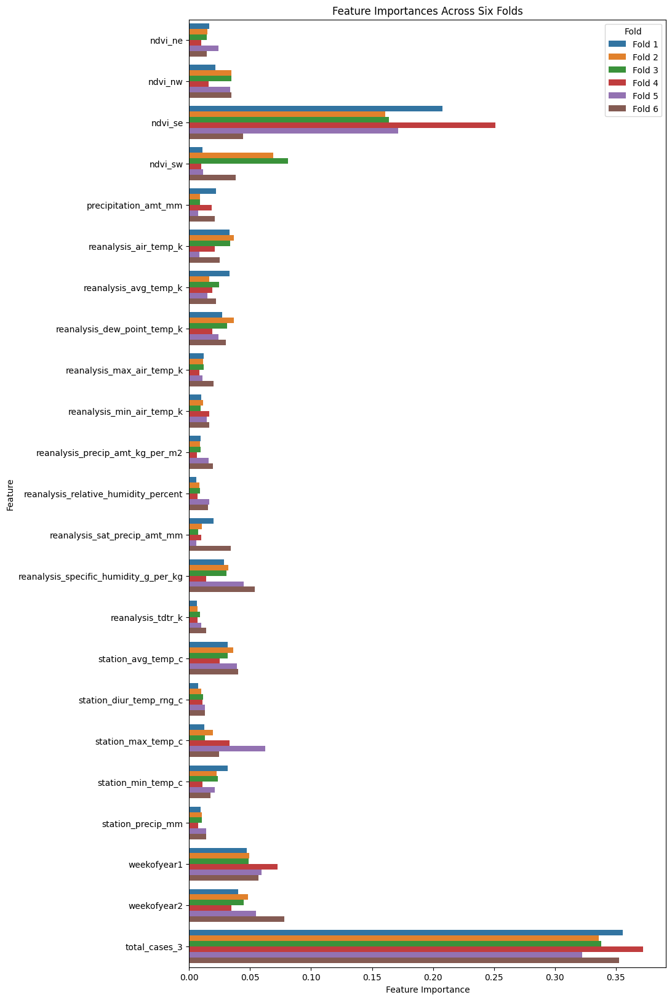

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


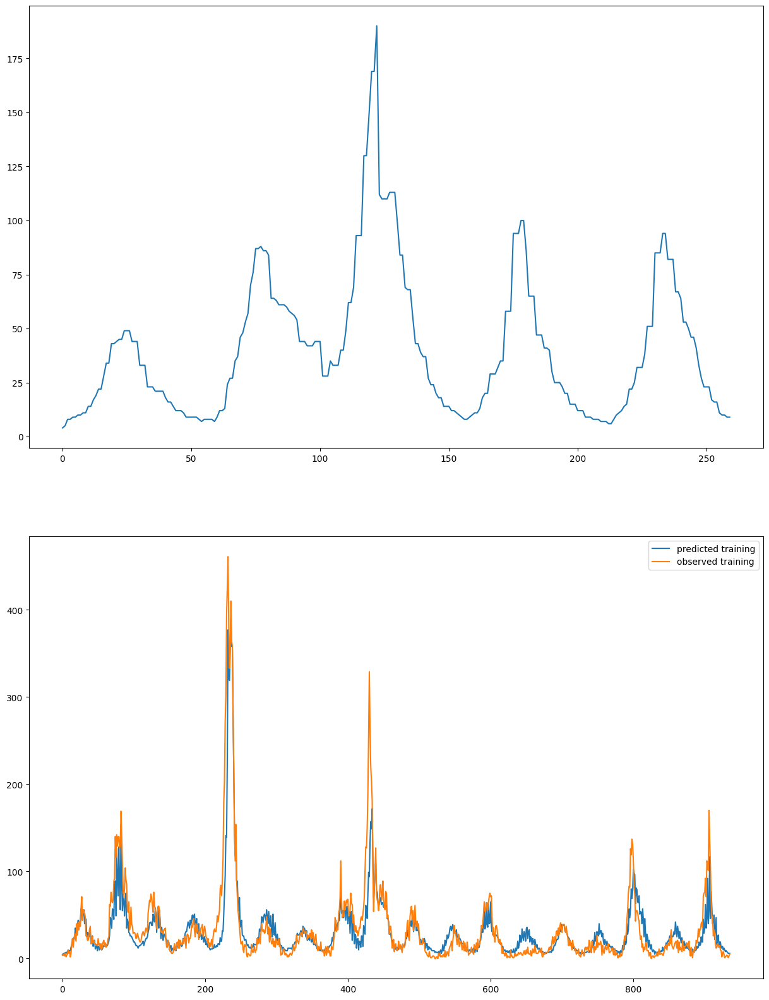

In [43]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []

label_lags=(3,)
# label_lags=None

# feature_lags = (1,2,3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']
feature_lags = ()
lagged_features = []


# feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
# lagged_features={
#     'ndvi_ne':[3],
#     'ndvi_nw':[3],
#     'ndvi_se':[1,2,3],
#     'ndvi_sw':[1,2,3],
#     'precipitation_amt_mm':[3],
#     'reanalysis_air_temp_k':[11,12,13,14,15,16,17],
#     'reanalysis_avg_temp_k':[3],
#     'reanalysis_dew_point_temp_k':[11,12,13,14,15,16,17],
#     'reanalysis_max_air_temp_k':[11,12,13,14,15,16,17],
#     'reanalysis_min_air_temp_k':[3],
#     'reanalysis_precip_amt_kg_per_m2':[3],
#     'reanalysis_relative_humidity_percent':[3],
#     'reanalysis_sat_precip_amt_mm':[3],
#     'reanalysis_specific_humidity_g_per_kg':[12,13,14,15,16,17],
#     'reanalysis_tdtr_k':[3],
#     'station_avg_temp_c':[3],
#     'station_diur_temp_rng_c':[3],
#     'station_max_temp_c':[3],
#     'station_min_temp_c':[9,10],
#     'station_precip_mm':[3]
# }

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=1.02
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100
    # feature_weights[-len(label_lags)] = 100
    # feature_weights[-1] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,20))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

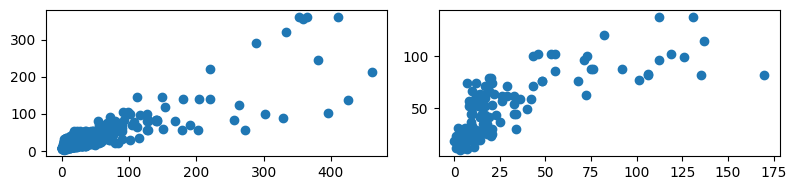

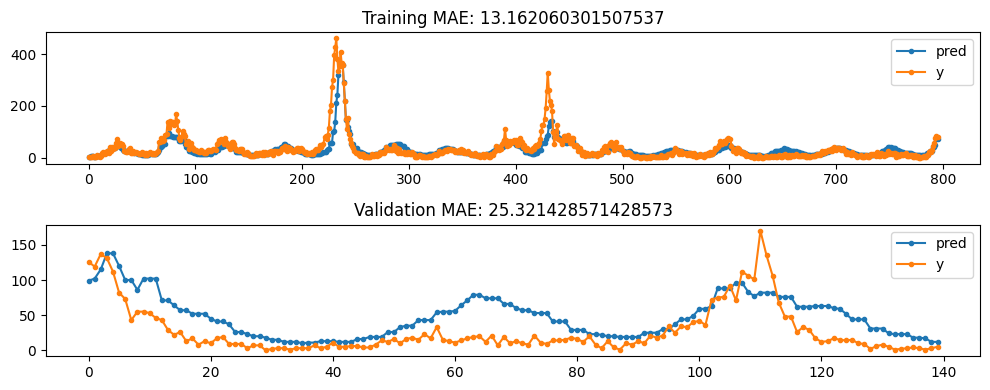

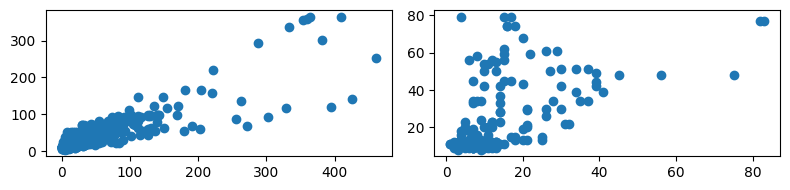

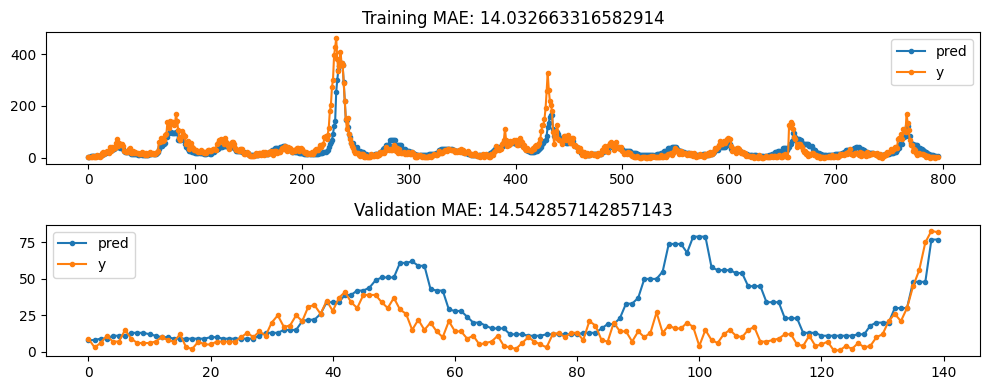

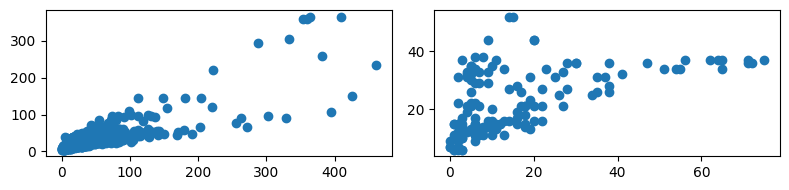

...

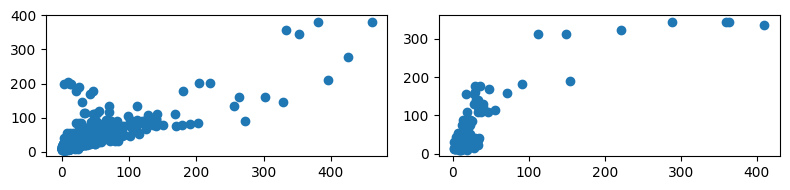

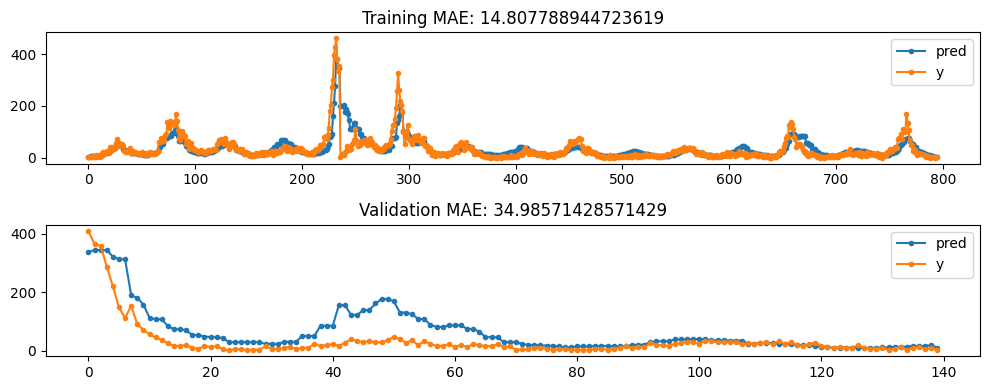

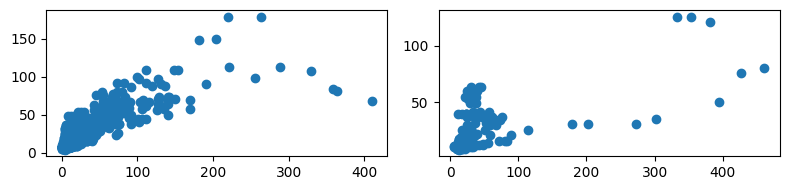

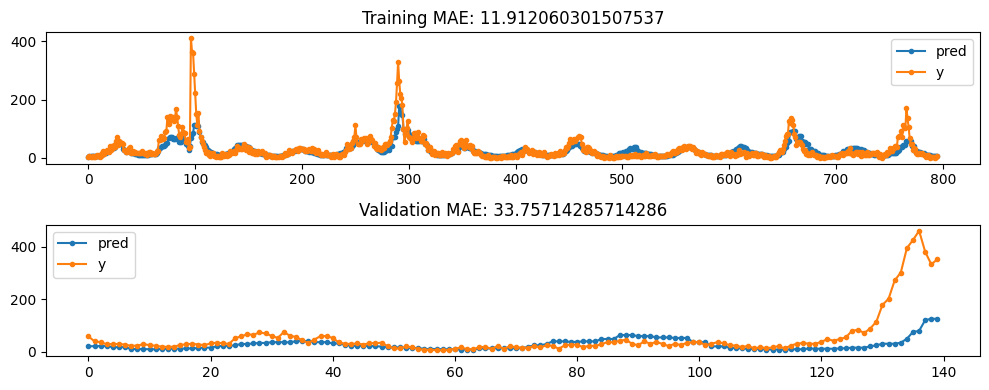

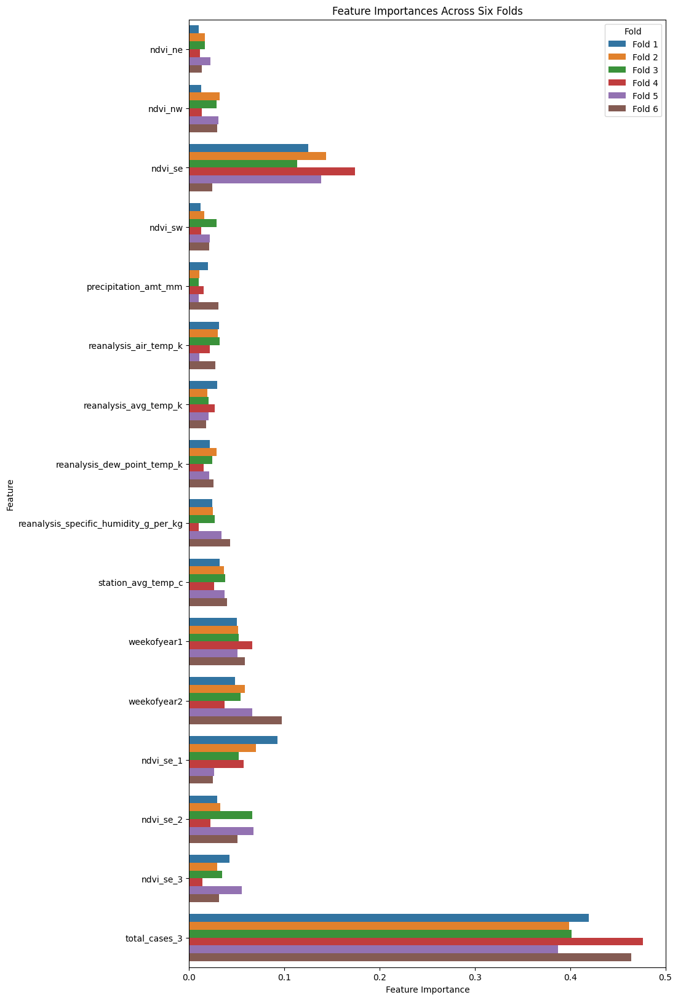

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


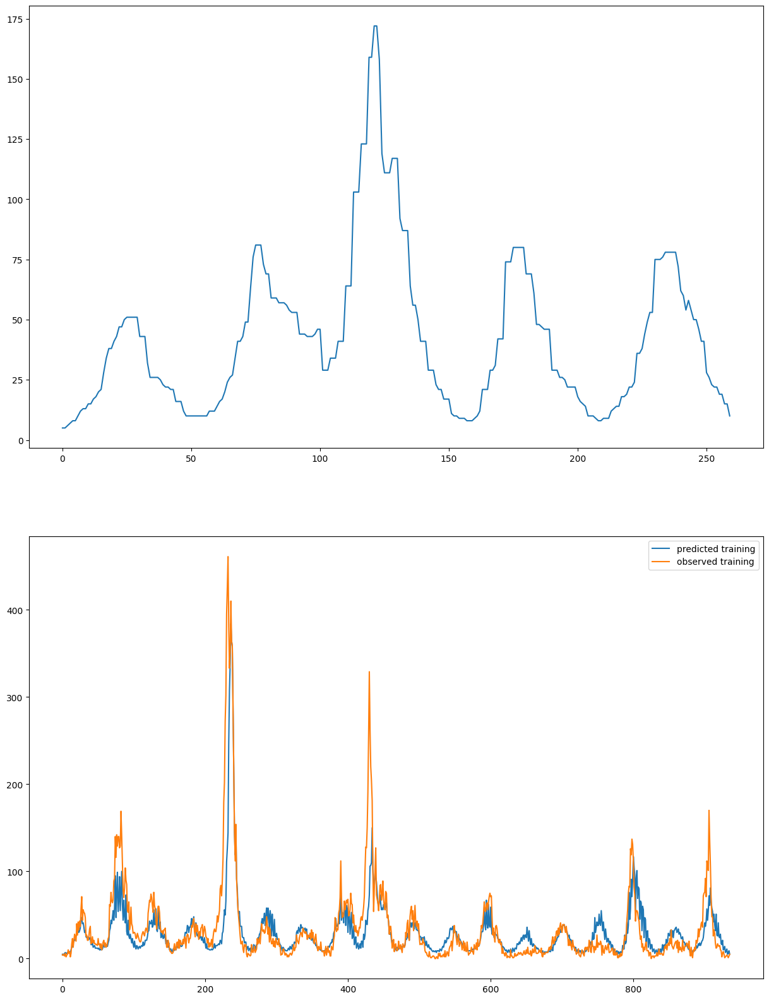

In [29]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_sj = []


feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
feature_names.remove('reanalysis_max_air_temp_k')
feature_names.remove('reanalysis_min_air_temp_k')
feature_names.remove('reanalysis_precip_amt_kg_per_m2')
feature_names.remove('reanalysis_relative_humidity_percent')
feature_names.remove('reanalysis_sat_precip_amt_mm')
feature_names.remove('reanalysis_tdtr_k')
feature_names.remove('station_diur_temp_rng_c')
feature_names.remove('station_max_temp_c')
feature_names.remove('station_min_temp_c')
feature_names.remove('station_precip_mm')



label_lags=(3,)
# label_lags=None

# feature_lags = (1,2,3,)
# lagged_features = [col for col in feature_names if col !='weekofyear']
# feature_lags = ()
# lagged_features = []


lagged_features={
#     'ndvi_ne':[3],
#     'ndvi_nw':[3],
    'ndvi_se':[1,2,3],
    # 'ndvi_sw':[1,2,3],
#     'precipitation_amt_mm':[3],
#     'reanalysis_air_temp_k':[11,12,13,14,15,16,17],
#     'reanalysis_avg_temp_k':[3],
    # 'reanalysis_dew_point_temp_k':[14,15,16,17],
    # 'reanalysis_max_air_temp_k':[11,12,13,14,15,16,17],
    # 'reanalysis_min_air_temp_k':[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18],
#     'reanalysis_precip_amt_kg_per_m2':[3],
#     'reanalysis_relative_humidity_percent':[3],
#     'reanalysis_sat_precip_amt_mm':[3],
#     'reanalysis_specific_humidity_g_per_kg':[12,13,14,15,16,17],
#     'reanalysis_tdtr_k':[3],
    # 'station_avg_temp_c':[7,8,9],
#     'station_diur_temp_rng_c':[3],
#     'station_max_temp_c':[3],
#     'station_min_temp_c':[9,10],
#     'station_precip_mm':[3]
}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=500
max_depth=5
objective='reg:squarederror'
min_child_weight=1.02
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100
    # feature_weights[-len(label_lags)] = 100
    # feature_weights[-1] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,20))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

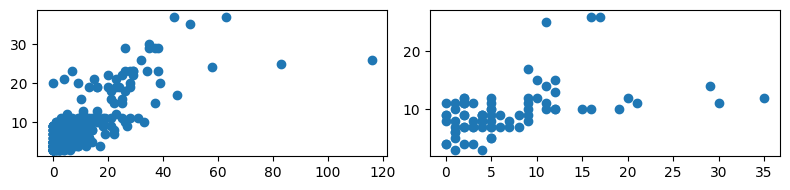

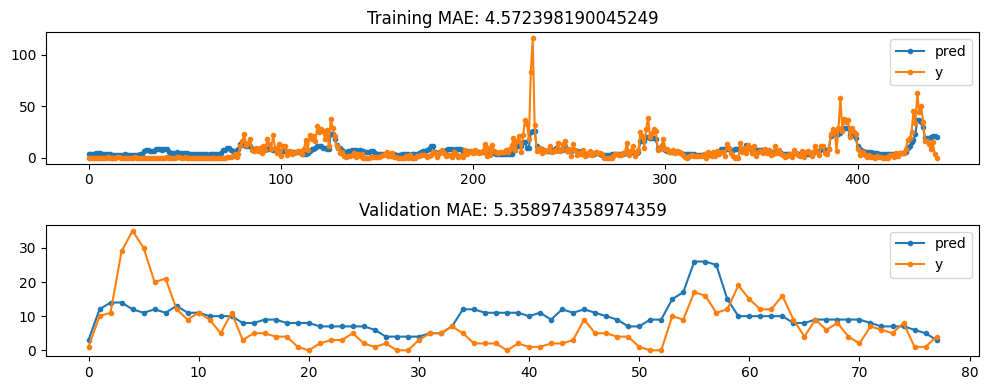

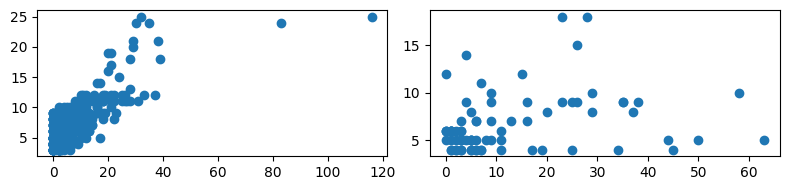

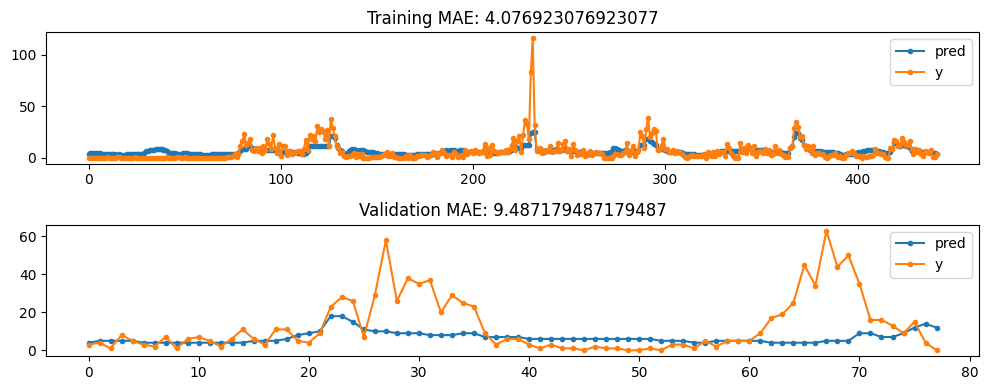

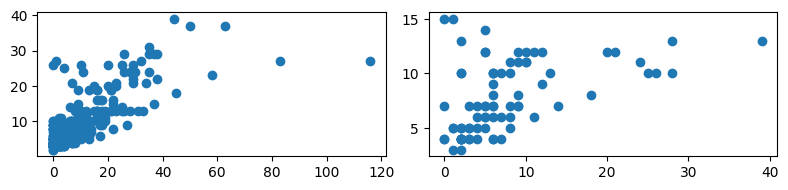

...

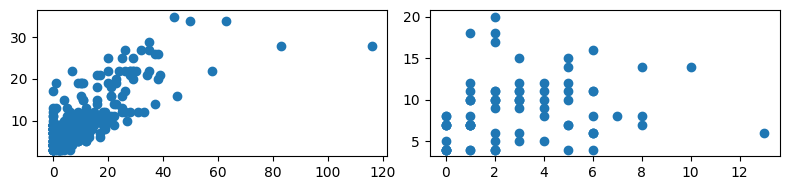

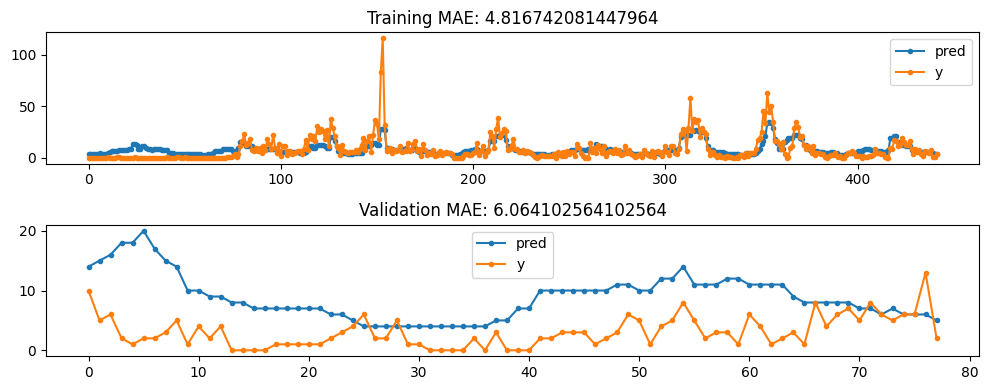

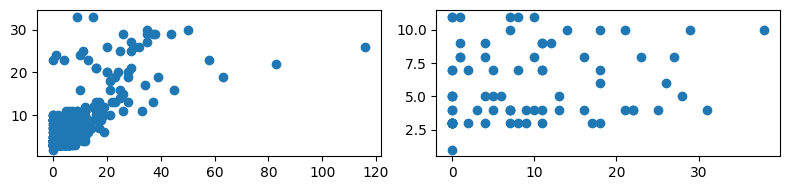

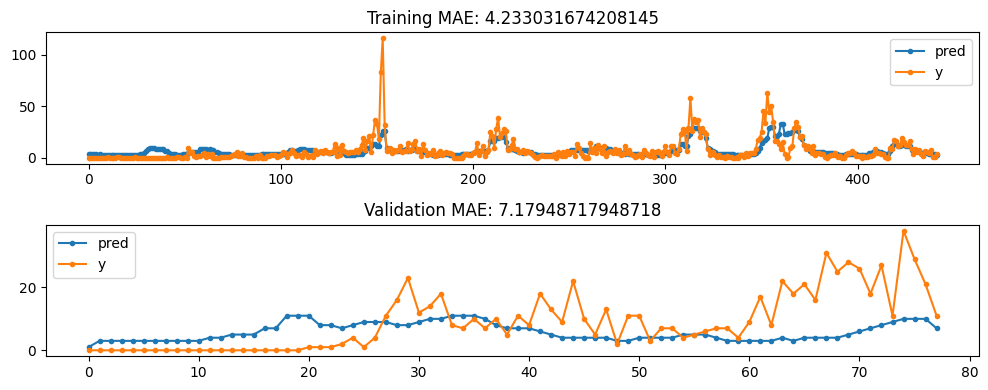

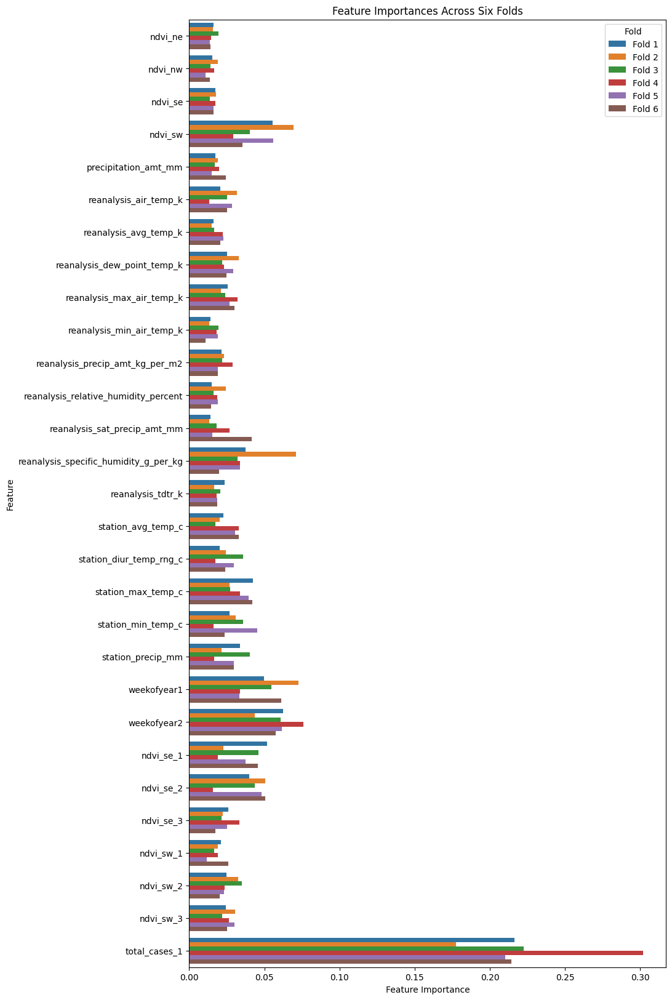

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


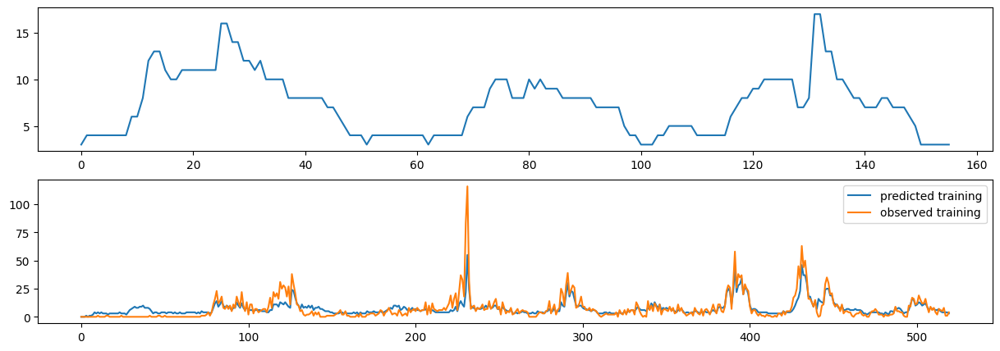

In [39]:
# Refine here
# Specify modelling parameters

folds = 6
fold_size = 0.15
xg_reg_iq = []


feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]


label_lags=(1,)
# label_lags=None

# feature_lags = (1,2,3,4,5)
# lagged_features = [col for col in feature_names if col !='weekofyear']

feature_lags = ()
lagged_features = []


lagged_features = {
    # 'station_min_temp_c':[1,2,3,4,5,6,7,8,9,10,11,12],
    # 'station_avg_temp_c':[4,5,6,7,8,9,10,11,12],
    # 'reanalysis_specific_humidity_g_per_kg':[5,6,7,8,9,10],
    # 'reanalysis_dew_point_temp_k':[5,6,7,8,9,10],
    'ndvi_se':[1,2,3], 'ndvi_sw':[1,2,3],
    # 'ndvi_ne':[1,2,3], 'ndvi_nw':[1,2,3]
}

# eta=0.01
# n_estimators=500
# max_depth=5
# objective='reg:squarederror'
# min_child_weight=1.02
# gamma=0.51
# subsample=0.86
# colsample_bytree=0.84
# scale_pos_weight=1
# seed=42
# reg_alpha=1
# reg_lambda=1

eta=0.01
n_estimators=800
max_depth=5
objective='reg:squarederror'
min_child_weight=1.02
gamma=0.51
subsample=0.86
colsample_bytree=0.84
scale_pos_weight=1
seed=42
reg_alpha=1
reg_lambda=1


# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

    

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=eta,n_estimators=n_estimators,max_depth=max_depth,
                                     objective=objective,
                                     min_child_weight=min_child_weight, gamma=gamma,
                                     subsample=subsample,colsample_bytree=colsample_bytree,
                                     scale_pos_weight=scale_pos_weight,seed=seed,
                                     reg_alpha=reg_alpha,reg_lambda=reg_lambda)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred)
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index().reset_index(drop=True), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

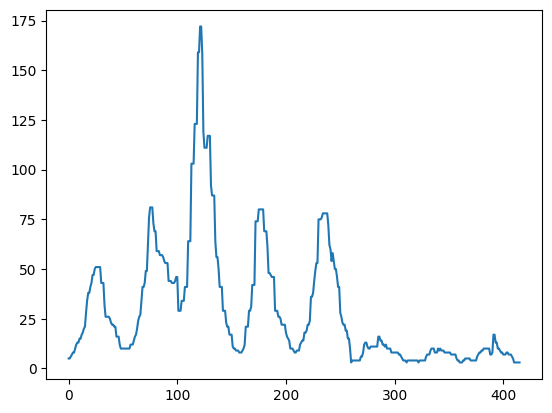

In [40]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_30.csv")

### Sub 31: close to sub14, as new starting point

Closest we could get. to get exact, need xgboost 2.0.3, old circular weekofyear approach, and lagged label weights the same as all other feature weights.

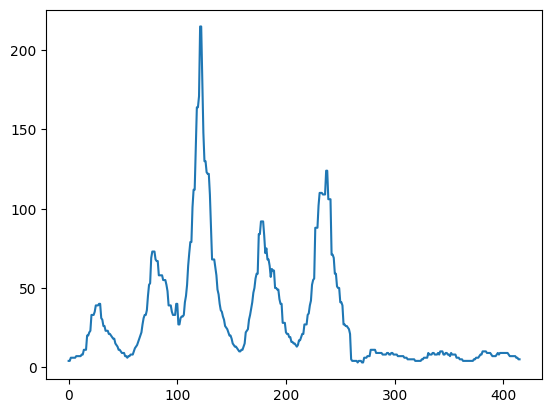

In [50]:
best_case = pd.read_csv('/home/tfc/Documents/data_driven/dengue/submission_14.csv')
plt.plot(best_case['total_cases'])


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

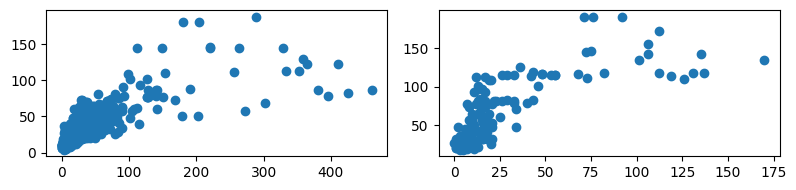

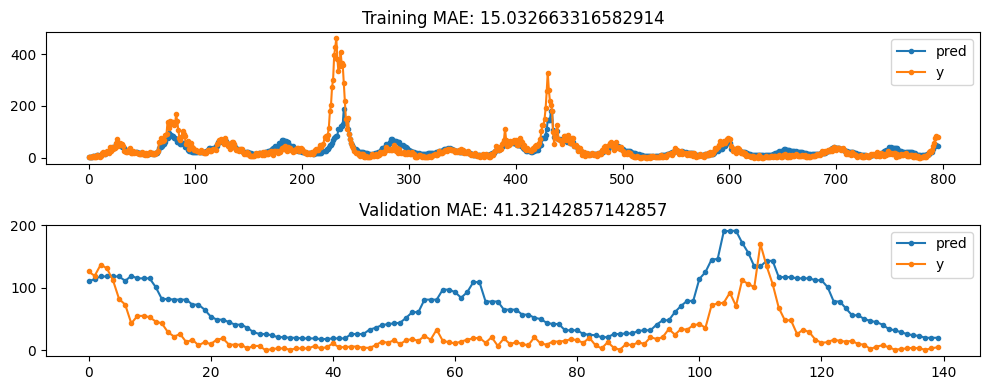

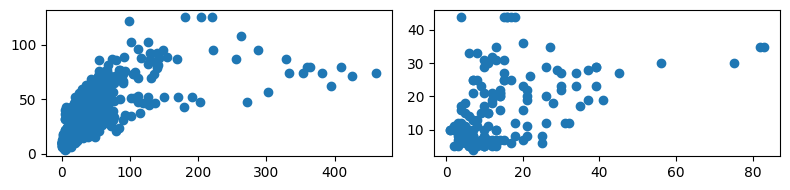

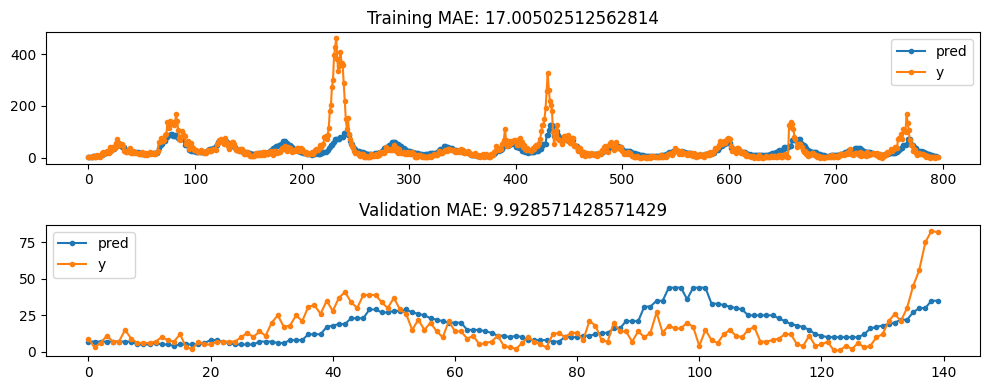

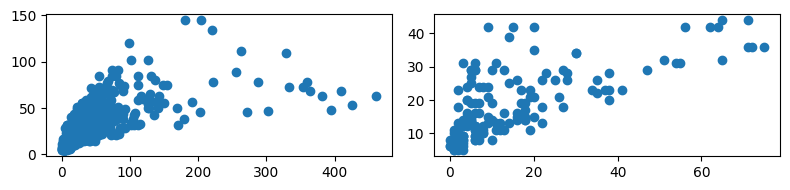

...

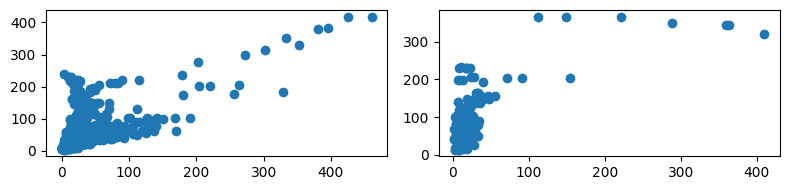

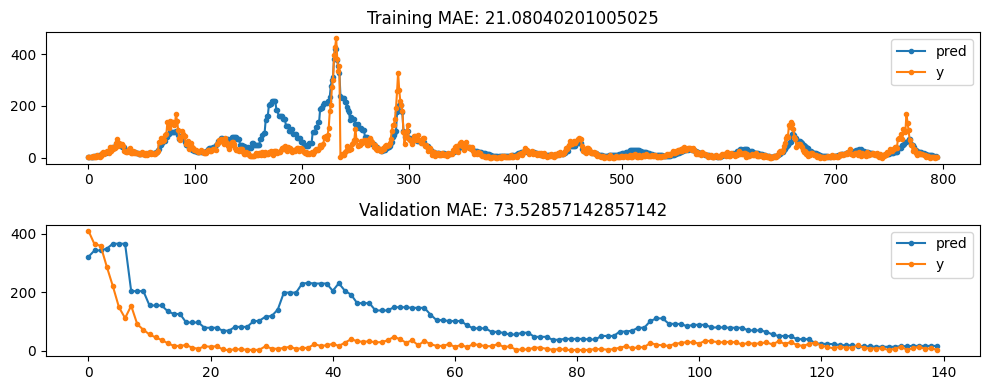

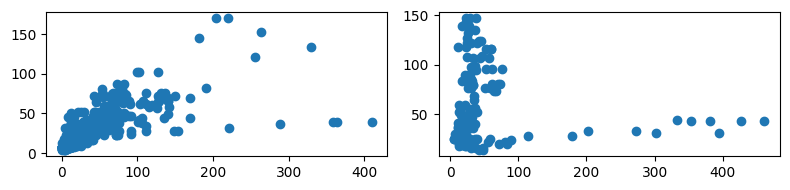

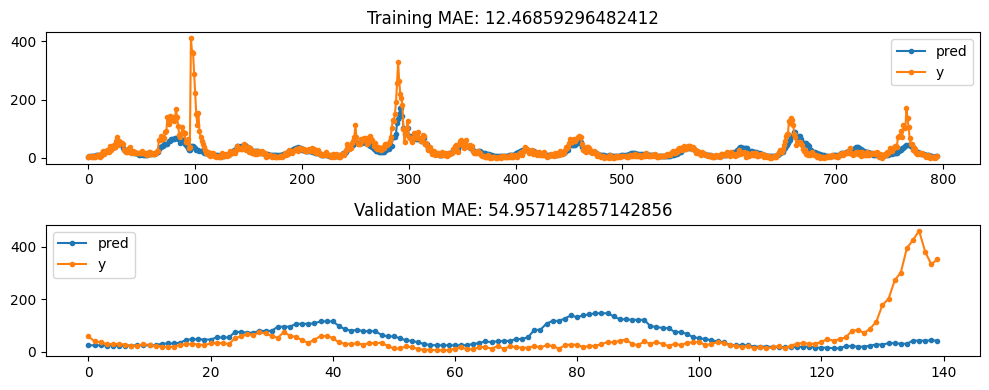

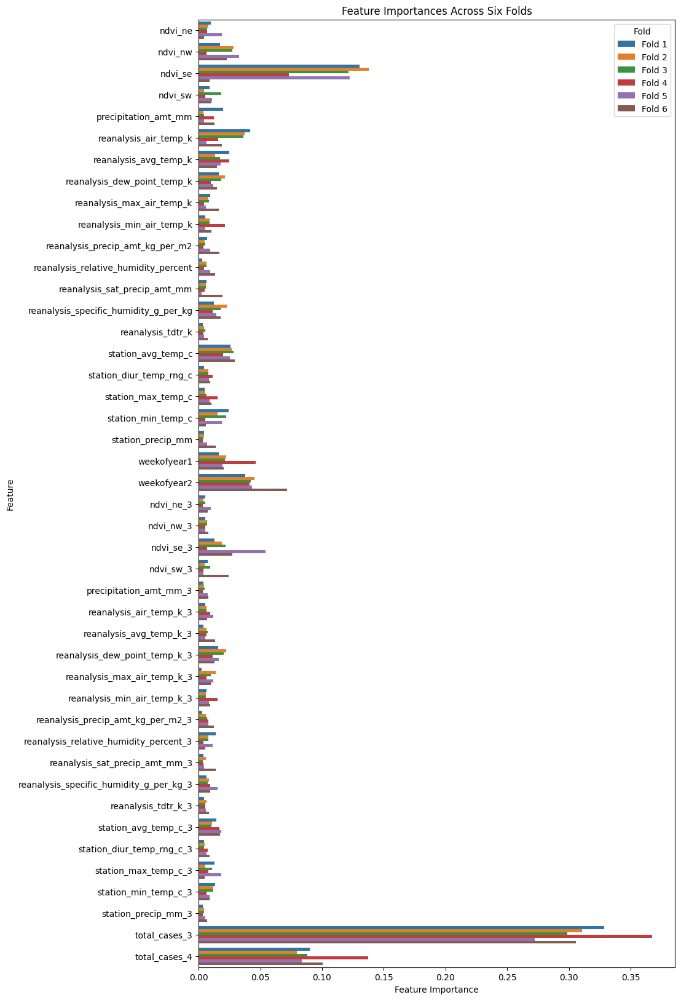

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


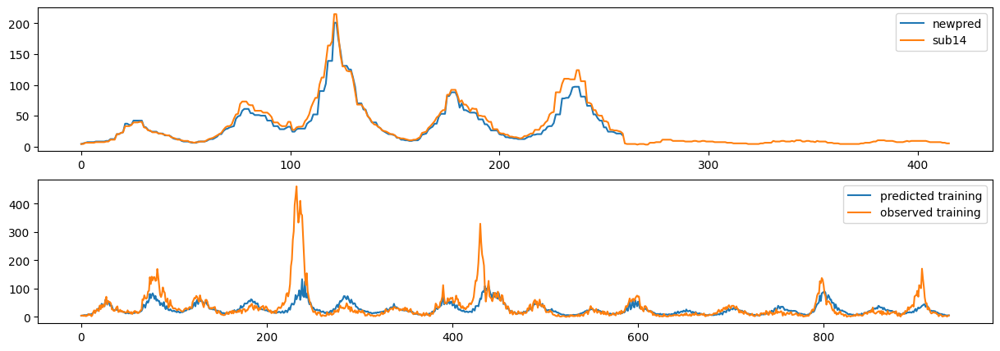

In [51]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
feature_lags = (3,)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

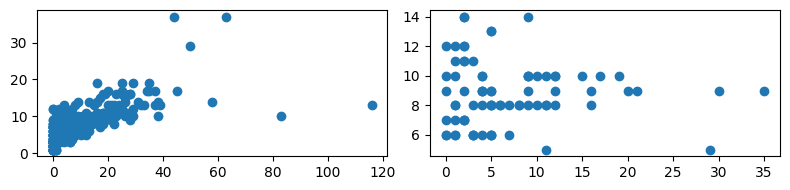

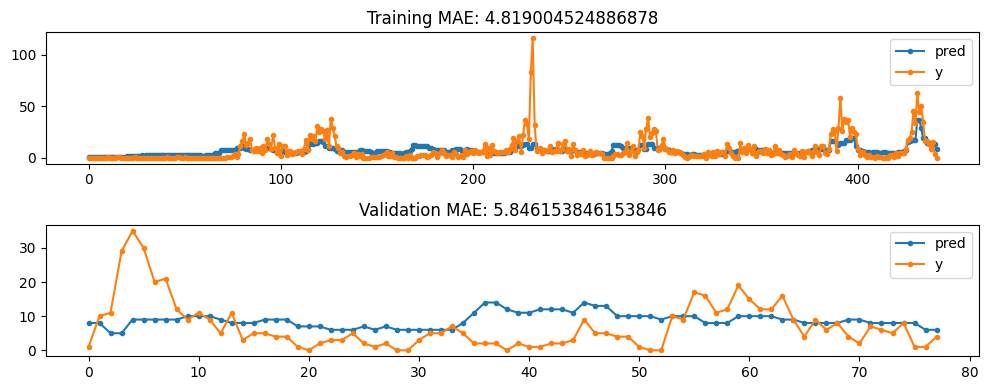

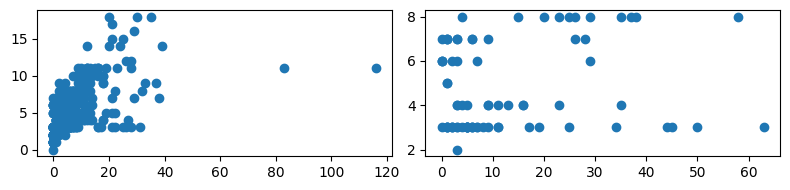

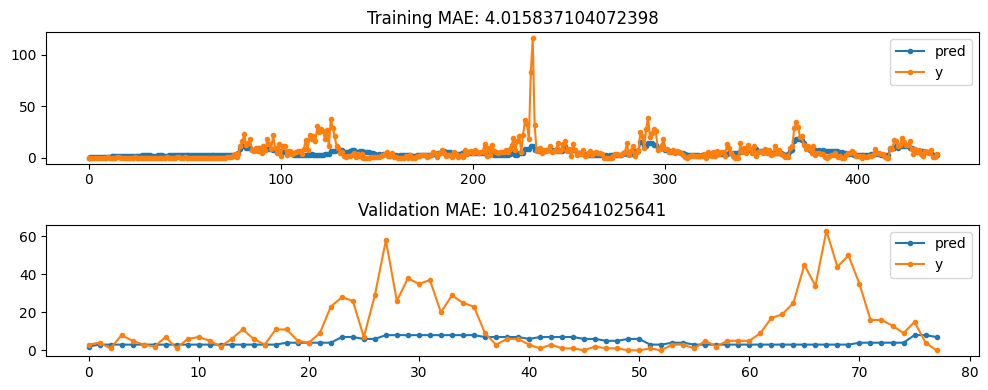

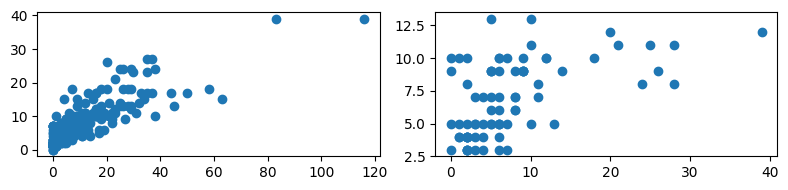

...

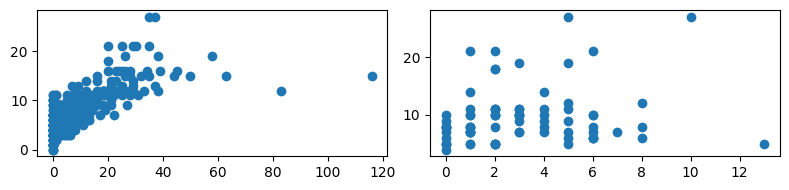

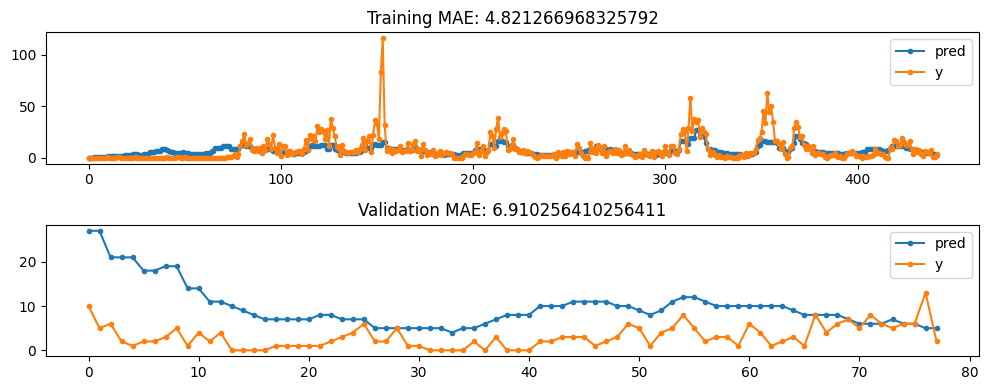

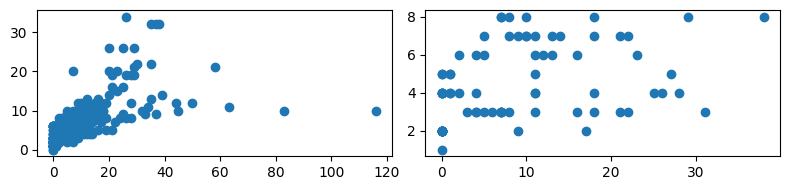

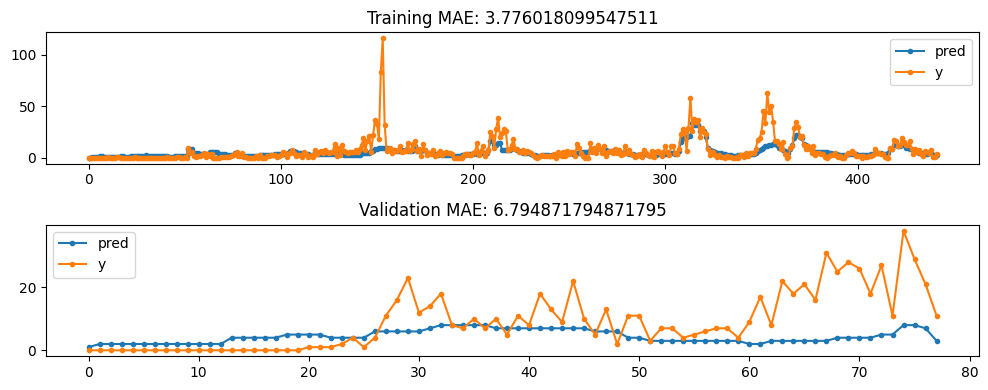

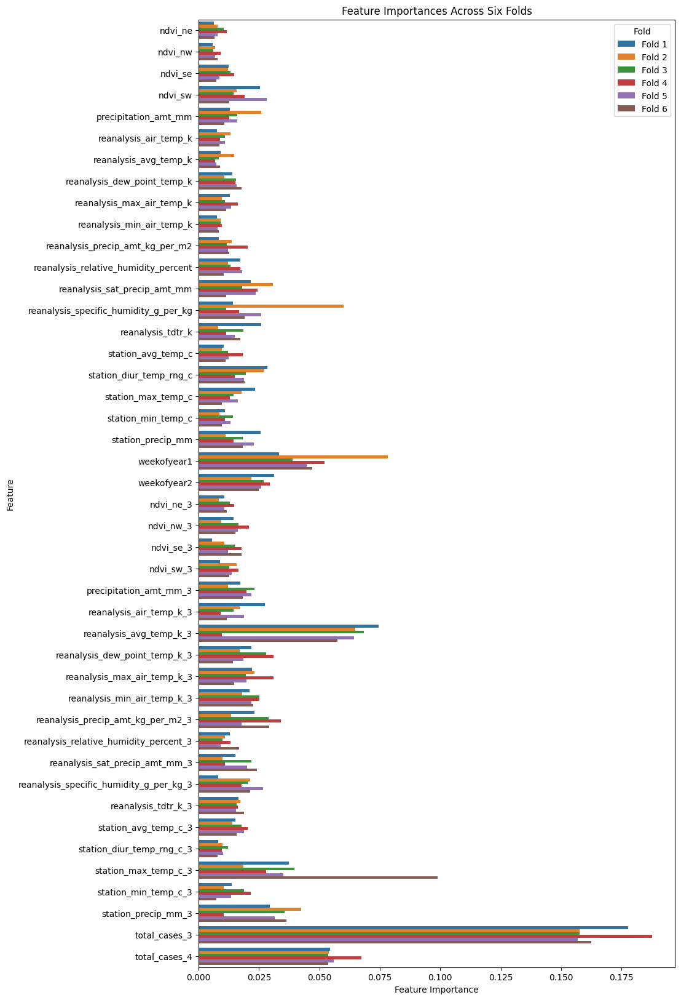

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


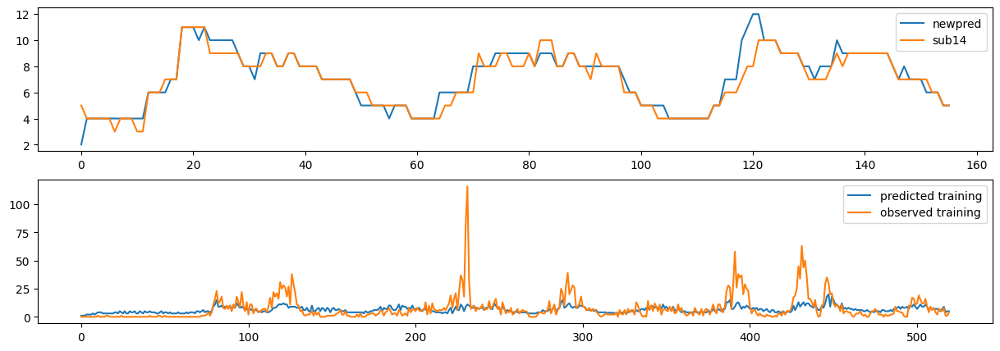

In [52]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
feature_lags = (3,)
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred,label='newpred')
axs[0].plot(best_case[best_case['city']=='iq']['total_cases'].reset_index(drop=True),label='sub14')
axs[0].legend()
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

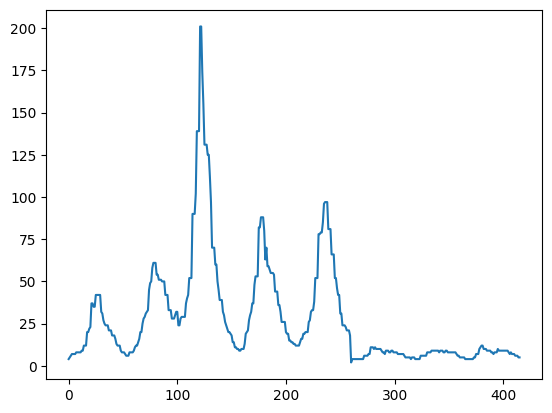

In [53]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_31.csv")

### Sub 32 - relative to sub31, improving on SJ, IQ untouched, lagged label weight 50


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

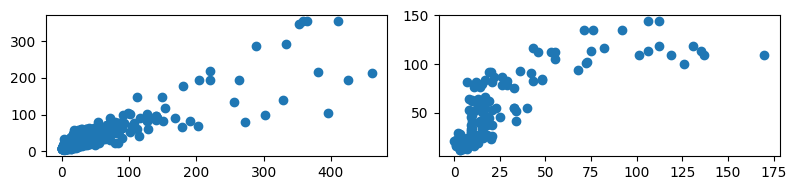

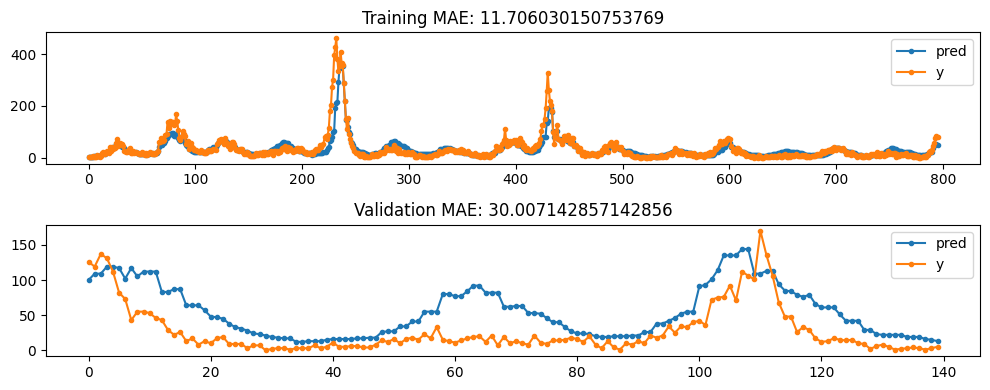

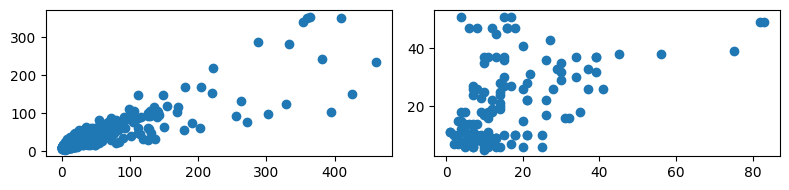

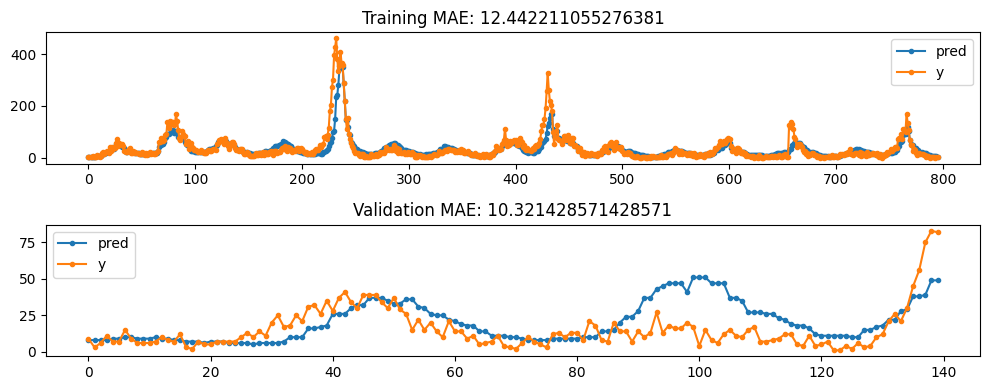

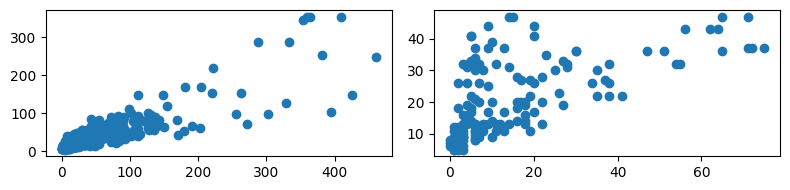

...

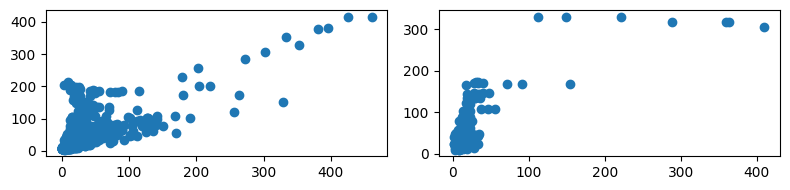

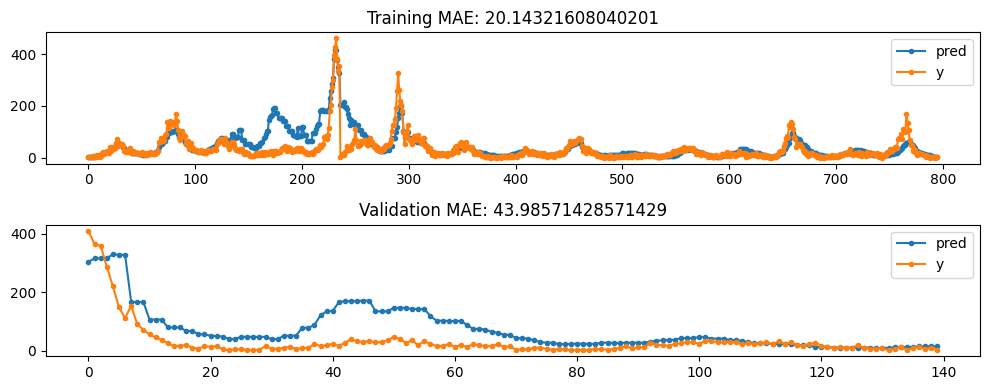

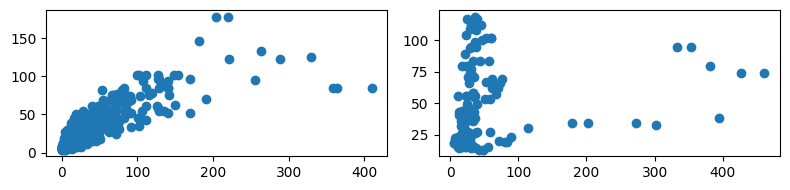

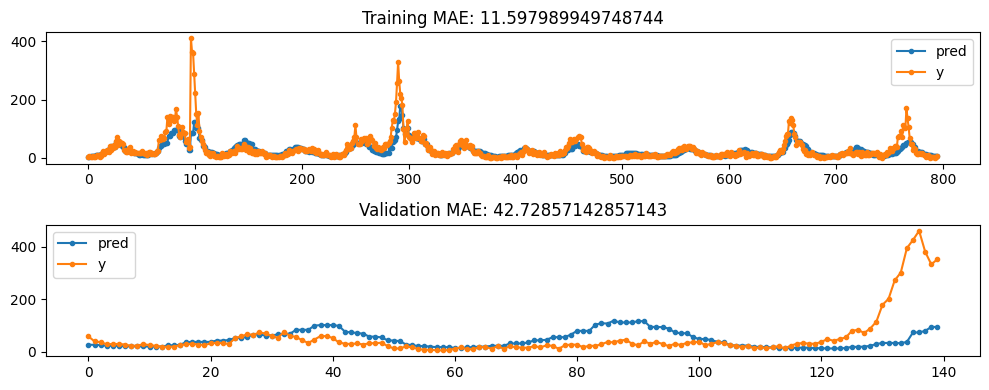

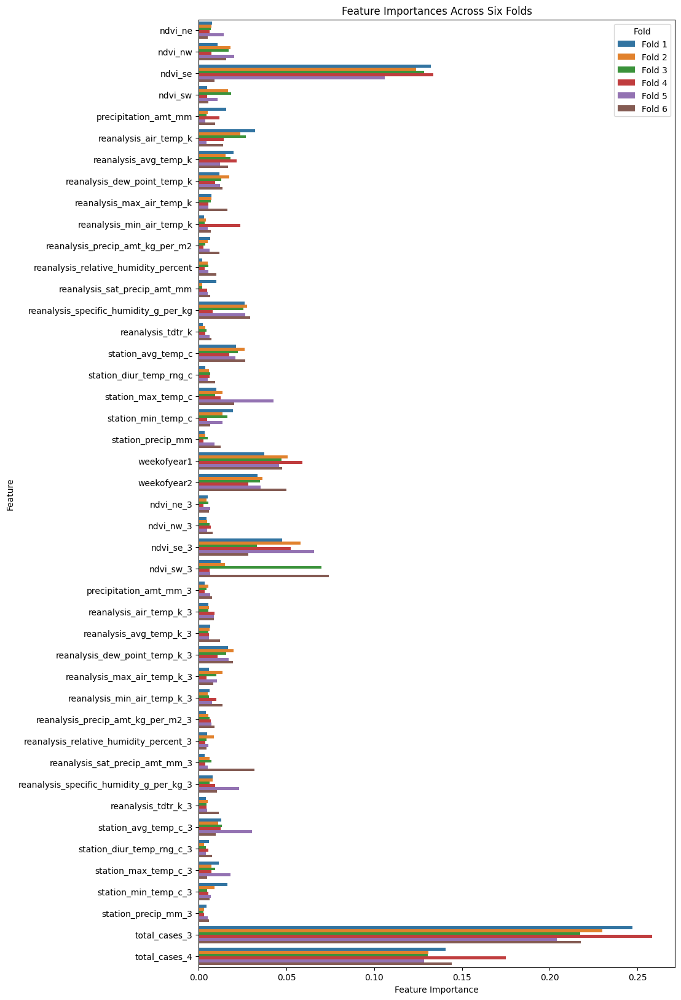

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


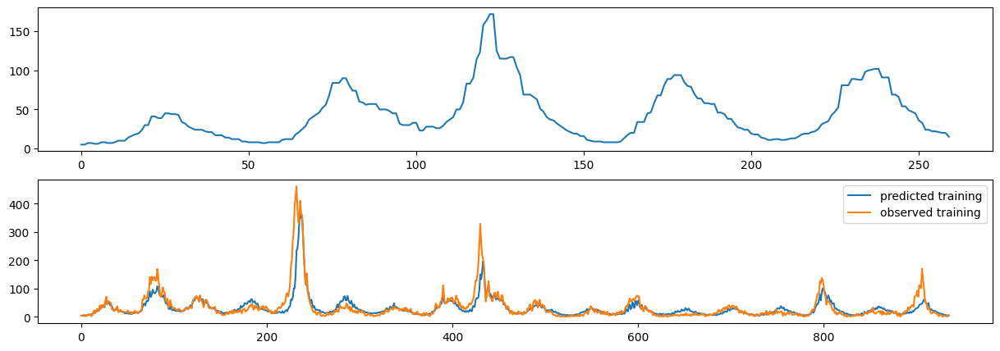

In [54]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
feature_lags = (3,)
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 50

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred)
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

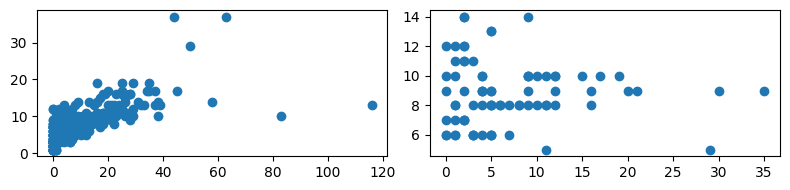

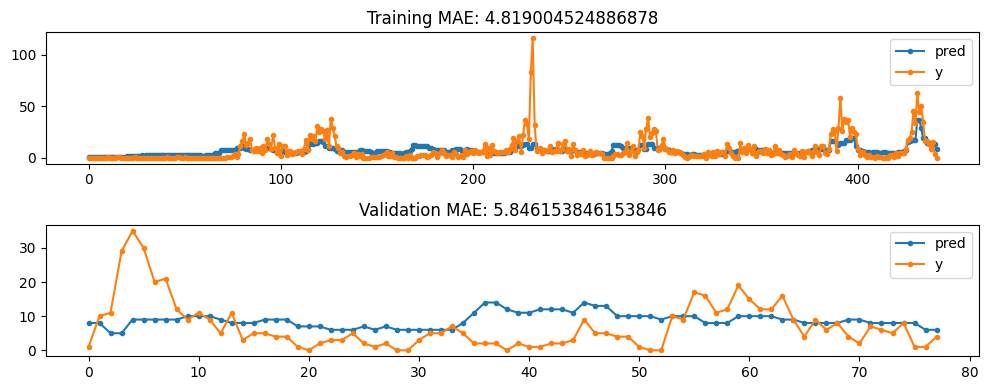

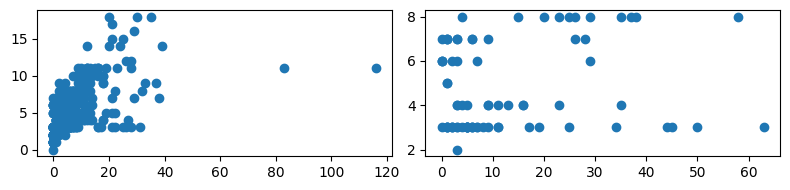

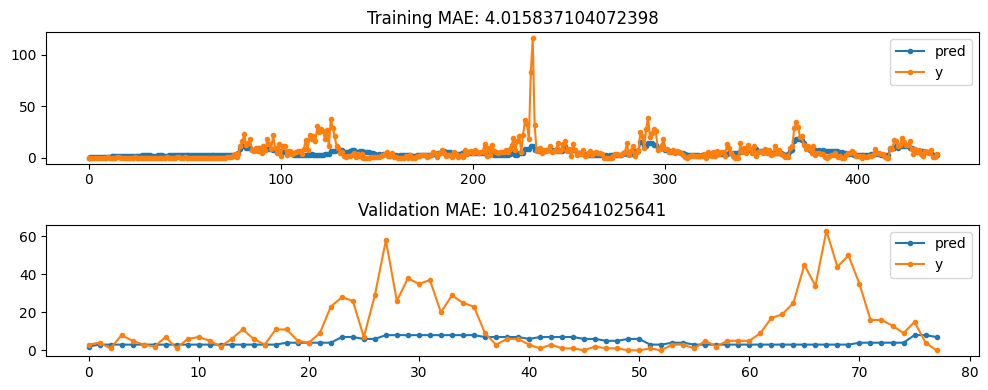

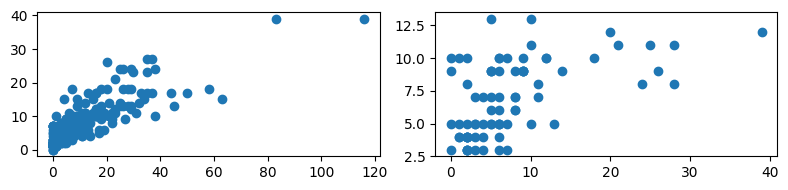

...

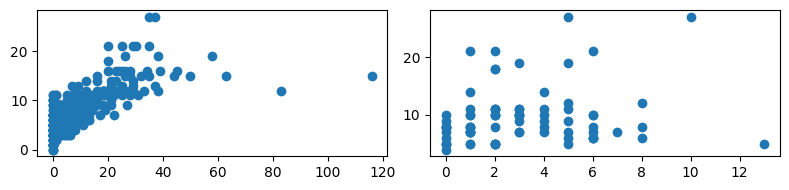

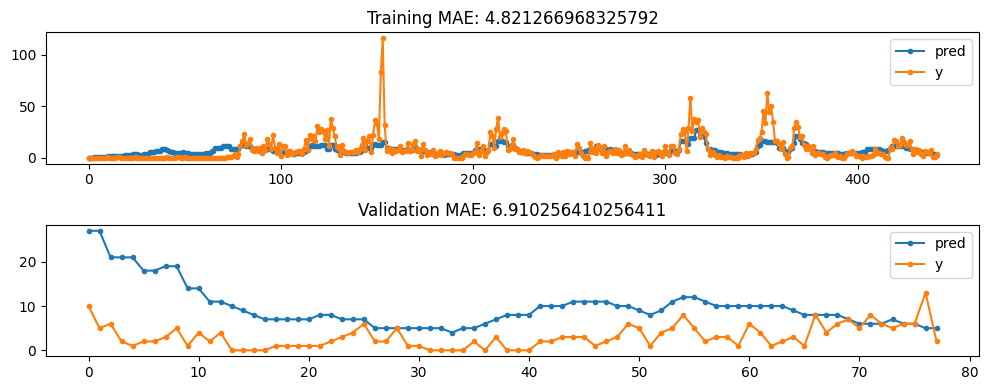

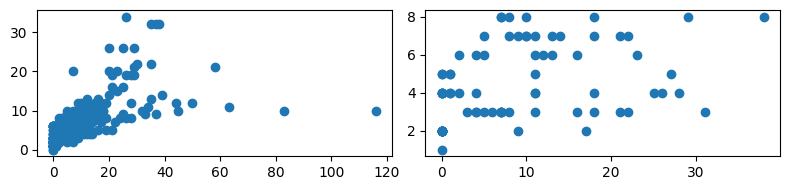

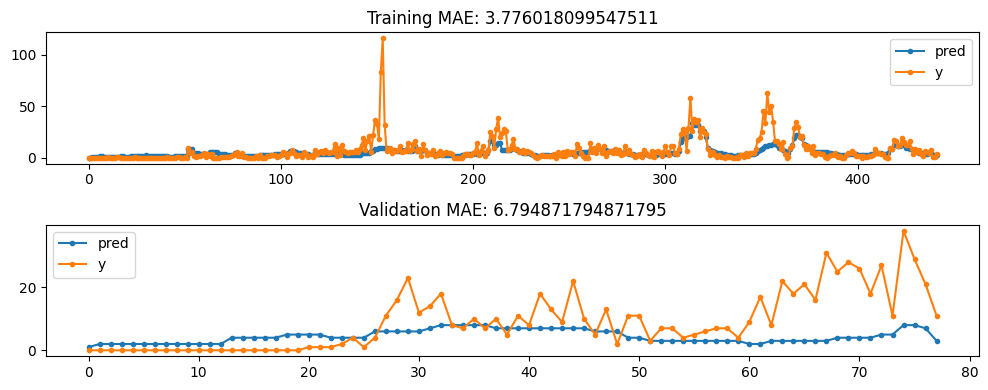

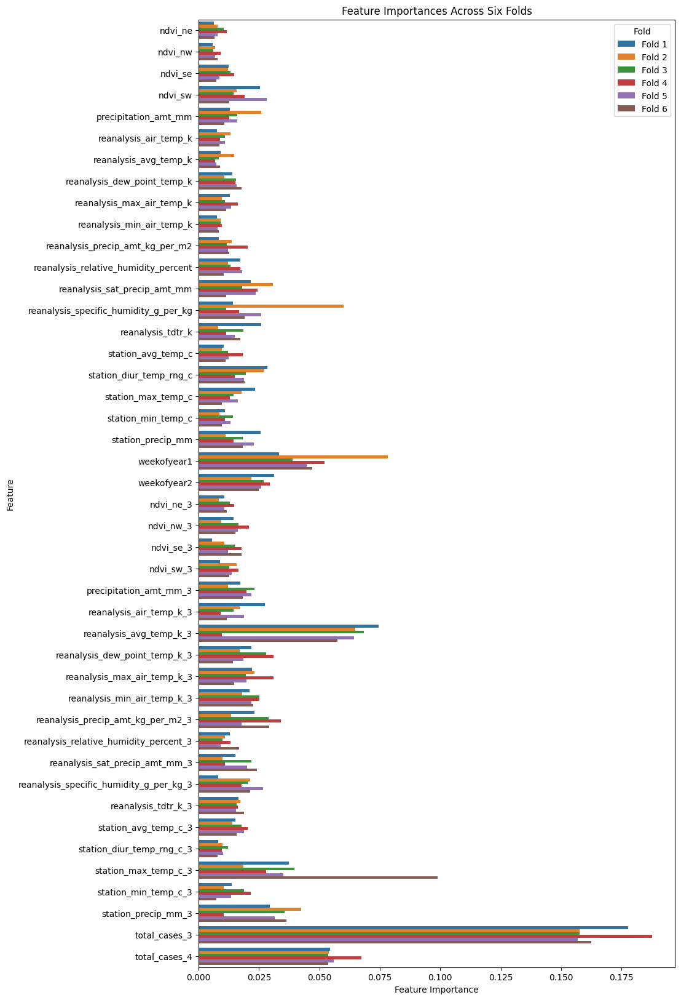

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


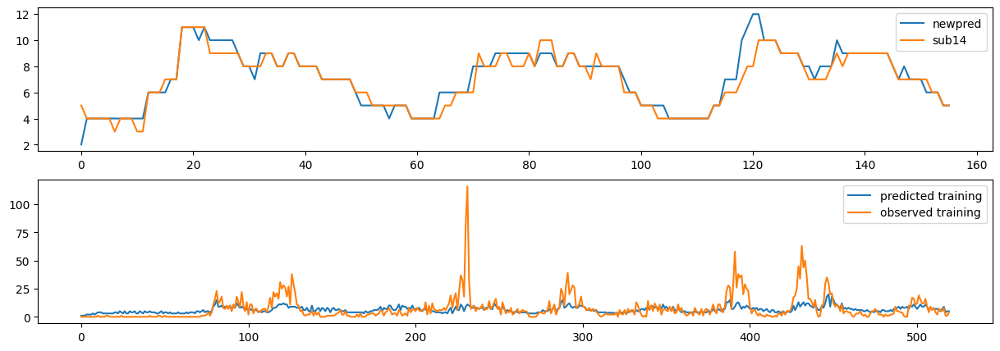

In [55]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
feature_lags = (3,)
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred,label='newpred')
axs[0].plot(best_case[best_case['city']=='iq']['total_cases'].reset_index(drop=True),label='sub14')
axs[0].legend()
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

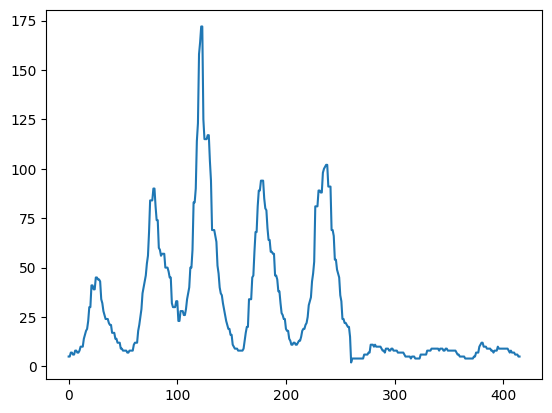

In [56]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_32.csv")

### Sub 33 - relative to sub31, improving on SJ, IQ untouched, weekofyear_shift=10, feature lags for ndvi at 1,2,3, the rest at 3

In [51]:
from scipy.signal import medfilt

def preprocess(df_features_or: pd.DataFrame,
               labels=None,
               features_to_keep: Optional[Iterable[str]] = None,
               lagged_features: Optional[Union[Iterable[str],Dict[str, Iterable[str]]]] = None,
               fillna: Optional[str] = None,
               circular_weekofyear: bool = False,
               feature_lags=None,
               label_lags=None, weekofyear_shift = 0):
    '''
    Add lagged features or target values as needed, accounting for existence of two cities in dataset.
    fillna: Fill NaN approach, e.g. 'ffill'. None to not fill.
    '''

    df_features = df_features_or.copy()
    df_features = df_features.reset_index()

    if features_to_keep is not None:         # Filter features
        feature_names = features_to_keep + ['city']
        df_features = df_features[feature_names]
    else:
        feature_names = list(df_features.columns)

    if fillna is not None:                   # Fill NaNs
        df_features.fillna(method=fillna, inplace=True)

    # Convert city feature to categorical and one hot encode
    df_features["city"] = df_features["city"].astype("category")
    df_features = pd.get_dummies(df_features, columns=['city'], drop_first=True)

    # Create circular week of year. #TEMP: update again
    if circular_weekofyear:
        
        # df_features['weekofyear1'] = np.sin((df_features['weekofyear']-1)/51*2*np.pi) # Method 2
        # df_features['weekofyear2'] = np.cos((df_features['weekofyear']-1)/51*2*np.pi)
        # df_features.drop(columns=['weekofyear'],inplace=True)

        # df_features['weekofyear'] = np.sin((df_features['weekofyear']-1)/51*np.pi)    # Method 1
        df_features['weekofyear'] = -np.sin((df_features['weekofyear']-1-weekofyear_shift)/51*2*np.pi)   # Method 3
        
    # Split cities before adding lags
    sj_features = df_features[df_features['city_sj']]
    iq_features = df_features[~df_features['city_sj']]

    if labels is not None:
        sj_labels = labels[df_features['city_sj']]
        iq_labels = labels[~df_features['city_sj']]
    else:
        sj_labels = None        
        iq_labels = None

    # Add smoothing to features
    features_no_woy_city = [col for col in sj_features.columns if not (col in ['weekofyear','city_sj'])]
    sj_features[features_no_woy_city] = sj_features[features_no_woy_city].apply(lambda col: medfilt(col, kernel_size=3))
    iq_features[features_no_woy_city] = iq_features[features_no_woy_city].apply(lambda col: medfilt(col, kernel_size=3))

    # Lagged feature/labels creation
    if (lagged_features is not None) or (label_lags is not None):
        # Add lagged features
        if isinstance(lagged_features,dict):                # Do individual lags for different features
            for feat, feat_lags in lagged_features.items():
                sj_features_lagged = sj_features[feat].shift(periods=feat_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feat_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)
        elif isinstance(lagged_features, (list, tuple)):    # All considered features has same lags
            for feat in lagged_features:
                if 'total_cases' in feat:                   # Skip all total_cases features, used when preprocessing pred features
                    continue
                sj_features_lagged = sj_features[feat].shift(periods=feature_lags)
                sj_features = pd.concat([sj_features,sj_features_lagged],axis=1)
                iq_features_lagged = iq_features[feat].shift(periods=feature_lags)
                iq_features = pd.concat([iq_features,iq_features_lagged],axis=1)

        # Add lagged labels
        if label_lags is not None:
            sj_lagged_labels = sj_labels.shift(periods=label_lags)
            sj_features = pd.concat([sj_features,sj_lagged_labels],axis=1)
            iq_lagged_labels = iq_labels.shift(periods=label_lags)
            iq_features = pd.concat([iq_features,iq_lagged_labels],axis=1)
  
    return sj_features, iq_features, sj_labels, iq_labels



 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

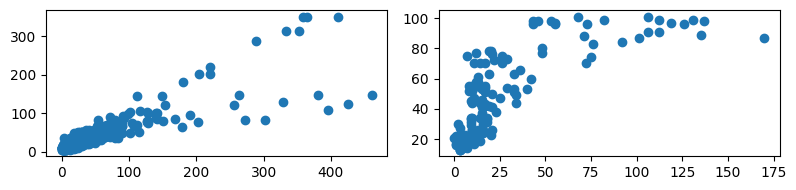

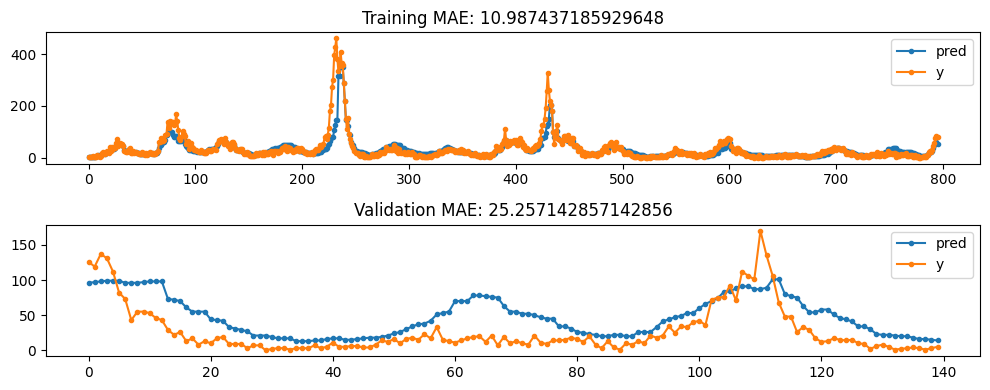

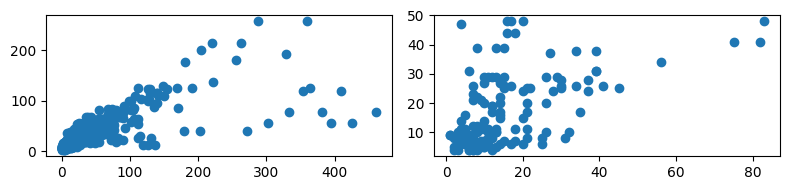

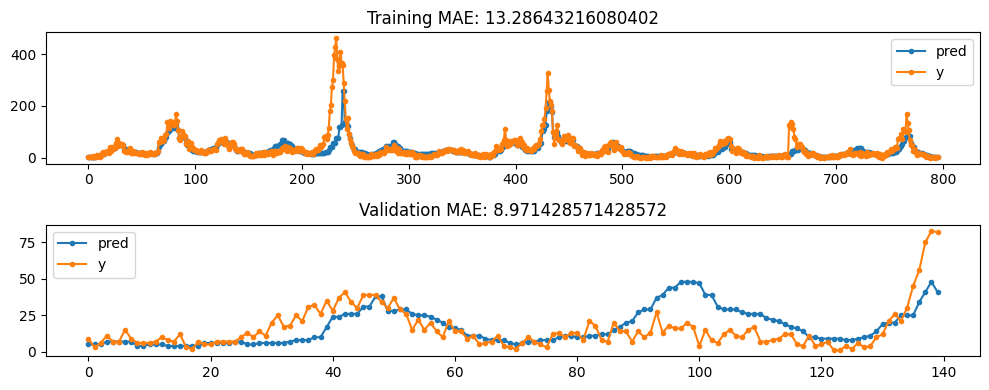

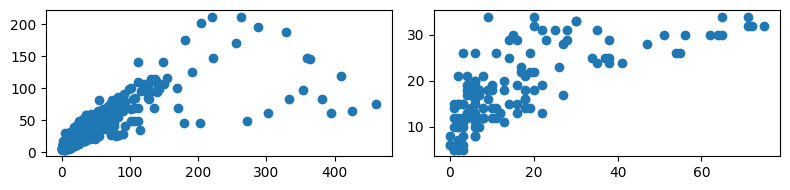

...

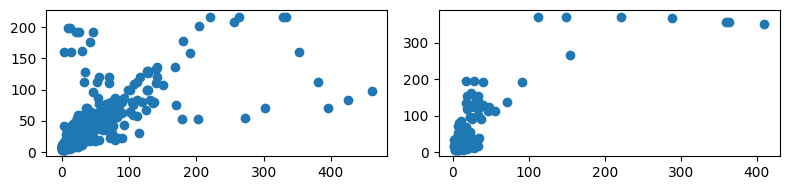

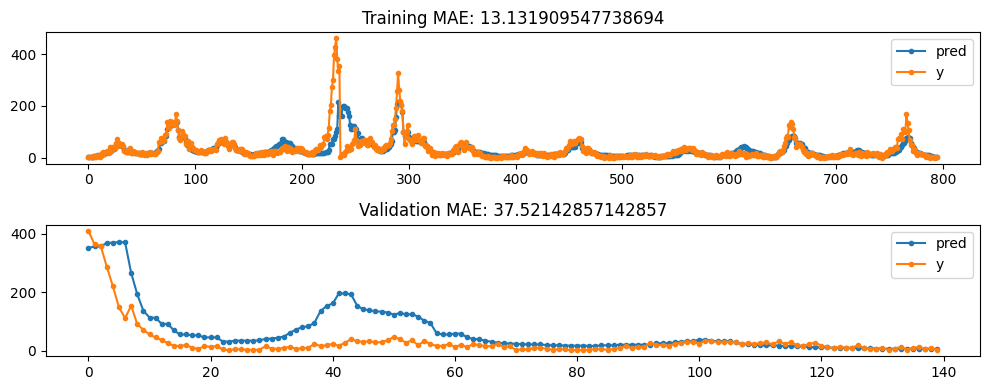

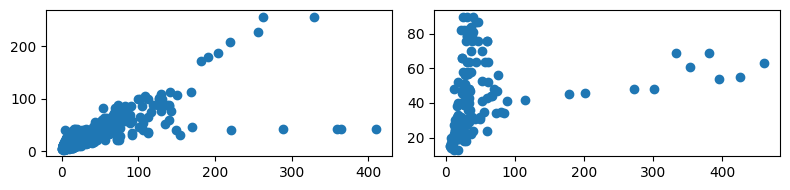

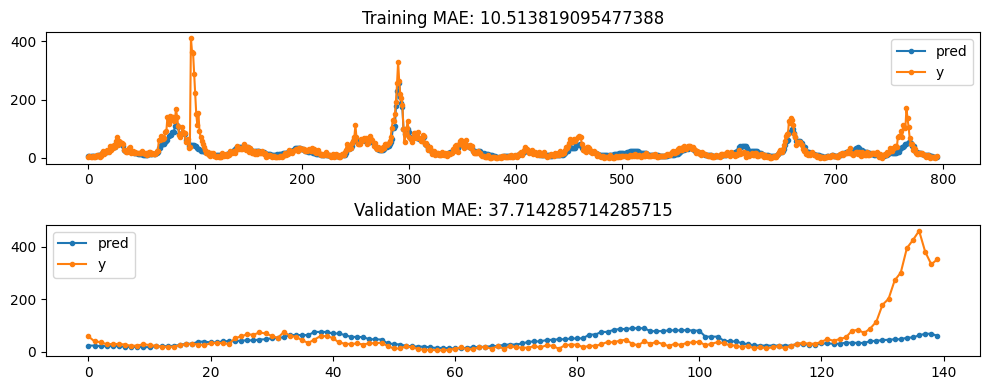

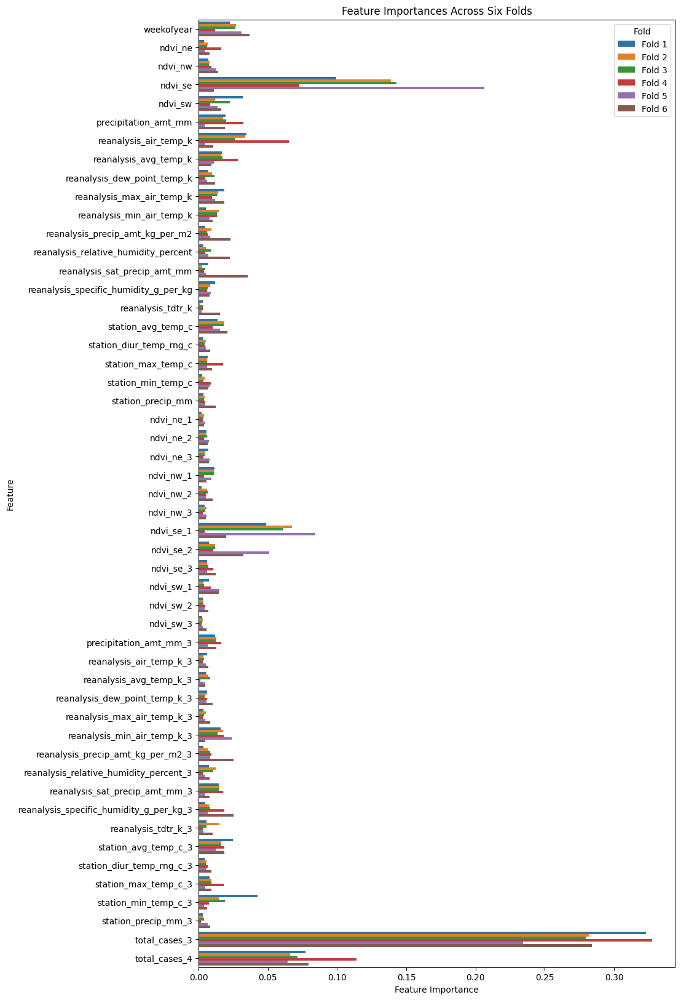

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


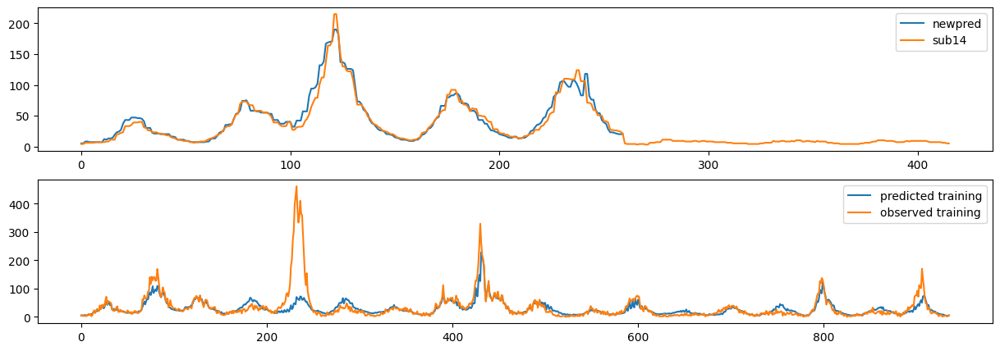

In [52]:
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
folds = 6
fold_size = 0.15
xg_reg_sj = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_feature_names = [col for col in feature_names if col !='weekofyear']
    
# Fixed lags for ndvi features
lagged_features = {col:[1,2,3] for col in lagged_feature_names if ('ndvi' in col)}

# Fixed lags for other features
lagged_features_others = {col:(3,) for col in lagged_feature_names if not ('ndvi' in col)}
lagged_features.update(lagged_features_others)

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=None,
                                                            label_lags=label_lags,circular_weekofyear=True,
                                                            weekofyear_shift=10)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_sj[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_sj.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_sj[fold], X_train_sj[fold], y_train_sj[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_sj, pred_val_sj,train_mae_sj, val_mae_sj = eval_and_plot(xg_reg_sj[fold],X_train_sj[fold].sort_index(),y_train_sj[fold].sort_index(),
                                            X_val_sj[fold],y_val_sj[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_sj[fold].feature_importances_
    features = X_train_sj[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_sj = pd.concat([X_train_sj[0], X_val_sj[0]],axis=0)
y_train_sj = pd.concat([y_train_sj[0], y_val_sj[0]],axis=0)

model_sj = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_sj, X_train_sj.sort_index(), y_train_sj.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

sj_pred_features_aug, _, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True,
                                  weekofyear_shift=10)

# Get predicted values
sj_mask = sj_pred_features_aug['city_sj']
iq_mask = ~sj_mask
sj_pred_features_aug = sj_pred_features_aug.copy().loc[sj_mask,[col for col in sj_pred_features_aug.columns if col != 'city_sj']]
order_needed = sj_features.columns.to_list()
sj_pred_features_aug = sj_pred_features_aug[order_needed]
sj_sub_pred = get_predictions(model_sj, sj_pred_features_aug, label_lags)
sj_sub_pred = medfilt(sj_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(sj_sub_pred,label='newpred')
axs[0].plot(best_case['total_cases'],label='sub14')
axs[0].legend()
sj_train_pred = get_predictions(model_sj, X_train_sj.sort_index(), label_lags)
axs[1].plot(sj_train_pred,label='predicted training')
axs[1].plot(sj_labels,label='observed training')
axs[1].legend()


 ~~~~~~~~~~~~~~ Running fold 1 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported

 ~~~~~~~~~~~~~~ Running fold 2 of 6 ~~~~~~~~~~~~~~ 
Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are su

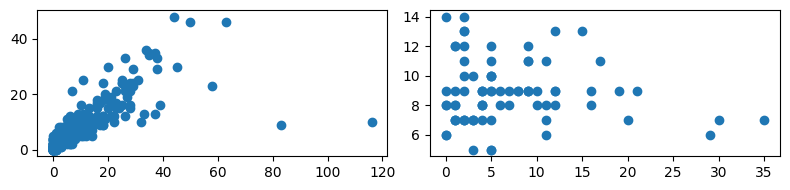

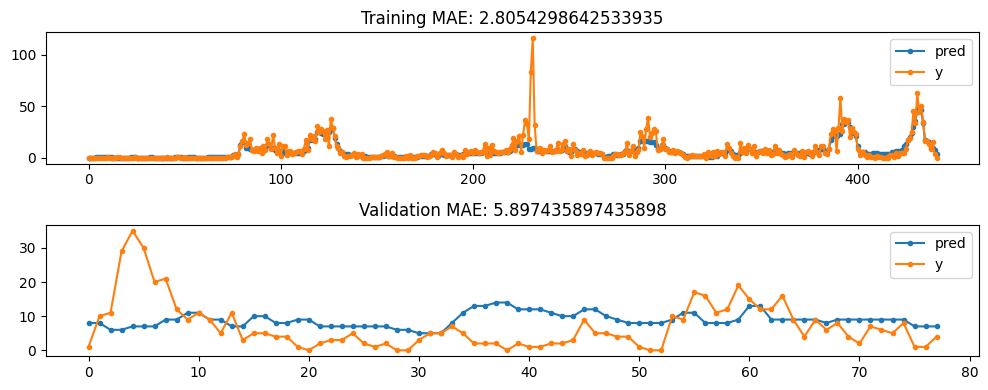

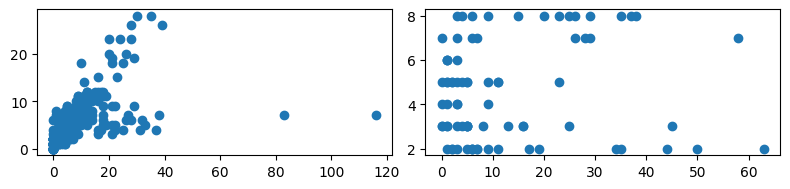

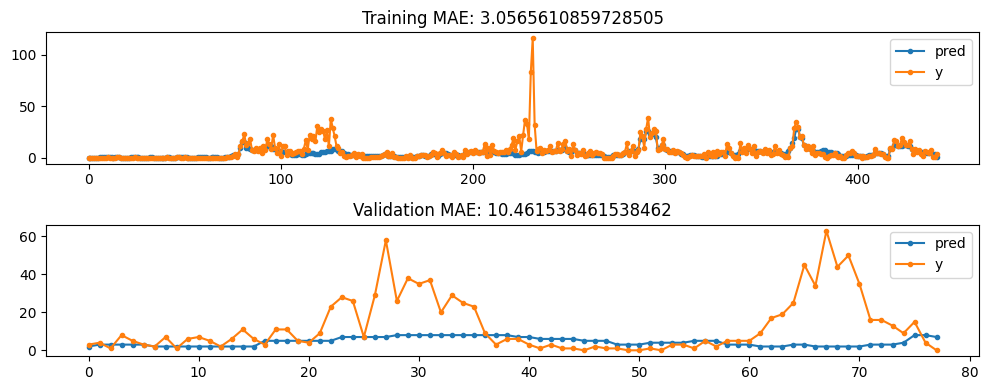

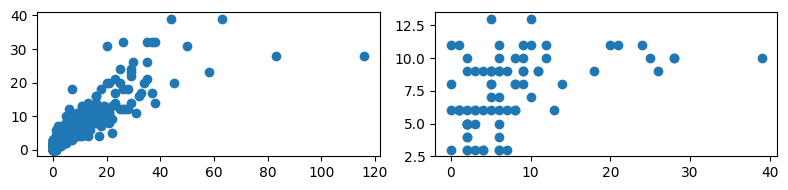

...

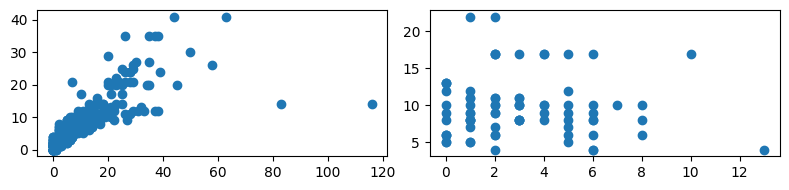

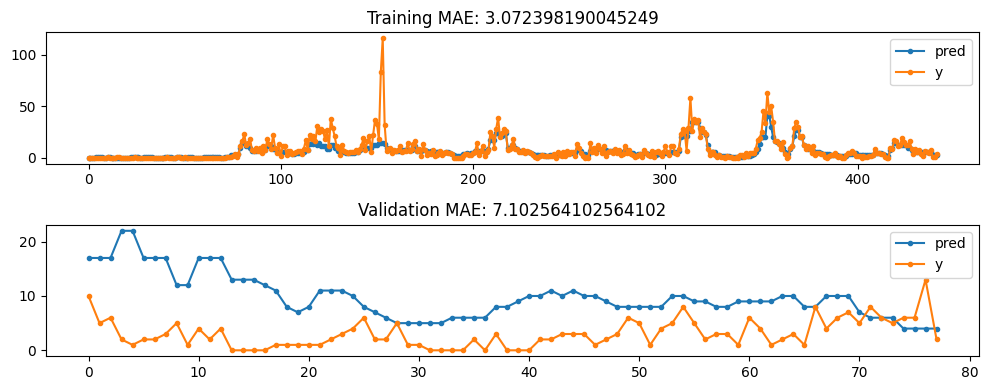

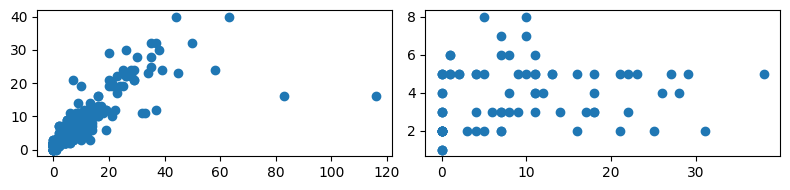

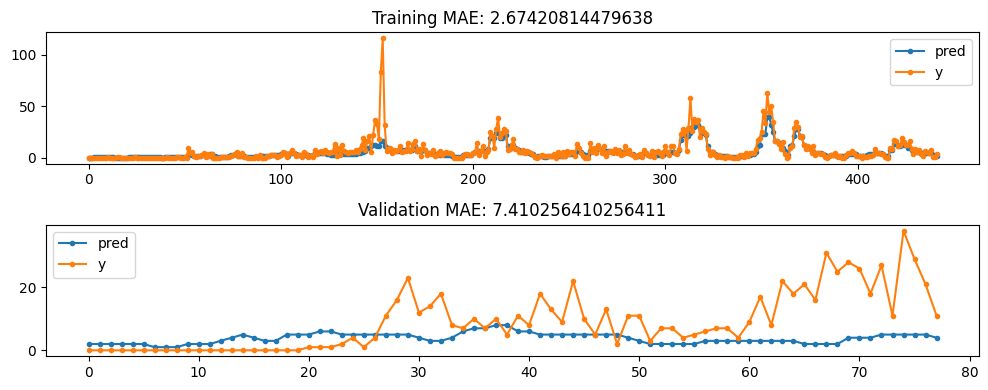

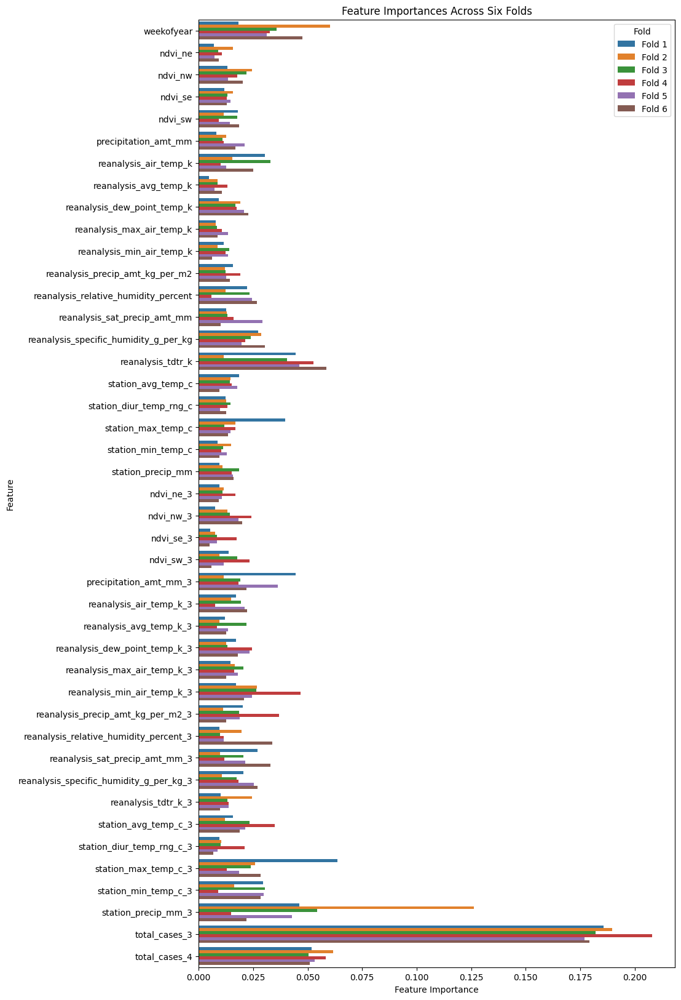

Found 1 CUDA devices
id 0    b'NVIDIA GeForce RTX 4080 SUPER'                              [SUPPORTED]
                      Compute Capability: 8.9
                           PCI Device ID: 0
                              PCI Bus ID: 1
                                    UUID: GPU-f1d5998d-eba4-9052-500d-4444204ecda3
                                Watchdog: Enabled
             FP32/FP64 Performance Ratio: 64
Summary:
	1/1 devices are supported


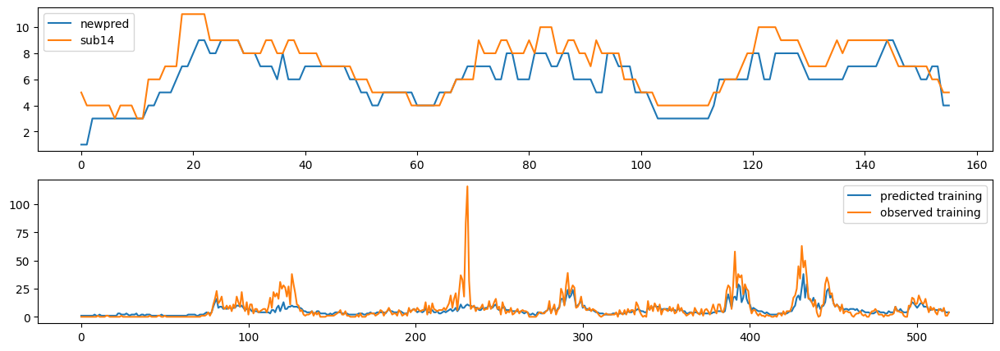

In [53]:
# Close to original best scoring
# Specify modelling parameters
label_lags=(3,4)
# label_lags=None
feature_lags = (3,)
folds = 6
fold_size = 0.15
xg_reg_iq = []
feature_names = [col for col in train_features_or.columns if col not in ['week_start_date','city','year']]
lagged_features = [col for col in feature_names if col !='weekofyear']

# Preprocess to get lagged features/labels
sj_features, iq_features, sj_labels, iq_labels = preprocess(train_features_or,labels=train_labels,
                                                            features_to_keep = feature_names,
                                                            lagged_features = lagged_features,
                                                            fillna = 'ffill', feature_lags=feature_lags,
                                                            label_lags=label_lags,circular_weekofyear=True)

# Drop city column if training cities separately
sj_features.drop(columns=['city_sj'],inplace=True)
iq_features.drop(columns=['city_sj'],inplace=True)

X_train_sj, X_val_sj, y_train_sj, y_val_sj,\
    X_train_iq, X_val_iq, y_train_iq, y_val_iq = prep_data(sj_features, iq_features,
                                                           sj_labels, iq_labels,
                                                           folds=6, fold_size=0.15)

# Reducing all lagged label weights to reduce their selection
feature_weights = 100*np.ones(X_train_iq[0].shape[1])
if label_lags is not None:
    feature_weights[-len(label_lags):] = 100

for fold in range(folds):
    print(f'\n ~~~~~~~~~~~~~~ Running fold {fold+1} of {folds} ~~~~~~~~~~~~~~ ')
    xg_reg_iq.append(create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1))

    modelfit(xg_reg_iq[fold], X_train_iq[fold], y_train_iq[fold],
            useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
            trainCV_metrics = 'mae', eval_metric = 'mae',
            report_metric = metrics.mean_absolute_error, verbose=False,
            feature_weights=feature_weights)
    pred_train_iq, pred_val_iq,train_mae_iq, val_mae_iq = eval_and_plot(xg_reg_iq[fold],X_train_iq[fold].sort_index(),y_train_iq[fold].sort_index(),
                                            X_val_iq[fold],y_val_iq[fold], label_lags=label_lags,
                                            verbose=False,plot=True, MC=None, get_pred_train=True,
                                            median_filter=3)
    
# Number of folds
num_folds = 6

# Get feature importances for each fold and prepare the data in long format
data = []
for fold in range(num_folds):
    importances = xg_reg_iq[fold].feature_importances_
    features = X_train_iq[fold].columns
    for feat, imp in zip(features, importances):
        data.append({'Feature': feat, 'Importance': imp, 'Fold': f'Fold {fold+1}'})

# Convert the data into a DataFrame
df = pd.DataFrame(data)

# Create a grouped bar plot
plt.figure(figsize=(10, 20))
sns.barplot(x='Importance', y='Feature', hue='Fold', data=df)

# Add labels and title
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importances Across Six Folds')
plt.legend(title='Fold')

plt.show()

# Start predicting
X_train_iq = pd.concat([X_train_iq[0], X_val_iq[0]],axis=0)
y_train_iq = pd.concat([y_train_iq[0], y_val_iq[0]],axis=0)

model_iq = create_XGBmodel(eta=0.01,n_estimators=500,max_depth=5,
                                     objective='reg:squarederror',
                                     reg_alpha=1,reg_lambda=1)

modelfit(model_iq, X_train_iq.sort_index(), y_train_iq.sort_index(),
        useTrainCV=True, cv_folds=5, early_stopping_rounds=50,
        trainCV_metrics = 'mae', eval_metric = 'mae',
        report_metric = metrics.mean_absolute_error, verbose=False,
        feature_weights=feature_weights)
if label_lags is not None:
    lagged_label_names = ['total_cases_'+str(i) for i in label_lags]
else:
    lagged_label_names = []

_, iq_pred_features_aug, _, _ = preprocess(test_features_aug_or,
                                  features_to_keep = feature_names + lagged_label_names,
                                  lagged_features = lagged_features,
                                  fillna = 'ffill', feature_lags=feature_lags,
                                  label_lags=None,circular_weekofyear=True)

# Get predicted values
sj_mask = iq_pred_features_aug['city_sj']
iq_mask = ~sj_mask
iq_pred_features_aug = iq_pred_features_aug.copy().loc[iq_mask,[col for col in iq_pred_features_aug.columns if col != 'city_sj']]
order_needed = iq_features.columns.to_list()
iq_pred_features_aug = iq_pred_features_aug[order_needed]
iq_sub_pred = get_predictions(model_iq, iq_pred_features_aug, label_lags)
iq_sub_pred = medfilt(iq_sub_pred,3)

fig,axs = plt.subplots(2,1,figsize=(15,5))
axs[0].plot(iq_sub_pred,label='newpred')
axs[0].plot(best_case[best_case['city']=='iq']['total_cases'].reset_index(drop=True),label='sub14')
axs[0].legend()
iq_train_pred = get_predictions(model_iq, X_train_iq.sort_index(), label_lags)
axs[1].plot(iq_train_pred,label='predicted training')
axs[1].plot(iq_labels.reset_index(drop=True),label='observed training')
axs[1].legend()

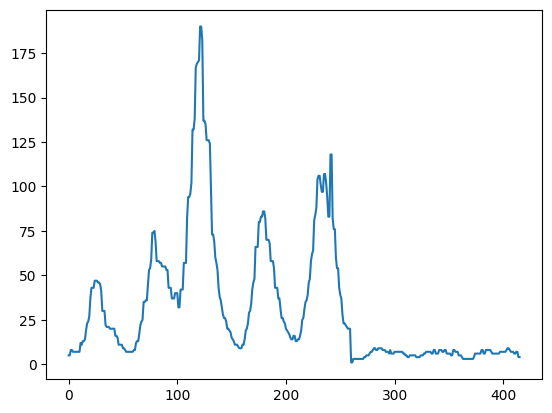

In [54]:
submission = pd.read_csv(datapath+"/submission_format.csv",
                         index_col=[0, 1, 2])
submission.total_cases = np.hstack([sj_sub_pred,iq_sub_pred]).astype(int)
plt.plot(np.hstack([sj_sub_pred,iq_sub_pred]).astype(int))
submission.to_csv("./submission_33.csv")